## MICCAI Test Pipeline

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-01-29 14:29:28.790705: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-01-29 14:29:30.251807: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-01-29 14:29:32.068024: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [ ]:
# overall imports
import importlib
import data

# importlib.reload(data.data_utils)
# importlib.reload(data.data_load)
#importlib.reload(sim.sim_utils)
# importlib.reload(models)

import models
import sim.sim 
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run, open_pickled_results


#### Check job specs

In [ ]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

In [ ]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

In [ ]:
GPUtil.getAvailable()
# if a number is seen a GPU is available

In [ ]:
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

In [ ]:
GPUtil.showUtilization()


In [ ]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

In [ ]:
torch.cuda.empty_cache()

## Start test pipeline <a id="sims"></a>

In [ ]:
def run_simulation_set(model_types=['dynamic_mlp'],
                      cv_types=['spatial', 'random'],
                      parcellations=['S100', 'S400'],
                      connectome_targets=['FC', 'SC'],
                      feature_types=['transcriptome', 'euclidean'],
                      hemisphere='left',
                      random_seeds=[42, 123, 456]):
    """
    Run a set of simulations with different combinations of parameters.
    
    Args:
        model_types (list): List of model types to test
        cv_types (list): List of cross-validation types
        parcellations (list): List of parcellation schemes
        connectome_targets (list): List of connectome targets
        feature_types (list): List of feature types
        hemisphere (str): Brain hemisphere to use ('left', 'right', 'both')
        random_seeds (list): List of random seeds for multiple runs
    """
    
    for seed in random_seeds:
        for model in model_types:
            for cv in cv_types:
                for parc in parcellations:
                    # Set hemisphere based on parcellation
                    current_hemisphere = 'both' if parc == 'S100' else 'left'
                    
                    for target in connectome_targets:
                        for feat in feature_types:
                            # Configure feature type dict
                            feat_dict = [{'transcriptome': None}] if feat == 'transcriptome' else [{'euclidean': None}]
                            
                            print(f"Running simulation with: {model}, {cv}, {parc}, {target}, {feat}, seed={seed}")
                            
                            # Run single simulation
                            single_sim_run(
                                cv_type=cv,
                                random_seed=seed,
                                model_type=model,
                                feature_type=feat_dict,
                                connectome_target=target,
                                use_gpu=True,
                                use_shared_regions=False,
                                test_shared_regions=False,
                                omit_subcortical=False,
                                parcellation=parc,
                                gene_list='0.2',
                                hemisphere=current_hemisphere,
                                search_method=('wandb', 'mse', 10),
                                save_sim=False,
                                track_wandb=True,
                                skip_cv=False
                            )
                            
                            # Clear GPU memory
                            if torch.cuda.is_available():
                                torch.cuda.empty_cache()
                            # Clear CPU memory
                            gc.collect()

# Example usage:
run_simulation_set(
    model_types=['dynamic_mlp'],
    cv_types=['spatial'],
    parcellations=['S100', 'S400'],
    connectome_targets=['SC', 'FC'],
    feature_types=['euclidean'],
    hemisphere='both',
    random_seeds=[1, 2]
)

Running simulation with: dynamic_mlp, random, S100, FC, seed=1
Number of components for 95% variance PCA: 34
X shape: (114, 10760)
X_pca shape: (114, 34)
Y_sc shape: (114, 114)
Y_sc_spectralL shape: (114, 113)
Y_sc_spectralA shape: (114, 114)
Y_fc shape: (114, 114)
Coordinates shape: (114, 3)
Y shape (114, 114)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (114, 10763)

 Test fold num: 1 X_train shape: (7140, 21526) Y_train shape: (7140,) X_test shape: (812, 21526) Y_test shape: (812,)


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: pgom3t1a
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/pgom3t1a


wandb: Agent Starting Run: dl5c61yk with config:
wandb: 	batch_size: 398
wandb: 	dropout_rate: 0.2638857450234624
wandb: 	epochs: 170
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.055587667627604e-05
wandb: 	weight_decay: 0.0004499511560006364
ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0
Number of learnable parameters in MLP: 11187969


  warnings.warn(



Epoch 5/170, Train Loss: 0.0353, Val Loss: 0.0197
Epoch 10/170, Train Loss: 0.0290, Val Loss: 0.0273
Epoch 15/170, Train Loss: 0.0258, Val Loss: 0.0121


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 20/170, Train Loss: 0.0240, Val Loss: 0.0090
Epoch 25/170, Train Loss: 0.0217, Val Loss: 0.0094
Epoch 30/170, Train Loss: 0.0202, Val Loss: 0.0084
Epoch 35/170, Train Loss: 0.0191, Val Loss: 0.0083
Epoch 40/170, Train Loss: 0.0177, Val Loss: 0.0078
Epoch 45/170, Train Loss: 0.0172, Val Loss: 0.0071
Epoch 50/170, Train Loss: 0.0151, Val Loss: 0.0060
Epoch 55/170, Train Loss: 0.0151, Val Loss: 0.0071
Epoch 60/170, Train Loss: 0.0136, Val Loss: 0.0073
Epoch 65/170, Train Loss: 0.0127, Val Loss: 0.0070
Epoch 70/170, Train Loss: 0.0116, Val Loss: 0.0068
Epoch 75/170, Train Loss: 0.0111, Val Loss: 0.0059
Epoch 80/170, Train Loss: 0.0106, Val Loss: 0.0075
Epoch 85/170, Train Loss: 0.0099, Val Loss: 0.0044
Epoch 90/170, Train Loss: 0.0099, Val Loss: 0.0050
Epoch 95/170, Train Loss: 0.0088, Val Loss: 0.0049
Epoch 100/170, Train Loss: 0.0085, Val Loss: 0.0054
Epoch 105/170, Train Loss: 0.0074, Val Loss: 0.0063
Epoch 110/170, Train Loss: 0.0076, Val Loss: 0.0048
Epoch 115/170, Train Loss: 0

  from IPython.core.display import HTML, display  # type: ignore



fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇█████
fold0_train_loss,█▆▆▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▂▃▃▄▄▄▃▄▃▄▃▄▅▅▅▄▆▅▆▄▆▅▆▆▆▆▇▇█▅▇▆█▇▅█▇▇
fold0_val_loss,█▃▂▂▂▂▁▁▁▁▁▁▁▁▃▁▁▁▁▂▁▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▁▄▅▆▇▇▆▇▇█▅▅▅▇▅▆▆▇▃▄▆▅▇▆█▇▆▆▇▅▇█▆▅▇▆▇▆▅
fold1_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇█████
fold1_train_loss,█▆▆▄▃▄▃▂▂▂▂▂▂▁▁▁▂▂▁▂▁▂▂▂▂▂▁▁▂▂▁▂▁▁▂▁▂▂▂▁
fold1_train_pearson,▄▃▂▅▄▇▅▃▅▃▇▅▅▆█▄▅▆▅▄▅▅▅▃▆█▃▄▄▇▆▆▃▁▅▆▄▄▁▆
fold1_val_loss,▁▅▇█▆▅▄▇▅▅▅▆▅▄▅▅▅▆▆▅▆▆▅▆▅▅▆▅▅▆▅▆▆▅▄▆▅▅▅▆
fold1_val_pearson,▁▃▅█▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▇▇▇▇▇▇▇
fold2_epoch,▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇█████


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: f9v0bi4f with config:
wandb: 	batch_size: 359
wandb: 	dropout_rate: 0.1354653741699087
wandb: 	epochs: 161
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 8.208040038039981e-05
wandb: 	weight_decay: 7.934807653536869e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/161, Train Loss: 0.0285, Val Loss: 0.0128
Epoch 10/161, Train Loss: 0.0254, Val Loss: 0.0208
Epoch 15/161, Train Loss: 0.0228, Val Loss: 0.0082
Epoch 20/161, Train Loss: 0.0210, Val Loss: 0.0146
Epoch 25/161, Train Loss: 0.0187, Val Loss: 0.0100
Epoch 30/161, Train Loss: 0.0175, Val Loss: 0.0183
Epoch 35/161, Train Loss: 0.0156, Val Loss: 0.0105
Epoch 40/161, Train Loss: 0.0152, Val Loss: 0.0097
Epoch 45/161, Train Loss: 0.0147, Val Loss: 0.0099
Epoch 50/161, Train Loss: 0.0143, Val Loss: 0.0091
Epoch 55/161, Train Loss: 0.0146, Val Loss: 0.0098
Epoch 60/161, Train Loss: 0.0145, Val Loss: 0.0094
Epoch 65/161, Train Loss: 0.0144, Val Loss: 0.0096
Epoch 70/161, Train Loss: 0.0145, Val Loss: 0.0098
Epoch 75/161, Train Loss: 0.0145, Val Loss: 0.0096
Epoch 80/161, Train Loss: 0.0145, Val Loss: 0.0098
Epoch 85/161, Train Loss: 0.0145, Val Loss: 0.0094
Epoch 90/161, Train Loss: 0.0146, Val Loss: 0.0097
Epoch 95/161

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 125/161, Train Loss: 0.0146, Val Loss: 0.0099
Epoch 130/161, Train Loss: 0.0140, Val Loss: 0.0098
Epoch 135/161, Train Loss: 0.0143, Val Loss: 0.0094
Epoch 140/161, Train Loss: 0.0145, Val Loss: 0.0096
Epoch 145/161, Train Loss: 0.0143, Val Loss: 0.0089
Epoch 150/161, Train Loss: 0.0144, Val Loss: 0.0089
Epoch 155/161, Train Loss: 0.0145, Val Loss: 0.0098
Epoch 160/161, Train Loss: 0.0140, Val Loss: 0.0096
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/161, Train Loss: 0.0252, Val Loss: 0.0252
Epoch 10/161, Train Loss: 0.0219, Val Loss: 0.0289
Epoch 15/161, Train Loss: 0.0197, Val Loss: 0.0128
Epoch 20/161, Train Loss: 0.0183, Val Loss: 0.0156
Epoch 25/161, Train Loss: 0.0167, Val Loss: 0.0263
Epoch 30/161, Train Loss: 0.0151, Val Loss: 0.0123
Epoch 35/161, Train Loss: 0.0144, Val Loss: 0.0130
Epoch 40/161, Train Loss: 0.0149, Val Loss: 0.0124
Epoch 45/161, Train Loss: 0.0143, Val Loss: 0.0126
Epoch 50/161, Train Loss: 0.0142, Val Loss: 0.0114
Epoc

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇███
fold0_train_loss,█▆▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▄▅▆▆▅▅▇▆▆▆▆▆▇▇▇▇▇▇▆█▇▇▇▆▆▇█▇▇█▇▇▆▇▇▇▇█▇
fold0_val_loss,▇█▃▃▇▃▁▄▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▃▄▆█▇▆▇█▇▆▇▆▇▇▇▇▆▆▆▆▆▆▆▇▇▆▇█▇▇▇▇▇▆▆█▆▇▇
fold1_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇██
fold1_train_loss,█▇▇▆▆▅▃▃▃▃▃▃▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁
fold1_train_pearson,▁▃▅▄▆▄▆▆▇▆▆▆▇▆▆▆▇▇▇▇▆▇▇▇▇▇▇▇▇▇█▇▇▇█▇████
fold1_val_loss,▇▅█▆▃▄▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▂▁▁▁▂
fold1_val_pearson,▂▁▄▄▆▇▇▇▇▇▇▇▇▇████▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇███
fold2_epoch,▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇█████


wandb: Agent Starting Run: c172wa0r with config:
wandb: 	batch_size: 438
wandb: 	dropout_rate: 0.25856627911915075
wandb: 	epochs: 132
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.223703436847916e-05
wandb: 	weight_decay: 6.00114105211815e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/132, Train Loss: 0.0432, Val Loss: 0.0233
Epoch 10/132, Train Loss: 0.0380, Val Loss: 0.0211
Epoch 15/132, Train Loss: 0.0365, Val Loss: 0.0251
Epoch 20/132, Train Loss: 0.0342, Val Loss: 0.0204
Epoch 25/132, Train Loss: 0.0354, Val Loss: 0.0152
Epoch 30/132, Train Loss: 0.0316, Val Loss: 0.0168
Epoch 35/132, Train Loss: 0.0310, Val Loss: 0.0161
Epoch 40/132, Train Loss: 0.0305, Val Loss: 0.0162
Epoch 45/132, Train Loss: 0.0313, Val Loss: 0.0150
Epoch 50/132, Train Loss: 0.0320, Val Loss: 0.0159
Epoch 55/132, Train Loss: 0.0324, Val Loss: 0.0149
Epoch 60/132, Train Loss: 0.0315, Val Loss: 0.0161
Epoch 65/132, Train Loss: 0.0310, Val Loss: 0.0154
Epoch 70/132, Train Loss: 0.0323, Val Loss: 0.0147
Epoch 75/132, Train Loss: 0.0339, Val Loss: 0.0148
Epoch 80/132, Train Loss: 0.0314, Val Loss: 0.0148
Epoch 85/132, Train Loss: 0.0323, Val Loss: 0.0147
Epoch 90/132, Train Loss: 0.0313, Val Loss: 0.0157
Epoch 95/13

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 115/132, Train Loss: 0.0317, Val Loss: 0.0151
Epoch 120/132, Train Loss: 0.0311, Val Loss: 0.0150
Epoch 125/132, Train Loss: 0.0339, Val Loss: 0.0158
Epoch 130/132, Train Loss: 0.0308, Val Loss: 0.0159
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/132, Train Loss: 0.0405, Val Loss: 0.0205
Epoch 10/132, Train Loss: 0.0365, Val Loss: 0.0290
Epoch 15/132, Train Loss: 0.0323, Val Loss: 0.0259
Epoch 20/132, Train Loss: 0.0312, Val Loss: 0.0222
Epoch 25/132, Train Loss: 0.0292, Val Loss: 0.0199
Epoch 30/132, Train Loss: 0.0286, Val Loss: 0.0206
Epoch 35/132, Train Loss: 0.0283, Val Loss: 0.0213
Epoch 40/132, Train Loss: 0.0280, Val Loss: 0.0210
Epoch 45/132, Train Loss: 0.0283, Val Loss: 0.0206
Epoch 50/132, Train Loss: 0.0277, Val Loss: 0.0210
Epoch 55/132, Train Loss: 0.0283, Val Loss: 0.0207
Epoch 60/132, Train Loss: 0.0285, Val Loss: 0.0198
Epoch 65/132, Train Loss: 0.0284, Val Loss: 0.0204
Epoch 70/132, Train Loss: 0.0282, Val Loss: 0.0209
Epoch 7

fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,██▇▆▄▄▄▃▃▃▃▃▃▂▁▁▂▂▁▁▂▂▂▂▂▂▂▁▁▁▂▂▂▂▂▁▁▂▂▂
fold0_train_pearson,▁▁▅▄▅▆▄██▇▆█▇▅█▆▅▃▆▇▆▅▅▃▆▄▅▅▄▅▆▆▇▇▅█▄▅▅▄
fold0_val_loss,█▇▆▅▅▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▃▁▂▂▃▂▂▂
fold0_val_pearson,▄▃▇▅▇▇▁██▇▇██▇▇▆▆▇▇▇▇▇▆▆▇▇▆▆▇▇▆▇▇▇█▆▇▇▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇██
fold1_train_loss,█▆▅▄▃▂▂▂▁▁▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▄▂▃▆▆▇▅▆▆▇▆▄▇▇▆▅▇▆▆▆▇▇▆▆▆▇▅▆▇▇▆▇▅▆▆█▇█
fold1_val_loss,▁▅█▆█▆▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
fold1_val_pearson,▁▆▄▅▆▇██████████▇▇█▇███▇▇███▇█▇▇████████
fold2_epoch,▁▁▁▂▂▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 161, 'input_dim': 21526, 'batch_size': 359, 'hidden_dims': [256, 128], 'dropout_rate': 0.1354653741699087, 'weight_decay': 7.934807653536869e-05, 'learning_rate': 8.208040038039981e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/161, Train Loss: 0.0205, Val Loss: 0.0167
Epoch 10/161, Train Loss: 0.0162, Val Loss: 0.0085
Epoch 15/161, Train Loss: 0.0136, Val Loss: 0.0083
Epoch 20/161, Train Loss: 0.0116, Val Loss: 0.0046
Epoch 25/161, Train Loss: 0.0104, Val Loss: 0.0048
Epoch 30/161, Train Loss: 0.0094, Val Loss: 0.0045
Epoch 35/161, Train Loss: 0.0084, Val Loss: 0.0039
Epoch 40/161, Train Loss: 0.0076, Val Loss: 0.0033
Epoch 45/161, Train Loss: 0.0066, Val Loss: 0.1135
Epoch 50/161, Train Loss: 0.0060, Val Loss: 0.0036
Epoch 55/161, Train Loss: 0.0054, Val Loss: 0.0034
Epoch 60/161, Train Loss: 0.0051, Val Loss: 0.0668
Epoch 65/161, Train Loss: 0.0045, Val Loss: 0.0043
Epoch 70/161, Train Loss: 0.0043, Val Loss: 0.0032
Epoch 75/161, Train Loss: 0.003

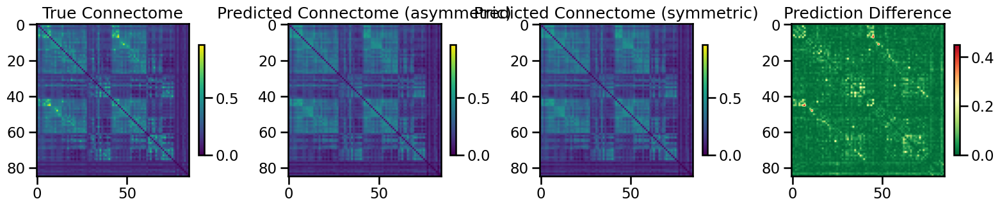

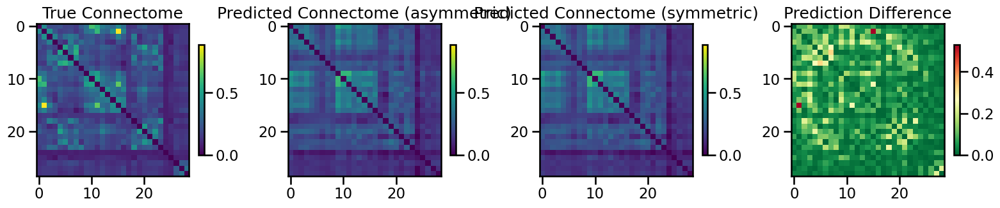

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0012474603544150907, 'mae': 0.022269160924681584, 'r2': 0.9166901500388491, 'pearson_corr': 0.9608126682042076, 'geodesic_distance': 6.364129277936618}
TEST METRICS: {'mse': 0.007626842780134446, 'mae': 0.06118845098359704, 'r2': 0.39251646767131565, 'pearson_corr': 0.6600736350329915, 'geodesic_distance': 8.683170220466508}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.1354653741699087, 'learning_rate': 8.208040038039981e-05, 'weight_decay': 7.934807653536869e-05, 'batch_size': 359, 'epochs': 161, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▅▃▃▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▄▅▆▇▇▁▇▇▇█▇▇▇▇▇▇▇▄▇▇██████▇▇██▇██████▇██
train_mse_loss,█▅▅▅▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▁▂▂▃▃▄▄▄▅▅▆▅▆▆▇▇▇▇█████████████████▇██
best_val_loss,0
test_mse_loss,0.00305
test_pearson,0.65696
train_mse_loss,0.00294
train_pearson,0.72168


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 4.0%
Available RAM: 967.2G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  4% |

 Test fold num: 2 X_train shape: (7140, 21526) Y_train shape: (7140,) X_test shape: (812, 21526) Y_test shape: (812,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 2kcqcyzj
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/2kcqcyzj


wandb: Agent Starting Run: cfeomcud with config:
wandb: 	batch_size: 490
wandb: 	dropout_rate: 0.264296820195961
wandb: 	epochs: 165
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.204577227697298e-05
wandb: 	weight_decay: 0.00015320654056481353
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/165, Train Loss: 0.0388, Val Loss: 0.0270
Epoch 10/165, Train Loss: 0.0333, Val Loss: 0.0143
Epoch 15/165, Train Loss: 0.0301, Val Loss: 0.0126
Epoch 20/165, Train Loss: 0.0282, Val Loss: 0.0126
Epoch 25/165, Train Loss: 0.0260, Val Loss: 0.0085
Epoch 30/165, Train Loss: 0.0245, Val Loss: 0.0093
Epoch 35/165, Train Loss: 0.0224, Val Loss: 0.0086
Epoch 40/165, Train Loss: 0.0218, Val Loss: 0.0078
Epoch 45/165, Train Loss: 0.0203, Val Loss: 0.0083
Epoch 50/165, Train Loss: 0.0195, Val Loss: 0.0064
Epoch 55/165, Train Loss: 0.0189, Val Loss: 0.0058
Epoch 60/165, Train Loss: 0.0173, Val Loss: 0.0061
Epoch 65/165, Train Loss: 0.0165, Val Loss: 0.0064
Epoch 70/165, Train Loss: 0.0153, Val Loss: 0.0043
Epoch 75/165, Train Loss: 0.0145, Val Loss: 0.0046
Epoch 80/165, Train Loss: 0.0143, Val Loss: 0.0048
Epoch 85/165, Train Loss: 0.0142, Val Loss: 0.0050
Epoch 90/165, Train Loss: 0.0128, Val Loss: 0.0043
Epoch 95/16

  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 155/165, Train Loss: 0.0097, Val Loss: 0.0037
Epoch 160/165, Train Loss: 0.0090, Val Loss: 0.0038
Epoch 165/165, Train Loss: 0.0090, Val Loss: 0.0036
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/165, Train Loss: 0.0408, Val Loss: 0.0412
Epoch 10/165, Train Loss: 0.0372, Val Loss: 0.0313
Epoch 15/165, Train Loss: 0.0344, Val Loss: 0.0273
Epoch 20/165, Train Loss: 0.0311, Val Loss: 0.0270
Epoch 25/165, Train Loss: 0.0297, Val Loss: 0.0237
Epoch 30/165, Train Loss: 0.0286, Val Loss: 0.0249
Epoch 35/165, Train Loss: 0.0261, Val Loss: 0.0263
Epoch 40/165, Train Loss: 0.0243, Val Loss: 0.0239
Epoch 45/165, Train Loss: 0.0239, Val Loss: 0.0214
Epoch 50/165, Train Loss: 0.0221, Val Loss: 0.0212
Epoch 55/165, Train Loss: 0.0214, Val Loss: 0.0188
Epoch 60/165, Train Loss: 0.0207, Val Loss: 0.0175
Epoch 65/165, Train Loss: 0.0202, Val Loss: 0.0174
Epoch 70/165, Train Loss: 0.0190, Val Loss: 0.0164
Epoch 75/165, Train Loss: 0.0184, Val Loss: 0.0154
Epoch 80

fold0_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇█
fold0_train_loss,██▇▇▇▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▂▂▃▄▄▅▅▄▆▄▅▅▅▅▅▅▄▇▅▅▆▆▆▆▆▇▇▇█▇▇▆▇▆█▇▆█
fold0_val_loss,▇█▄▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▅▃▄▅▁▆▅▅▆▆████▇█▆▇█▇▆▇▇▇▆▇▇▇▆▅▅▆▆▆▆▆▆▆▆▆
fold1_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇██
fold1_train_loss,█▇▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
fold1_train_pearson,▁▄▅▆▅▆▆▆▆▆▆▆▆▇▇▇▆▆▆▆▆▇▇▆▇▇▇▇▇▇▇▇▇▆▇▇▇▇██
fold1_val_loss,██▇▆▆▅▅▅▅▅▄▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁
fold1_val_pearson,▁▁▂▅▅▅▅▆▆▆▇▆▇▇▆▆▇█▇▇▆▆▇▇▇▆▇█▇▇▇██▇▇▆█▇▇▆
fold2_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇███


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7n5rxjf9 with config:
wandb: 	batch_size: 322
wandb: 	dropout_rate: 0.16486029024600662
wandb: 	epochs: 168
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.095927265192908e-05
wandb: 	weight_decay: 8.43285751518316e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/168, Train Loss: 0.0262, Val Loss: 0.0160
Epoch 10/168, Train Loss: 0.0238, Val Loss: 0.0303
Epoch 15/168, Train Loss: 0.0208, Val Loss: 0.0153
Epoch 20/168, Train Loss: 0.0187, Val Loss: 0.0196
Epoch 25/168, Train Loss: 0.0168, Val Loss: 0.0122
Epoch 30/168, Train Loss: 0.0156, Val Loss: 0.0143
Epoch 35/168, Train Loss: 0.0141, Val Loss: 0.0093
Epoch 40/168, Train Loss: 0.0129, Val Loss: 0.0085
Epoch 45/168, Train Loss: 0.0123, Val Loss: 0.0080
Epoch 50/168, Train Loss: 0.0110, Val Loss: 0.0077
Epoch 55/168, Train Loss: 0.0104, Val Loss: 0.0053
Epoch 60/168, Train Loss: 0.0093, Val Loss: 0.0065
Epoch 65/168, Train Loss: 0.0089, Val Loss: 0.0046
Epoch 70/168, Train Loss: 0.0079, Val Loss: 0.0054
Epoch 75/168, Train Loss: 0.0073, Val Loss: 0.0048
Epoch 80/168, Train Loss: 0.0074, Val Loss: 0.0044
Epoch 85/168, Train Loss: 0.0065, Val Loss: 0.0043
Epoch 90/168, Train Loss: 0.0064, Val Loss: 0.0047
Epoch 95/168

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 160/168, Train Loss: 0.0043, Val Loss: 0.0040
Epoch 165/168, Train Loss: 0.0039, Val Loss: 0.0040
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/168, Train Loss: 0.0242, Val Loss: 0.0148
Epoch 10/168, Train Loss: 0.0202, Val Loss: 0.0168
Epoch 15/168, Train Loss: 0.0171, Val Loss: 0.0074
Epoch 20/168, Train Loss: 0.0155, Val Loss: 0.0089
Epoch 25/168, Train Loss: 0.0138, Val Loss: 0.0066
Epoch 30/168, Train Loss: 0.0131, Val Loss: 0.0059
Epoch 35/168, Train Loss: 0.0123, Val Loss: 0.0054
Epoch 40/168, Train Loss: 0.0110, Val Loss: 0.0053
Epoch 45/168, Train Loss: 0.0105, Val Loss: 0.0044
Epoch 50/168, Train Loss: 0.0101, Val Loss: 0.0042
Epoch 55/168, Train Loss: 0.0096, Val Loss: 0.0043
Epoch 60/168, Train Loss: 0.0089, Val Loss: 0.0045
Epoch 65/168, Train Loss: 0.0085, Val Loss: 0.0040
Epoch 70/168, Train Loss: 0.0077, Val Loss: 0.0037
Epoch 75/168, Train Loss: 0.0072, Val Loss: 0.0036
Epoch 80/168, Train Loss: 0.0071, Val Loss: 0.0038
Epoch 85/1

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
fold0_train_loss,█▇▇▆▆▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▃▃▃▄▄▄▃▄▄▄▄▄▅▄▅▄▅▅▅▅▆▆▅▇▇▇▇▇█▇▇████▇▇█
fold0_val_loss,▆▄█▄▆▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▃▅▄▄▅▅▆▆▅▇▇▇▇▇▆█▇▇█▇█▆▇███▇▇▇▇▇▇▇▇▇▇▇▇▇
fold1_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇████
fold1_train_loss,█▇▅▄▄▃▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▃▃▃▃▃▃▄▄▃▄▄▄▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇▇▇▇███████
fold1_val_loss,█▃▃▃▂▂▂▂▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▁▂▃▅▄▄▄▆▃▆▅▆▆▅▇▆▆▆▇▅▇▇▇▇▇▇▇▇▇▇▇▆██▇██▇█
fold2_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇██


wandb: Agent Starting Run: pvxfpsrb with config:
wandb: 	batch_size: 410
wandb: 	dropout_rate: 0.27488907701542586
wandb: 	epochs: 146
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.673405063842409e-05
wandb: 	weight_decay: 8.19762231728246e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/146, Train Loss: 0.0347, Val Loss: 0.0216
Epoch 10/146, Train Loss: 0.0285, Val Loss: 0.0244
Epoch 15/146, Train Loss: 0.0258, Val Loss: 0.0134
Epoch 20/146, Train Loss: 0.0242, Val Loss: 0.0151
Epoch 25/146, Train Loss: 0.0217, Val Loss: 0.0118
Epoch 30/146, Train Loss: 0.0198, Val Loss: 0.0094
Epoch 35/146, Train Loss: 0.0183, Val Loss: 0.0089
Epoch 40/146, Train Loss: 0.0176, Val Loss: 0.0063
Epoch 45/146, Train Loss: 0.0160, Val Loss: 0.0059
Epoch 50/146, Train Loss: 0.0141, Val Loss: 0.0048
Epoch 55/146, Train Loss: 0.0139, Val Loss: 0.0046
Epoch 60/146, Train Loss: 0.0133, Val Loss: 0.0043
Epoch 65/146, Train Loss: 0.0128, Val Loss: 0.0040
Epoch 70/146, Train Loss: 0.0114, Val Loss: 0.0040
Epoch 75/146, Train Loss: 0.0117, Val Loss: 0.0038
Epoch 80/146, Train Loss: 0.0116, Val Loss: 0.0037
Epoch 85/146, Train Loss: 0.0097, Val Loss: 0.0036
Epoch 90/146, Train Loss: 0.0096, Val Loss: 0.0041
Epoch 95/14

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 5/146, Train Loss: 0.0385, Val Loss: 0.0227
Epoch 10/146, Train Loss: 0.0345, Val Loss: 0.0224
Epoch 15/146, Train Loss: 0.0313, Val Loss: 0.0181
Epoch 20/146, Train Loss: 0.0288, Val Loss: 0.0204
Epoch 25/146, Train Loss: 0.0278, Val Loss: 0.0193
Epoch 30/146, Train Loss: 0.0278, Val Loss: 0.0191
Epoch 35/146, Train Loss: 0.0272, Val Loss: 0.0188
Epoch 40/146, Train Loss: 0.0268, Val Loss: 0.0180
Epoch 45/146, Train Loss: 0.0273, Val Loss: 0.0188
Epoch 50/146, Train Loss: 0.0267, Val Loss: 0.0186
Epoch 55/146, Train Loss: 0.0268, Val Loss: 0.0188
Epoch 60/146, Train Loss: 0.0262, Val Loss: 0.0183
Epoch 65/146, Train Loss: 0.0270, Val Loss: 0.0187
Epoch 70/146, Train Loss: 0.0273, Val Loss: 0.0183
Epoch 75/146, Train Loss: 0.0266, Val Loss: 0.0184
Epoch 80/146, Train Loss: 0.0276, Val Loss: 0.0179
Epoch 85/146, Train Loss: 0.0266, Val Loss: 0.0181
Epoch 90/146, Train Loss: 0.0269, Val Loss: 0.0184
Epoch 95/146, Train Loss: 0.0268, Val Loss: 0.0185
Epoch 100/146, Train Loss: 0.027

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▆▅▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▂▁▂▂▂▃▃▅▄▃▄▃▄▂▅▄▅▄▅▅▅▇▅▆▆▅▆▇▆▇█▆▅▆▇▅▆▇▇█
fold0_val_loss,▇▇▇█▄▄▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▆▇██████▇█▆▇███████▇▇▇▇██████▇▇▇▇▇█▇█▇▇
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,█▅▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▂▂▁▂▁▁▁▁▁
fold1_train_pearson,▁▃▃▆▄▇▇▇▆▆▇▇▇▇▆██▇▇▇▇▇▇▇▇▆▆█▇██▇▆█▇█▆▇▇▇
fold1_val_loss,▁▇█▇▆▆▆▅▆▆▆▆▅▆▆▆▅▆▅▅▅▅▅▅▅▅▅▅▆▆▆▅▅▆▅▅▆▅▅▅
fold1_val_pearson,▁▄▃▆▆▇▇▇████████████████████████████████
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 168, 'input_dim': 21526, 'batch_size': 322, 'hidden_dims': [256, 128], 'dropout_rate': 0.16486029024600662, 'weight_decay': 8.43285751518316e-05, 'learning_rate': 9.095927265192908e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/168, Train Loss: 0.0244, Val Loss: 0.0244
Epoch 10/168, Train Loss: 0.0183, Val Loss: 0.0101
Epoch 15/168, Train Loss: 0.0151, Val Loss: 0.0071
Epoch 20/168, Train Loss: 0.0130, Val Loss: 0.0069
Epoch 25/168, Train Loss: 0.0112, Val Loss: 0.0060
Epoch 30/168, Train Loss: 0.0093, Val Loss: 0.0058
Epoch 35/168, Train Loss: 0.0081, Val Loss: 0.0059
Epoch 40/168, Train Loss: 0.0070, Val Loss: 0.0055
Epoch 45/168, Train Loss: 0.0065, Val Loss: 0.0056
Epoch 50/168, Train Loss: 0.0060, Val Loss: 0.0057
Epoch 55/168, Train Loss: 0.0053, Val Loss: 0.0056
Epoch 60/168, Train Loss: 0.0050, Val Loss: 0.0052
Epoch 65/168, Train Loss: 0.0047, Val Loss: 0.0056
Epoch 70/168, Train Loss: 0.0047, Val Loss: 0.0080
Epoch 75/168, Train Loss: 0.004

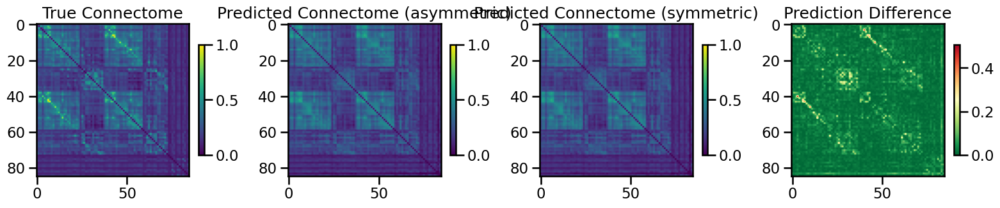

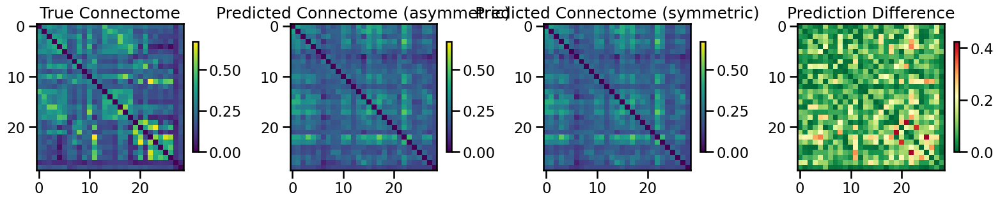

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.001629099974805417, 'mae': 0.02418699030543019, 'r2': 0.8930492871453186, 'pearson_corr': 0.9481984682697725, 'geodesic_distance': 9.407564172750726}
TEST METRICS: {'mse': 0.013944091834619329, 'mae': 0.09005309562250519, 'r2': -0.01671275987257026, 'pearson_corr': 0.31664440803669014, 'geodesic_distance': 6.932568810427476}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.16486029024600662, 'learning_rate': 9.095927265192908e-05, 'weight_decay': 8.43285751518316e-05, 'batch_size': 322, 'epochs': 168, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▄▃▂▂▁▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▁▃▂▇█▆▇▆▂▆▇▃▅▃▆▅▃▇▃▅▆▇▇▇▇▇▇▇▇▇▇█▇▇█▇▇▇▇▇
train_mse_loss,█▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▃▃▃▃▃▄▄▄▄▄▅▅▅▆▆▆▆▇▇▇▇▇▇▇█▇▇███████████
best_val_loss,0
test_mse_loss,0.00531
test_pearson,0.31817
train_mse_loss,0.00258
train_pearson,0.72303


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 4.0%
Available RAM: 966.6G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  6% |

 Test fold num: 3 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: wtl9pycb
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/wtl9pycb


wandb: Agent Starting Run: webchst0 with config:
wandb: 	batch_size: 419
wandb: 	dropout_rate: 0.17234173724281382
wandb: 	epochs: 166
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.789606560848955e-05
wandb: 	weight_decay: 0.00048366120913603464
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/166, Train Loss: 0.0322, Val Loss: 0.0197
Epoch 10/166, Train Loss: 0.0290, Val Loss: 0.0287
Epoch 15/166, Train Loss: 0.0269, Val Loss: 0.0479
Epoch 20/166, Train Loss: 0.0249, Val Loss: 0.0181
Epoch 25/166, Train Loss: 0.0225, Val Loss: 0.0255
Epoch 30/166, Train Loss: 0.0212, Val Loss: 0.0142
Epoch 35/166, Train Loss: 0.0206, Val Loss: 0.0246
Epoch 40/166, Train Loss: 0.0184, Val Loss: 0.0198
Epoch 45/166, Train Loss: 0.0186, Val Loss: 0.0192
Epoch 50/166, Train Loss: 0.0183, Val Loss: 0.0191
Epoch 55/166, Train Loss: 0.0176, Val Loss: 0.0194
Epoch 60/166, Train Loss: 0.0176, Val Loss: 0.0195
Epoch 65/166, Train Loss: 0.0174, Val Loss: 0.0192
Epoch 70/166, Train Loss: 0.0178, Val Loss: 0.0189
Epoch 75/166, Train Loss: 0.0177, Val Loss: 0.0190
Epoch 80/166, Train Loss: 0.0185, Val Loss: 0.0190
Epoch 85/166, Train Loss: 0.0182, Val Loss: 0.0189
Epoch 90/166, Train Loss: 0.0178, Val Loss: 0.0193
Epoch 95/166

  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 140/166, Train Loss: 0.0182, Val Loss: 0.0189
Epoch 145/166, Train Loss: 0.0184, Val Loss: 0.0189
Epoch 150/166, Train Loss: 0.0180, Val Loss: 0.0191
Epoch 155/166, Train Loss: 0.0178, Val Loss: 0.0190
Epoch 160/166, Train Loss: 0.0181, Val Loss: 0.0191
Epoch 165/166, Train Loss: 0.0175, Val Loss: 0.0191
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/166, Train Loss: 0.0276, Val Loss: 0.0240
Epoch 10/166, Train Loss: 0.0246, Val Loss: 0.0520
Epoch 15/166, Train Loss: 0.0228, Val Loss: 0.0169
Epoch 20/166, Train Loss: 0.0205, Val Loss: 0.0075
Epoch 25/166, Train Loss: 0.0192, Val Loss: 0.0090
Epoch 30/166, Train Loss: 0.0186, Val Loss: 0.0111
Epoch 35/166, Train Loss: 0.0176, Val Loss: 0.0091
Epoch 40/166, Train Loss: 0.0167, Val Loss: 0.0099
Epoch 45/166, Train Loss: 0.0152, Val Loss: 0.0088
Epoch 50/166, Train Loss: 0.0154, Val Loss: 0.0081
Epoch 55/166, Train Loss: 0.0156, Val Loss: 0.0079
Epoch 60/166, Train Loss: 0.0151, Val Loss: 0.0079
Epoch 

fold0_epoch,▁▁▁▁▁▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇████
fold0_train_loss,█▆▅▄▅▄▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▄▅▅▅▅▇▆▇██▇▇▇▇▇▇▇██▇██▇█▇▇▇▇▇▇█▇▇▇▇▇▇▇
fold0_val_loss,▇▃█▁▂▄▄▄▃▃▃▃▃▃▃▃▂▃▃▃▂▂▃▂▃▂▂▂▂▃▂▂▃▃▂▂▃▃▃▃
fold0_val_pearson,▁▄▇▇██▇▇▇███████████████████████████████
fold1_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇██
fold1_train_loss,█▃▃▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▄▄▃▄▅▄▆▅▆▇▆▆█▇▆▆▇▇▇█▆▇▇▇▇▆▇▆▇▇▆▇▇▇▇█▇▇
fold1_val_loss,█▅▄█▆▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▅▄▂▇█▅▇▇▇▆▆▇▇▇▇████████████████████████
fold2_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇█████


wandb: Agent Starting Run: nlv0g5qq with config:
wandb: 	batch_size: 330
wandb: 	dropout_rate: 0.1007265515399252
wandb: 	epochs: 104
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.033975927144672e-05
wandb: 	weight_decay: 0.00011488362587073958
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/104, Train Loss: 0.0213, Val Loss: 0.0230
Epoch 10/104, Train Loss: 0.0177, Val Loss: 0.0127
Epoch 15/104, Train Loss: 0.0153, Val Loss: 0.0129
Epoch 20/104, Train Loss: 0.0138, Val Loss: 0.0077
Epoch 25/104, Train Loss: 0.0121, Val Loss: 0.0079
Epoch 30/104, Train Loss: 0.0111, Val Loss: 0.0070
Epoch 35/104, Train Loss: 0.0096, Val Loss: 0.0055
Epoch 40/104, Train Loss: 0.0089, Val Loss: 0.0059
Epoch 45/104, Train Loss: 0.0084, Val Loss: 0.0055
Epoch 50/104, Train Loss: 0.0075, Val Loss: 0.0050
Epoch 55/104, Train Loss: 0.0072, Val Loss: 0.0055
Epoch 60/104, Train Loss: 0.0065, Val Loss: 0.0047
Epoch 65/104, Train Loss: 0.0063, Val Loss: 0.0048
Epoch 70/104, Train Loss: 0.0058, Val Loss: 0.0049
Epoch 75/104, Train Loss: 0.0053, Val Loss: 0.0041


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 80/104, Train Loss: 0.0048, Val Loss: 0.0043
Epoch 85/104, Train Loss: 0.0047, Val Loss: 0.0043
Epoch 90/104, Train Loss: 0.0046, Val Loss: 0.0045
Epoch 95/104, Train Loss: 0.0040, Val Loss: 0.0043
Epoch 100/104, Train Loss: 0.0036, Val Loss: 0.0038
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/104, Train Loss: 0.0279, Val Loss: 0.0212
Epoch 10/104, Train Loss: 0.0249, Val Loss: 0.0152
Epoch 15/104, Train Loss: 0.0213, Val Loss: 0.0148
Epoch 20/104, Train Loss: 0.0195, Val Loss: 0.0116
Epoch 25/104, Train Loss: 0.0176, Val Loss: 0.0123
Epoch 30/104, Train Loss: 0.0157, Val Loss: 0.0110
Epoch 35/104, Train Loss: 0.0140, Val Loss: 0.0095
Epoch 40/104, Train Loss: 0.0124, Val Loss: 0.0074
Epoch 45/104, Train Loss: 0.0115, Val Loss: 0.0069
Epoch 50/104, Train Loss: 0.0106, Val Loss: 0.0068
Epoch 55/104, Train Loss: 0.0102, Val Loss: 0.0059
Epoch 60/104, Train Loss: 0.0092, Val Loss: 0.0060
Epoch 65/104, Train Loss: 0.0085, Val Loss: 0.0057
Epoch 70/1

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇████
fold0_train_loss,██▇▆▆▆▅▅▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▁▂▂▂▂▃▃▃▃▄▄▃▃▄▄▅▅▅▅▆▆▆▆▅▆▇▆▇▇▇▇█▇▇▇█▇█
fold0_val_loss,█▃▂▂▂▂▃▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▃▇▇▇▆▆▆▆▇▅▇▇▇▆██▇▇▆▇▇▇███████████▇▇█▇██
fold1_epoch,▁▁▁▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,█▇▆▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▂▁▃▂▄▃▃▄▄▄▄▄▄▄▄▅▄▅▅▄▃▄▅▅▅▅▆▅▆▅▆▅▇▇▇▇█▇▇█
fold1_val_loss,█▅▃▃▂▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▃▁█▄▆▄▂▄▄▄▅▅▄▅▄▇▆▇▆▇█▇▆▆▆▆▄▇▆▇▅▇▆▇███▇█▇
fold2_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇███


wandb: Agent Starting Run: 3n5u34lj with config:
wandb: 	batch_size: 465
wandb: 	dropout_rate: 0.2462464747299177
wandb: 	epochs: 171
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.641866235697132e-05
wandb: 	weight_decay: 0.00010466408585899484
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/171, Train Loss: 0.0318, Val Loss: 0.0330
Epoch 10/171, Train Loss: 0.0270, Val Loss: 0.0424
Epoch 15/171, Train Loss: 0.0234, Val Loss: 0.0200


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 20/171, Train Loss: 0.0212, Val Loss: 0.0166
Epoch 25/171, Train Loss: 0.0196, Val Loss: 0.0145
Epoch 30/171, Train Loss: 0.0189, Val Loss: 0.0132
Epoch 35/171, Train Loss: 0.0190, Val Loss: 0.0137
Epoch 40/171, Train Loss: 0.0188, Val Loss: 0.0127
Epoch 45/171, Train Loss: 0.0191, Val Loss: 0.0129
Epoch 50/171, Train Loss: 0.0190, Val Loss: 0.0130
Epoch 55/171, Train Loss: 0.0192, Val Loss: 0.0129
Epoch 60/171, Train Loss: 0.0185, Val Loss: 0.0132
Epoch 65/171, Train Loss: 0.0189, Val Loss: 0.0133
Epoch 70/171, Train Loss: 0.0184, Val Loss: 0.0133
Epoch 75/171, Train Loss: 0.0187, Val Loss: 0.0131
Epoch 80/171, Train Loss: 0.0183, Val Loss: 0.0133
Epoch 85/171, Train Loss: 0.0191, Val Loss: 0.0130
Epoch 90/171, Train Loss: 0.0178, Val Loss: 0.0128
Epoch 95/171, Train Loss: 0.0179, Val Loss: 0.0134
Epoch 100/171, Train Loss: 0.0185, Val Loss: 0.0131
Epoch 105/171, Train Loss: 0.0187, Val Loss: 0.0134
Epoch 110/171, Train Loss: 0.0188, Val Loss: 0.0137
Epoch 115/171, Train Loss: 0

fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▄▄▃▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▅▅▇▇▇▆▇▇▇▇▇▇▆▇█▇▇▇▆▆█▆▇▇▇▇▇▇▇▆▆▇▆▆▆▆█▆▇
fold0_val_loss,▁▆█▆█▄▄▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
fold0_val_pearson,▁▆█▇████████████████████████████████████
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇████
fold1_train_loss,█▇▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▁▃▃▄▄▄▄▄▅▅▆▅▅▅▅▆▅▇▇█▇▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇
fold1_val_loss,▇▄▃▃█▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▄▃▆▆▇▇██▇▇▇▇█▇██████▆▇█▇███████████▇███
fold2_epoch,▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇██


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 104, 'input_dim': 21526, 'batch_size': 330, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.1007265515399252, 'weight_decay': 0.00011488362587073958, 'learning_rate': 9.033975927144672e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/104, Train Loss: 0.0215, Val Loss: 0.0145
Epoch 10/104, Train Loss: 0.0165, Val Loss: 0.0134
Epoch 15/104, Train Loss: 0.0126, Val Loss: 0.0076
Epoch 20/104, Train Loss: 0.0106, Val Loss: 0.0066
Epoch 25/104, Train Loss: 0.0093, Val Loss: 0.0047
Epoch 30/104, Train Loss: 0.0082, Val Loss: 0.0041
Epoch 35/104, Train Loss: 0.0072, Val Loss: 0.0040
Epoch 40/104, Train Loss: 0.0065, Val Loss: 0.0056
Epoch 45/104, Train Loss: 0.0059, Val Loss: 0.0037
Epoch 50/104, Train Loss: 0.0052, Val Loss: 0.0038
Epoch 55/104, Train Loss: 0.0046, Val Loss: 0.0036
Epoch 60/104, Train Loss: 0.0047, Val Loss: 0.0033
Epoch 65/104, Train Loss: 0.0042, Val Loss: 0.0033
Epoch 70/104, Train Loss: 0.0041, Val Loss: 0.0036
Epoch 75/104, Train Loss

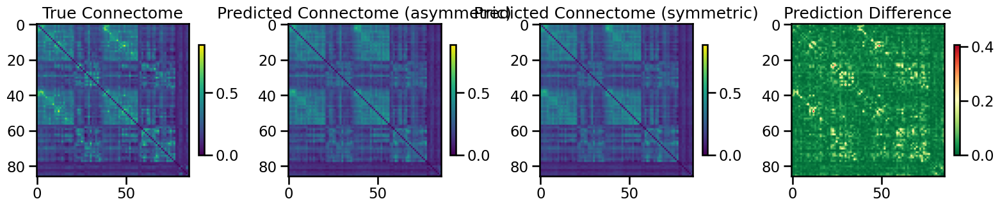

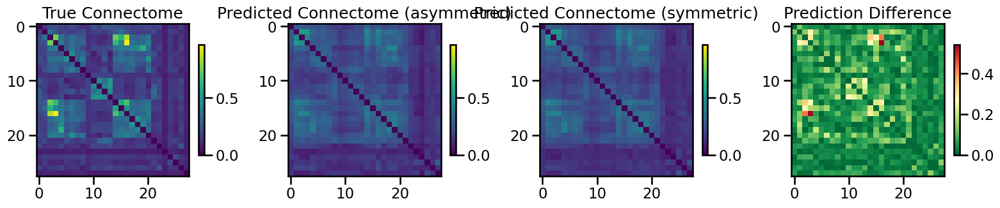

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.002082747827260064, 'mae': 0.030453121265430278, 'r2': 0.8480725640312541, 'pearson_corr': 0.9264047783652597, 'geodesic_distance': 7.105520808303731}
TEST METRICS: {'mse': 0.008469982503412122, 'mae': 0.06503716552714203, 'r2': 0.4778197543809487, 'pearson_corr': 0.6931501794018109, 'geodesic_distance': 5.36192511318154}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.1007265515399252, 'learning_rate': 9.033975927144672e-05, 'weight_decay': 0.00011488362587073958, 'batch_size': 330, 'epochs': 104, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▆▇▆▅▃▃▃▃▂▃▁▁▁▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▂▃▄▁▂▅▅▆▅▅▆▆▆▆▇▂▇▇▆▇▇▇▇▇▇█▇██▇████▇▇██▇█
train_mse_loss,█▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▃▃▃▄▄▄▄▄▄▄▄▄▄▅▅▅▅▆▆▆▇█████▇▇█▇█████████
best_val_loss,0
test_mse_loss,0.00314
test_pearson,0.69762
train_mse_loss,0.00402
train_pearson,0.60049


Final evaluation metrics logged successfully.
CPU Usage: 2.6%
RAM Usage: 5.0%
Available RAM: 956.3G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  8% |

 Test fold num: 4 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: skral014
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/skral014


wandb: Agent Starting Run: u61iqy84 with config:
wandb: 	batch_size: 441
wandb: 	dropout_rate: 0.17029464612728054
wandb: 	epochs: 137
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 8.32256640199922e-05
wandb: 	weight_decay: 0.0002512104725157575
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/137, Train Loss: 0.0259, Val Loss: 0.0151
Epoch 10/137, Train Loss: 0.0233, Val Loss: 0.0107
Epoch 15/137, Train Loss: 0.0205, Val Loss: 0.0104
Epoch 20/137, Train Loss: 0.0189, Val Loss: 0.0103
Epoch 25/137, Train Loss: 0.0174, Val Loss: 0.0118
Epoch 30/137, Train Loss: 0.0165, Val Loss: 0.0110
Epoch 35/137, Train Loss: 0.0157, Val Loss: 0.0086
Epoch 40/137, Train Loss: 0.0144, Val Loss: 0.0108
Epoch 45/137, Train Loss: 0.0137, Val Loss: 0.0102
Epoch 50/137, Train Loss: 0.0135, Val Loss: 0.0096
Epoch 55/137, Train Loss: 0.0122, Val Loss: 0.0070
Epoch 60/137, Train Loss: 0.0116, Val Loss: 0.0068
Epoch 65/137, Train Loss: 0.0111, Val Loss: 0.0067
Epoch 70/137, Train Loss: 0.0109, Val Loss: 0.0057
Epoch 75/137, Train Loss: 0.0101, Val Loss: 0.0054
Epoch 80/137, Train Loss: 0.0098, Val Loss: 0.0052
Epoch 85/137, Train Loss: 0.0093, Val Loss: 0.0047
Epoch 90/137, Train Loss: 0.0090, Val Loss: 0.0049
Epoch 95/137

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 135/137, Train Loss: 0.0062, Val Loss: 0.0043
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/137, Train Loss: 0.0244, Val Loss: 0.0099
Epoch 10/137, Train Loss: 0.0208, Val Loss: 0.0162
Epoch 15/137, Train Loss: 0.0196, Val Loss: 0.0117
Epoch 20/137, Train Loss: 0.0181, Val Loss: 0.0095
Epoch 25/137, Train Loss: 0.0165, Val Loss: 0.0081
Epoch 30/137, Train Loss: 0.0151, Val Loss: 0.0079
Epoch 35/137, Train Loss: 0.0143, Val Loss: 0.0073
Epoch 40/137, Train Loss: 0.0136, Val Loss: 0.0058
Epoch 45/137, Train Loss: 0.0133, Val Loss: 0.0065
Epoch 50/137, Train Loss: 0.0127, Val Loss: 0.0058
Epoch 55/137, Train Loss: 0.0121, Val Loss: 0.0065
Epoch 60/137, Train Loss: 0.0112, Val Loss: 0.0062
Epoch 65/137, Train Loss: 0.0109, Val Loss: 0.0061
Epoch 70/137, Train Loss: 0.0107, Val Loss: 0.0059
Epoch 75/137, Train Loss: 0.0107, Val Loss: 0.0061
Epoch 80/137, Train Loss: 0.0105, Val Loss: 0.0059
Epoch 85/137, Train Loss: 0.0109, Val Loss: 0.0060
Epoch 90/13

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇█████
fold0_train_loss,██▇▇▆▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▂▃▃▃▃▃▃▄▄▃▄▄▄▄▄▅▄▄▄▄▅▄▅▅▆▅▆▆▆▇▇█▇▇███
fold0_val_loss,█▅▂▂▂▄▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▄▁▃▆▆▃▇▇▆▇▆▅▇█▇▅▇▇▇▅▇█▅▇▆▆▇▇█████▇█▇▇▇██
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,█▇▇▆▆▅▄▄▄▄▃▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▂▃▅▅▄▆▅▆▅▅▅▅▆▆▇▆▆▇▆▇▇▆▇▇▇▇▆▆▇▇▇▆█▆▇▇▇
fold1_val_loss,█▃▃▄▂▃▂▃▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▃▃▁▄█▆▆▇▆▆▄▄▄▇▆▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
fold2_epoch,▁▁▁▂▂▂▂▂▂▂▂▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇████


wandb: Agent Starting Run: ssml8hh3 with config:
wandb: 	batch_size: 411
wandb: 	dropout_rate: 0.216511064274632
wandb: 	epochs: 101
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.892705907199905e-05
wandb: 	weight_decay: 0.0001742694757253434
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/101, Train Loss: 0.0305, Val Loss: 0.0148
Epoch 10/101, Train Loss: 0.0257, Val Loss: 0.0091
Epoch 15/101, Train Loss: 0.0224, Val Loss: 0.0099
Epoch 20/101, Train Loss: 0.0206, Val Loss: 0.0076
Epoch 25/101, Train Loss: 0.0190, Val Loss: 0.0063
Epoch 30/101, Train Loss: 0.0176, Val Loss: 0.0059
Epoch 35/101, Train Loss: 0.0156, Val Loss: 0.0051
Epoch 40/101, Train Loss: 0.0149, Val Loss: 0.0045
Epoch 45/101, Train Loss: 0.0140, Val Loss: 0.0039
Epoch 50/101, Train Loss: 0.0133, Val Loss: 0.0040


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 55/101, Train Loss: 0.0128, Val Loss: 0.0034
Epoch 60/101, Train Loss: 0.0118, Val Loss: 0.0032
Epoch 65/101, Train Loss: 0.0112, Val Loss: 0.0033
Epoch 70/101, Train Loss: 0.0101, Val Loss: 0.0033
Epoch 75/101, Train Loss: 0.0099, Val Loss: 0.0030
Epoch 80/101, Train Loss: 0.0091, Val Loss: 0.0030
Epoch 85/101, Train Loss: 0.0088, Val Loss: 0.0031
Epoch 90/101, Train Loss: 0.0077, Val Loss: 0.0030
Epoch 95/101, Train Loss: 0.0070, Val Loss: 0.0030
Epoch 100/101, Train Loss: 0.0073, Val Loss: 0.0033
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/101, Train Loss: 0.0320, Val Loss: 0.0243
Epoch 10/101, Train Loss: 0.0276, Val Loss: 0.0175
Epoch 15/101, Train Loss: 0.0247, Val Loss: 0.0146
Epoch 20/101, Train Loss: 0.0227, Val Loss: 0.0112
Epoch 25/101, Train Loss: 0.0204, Val Loss: 0.0098
Epoch 30/101, Train Loss: 0.0192, Val Loss: 0.0104
Epoch 35/101, Train Loss: 0.0177, Val Loss: 0.0082
Epoch 40/101, Train Loss: 0.0165, Val Loss: 0.0088
Epoch 45/1

fold0_epoch,▁▁▁▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇███
fold0_train_loss,█▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▂▃▂▃▅▃▄▄▄▄▄▄▄▄▅▅▆▅▅▅▅▅▆▅▆▆▆▇▅▆▇█▇▆▆▇██
fold0_val_loss,█▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▃▁▁▃▂▄▄▅▆▆▇▆▆▇▆█▇▇▇▇▇▇▇▇▇▇██▇█████████▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇███
fold1_train_loss,█▆▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▃▃▄▄▄▆▅▅▅▆▅▅▆▅▄▅▆▆▅▆▆▆▆▆▆▆▆▆█▇▇▅▇█▇▇▇██
fold1_val_loss,█▇▆▆▄▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▂▁▃▄▅▄▅▆▇▇▆▆▆▇█▇▇▅▆▇█▇█▇▆▇▇██▇██▇▇▇▇▇▇▇▆
fold2_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█████


wandb: Agent Starting Run: me3n467r with config:
wandb: 	batch_size: 470
wandb: 	dropout_rate: 0.1324365045127696
wandb: 	epochs: 140
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.6340238023514275e-05
wandb: 	weight_decay: 0.0002149579823380906
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/140, Train Loss: 0.0268, Val Loss: 0.0188
Epoch 10/140, Train Loss: 0.0236, Val Loss: 0.0141
Epoch 15/140, Train Loss: 0.0223, Val Loss: 0.0214
Epoch 20/140, Train Loss: 0.0210, Val Loss: 0.0121


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 25/140, Train Loss: 0.0197, Val Loss: 0.0127
Epoch 30/140, Train Loss: 0.0199, Val Loss: 0.0110
Epoch 35/140, Train Loss: 0.0197, Val Loss: 0.0129
Epoch 40/140, Train Loss: 0.0196, Val Loss: 0.0111
Epoch 45/140, Train Loss: 0.0190, Val Loss: 0.0121
Epoch 50/140, Train Loss: 0.0196, Val Loss: 0.0126
Epoch 55/140, Train Loss: 0.0190, Val Loss: 0.0122
Epoch 60/140, Train Loss: 0.0192, Val Loss: 0.0121
Epoch 65/140, Train Loss: 0.0189, Val Loss: 0.0121
Epoch 70/140, Train Loss: 0.0194, Val Loss: 0.0122
Epoch 75/140, Train Loss: 0.0185, Val Loss: 0.0121
Epoch 80/140, Train Loss: 0.0190, Val Loss: 0.0119
Epoch 85/140, Train Loss: 0.0191, Val Loss: 0.0123
Epoch 90/140, Train Loss: 0.0191, Val Loss: 0.0120
Epoch 95/140, Train Loss: 0.0191, Val Loss: 0.0122
Epoch 100/140, Train Loss: 0.0192, Val Loss: 0.0120
Epoch 105/140, Train Loss: 0.0187, Val Loss: 0.0122
Epoch 110/140, Train Loss: 0.0195, Val Loss: 0.0120
Epoch 115/140, Train Loss: 0.0190, Val Loss: 0.0122
Epoch 120/140, Train Loss: 

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇█████
fold0_train_loss,█▇▆▅▅▃▂▂▂▁▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▂▂▁▂▂▁▁▁▂▁▁▂▁▁▁
fold0_train_pearson,▁▃▃▅▃▄▇▄▆▆▆▆▆▆▇▆█▆▇▆▆▇▆▇▇▆▇▇█▇▇▇▇▇▇█▆▆▇▇
fold0_val_loss,▆█▂▂▄▄▁▁▁▁▂▂▁▁▁▁▁▂▂▁▁▁▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▂
fold0_val_pearson,▁▅▃▇▇██▇▇▇█████▇█████████▇██████████████
fold1_epoch,▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
fold1_train_loss,█▆▅▃▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁
fold1_train_pearson,▁▁▃▇▇▆▇▅▇▆▆▅▇█▆▇▇▇▇█▇▇▇▆▇▇▇▆▆▇▇▇▇▇▆▇▇█▇▇
fold1_val_loss,▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▄▂▃▆▅▁▁▆▇█▇██▇▇██▇▇▇██▇█▇█▇▇▇▇▇███▇▇▇██
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇█████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 101, 'input_dim': 21526, 'batch_size': 411, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.216511064274632, 'weight_decay': 0.0001742694757253434, 'learning_rate': 7.892705907199905e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/101, Train Loss: 0.0237, Val Loss: 0.0203
Epoch 10/101, Train Loss: 0.0193, Val Loss: 0.0116
Epoch 15/101, Train Loss: 0.0163, Val Loss: 0.0107
Epoch 20/101, Train Loss: 0.0143, Val Loss: 0.0086
Epoch 25/101, Train Loss: 0.0124, Val Loss: 0.0069
Epoch 30/101, Train Loss: 0.0112, Val Loss: 0.0065
Epoch 35/101, Train Loss: 0.0095, Val Loss: 0.0057
Epoch 40/101, Train Loss: 0.0084, Val Loss: 0.0059
Epoch 45/101, Train Loss: 0.0073, Val Loss: 0.0058
Epoch 50/101, Train Loss: 0.0063, Val Loss: 0.0063
Epoch 55/101, Train Loss: 0.0055, Val Loss: 0.0058
Epoch 60/101, Train Loss: 0.0048, Val Loss: 0.0051
Epoch 65/101, Train Loss: 0.0042, Val Loss: 0.0049
Epoch 70/101, Train Loss: 0.0037, Val Loss: 0.0055
Epoch 75/101, Train Loss: 

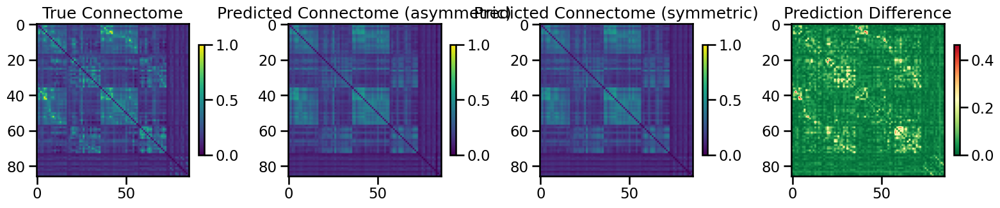

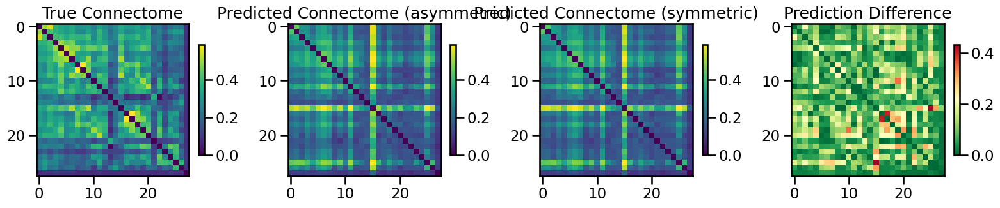

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.003199538470427617, 'mae': 0.03715297825995822, 'r2': 0.7763449164280927, 'pearson_corr': 0.8958976982027601, 'geodesic_distance': 8.446819040155404}
TEST METRICS: {'mse': 0.015585232523369963, 'mae': 0.09692463832090822, 'r2': -0.13137862418426738, 'pearson_corr': 0.4604064506275368, 'geodesic_distance': 6.124568935786738}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.216511064274632, 'learning_rate': 7.892705907199905e-05, 'weight_decay': 0.0001742694757253434, 'batch_size': 411, 'epochs': 101, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▄▃▂▂▂▂▂▂▁▁▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▁▂▃▄▅▆▇▆▆▆▇▇██▅▆█▇▇█████▇▇▆▇▇▃▆▆▆▆▆▇▆▆▆▆
train_mse_loss,█▇▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▃▄▄▄▄▄▅▆▆▆▆▇▇▇▇▇███████
best_val_loss,0
test_mse_loss,0.00586
test_pearson,0.46138
train_mse_loss,0.00227
train_pearson,0.78726


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 4.0%
Available RAM: 966.9G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  9% |


  gc.collect()



Running simulation with: dynamic_mlp, random, S100, SC, seed=1
Number of components for 95% variance PCA: 34
X shape: (114, 10760)
X_pca shape: (114, 34)
Y_sc shape: (114, 114)
Y_sc_spectralL shape: (114, 113)
Y_sc_spectralA shape: (114, 114)
Y_fc shape: (114, 114)
Coordinates shape: (114, 3)
Y shape (114, 114)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (114, 10763)

 Test fold num: 1 X_train shape: (7140, 21526) Y_train shape: (7140,) X_test shape: (812, 21526) Y_test shape: (812,)
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: j4fg5w4g
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/j4fg5w4g


wandb: Agent Starting Run: x3752soc with config:
wandb: 	batch_size: 500
wandb: 	dropout_rate: 0.25838498174099045
wandb: 	epochs: 129
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.618236633073008e-05
wandb: 	weight_decay: 7.60334277234353e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/129, Train Loss: 0.2098, Val Loss: 0.1764
Epoch 10/129, Train Loss: 0.2002, Val Loss: 0.1763
Epoch 15/129, Train Loss: 0.1992, Val Loss: 0.1676
Epoch 20/129, Train Loss: 0.1958, Val Loss: 0.1687
Epoch 25/129, Train Loss: 0.1928, Val Loss: 0.1701
Epoch 30/129, Train Loss: 0.1959, Val Loss: 0.1653
Epoch 35/129, Train Loss: 0.1992, Val Loss: 0.1682
Epoch 40/129, Train Loss: 0.1964, Val Loss: 0.1633
Epoch 45/129, Train Loss: 0.1860, Val Loss: 0.1665
Epoch 50/129, Train Loss: 0.1952, Val Loss: 0.1644
Epoch 55/129, Train Loss: 0.1873, Val Loss: 0.1648
Epoch 60/129, Train Loss: 0.1892, Val Loss: 0.1638
Epoch 65/129, Train Loss: 0.1824, Val Loss: 0.1656
Epoch 70/129, Train Loss: 0.1861, Val Loss: 0.1646
Epoch 75/129, Train Loss: 0.1948, Val Loss: 0.1584
Epoch 80/129, Train Loss: 0.1875, Val Loss: 0.1637
Epoch 85/129, Train Loss: 0.1833, Val Loss: 0.1657
Epoch 90/129, Train Loss: 0.1838, Val Loss: 0.1668
Epoch 95/12

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 75/129, Train Loss: 0.1678, Val Loss: 0.2272
Epoch 80/129, Train Loss: 0.1649, Val Loss: 0.2295
Epoch 85/129, Train Loss: 0.1678, Val Loss: 0.2282
Epoch 90/129, Train Loss: 0.1642, Val Loss: 0.2303
Epoch 95/129, Train Loss: 0.1632, Val Loss: 0.2151
Epoch 100/129, Train Loss: 0.1632, Val Loss: 0.2305
Epoch 105/129, Train Loss: 0.1663, Val Loss: 0.2251
Epoch 110/129, Train Loss: 0.1645, Val Loss: 0.2329
Epoch 115/129, Train Loss: 0.1652, Val Loss: 0.2229
Epoch 120/129, Train Loss: 0.1631, Val Loss: 0.2272
Epoch 125/129, Train Loss: 0.1698, Val Loss: 0.2307
Processing inner fold 2
Number of learnable parameters in MLP: 11187969
Epoch 5/129, Train Loss: 0.2041, Val Loss: 0.1747
Epoch 10/129, Train Loss: 0.2023, Val Loss: 0.1773
Epoch 15/129, Train Loss: 0.1961, Val Loss: 0.1753
Epoch 20/129, Train Loss: 0.1937, Val Loss: 0.1739
Epoch 25/129, Train Loss: 0.1949, Val Loss: 0.1676
Epoch 30/129, Train Loss: 0.1897, Val Loss: 0.1705
Epoch 35/129, Train Loss: 0.1860, Val Loss: 0.1643
Epoch

fold0_epoch,▁▁▁▁▁▂▂▂▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇████
fold0_train_loss,█▇▆▄▅▅▄▄▅▄▅▄▄▄▅▃▃▄▃▄▃▂▃▃▃▄▄▂▂▂▂▃▂▂▁▂▁▂▂▂
fold0_train_pearson,▁▃▄▄▄▅▅▅▆▅▅▅▄▆▅▅▅▅▆▆▅▅▆▅▆▆▅▇▆▇▇▇▇▇▇▇█▆▇█
fold0_val_loss,▇▆▇▇▅▆▄▄▄▄▅█▃▄▂▁▂▂▃▄▃▃▂▂▂▃▃▄▃▃▁▂▃▂▄▃▂▃▃▃
fold0_val_pearson,▁▅▆▇█▇▆▆▅▆▅▆▆▅▄▅▆▄▆▅▅▆▅▆▆▆▅▇▅▆▇▆▆▆▇▆▇▆▆▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,██▆▆▄▅▄▄▄▃▃▄▂▂▃▂▂▂▂▂▁▁▁▁▃▂▂▁▁▂▂▁▂▂▂▁▁▂▁▂
fold1_train_pearson,▁▁▄▅▄▅▄▅▅▅▅▆▆▆▆▆▇▇▅▇▆▇▇▇▇█▆▇▆▆▇▇█▇▇█▇▆██
fold1_val_loss,▅▆▄█▇▃▇▃▅▄▁▅▅▄▃▅▃▄▄▃▃▃▁▃▂▄▄▄▁▂▇▂▄▂▃▃▅▄▃▂
fold1_val_pearson,▁▁▃█▆▆▆▆▆▆▆▅▅▃▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▄▅▄▅▅▅▅▅▅▅▅
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇███


wandb: Agent Starting Run: wf9qr8of with config:
wandb: 	batch_size: 405
wandb: 	dropout_rate: 0.12273683800619556
wandb: 	epochs: 160
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.2785205531434154e-05
wandb: 	weight_decay: 0.0002383290510263452
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705


  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 5/160, Train Loss: 0.2011, Val Loss: 0.2325


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 10/160, Train Loss: 0.1982, Val Loss: 0.2255
Epoch 15/160, Train Loss: 0.1945, Val Loss: 0.1203
Epoch 20/160, Train Loss: 0.1931, Val Loss: 0.1323
Epoch 25/160, Train Loss: 0.1904, Val Loss: 0.2492
Epoch 30/160, Train Loss: 0.1903, Val Loss: 0.1244
Epoch 35/160, Train Loss: 0.1898, Val Loss: 0.1198
Epoch 40/160, Train Loss: 0.1875, Val Loss: 0.3999
Epoch 45/160, Train Loss: 0.1886, Val Loss: 0.1167
Epoch 50/160, Train Loss: 0.1858, Val Loss: 0.1232
Epoch 55/160, Train Loss: 0.1849, Val Loss: 0.1218
Epoch 60/160, Train Loss: 0.1844, Val Loss: 0.1478
Epoch 65/160, Train Loss: 0.1834, Val Loss: 0.1657
Epoch 70/160, Train Loss: 0.1823, Val Loss: 0.1135
Epoch 75/160, Train Loss: 0.1838, Val Loss: 0.1197
Epoch 80/160, Train Loss: 0.1815, Val Loss: 0.1153
Epoch 85/160, Train Loss: 0.1836, Val Loss: 0.2398
Epoch 90/160, Train Loss: 0.1822, Val Loss: 0.1131
Epoch 95/160, Train Loss: 0.1822, Val Loss: 0.1129
Epoch 100/160, Train Loss: 0.1809, Val Loss: 0.2420
Epoch 105/160, Train Loss: 0.1

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇█
fold0_train_loss,█▄▄▄▄▃▃▃▃▃▂▃▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▅▄▃▄▅▄▅▅▅▅▆▆▆▆▇▆▆▆▇▇▇▇▇▇▇██▇█▇▇█▇█▇▇▇▇
fold0_val_loss,▃▅▁▃▁▁▃▄▁▁▂█▁▁▁▁▂▄▁▁▁▄▁▁▄▂▁▇▁▆▅▁▇▁▂▁▁▅▁▁
fold0_val_pearson,▁ ▃ ███ █ █ ██ ▂█ █ ▂ ██ █
fold1_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇██
fold1_train_loss,█▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▄▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇████████████████▇██▇█
fold1_val_loss,█▆▂▂▄▂▂▃▃▂▂▁▂▂▂▂▁▂▁▂▂▁▁▁▁▁▂▁▁▁▂▂▁▂▂▂▂▁▂▁
fold1_val_pearson,▁▇█▆▇▄▅▅▅▆▄▄▃▄▃▄▅▄▅▅▅▄▄▄▄▄▄▅▅▄▅▄▅▅▅▄▄▅▄▅
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███


wandb: Agent Starting Run: 88u0kwa2 with config:
wandb: 	batch_size: 485
wandb: 	dropout_rate: 0.10612985926268108
wandb: 	epochs: 121
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.501394043995362e-05
wandb: 	weight_decay: 0.00010685847132250972
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/121, Train Loss: 0.1971, Val Loss: 0.1870
Epoch 10/121, Train Loss: 0.1914, Val Loss: 0.1738
Epoch 15/121, Train Loss: 0.1952, Val Loss: 0.1741


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 20/121, Train Loss: 0.1934, Val Loss: 0.1791
Epoch 25/121, Train Loss: 0.1868, Val Loss: 0.1688
Epoch 30/121, Train Loss: 0.1908, Val Loss: 0.1797
Epoch 35/121, Train Loss: 0.1882, Val Loss: 0.1712
Epoch 40/121, Train Loss: 0.1906, Val Loss: 0.1689
Epoch 45/121, Train Loss: 0.1872, Val Loss: 0.1688
Epoch 50/121, Train Loss: 0.1847, Val Loss: 0.1712
Epoch 55/121, Train Loss: 0.1851, Val Loss: 0.1674
Epoch 60/121, Train Loss: 0.1832, Val Loss: 0.1713
Epoch 65/121, Train Loss: 0.1829, Val Loss: 0.1730
Epoch 70/121, Train Loss: 0.1862, Val Loss: 0.1711
Epoch 75/121, Train Loss: 0.1795, Val Loss: 0.1677
Epoch 80/121, Train Loss: 0.1807, Val Loss: 0.1712
Epoch 85/121, Train Loss: 0.1797, Val Loss: 0.1683
Epoch 90/121, Train Loss: 0.1792, Val Loss: 0.1708
Epoch 95/121, Train Loss: 0.1742, Val Loss: 0.1710
Epoch 100/121, Train Loss: 0.1785, Val Loss: 0.1691
Epoch 105/121, Train Loss: 0.1772, Val Loss: 0.1680
Epoch 110/121, Train Loss: 0.1797, Val Loss: 0.1703
Epoch 115/121, Train Loss: 0

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇█
fold0_train_loss,█▇▆▆▄▅▅▅▄▄▄▄▄▃▄▄▄▃▃▃▂▃▁▃▂▃▂▂▂▃▂▁▁▁▂▂▂▁▂▁
fold0_train_pearson,▁▂▄▄▄▅▅▅▆▆▆▆▆▇▇▇▆▇▆▆▇▆▇▆▇█████▇███████▇█
fold0_val_loss,█▃▃▂▃▃▄▃▂▄▂▂▂▂▃▁▂▁▂▂▂▃▂▃▂▃▁▃▂▂▁▂▃▁▂▃▂▂▂▃
fold0_val_pearson,▆▆▇█▆▆▅▁▅▅▆▅▅▅▅▆▅▆▆▇▅▆▇▇▆▇▇▇▇▆▇▇▆▆▇▇▇▇▇▇
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇█
fold1_train_loss,█▅▄▄▄▂▂▃▃▂▁▁▂▁▂▂▁▂▁▂▂▁▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁▂▂▁
fold1_train_pearson,▁▃▄▄▅▆▇▇▇▇▇▇▇▇▇▇████▇███▇▇██▇███████████
fold1_val_loss,█▅▆▁▅▃▆▄▅▂▂▂▃▂▁▄▃▅▄▁▄▃▃▃▃▃▃▃▃▄▄▃▃▂▂▃▄▂▂▂
fold1_val_pearson,▁▅▇▇▇▇█▇██▇████▇██▇█████████▇███▇███████
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇█


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 121, 'input_dim': 21526, 'batch_size': 485, 'hidden_dims': [256, 128], 'dropout_rate': 0.10612985926268108, 'weight_decay': 0.00010685847132250972, 'learning_rate': 6.501394043995362e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/121, Train Loss: 0.1871, Val Loss: 0.2042
Epoch 10/121, Train Loss: 0.1839, Val Loss: 0.2039
Epoch 15/121, Train Loss: 0.1812, Val Loss: 0.2003
Epoch 20/121, Train Loss: 0.1794, Val Loss: 0.1987
Epoch 25/121, Train Loss: 0.1778, Val Loss: 0.1980
Epoch 30/121, Train Loss: 0.1766, Val Loss: 0.1930
Epoch 35/121, Train Loss: 0.1753, Val Loss: 0.1918
Epoch 40/121, Train Loss: 0.1744, Val Loss: 0.1960
Epoch 45/121, Train Loss: 0.1726, Val Loss: 0.1970
Epoch 50/121, Train Loss: 0.1717, Val Loss: 0.1918
Epoch 55/121, Train Loss: 0.1710, Val Loss: 0.1993
Epoch 60/121, Train Loss: 0.1695, Val Loss: 0.1995
Epoch 65/121, Train Loss: 0.1679, Val Loss: 0.1985
Epoch 70/121, Train Loss: 0.1668, Val Loss: 0.1966
Epoch 75/121, Train Loss: 0.1

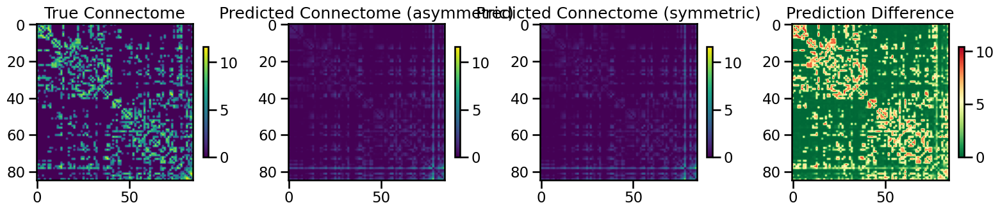

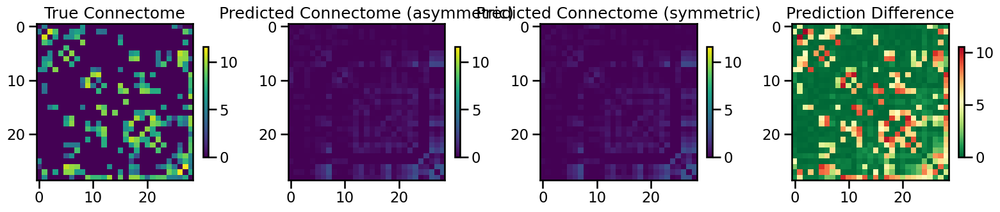

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 10.04492024052214, 'mae': 1.6448998340186118, 'r2': 0.016737161625682395, 'pearson_corr': 0.5847298516381739, 'geodesic_distance': 25.088868981576223}
TEST METRICS: {'mse': 12.899278120939579, 'mae': 2.0185216790110236, 'r2': -0.13906482293893507, 'pearson_corr': 0.48463035388264203, 'geodesic_distance': 14.366279672728082}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.10612985926268108, 'learning_rate': 6.501394043995362e-05, 'weight_decay': 0.00010685847132250972, 'batch_size': 485, 'epochs': 121, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▆█▄█▃▄▃▂▂▂▂▁▃▂▃▂▃▃▂▃▂▂▁▂▁▂▃▁▂▂▂▂▂▂▃▂▂▂▂▂
test_pearson,▃▅▄▇▅▁▅▆▅▃▅▇▇▇▆▄█▇▇▆▇▇▆▇▇▆▇▆▆█▆▆▇▇▇▇▇▇▇▇
train_mse_loss,█▇▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▃▄▄▄▅▅▅▅▅▅▅▅▆▆▆▇▇▆▇▇▇▇▇▇▇▇▇████████████
best_val_loss,0
test_mse_loss,0.19772
test_pearson,0.48986
train_mse_loss,0.16531
train_pearson,0.54809


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 4.0%
Available RAM: 966.8G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  9% |

 Test fold num: 2 X_train shape: (7140, 21526) Y_train shape: (7140,) X_test shape: (812, 21526) Y_test shape: (812,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: nd2hlpln
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/nd2hlpln


wandb: Agent Starting Run: ig6gfy6l with config:
wandb: 	batch_size: 261
wandb: 	dropout_rate: 0.1354140575741522
wandb: 	epochs: 167
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.867672088144296e-05
wandb: 	weight_decay: 0.00013111730007427195
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/167, Train Loss: 0.2024, Val Loss: 0.2154
Epoch 10/167, Train Loss: 0.2003, Val Loss: 0.1868
Epoch 15/167, Train Loss: 0.1959, Val Loss: 0.2117
Epoch 20/167, Train Loss: 0.1941, Val Loss: 0.2256
Epoch 25/167, Train Loss: 0.1926, Val Loss: 0.2006
Epoch 30/167, Train Loss: 0.1924, Val Loss: 0.1835
Epoch 35/167, Train Loss: 0.1926, Val Loss: 0.2194
Epoch 40/167, Train Loss: 0.1916, Val Loss: 0.1899
Epoch 45/167, Train Loss: 0.1919, Val Loss: 0.2048
Epoch 50/167, Train Loss: 0.1909, Val Loss: 0.1936
Epoch 55/167, Train Loss: 0.1909, Val Loss: 0.1824
Epoch 60/167, Train Loss: 0.1910, Val Loss: 0.1760
Epoch 65/167, Train Loss: 0.1907, Val Loss: 0.1805
Epoch 70/167, Train Loss: 0.1900, Val Loss: 0.2100
Epoch 75/167, Train Loss: 0.1898, Val Loss: 0.2008
Epoch 80/167, Train Loss: 0.1920, Val Loss: 0.1875
Epoch 85/167, Train Loss: 0.1898, Val Loss: 0.1958
Epoch 90/167, Train Loss: 0.1903, Val Loss: 0.2082
Epoch 95/16

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 130/167, Train Loss: 0.1900, Val Loss: 0.2017
Epoch 135/167, Train Loss: 0.1908, Val Loss: 0.2073
Epoch 140/167, Train Loss: 0.1910, Val Loss: 0.2091
Epoch 145/167, Train Loss: 0.1909, Val Loss: 0.2024
Epoch 150/167, Train Loss: 0.1894, Val Loss: 0.1990
Epoch 155/167, Train Loss: 0.1909, Val Loss: 0.1846
Epoch 160/167, Train Loss: 0.1901, Val Loss: 0.2005
Epoch 165/167, Train Loss: 0.1904, Val Loss: 0.2131
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/167, Train Loss: 0.1735, Val Loss: 0.2423
Epoch 10/167, Train Loss: 0.1713, Val Loss: 0.2300
Epoch 15/167, Train Loss: 0.1651, Val Loss: 0.2277
Epoch 20/167, Train Loss: 0.1597, Val Loss: 0.2275
Epoch 25/167, Train Loss: 0.1592, Val Loss: 0.2266
Epoch 30/167, Train Loss: 0.1573, Val Loss: 0.2244
Epoch 35/167, Train Loss: 0.1577, Val Loss: 0.2251
Epoch 40/167, Train Loss: 0.1550, Val Loss: 0.2274
Epoch 45/167, Train Loss: 0.1535, Val Loss: 0.2282
Epoch 50/167, Train Loss: 0.1496, Val Loss: 0.2226
Epo

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▅▅▄▄▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁▂▁▁▂▁▂▁▂▂▂▁▂▂▁
fold0_train_pearson,▁▃▃▄▅▅▅▅▅▄▅▅▆▆▇▇▆▇▆▇▆▆▆▇▆▇▆▇▇▇▆▇▆▆▆▆▆█▇▆
fold0_val_loss,▅█▄▄▄▂▁▆▄▆▇▄▄▂▃▁▃▂▄▅▄▆▃▃▃▅▁▄▃▅▆▆▅▄▃▅▅▅▆▆
fold0_val_pearson,▁▃▅▄▃▅▅▆▇▄▄▇█▇▇▆▇▇▅▄▅▆▇▅▆▅▂▆▂▅▇▆▄▆▆▃▄▅▆▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,█▆▇▆▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁
fold1_train_pearson,▁▂▂▂▂▃▃▃▄▃▄▄▄▄▄▄▄▅▅▅▆▆▆▇▇▇▇▇▇▇██████████
fold1_val_loss,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▆▆▇▇▇▇█▇▇▇▇▇▇▇▇▇▇███
fold2_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██


wandb: Agent Starting Run: q9ksc2gh with config:
wandb: 	batch_size: 500
wandb: 	dropout_rate: 0.1300463976963158
wandb: 	epochs: 107
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.961780067349248e-05
wandb: 	weight_decay: 0.0003411269360817885
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/107, Train Loss: 0.2038, Val Loss: 0.2219
Epoch 10/107, Train Loss: 0.2042, Val Loss: 0.2005
Epoch 15/107, Train Loss: 0.1918, Val Loss: 0.2045
Epoch 20/107, Train Loss: 0.1907, Val Loss: 0.2004
Epoch 25/107, Train Loss: 0.1944, Val Loss: 0.2017
Epoch 30/107, Train Loss: 0.1959, Val Loss: 0.2051
Epoch 35/107, Train Loss: 0.1897, Val Loss: 0.2010
Epoch 40/107, Train Loss: 0.1890, Val Loss: 0.2021
Epoch 45/107, Train Loss: 0.1927, Val Loss: 0.1940
Epoch 50/107, Train Loss: 0.1955, Val Loss: 0.1989
Epoch 55/107, Train Loss: 0.1884, Val Loss: 0.2020
Epoch 60/107, Train Loss: 0.1826, Val Loss: 0.2030
Epoch 65/107, Train Loss: 0.1905, Val Loss: 0.1975
Epoch 70/107, Train Loss: 0.1796, Val Loss: 0.2028
Epoch 75/107, Train Loss: 0.1850, Val Loss: 0.1925
Epoch 80/107, Train Loss: 0.1863, Val Loss: 0.1978
Epoch 85/107, Train Loss: 0.1841, Val Loss: 0.2032
Epoch 90/107, Train Loss: 0.1840, Val Loss: 0.2034
Epoch 95/107

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 100/107, Train Loss: 0.1811, Val Loss: 0.2039
Epoch 105/107, Train Loss: 0.1738, Val Loss: 0.1993
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/107, Train Loss: 0.1758, Val Loss: 0.2436
Epoch 10/107, Train Loss: 0.1718, Val Loss: 0.2355
Epoch 15/107, Train Loss: 0.1710, Val Loss: 0.2380
Epoch 20/107, Train Loss: 0.1653, Val Loss: 0.2328
Epoch 25/107, Train Loss: 0.1674, Val Loss: 0.2290
Epoch 30/107, Train Loss: 0.1668, Val Loss: 0.2265
Epoch 35/107, Train Loss: 0.1646, Val Loss: 0.2263
Epoch 40/107, Train Loss: 0.1633, Val Loss: 0.2299
Epoch 45/107, Train Loss: 0.1614, Val Loss: 0.2286
Epoch 50/107, Train Loss: 0.1637, Val Loss: 0.2302
Epoch 55/107, Train Loss: 0.1616, Val Loss: 0.2326
Epoch 60/107, Train Loss: 0.1587, Val Loss: 0.2255
Epoch 65/107, Train Loss: 0.1568, Val Loss: 0.2272
Epoch 70/107, Train Loss: 0.1591, Val Loss: 0.2281
Epoch 75/107, Train Loss: 0.1581, Val Loss: 0.2311
Epoch 80/107, Train Loss: 0.1534, Val Loss: 0.2231
Epoch 85/1

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇███
fold0_train_loss,▇▇▆▇▅▅█▄▅▅▅▄▅▆▄▄▄▅▃▄▃▄▃▃▂▂▅▃▃▅▃▄▁▄▂▃▂▂▃▄
fold0_train_pearson,▁▁▁▂▂▃▃▃▃▄▅▆▅▆▇▇▇▆▇▆▆▅▆▅▆▆▆▅▅▆▆▆▇▆██▇▇██
fold0_val_loss,▆█▃▃▂▂▂▁▂▁▂▂▂▂▁▂▁▂▁▂▂▁▂▁▁▂▂▂▂▂▁▂▁▁▂▂▁▁▁▁
fold0_val_pearson,▁▃▄▄▆▆▇▇▇▇▇▇█▇▇▇█▇▇▇▇▇▆▇▇▇█▇▇▆█▇████████
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇████
fold1_train_loss,█▆▅▅▄▃▄▄▃▃▃▃▃▃▃▂▂▃▃▂▃▂▂▃▂▂▂▂▂▂▂▂▁▁▁▂▁▂▂▂
fold1_train_pearson,▁▂▃▃▂▃▃▃▃▄▄▄▄▄▄▅▅▅▆▆▆▆▆▆▆▇▆▇▇▇███▇██████
fold1_val_loss,█▅▆▇▇▅▄▄▆▃▄▂▄▃▃▅▃▂▃▄▁▂▂▂▃▃▂▂▃▃▂▁▃▂▂▂▄▂▃▁
fold1_val_pearson,▂▅▆▇▆▁▅▆▆▆▆▆▆▆▅▆▆▇▆▆▇▆▇▆▇▇▇▇▇██▇███▇█▇██
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇█████


wandb: Agent Starting Run: p3f247kd with config:
wandb: 	batch_size: 430
wandb: 	dropout_rate: 0.20529879204360024
wandb: 	epochs: 145
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 8.889703694324583e-05
wandb: 	weight_decay: 0.00035285479665199605
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/145, Train Loss: 0.2021, Val Loss: 0.2177
Epoch 10/145, Train Loss: 0.2074, Val Loss: 0.2025
Epoch 15/145, Train Loss: 0.2018, Val Loss: 0.2015
Epoch 20/145, Train Loss: 0.1992, Val Loss: 0.2023
Epoch 25/145, Train Loss: 0.2042, Val Loss: 0.1981
Epoch 30/145, Train Loss: 0.1898, Val Loss: 0.2004
Epoch 35/145, Train Loss: 0.1913, Val Loss: 0.1971
Epoch 40/145, Train Loss: 0.1907, Val Loss: 0.2010
Epoch 45/145, Train Loss: 0.1930, Val Loss: 0.1965
Epoch 50/145, Train Loss: 0.1850, Val Loss: 0.1977
Epoch 55/145, Train Loss: 0.1895, Val Loss: 0.1966
Epoch 60/145, Train Loss: 0.1909, Val Loss: 0.1973
Epoch 65/145, Train Loss: 0.1893, Val Loss: 0.1964
Epoch 70/145, Train Loss: 0.1908, Val Loss: 0.1971
Epoch 75/145, Train Loss: 0.1900, Val Loss: 0.1995
Epoch 80/145, Train Loss: 0.1896, Val Loss: 0.1977
Epoch 85/145, Train Loss: 0.1911, Val Loss: 0.1975
Epoch 90/145, Train Loss: 0.1983, Val Loss: 0.1972
Epoch 95/145

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 145/145, Train Loss: 0.1887, Val Loss: 0.1968
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/145, Train Loss: 0.1764, Val Loss: 0.2375
Epoch 10/145, Train Loss: 0.1693, Val Loss: 0.2309
Epoch 15/145, Train Loss: 0.1678, Val Loss: 0.2298
Epoch 20/145, Train Loss: 0.1686, Val Loss: 0.2296
Epoch 25/145, Train Loss: 0.1676, Val Loss: 0.2265
Epoch 30/145, Train Loss: 0.1655, Val Loss: 0.2261
Epoch 35/145, Train Loss: 0.1610, Val Loss: 0.2264
Epoch 40/145, Train Loss: 0.1630, Val Loss: 0.2248
Epoch 45/145, Train Loss: 0.1629, Val Loss: 0.2286
Epoch 50/145, Train Loss: 0.1616, Val Loss: 0.2277
Epoch 55/145, Train Loss: 0.1612, Val Loss: 0.2280
Epoch 60/145, Train Loss: 0.1615, Val Loss: 0.2274
Epoch 65/145, Train Loss: 0.1597, Val Loss: 0.2271
Epoch 70/145, Train Loss: 0.1597, Val Loss: 0.2270
Epoch 75/145, Train Loss: 0.1595, Val Loss: 0.2264
Epoch 80/145, Train Loss: 0.1587, Val Loss: 0.2292
Epoch 85/145, Train Loss: 0.1624, Val Loss: 0.2242
Epoch 90/14

fold0_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█
fold0_train_loss,▇█▇▆▄▄▆▄▄▄▆▃▁▁▂▄▂▂▁▄▂▃▂▃▁▂▂▂▃▁▂▄▃▂▂▁▃▃▂▃
fold0_train_pearson,▁▅▅▆▇▇▆▇▆▆▇▆▇▇▇▇█▇▇▇▇▇▇▇▇▇█▇▇█▇▇▇▇█▇█▇▇▇
fold0_val_loss,█▃▂▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▂▁▄▇▇▆▇█▇▇▇▇████████████████████████████
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇██
fold1_train_loss,█▆▆▆▅▄▄▄▄▄▄▃▂▄▂▃▃▂▃▂▁▂▂▁▂▂▂▁▂▁▂▂▁▃▃▂▂▂▂▂
fold1_train_pearson,▁▃▂▃▃▅▄▄▆▆▆▆▇▆▇▇▆▇▇▆▇▇▇▇█▇█▇▇▇▇▆▇▇███▇█▇
fold1_val_loss,█▅▄▃▄▃▄▄▃▃▂▂▃▂▃▂▃▂▃▂▂▂▂▃▂▂▂▃▃▂▁▂▂▂▂▂▂▂▂▂
fold1_val_pearson,▁▆▇▇▆▆▆▇▇▆▇▇▇▇▇█▇████████████▇██████▇███
fold2_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇██


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 167, 'input_dim': 21526, 'batch_size': 261, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.1354140575741522, 'weight_decay': 0.00013111730007427195, 'learning_rate': 7.867672088144296e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/167, Train Loss: 0.1907, Val Loss: 0.1655
Epoch 10/167, Train Loss: 0.1835, Val Loss: 0.1459
Epoch 15/167, Train Loss: 0.1796, Val Loss: 0.1747
Epoch 20/167, Train Loss: 0.1762, Val Loss: 0.1713
Epoch 25/167, Train Loss: 0.1720, Val Loss: 0.1835
Epoch 30/167, Train Loss: 0.1661, Val Loss: 0.1619
Epoch 35/167, Train Loss: 0.1607, Val Loss: 0.1912
Epoch 40/167, Train Loss: 0.1616, Val Loss: 0.1731
Epoch 45/167, Train Loss: 0.1608, Val Loss: 0.1647
Epoch 50/167, Train Loss: 0.1587, Val Loss: 0.1940
Epoch 55/167, Train Loss: 0.1590, Val Loss: 0.1718
Epoch 60/167, Train Loss: 0.1574, Val Loss: 0.1995
Epoch 65/167, Train Loss: 0.1572, Val Loss: 0.1900
Epoch 70/167, Train Loss: 0.1570, Val Loss: 0.2049
Epoch 75/167, Train Loss

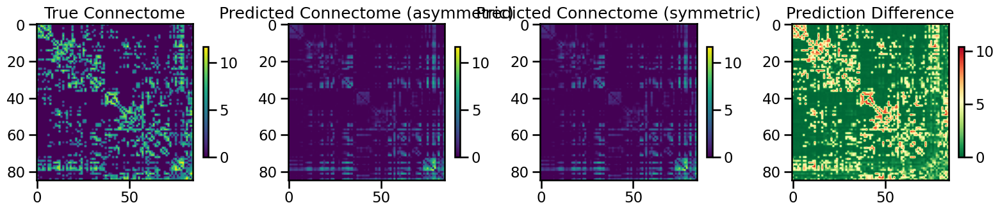

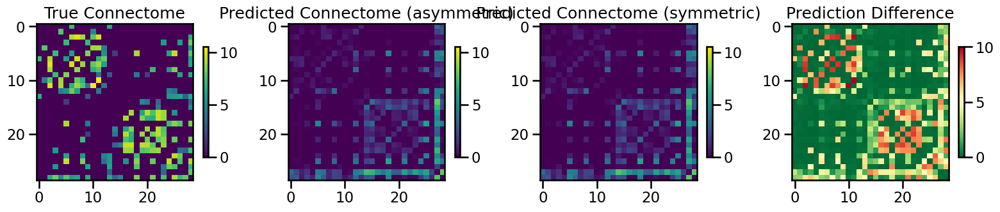

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 8.734751488615668, 'mae': 1.5654688421194551, 'r2': 0.178311579973238, 'pearson_corr': 0.6451087604964071, 'geodesic_distance': 22.82296141685518}
TEST METRICS: {'mse': 10.893570825864733, 'mae': 1.875949242175389, 'r2': -0.09387109696967078, 'pearson_corr': 0.2478314243054787, 'geodesic_distance': 11.086088325769522}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.1354140575741522, 'learning_rate': 7.867672088144296e-05, 'weight_decay': 0.00013111730007427195, 'batch_size': 261, 'epochs': 167, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▅▂▄▁▂▃▁▅▄▅▃▄▇▇▄▃▂█▄▅▅▂▃▄▃▅▃▄▄▄▅▄▆▅▇▄▇▇▃▄
test_pearson,▃▅▄▂▄▃█▆▃▂▄▂▂▃▄▃▄▄▆▃▄▄▄▄▄▄▄▇▅▂▅▁▂▄▃▄▄▅▅▄
train_mse_loss,█▆▆▅▅▄▃▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▂▃▃▄▅▅▅▅▇▇█▇██████████████████████████
best_val_loss,0
test_mse_loss,0.18051
test_pearson,0.22586
train_mse_loss,0.15629
train_pearson,0.62175


Final evaluation metrics logged successfully.
CPU Usage: 1.3%
RAM Usage: 4.0%
Available RAM: 966.6G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  9% |

 Test fold num: 3 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: cwj9dmwp
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/cwj9dmwp


wandb: Agent Starting Run: mvnsttsv with config:
wandb: 	batch_size: 400
wandb: 	dropout_rate: 0.24008058963531237
wandb: 	epochs: 152
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.820075532981983e-05
wandb: 	weight_decay: 0.0003513199654094689
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/152, Train Loss: 0.1841, Val Loss: 0.1993
Epoch 10/152, Train Loss: 0.1791, Val Loss: 0.1801
Epoch 15/152, Train Loss: 0.1769, Val Loss: 0.2354
Epoch 20/152, Train Loss: 0.1730, Val Loss: 0.2303
Epoch 25/152, Train Loss: 0.1723, Val Loss: 0.1555
Epoch 30/152, Train Loss: 0.1713, Val Loss: 0.1881
Epoch 35/152, Train Loss: 0.1697, Val Loss: 0.1907
Epoch 40/152, Train Loss: 0.1672, Val Loss: 0.1654
Epoch 45/152, Train Loss: 0.1661, Val Loss: 0.1865


  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 50/152, Train Loss: 0.1650, Val Loss: 0.2276
Epoch 55/152, Train Loss: 0.1648, Val Loss: 0.2442
Epoch 60/152, Train Loss: 0.1634, Val Loss: 0.1831
Epoch 65/152, Train Loss: 0.1620, Val Loss: 0.1740
Epoch 70/152, Train Loss: 0.1599, Val Loss: 0.2602
Epoch 75/152, Train Loss: 0.1602, Val Loss: 0.2057
Epoch 80/152, Train Loss: 0.1604, Val Loss: 0.1913
Epoch 85/152, Train Loss: 0.1605, Val Loss: 0.2046


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 90/152, Train Loss: 0.1599, Val Loss: 0.1765
Epoch 95/152, Train Loss: 0.1594, Val Loss: 0.2431
Epoch 100/152, Train Loss: 0.1584, Val Loss: 0.1854
Epoch 105/152, Train Loss: 0.1595, Val Loss: 0.1615
Epoch 110/152, Train Loss: 0.1602, Val Loss: 0.1433
Epoch 115/152, Train Loss: 0.1597, Val Loss: 0.2568
Epoch 120/152, Train Loss: 0.1597, Val Loss: 0.1766
Epoch 125/152, Train Loss: 0.1598, Val Loss: 0.1692
Epoch 130/152, Train Loss: 0.1599, Val Loss: 0.1779
Epoch 135/152, Train Loss: 0.1596, Val Loss: 0.1694
Epoch 140/152, Train Loss: 0.1597, Val Loss: 0.1940
Epoch 145/152, Train Loss: 0.1604, Val Loss: 0.2110
Epoch 150/152, Train Loss: 0.1587, Val Loss: 0.1956
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/152, Train Loss: 0.1835, Val Loss: 0.1796
Epoch 10/152, Train Loss: 0.1796, Val Loss: 0.1958
Epoch 15/152, Train Loss: 0.1758, Val Loss: 0.1398
Epoch 20/152, Train Loss: 0.1735, Val Loss: 0.1415
Epoch 25/152, Train Loss: 0.1723, Val Loss: 0.1635


fold0_epoch,▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇█████
fold0_train_loss,█▆▆▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▃▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▆▇▇▇▇▇▇▇▇▇▇██▇█▇██▇
fold0_val_loss,▅▄▄▇▄▂▆▇▇▅▂▁▂▄▄▂▇▃▁▄▂▄▁▇▇▆▆▃▆▃▇▄▃▅▄▂▃█▇▇
fold0_val_pearson,▅▁▆▄▄▂▁▄▆▄▅█▇▃▇▇▄▆▄▄▅▅▅▃▃▃▆▄▁█▅▂▅▇▄▃▆▅▂▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇███
fold1_train_loss,█▇▅▄▄▃▃▃▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▄▅▆▆▇▇▇▇▇▇█▇▇▇▇█████▇██▇▇█▇███▇████▇█▇█
fold1_val_loss,▅▅▅▇▂▄▂▃█▇▆▄▄▁▅▄▁▃▅▃▅▃▄▄▅▄▆▂▄▄▄█▆▄▆▄▂▄▇▇
fold1_val_pearson,▅▄▂▂▅▅▇▆█▃▆▆▂▃▄▆▅▃▃▃ ▅▅▃▅▂▆▁▄▂▁▅▂▃▅▂▂▂▆▃
fold2_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇███


wandb: Agent Starting Run: ec5zyqrh with config:
wandb: 	batch_size: 502
wandb: 	dropout_rate: 0.20349453150969665
wandb: 	epochs: 131
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.095823741276294e-05
wandb: 	weight_decay: 0.0003422995047214783
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/131, Train Loss: 0.1834, Val Loss: 0.2210
Epoch 10/131, Train Loss: 0.1784, Val Loss: 0.1992
Epoch 15/131, Train Loss: 0.1738, Val Loss: 0.1970
Epoch 20/131, Train Loss: 0.1699, Val Loss: 0.1997
Epoch 25/131, Train Loss: 0.1708, Val Loss: 0.2045
Epoch 30/131, Train Loss: 0.1753, Val Loss: 0.2018
Epoch 35/131, Train Loss: 0.1660, Val Loss: 0.2000
Epoch 40/131, Train Loss: 0.1656, Val Loss: 0.1947
Epoch 45/131, Train Loss: 0.1654, Val Loss: 0.1968
Epoch 50/131, Train Loss: 0.1623, Val Loss: 0.1995
Epoch 55/131, Train Loss: 0.1640, Val Loss: 0.2024
Epoch 60/131, Train Loss: 0.1605, Val Loss: 0.1954
Epoch 65/131, Train Loss: 0.1581, Val Loss: 0.2012
Epoch 70/131, Train Loss: 0.1596, Val Loss: 0.2015
Epoch 75/131, Train Loss: 0.1622, Val Loss: 0.1980
Epoch 80/131, Train Loss: 0.1596, Val Loss: 0.2038
Epoch 85/131, Train Loss: 0.1584, Val Loss: 0.1987
Epoch 90/131, Train Loss: 0.1569, Val Loss: 0.2028
Epoch 95/13

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 55/131, Train Loss: 0.1633, Val Loss: 0.1748
Epoch 60/131, Train Loss: 0.1606, Val Loss: 0.1777
Epoch 65/131, Train Loss: 0.1633, Val Loss: 0.1705
Epoch 70/131, Train Loss: 0.1617, Val Loss: 0.1725
Epoch 75/131, Train Loss: 0.1622, Val Loss: 0.1699
Epoch 80/131, Train Loss: 0.1599, Val Loss: 0.1752
Epoch 85/131, Train Loss: 0.1598, Val Loss: 0.1694
Epoch 90/131, Train Loss: 0.1623, Val Loss: 0.1771
Epoch 95/131, Train Loss: 0.1613, Val Loss: 0.1740
Epoch 100/131, Train Loss: 0.1594, Val Loss: 0.1739
Epoch 105/131, Train Loss: 0.1626, Val Loss: 0.1770
Epoch 110/131, Train Loss: 0.1582, Val Loss: 0.1696
Epoch 115/131, Train Loss: 0.1596, Val Loss: 0.1710
Epoch 120/131, Train Loss: 0.1610, Val Loss: 0.1693
Epoch 125/131, Train Loss: 0.1615, Val Loss: 0.1694
Epoch 130/131, Train Loss: 0.1612, Val Loss: 0.1779
Processing inner fold 2
Number of learnable parameters in MLP: 11187969
Epoch 5/131, Train Loss: 0.1863, Val Loss: 0.1967
Epoch 10/131, Train Loss: 0.1820, Val Loss: 0.1753
Epoc

fold0_epoch,▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇█
fold0_train_loss,█▇▆▆▆▄▄▆▄▄▃▄▃▅▄▃▃▂▂▂▂▂▁▂▃▁▂▂▂▂▂▁▁▁▂▂▁▂▁▂
fold0_train_pearson,▁▃▃▄▅▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇█▇▇█▇▇███▇████████
fold0_val_loss,█▃▃▃▂▂▂▂▂▁▂▂▂▁▁▂▂▂▁▂▃▃▂▃▂▃▂▃▂▃▂▃▂▁▂▃▃▃▃▃
fold0_val_pearson,▄▅▆▁█▆▇▆▆▆▆▅▅▅▅▃▃▄▄▄▄▄▄▄▅▄▄▄▅▅▄▄▄▅▅▅▄▄▄▄
fold1_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇█
fold1_train_loss,█▆▆▆▅▅▅▅▄▄▄▄▃▄▃▂▂▂▃▃▂▃▂▃▃▂▂▃▂▂▃▂▃▂▂▃▁▂▂▃
fold1_train_pearson,▁▁▂▁▄▅▆▃▅▆▆▆▅▆▆▆▇▇▇▇█▅▇▇▆▇▇▆▆▇▇▇▇▇▆▇▇▆▇█
fold1_val_loss,▂▂▂▁▂▂▂█▂▁▁▁▂▁▁▁▂▁▂▂▂▂▂▁▂▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂
fold1_val_pearson,█▆▄▃▂▅▆▅▆▅▃▃▃▄▃▂▁▃▃▂▃▃▃▃▁▂▂▂▂▁▃▂▃▂▃▁▁▂▂▂
fold2_epoch,▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███


wandb: Agent Starting Run: qpnrpvwk with config:
wandb: 	batch_size: 259
wandb: 	dropout_rate: 0.1997301075128598
wandb: 	epochs: 160
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.163930149658858e-05
wandb: 	weight_decay: 0.00014686014055438442
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/160, Train Loss: 0.1829, Val Loss: 0.1913
Epoch 10/160, Train Loss: 0.1793, Val Loss: 0.2011
Epoch 15/160, Train Loss: 0.1770, Val Loss: 0.2404
Epoch 20/160, Train Loss: 0.1734, Val Loss: 0.2016
Epoch 25/160, Train Loss: 0.1721, Val Loss: 0.2009
Epoch 30/160, Train Loss: 0.1725, Val Loss: 0.2028
Epoch 35/160, Train Loss: 0.1669, Val Loss: 0.2020
Epoch 40/160, Train Loss: 0.1727, Val Loss: 0.1869
Epoch 45/160, Train Loss: 0.1717, Val Loss: 0.2008
Epoch 50/160, Train Loss: 0.1687, Val Loss: 0.2175
Epoch 55/160, Train Loss: 0.1671, Val Loss: 0.1966
Epoch 60/160, Train Loss: 0.1685, Val Loss: 0.2083
Epoch 65/160, Train Loss: 0.1667, Val Loss: 0.1866
Epoch 70/160, Train Loss: 0.1685, Val Loss: 0.1901
Epoch 75/160, Train Loss: 0.1670, Val Loss: 0.2088
Epoch 80/160, Train Loss: 0.1670, Val Loss: 0.2030
Epoch 85/160, Train Loss: 0.1662, Val Loss: 0.2042
Epoch 90/160, Train Loss: 0.1660, Val Loss: 0.2003
Epoch 95/160

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 100/160, Train Loss: 0.1624, Val Loss: 0.1814
Epoch 105/160, Train Loss: 0.1634, Val Loss: 0.1716
Epoch 110/160, Train Loss: 0.1610, Val Loss: 0.1723
Epoch 115/160, Train Loss: 0.1612, Val Loss: 0.1780
Epoch 120/160, Train Loss: 0.1613, Val Loss: 0.1689
Epoch 125/160, Train Loss: 0.1605, Val Loss: 0.1614
Epoch 130/160, Train Loss: 0.1602, Val Loss: 0.1651
Epoch 135/160, Train Loss: 0.1631, Val Loss: 0.1662
Epoch 140/160, Train Loss: 0.1637, Val Loss: 0.1805
Epoch 145/160, Train Loss: 0.1597, Val Loss: 0.1843
Epoch 150/160, Train Loss: 0.1605, Val Loss: 0.1826
Epoch 155/160, Train Loss: 0.1619, Val Loss: 0.1782
Epoch 160/160, Train Loss: 0.1637, Val Loss: 0.1808
Processing inner fold 2
Number of learnable parameters in MLP: 5544705
Epoch 5/160, Train Loss: 0.1932, Val Loss: 0.1973
Epoch 10/160, Train Loss: 0.1882, Val Loss: 0.1707
Epoch 15/160, Train Loss: 0.1854, Val Loss: 0.1692
Epoch 20/160, Train Loss: 0.1841, Val Loss: 0.1697
Epoch 25/160, Train Loss: 0.1819, Val Loss: 0.1693

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▆▇▆▆▄▄▄▃▄▄▂▄▅▂▁▁▃▁▂▂▃▃▂▂▃▂▁▂▁▂▂▂▂▁▂▂▁▂▂
fold0_train_pearson,▁▅▅▄▅▅▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇█▇██▇▇▇███▇█▇▇▇▇▇█
fold0_val_loss,▃█▆▆▇▇▂▄▃▃▄▁▄▄▃▂▃▁▄▂▂▃▃▃▅▂▃▃▃▆▃▄▃▅▃▄▂▃▄▃
fold0_val_pearson,▁▃▄▄▄▆▅▆▆▅▃▅▅▇▆▆▇▇▅▆▆█▇█▅██▆▇▄▇█▅█▆▅▇▅▅▆
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
fold1_train_loss,█▆▄▄▅▄▃▄▃▃▄▃▃▃▂▂▂▂▃▃▂▂▂▃▁▃▂▁▁▃▃▂▂▂▃▃▂▁▁▁
fold1_train_pearson,▁▃▅▆▆▅▅▆▆▆▇▇▆▇▇████▇██▇▇▇██▇▇▇███▇▇▇▇███
fold1_val_loss,▅▃▄▄▂▄▄▆▅▂▁▅▄▁▁▃▆▇▅█▅▂▄▃▂▂▃▄▃▄▄▃▅▅▄▄▃▃▁▃
fold1_val_pearson,▁█▇█▆▆▅▇█▆▄▅▃▄▅█▄▆▂▅▇▅▆▅▄▆▄█▇▄▅▅▄▆▄▃▅▆▃▅
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▆▆▆▆▆▆▆▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 131, 'input_dim': 21526, 'batch_size': 502, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.20349453150969665, 'weight_decay': 0.0003422995047214783, 'learning_rate': 9.095823741276294e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/131, Train Loss: 0.1762, Val Loss: 0.2328
Epoch 10/131, Train Loss: 0.1718, Val Loss: 0.2319
Epoch 15/131, Train Loss: 0.1690, Val Loss: 0.2263
Epoch 20/131, Train Loss: 0.1668, Val Loss: 0.2263
Epoch 25/131, Train Loss: 0.1654, Val Loss: 0.2178
Epoch 30/131, Train Loss: 0.1634, Val Loss: 0.2182
Epoch 35/131, Train Loss: 0.1623, Val Loss: 0.2234
Epoch 40/131, Train Loss: 0.1598, Val Loss: 0.2224
Epoch 45/131, Train Loss: 0.1574, Val Loss: 0.2173
Epoch 50/131, Train Loss: 0.1547, Val Loss: 0.2186
Epoch 55/131, Train Loss: 0.1508, Val Loss: 0.2102
Epoch 60/131, Train Loss: 0.1469, Val Loss: 0.2078
Epoch 65/131, Train Loss: 0.1426, Val Loss: 0.2131
Epoch 70/131, Train Loss: 0.1348, Val Loss: 0.2041
Epoch 75/131, Train Loss

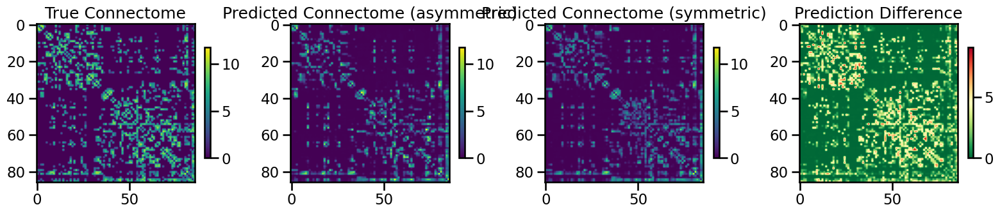

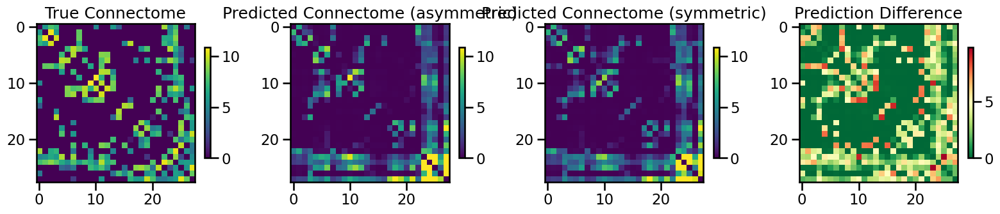

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 5.07209389203281, 'mae': 1.0467690779166112, 'r2': 0.47675096129000905, 'pearson_corr': 0.7384529654384906, 'geodesic_distance': 11.809431923340258}
TEST METRICS: {'mse': 10.454693692389824, 'mae': 1.983428649494913, 'r2': 0.14792951320418812, 'pearson_corr': 0.5153524466458375, 'geodesic_distance': 7.093028887098752}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.20349453150969665, 'learning_rate': 9.095823741276294e-05, 'weight_decay': 0.0003422995047214783, 'batch_size': 502, 'epochs': 131, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▂▂▁▁▁█▁▆▂
test_pearson,▁▃▃▁▃▃▄▄▃▃▄▃▄▄▄▅▄▅▆▅▇▆▆▇▅▆▆▇▆▇▇▇█▄▇▇▆▆██
train_mse_loss,███▇▇▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▃▃▃▃▄▄▄▄▄▄▄▄▄▄▅▅▅▅▆▇▇▇▇▇▇▇█████████████
best_val_loss,0
test_mse_loss,0.19952
test_pearson,0.5044
train_mse_loss,0.09021
train_pearson,0.8034


Final evaluation metrics logged successfully.
CPU Usage: 1.5%
RAM Usage: 4.0%
Available RAM: 966.8G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  9% |

 Test fold num: 4 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: vpcawgsj
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/vpcawgsj


wandb: Agent Starting Run: qnot6dj7 with config:
wandb: 	batch_size: 495
wandb: 	dropout_rate: 0.24340242043864335
wandb: 	epochs: 139
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.496260796263182e-05
wandb: 	weight_decay: 0.00043516349800571465
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/139, Train Loss: 0.2026, Val Loss: 0.1948
Epoch 10/139, Train Loss: 0.1967, Val Loss: 0.2047
Epoch 15/139, Train Loss: 0.1943, Val Loss: 0.1937
Epoch 20/139, Train Loss: 0.1932, Val Loss: 0.1995
Epoch 25/139, Train Loss: 0.1920, Val Loss: 0.1983
Epoch 30/139, Train Loss: 0.1913, Val Loss: 0.1942
Epoch 35/139, Train Loss: 0.1935, Val Loss: 0.1969
Epoch 40/139, Train Loss: 0.1878, Val Loss: 0.1931
Epoch 45/139, Train Loss: 0.1874, Val Loss: 0.1948
Epoch 50/139, Train Loss: 0.1873, Val Loss: 0.1922
Epoch 55/139, Train Loss: 0.1836, Val Loss: 0.1942
Epoch 60/139, Train Loss: 0.1889, Val Loss: 0.1940
Epoch 65/139, Train Loss: 0.1849, Val Loss: 0.1910
Epoch 70/139, Train Loss: 0.1842, Val Loss: 0.1901
Epoch 75/139, Train Loss: 0.1857, Val Loss: 0.1914
Epoch 80/139, Train Loss: 0.1870, Val Loss: 0.1933
Epoch 85/139, Train Loss: 0.1851, Val Loss: 0.1978
Epoch 90/139, Train Loss: 0.1849, Val Loss: 0.1956
Epoch 95/139

  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 115/139, Train Loss: 0.1860, Val Loss: 0.2001
Epoch 120/139, Train Loss: 0.1842, Val Loss: 0.1934
Epoch 125/139, Train Loss: 0.1824, Val Loss: 0.1934
Epoch 130/139, Train Loss: 0.1849, Val Loss: 0.1924
Epoch 135/139, Train Loss: 0.1875, Val Loss: 0.1934
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/139, Train Loss: 0.2205, Val Loss: 0.1837
Epoch 10/139, Train Loss: 0.2234, Val Loss: 0.1777
Epoch 15/139, Train Loss: 0.2188, Val Loss: 0.1756
Epoch 20/139, Train Loss: 0.2197, Val Loss: 0.1765
Epoch 25/139, Train Loss: 0.2158, Val Loss: 0.1739
Epoch 30/139, Train Loss: 0.2128, Val Loss: 0.1718
Epoch 35/139, Train Loss: 0.2128, Val Loss: 0.1795
Epoch 40/139, Train Loss: 0.2132, Val Loss: 0.1744
Epoch 45/139, Train Loss: 0.2101, Val Loss: 0.1720
Epoch 50/139, Train Loss: 0.2116, Val Loss: 0.1753
Epoch 55/139, Train Loss: 0.2101, Val Loss: 0.1723
Epoch 60/139, Train Loss: 0.2113, Val Loss: 0.1706
Epoch 65/139, Train Loss: 0.2106, Val Loss: 0.1694
Epoch 7

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▆▆▆▆▆▆▇▇▇▇▇▇█
fold0_train_loss,█▇▆▆▆▅▅▅▆▆▅▃▃▃▃▃▃▄▂▂▃▃▃▂▃▃▂▂▂▂▃▂▃▃▂▂▂▃▁▂
fold0_train_pearson,▁▃▃▄▅▅▆▆▆▅▅▇▆▆▆▆▇▇▇▆▆▆▆▇█▇▇▇▇▇█▇▇▆▇█▇█▇▇
fold0_val_loss,▅▆▃▃▅▅▃▅█▅▃▃▃▄▃▂▆▃▂▃▃▂▃▂▄▃▄▂▂▃▁▂▁▃▂▂▂▃▃▄
fold0_val_pearson,▁▄▅▇▇▇▇███▇▇▇▆▆▇▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▆▇▇▇▇▇▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇█
fold1_train_loss,█▅▅▃▄▃▃▃▃▃▂▂▃▂▃▂▃▂▁▃▃▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃
fold1_train_pearson,▁▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇█▇▇█▇▇▇█▇▇▇█▇▇▇█▇▇
fold1_val_loss,█▅▄▂▂▃▃▃▁▂▂▂▁▃▁▂▂▃▂▁▂▂▃▂▁▂▂▁▁▂▃▂▂▂▁▁▂▂▃▁
fold1_val_pearson,▁▆▇▇▅▇▇▆▅▆▇█▆▅▇▆▆▆▆▇▆▆▇▆▆▇▆▇▇▇▆▆▆▆▆▆▅▆▆▆
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇█


wandb: Agent Starting Run: pzy69zit with config:
wandb: 	batch_size: 365
wandb: 	dropout_rate: 0.13434215822935897
wandb: 	epochs: 147
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.463303180889045e-05
wandb: 	weight_decay: 0.0004160320528209228
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/147, Train Loss: 0.1978, Val Loss: 0.1944
Epoch 10/147, Train Loss: 0.1935, Val Loss: 0.2043
Epoch 15/147, Train Loss: 0.1907, Val Loss: 0.2090
Epoch 20/147, Train Loss: 0.1892, Val Loss: 0.1906


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 25/147, Train Loss: 0.1880, Val Loss: 0.2060
Epoch 30/147, Train Loss: 0.1861, Val Loss: 0.1873
Epoch 35/147, Train Loss: 0.1854, Val Loss: 0.1998
Epoch 40/147, Train Loss: 0.1849, Val Loss: 0.1926
Epoch 45/147, Train Loss: 0.1834, Val Loss: 0.1915
Epoch 50/147, Train Loss: 0.1817, Val Loss: 0.1997
Epoch 55/147, Train Loss: 0.1806, Val Loss: 0.2023
Epoch 60/147, Train Loss: 0.1808, Val Loss: 0.2078
Epoch 65/147, Train Loss: 0.1786, Val Loss: 0.2000
Epoch 70/147, Train Loss: 0.1786, Val Loss: 0.1964
Epoch 75/147, Train Loss: 0.1781, Val Loss: 0.1840
Epoch 80/147, Train Loss: 0.1759, Val Loss: 0.2037
Epoch 85/147, Train Loss: 0.1747, Val Loss: 0.2131
Epoch 90/147, Train Loss: 0.1759, Val Loss: 0.1769
Epoch 95/147, Train Loss: 0.1753, Val Loss: 0.2065
Epoch 100/147, Train Loss: 0.1754, Val Loss: 0.2066
Epoch 105/147, Train Loss: 0.1736, Val Loss: 0.1998
Epoch 110/147, Train Loss: 0.1748, Val Loss: 0.1844
Epoch 115/147, Train Loss: 0.1745, Val Loss: 0.1815
Epoch 120/147, Train Loss: 

fold0_epoch,▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇██
fold0_train_loss,█▆▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▁▂▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▄▄▄▄▄▅▄▄▅▅▅▆▆▆▆▆▇▇▇▇███▇█▇▇████▇███▇██
fold0_val_loss,█▂▃▃▃▄▄▅▂▁▃▂▃▃▃▂▄▃▄▁▂▂▄▂▄▂▄▃▃▃▂▁▁▃▃▃▂▄▃▁
fold0_val_pearson,▁▅▅▇▇▇▆▇▇▇▇▄▇▇▆▇▆▇▇▇▇▇▇▇▇█▇▇▇█▇▇█▇▇▇▇█▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,███▆▅▆▅▄▄▃▂▃▃▂▂▂▂▃▂▂▂▃▃▂▂▂▂▂▂▃▂▃▂▂▁▂▃▂▃▂
fold1_train_pearson,▃▃▁▂▃▃▅▅▆▅▇▆▇▆▆▆▇▆▇▇▆▇▇▇▆▇█▇▇▇▇█▇▇▆▇▇▇▇▆
fold1_val_loss,▂▅▄█▅▇▄▅▆▂▆▃▅▄▃▂▃▄▃▅▄▅▄▂▃▇▂▄▆▄▃▆▄▃▅▁▂▃▄▆
fold1_val_pearson,▂█▄▃▅▃▇▅▄▅▂▄▄▃▅▄▃▄▆▄▄▄▄▁▆▃▅▄▃▄▂▅▃▃▄▃▄▃▅▃
fold2_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇█


wandb: Agent Starting Run: 1fy1wtfc with config:
wandb: 	batch_size: 457
wandb: 	dropout_rate: 0.15582216664065582
wandb: 	epochs: 101
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.590528244207389e-05
wandb: 	weight_decay: 0.00033172038622202276
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/101, Train Loss: 0.2003, Val Loss: 0.2061
Epoch 10/101, Train Loss: 0.1971, Val Loss: 0.2114
Epoch 15/101, Train Loss: 0.1957, Val Loss: 0.2040
Epoch 20/101, Train Loss: 0.1934, Val Loss: 0.2117
Epoch 25/101, Train Loss: 0.1923, Val Loss: 0.2058
Epoch 30/101, Train Loss: 0.1910, Val Loss: 0.2002
Epoch 35/101, Train Loss: 0.1906, Val Loss: 0.1993
Epoch 40/101, Train Loss: 0.1893, Val Loss: 0.1987
Epoch 45/101, Train Loss: 0.1885, Val Loss: 0.2010
Epoch 50/101, Train Loss: 0.1876, Val Loss: 0.2024
Epoch 55/101, Train Loss: 0.1870, Val Loss: 0.1962
Epoch 60/101, Train Loss: 0.1863, Val Loss: 0.1965
Epoch 65/101, Train Loss: 0.1853, Val Loss: 0.2014
Epoch 70/101, Train Loss: 0.1839, Val Loss: 0.2010
Epoch 75/101, Train Loss: 0.1838, Val Loss: 0.1955
Epoch 80/101, Train Loss: 0.1828, Val Loss: 0.1967
Epoch 85/101, Train Loss: 0.1824, Val Loss: 0.1955
Epoch 90/101, Train Loss: 0.1823, Val Loss: 0.1964
Epoch 95/101

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 10/101, Train Loss: 0.2180, Val Loss: 0.1801
Epoch 15/101, Train Loss: 0.2166, Val Loss: 0.1731
Epoch 20/101, Train Loss: 0.2151, Val Loss: 0.1705
Epoch 25/101, Train Loss: 0.2135, Val Loss: 0.1787
Epoch 30/101, Train Loss: 0.2123, Val Loss: 0.1755
Epoch 35/101, Train Loss: 0.2114, Val Loss: 0.1815
Epoch 40/101, Train Loss: 0.2120, Val Loss: 0.1798
Epoch 45/101, Train Loss: 0.2114, Val Loss: 0.1784
Epoch 50/101, Train Loss: 0.2108, Val Loss: 0.1744
Epoch 55/101, Train Loss: 0.2111, Val Loss: 0.1764
Epoch 60/101, Train Loss: 0.2106, Val Loss: 0.1784
Epoch 65/101, Train Loss: 0.2117, Val Loss: 0.1766
Epoch 70/101, Train Loss: 0.2107, Val Loss: 0.1762
Epoch 75/101, Train Loss: 0.2107, Val Loss: 0.1794
Epoch 80/101, Train Loss: 0.2110, Val Loss: 0.1768
Epoch 85/101, Train Loss: 0.2105, Val Loss: 0.1762
Epoch 90/101, Train Loss: 0.2104, Val Loss: 0.1771
Epoch 95/101, Train Loss: 0.2107, Val Loss: 0.1774
Epoch 100/101, Train Loss: 0.2101, Val Loss: 0.1773
Processing inner fold 2
Number

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▆▆▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▂▄▃▃▄▄▃▅▄▅▄▅▅▅▅▅▅▆▅▅▅▇▆▆▇▆▇█▇▆██▇▇███
fold0_val_loss,▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▃▃▇▇▇▇▇█▇▇▇▁█▅███▇█▇▇▇▇▇▇██████████████
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇█
fold1_train_loss,█▆▅▅▄▃▃▂▂▂▂▁▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
fold1_train_pearson,▁▃▄▃▆▄▆▆▆▆▆▇▆█▇▆▆▇▇█▇▇▆▇▇▇▆▇▆▇█▇██▇▇▆▇█▇
fold1_val_loss,▁▂▃▄▆▃█▄▁▃▅▄▆▄▆▇▅▅▅▄▄▅▄▆▃▄▄▅▄▆▄▄▄▅▄▄▂▄▅▅
fold1_val_pearson,▁▁▆▇▇▂▇█▆▇▄▅▇█▇▇████▇▇██▇███▇██████████▇
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 139, 'input_dim': 21526, 'batch_size': 495, 'hidden_dims': [256, 128], 'dropout_rate': 0.24340242043864335, 'weight_decay': 0.00043516349800571465, 'learning_rate': 5.496260796263182e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/139, Train Loss: 0.2019, Val Loss: 0.1849
Epoch 10/139, Train Loss: 0.1979, Val Loss: 0.1751
Epoch 15/139, Train Loss: 0.1946, Val Loss: 0.1664
Epoch 20/139, Train Loss: 0.1933, Val Loss: 0.1769
Epoch 25/139, Train Loss: 0.1909, Val Loss: 0.1665
Epoch 30/139, Train Loss: 0.1903, Val Loss: 0.1761
Epoch 35/139, Train Loss: 0.1871, Val Loss: 0.1678
Epoch 40/139, Train Loss: 0.1868, Val Loss: 0.1738
Epoch 45/139, Train Loss: 0.1856, Val Loss: 0.1709
Epoch 50/139, Train Loss: 0.1850, Val Loss: 0.1721
Epoch 55/139, Train Loss: 0.1830, Val Loss: 0.1720
Epoch 60/139, Train Loss: 0.1828, Val Loss: 0.1703
Epoch 65/139, Train Loss: 0.1828, Val Loss: 0.1747
Epoch 70/139, Train Loss: 0.1824, Val Loss: 0.1706
Epoch 75/139, Train Loss: 0.1

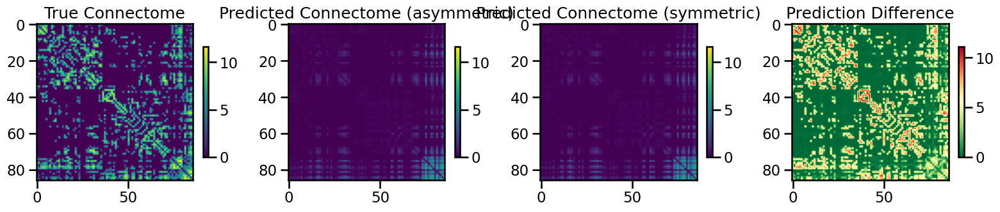

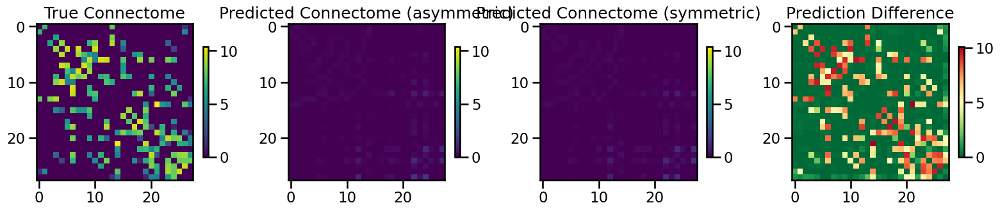

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 11.67533209504285, 'mae': 1.7922737963188315, 'r2': -0.0964852389802977, 'pearson_corr': 0.44856635186863464, 'geodesic_distance': 34.55734543866313}
TEST METRICS: {'mse': 12.092979430109413, 'mae': 1.749015117492581, 'r2': -0.26042382325867774, 'pearson_corr': 0.2653393679080333, 'geodesic_distance': 20.41011801619089}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.24340242043864335, 'learning_rate': 5.496260796263182e-05, 'weight_decay': 0.00043516349800571465, 'batch_size': 495, 'epochs': 139, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▆▇█▃▆▃▇▄▅▅▄▃▄▆▅▄▅▃▁▃▄▃▁▂▄▄▆▃▄▂▃▃▄▃▃▅▂▄▂▂
test_pearson,▁▅█▇█▆▆▆▇▆▅▆▄▆▃▆▆▅▄▆▆▆▆▆▆▆▆▅▆▆▆▆▆▆▆▆▆▅▆▆
train_mse_loss,█▆▅▅▅▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▃▅▅▅▅▆▆▆▆▇▆▇▆▇▇▇▇▇▇█▇▇▇▇█████▇█████████
best_val_loss,0
test_mse_loss,0.17226
test_pearson,0.27548
train_mse_loss,0.18097
train_pearson,0.40565


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 4.0%
Available RAM: 966.6G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  9% |


  gc.collect()



Running simulation with: dynamic_mlp, random, S400, FC, seed=1
Number of components for 95% variance PCA: 105
X shape: (214, 7380)
X_pca shape: (214, 105)
Y_sc shape: (214, 214)
Y_sc_spectralL shape: (214, 222)
Y_sc_spectralA shape: (214, 223)
Y_fc shape: (214, 214)
Coordinates shape: (214, 3)
Y shape (214, 214)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (214, 7383)

 Test fold num: 1 X_train shape: (25440, 14766) Y_train shape: (25440,) X_test shape: (2862, 14766) Y_test shape: (2862,)
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: rcus5p8v
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/rcus5p8v


wandb: Agent Starting Run: tw3asid7 with config:
wandb: 	batch_size: 445
wandb: 	dropout_rate: 0.16025641118247574
wandb: 	epochs: 144
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 8.225102450747624e-05
wandb: 	weight_decay: 9.838239858869576e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/144, Train Loss: 0.0225, Val Loss: 0.0120
Epoch 10/144, Train Loss: 0.0201, Val Loss: 0.0099
Epoch 15/144, Train Loss: 0.0189, Val Loss: 0.0090
Epoch 20/144, Train Loss: 0.0180, Val Loss: 0.0094
Epoch 25/144, Train Loss: 0.0173, Val Loss: 0.0111
Epoch 30/144, Train Loss: 0.0154, Val Loss: 0.0086
Epoch 35/144, Train Loss: 0.0153, Val Loss: 0.0084
Epoch 40/144, Train Loss: 0.0149, Val Loss: 0.0087


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 45/144, Train Loss: 0.0137, Val Loss: 0.0083
Epoch 50/144, Train Loss: 0.0132, Val Loss: 0.0081
Epoch 55/144, Train Loss: 0.0128, Val Loss: 0.0081
Epoch 60/144, Train Loss: 0.0124, Val Loss: 0.0079
Epoch 65/144, Train Loss: 0.0114, Val Loss: 0.0078
Epoch 70/144, Train Loss: 0.0109, Val Loss: 0.0074
Epoch 75/144, Train Loss: 0.0100, Val Loss: 0.0074
Epoch 80/144, Train Loss: 0.0102, Val Loss: 0.0074
Epoch 85/144, Train Loss: 0.0100, Val Loss: 0.0081
Epoch 90/144, Train Loss: 0.0092, Val Loss: 0.0072
Epoch 95/144, Train Loss: 0.0088, Val Loss: 0.0074
Epoch 100/144, Train Loss: 0.0084, Val Loss: 0.0076
Epoch 105/144, Train Loss: 0.0080, Val Loss: 0.0074
Epoch 110/144, Train Loss: 0.0075, Val Loss: 0.0074
Epoch 115/144, Train Loss: 0.0074, Val Loss: 0.0073
Epoch 120/144, Train Loss: 0.0069, Val Loss: 0.0072
Epoch 125/144, Train Loss: 0.0065, Val Loss: 0.0072
Epoch 130/144, Train Loss: 0.0064, Val Loss: 0.0072
Epoch 135/144, Train Loss: 0.0061, Val Loss: 0.0074
Epoch 140/144, Train Lo

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇█████
fold0_train_loss,█▆▆▅▅▅▅▄▅▅▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▂▁▂▂▂▂▂▂▂▃▂▃▂▃▃▃▃▄▄▅▅▄▅▅▆▆▆▆▇▇▇▇▇█▇██
fold0_val_loss,█▆▃▂▃▃▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁
fold0_val_pearson,▃▄▃▃▄▅▅▅▅▅▅▅▄▅▅▅▅▅▆▆▆▁▆▇▇▆▇▇▇▇▇▇█▇▅▇█▇▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇██
fold1_train_loss,█▇▆▅▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▂▂▃▄▄▄▄▅▆▆▆▇▇▇████████████████████████
fold1_val_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▄▆▆▇▇▇▇█▆▇▇████▇████▇███████████▇████▇█
fold2_epoch,▁▁▁▁▂▂▂▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇█████


wandb: Agent Starting Run: tzp8fcv2 with config:
wandb: 	batch_size: 449
wandb: 	dropout_rate: 0.1889280621597764
wandb: 	epochs: 174
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.886282703506304e-05
wandb: 	weight_decay: 0.000317013880061797
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/174, Train Loss: 0.0220, Val Loss: 0.0108
Epoch 10/174, Train Loss: 0.0184, Val Loss: 0.0094
Epoch 15/174, Train Loss: 0.0161, Val Loss: 0.0085
Epoch 20/174, Train Loss: 0.0146, Val Loss: 0.0083
Epoch 25/174, Train Loss: 0.0128, Val Loss: 0.0078
Epoch 30/174, Train Loss: 0.0113, Val Loss: 0.0085


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 35/174, Train Loss: 0.0099, Val Loss: 0.0088
Epoch 40/174, Train Loss: 0.0084, Val Loss: 0.0079
Epoch 45/174, Train Loss: 0.0077, Val Loss: 0.0092
Epoch 50/174, Train Loss: 0.0069, Val Loss: 0.0074
Epoch 55/174, Train Loss: 0.0068, Val Loss: 0.0074
Epoch 60/174, Train Loss: 0.0065, Val Loss: 0.0074
Epoch 65/174, Train Loss: 0.0062, Val Loss: 0.0073
Epoch 70/174, Train Loss: 0.0062, Val Loss: 0.0072
Epoch 75/174, Train Loss: 0.0062, Val Loss: 0.0073
Epoch 80/174, Train Loss: 0.0061, Val Loss: 0.0076
Epoch 85/174, Train Loss: 0.0060, Val Loss: 0.0073
Epoch 90/174, Train Loss: 0.0059, Val Loss: 0.0073
Epoch 95/174, Train Loss: 0.0057, Val Loss: 0.0074
Epoch 100/174, Train Loss: 0.0058, Val Loss: 0.0073
Epoch 105/174, Train Loss: 0.0057, Val Loss: 0.0074
Epoch 110/174, Train Loss: 0.0057, Val Loss: 0.0073
Epoch 115/174, Train Loss: 0.0056, Val Loss: 0.0073
Epoch 120/174, Train Loss: 0.0058, Val Loss: 0.0073
Epoch 125/174, Train Loss: 0.0056, Val Loss: 0.0073
Epoch 130/174, Train Loss

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▆▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▇▇▆▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▂▂▃▄▄▄▅▆▆▇▇▇▇▇▇█▇▇███████████████████
fold0_val_loss,█▅▅▆▆▃▃▃▃▆▂▃▂▃▁▁▁▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁
fold0_val_pearson,▁▄▄▅▅▆▆▅▇▇██████████████████████████████
fold1_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇█████
fold1_train_loss,█▇▇▇▅▅▅▄▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▂▂▂▄▅▅▆▆▆▇▇▇▇▇▇███████████████████████
fold1_val_loss,▂▂▂▂▁▁▁▂▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▄▅▅▅▆▃▇▇▄▇▇█▇█▇███▇██████▇█▇▇██▇███▇█▇█
fold2_epoch,▁▁▁▁▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇███


wandb: Agent Starting Run: 6wiqrqmf with config:
wandb: 	batch_size: 484
wandb: 	dropout_rate: 0.13081862238287906
wandb: 	epochs: 151
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 7.155292268063702e-05
wandb: 	weight_decay: 0.0002035414796851883
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/151, Train Loss: 0.0190, Val Loss: 0.0107
Epoch 10/151, Train Loss: 0.0167, Val Loss: 0.0103
Epoch 15/151, Train Loss: 0.0145, Val Loss: 0.0083
Epoch 20/151, Train Loss: 0.0130, Val Loss: 0.0091


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 25/151, Train Loss: 0.0116, Val Loss: 0.0088
Epoch 30/151, Train Loss: 0.0102, Val Loss: 0.0085
Epoch 35/151, Train Loss: 0.0091, Val Loss: 0.0088
Epoch 40/151, Train Loss: 0.0078, Val Loss: 0.0086
Epoch 45/151, Train Loss: 0.0076, Val Loss: 0.0082
Epoch 50/151, Train Loss: 0.0073, Val Loss: 0.0083
Epoch 55/151, Train Loss: 0.0072, Val Loss: 0.0083
Epoch 60/151, Train Loss: 0.0072, Val Loss: 0.0082
Epoch 65/151, Train Loss: 0.0071, Val Loss: 0.0081
Epoch 70/151, Train Loss: 0.0070, Val Loss: 0.0082
Epoch 75/151, Train Loss: 0.0069, Val Loss: 0.0081
Epoch 80/151, Train Loss: 0.0070, Val Loss: 0.0081
Epoch 85/151, Train Loss: 0.0070, Val Loss: 0.0082
Epoch 90/151, Train Loss: 0.0070, Val Loss: 0.0081
Epoch 95/151, Train Loss: 0.0071, Val Loss: 0.0081
Epoch 100/151, Train Loss: 0.0070, Val Loss: 0.0081
Epoch 105/151, Train Loss: 0.0070, Val Loss: 0.0082
Epoch 110/151, Train Loss: 0.0069, Val Loss: 0.0082
Epoch 115/151, Train Loss: 0.0070, Val Loss: 0.0081
Epoch 120/151, Train Loss: 

fold0_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▇▅▅▅▄▄▄▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▃▄▆▆▇▇███████████████████████████████
fold0_val_loss,█▃▂▂▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▂▁▃▅▆▆▇▆▇▆██████████████████████████████
fold1_epoch,▁▁▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇████
fold1_train_loss,█▆▅▅▅▄▄▃▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▃▃▄▄▅▅▅▅▆▇▇▇▇▇▇▇▇██████████████████████
fold1_val_loss,█▆▄▄▃▁▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▂▃▆▇▇▆▇▇▇▇█▇▇██████████████████████████
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 174, 'input_dim': 14766, 'batch_size': 449, 'hidden_dims': [256, 128], 'dropout_rate': 0.1889280621597764, 'weight_decay': 0.000317013880061797, 'learning_rate': 6.886282703506304e-05}
Number of learnable parameters in MLP: 3814145
Epoch 5/174, Train Loss: 0.0180, Val Loss: 0.0095
Epoch 10/174, Train Loss: 0.0140, Val Loss: 0.0089
Epoch 15/174, Train Loss: 0.0108, Val Loss: 0.0118
Epoch 20/174, Train Loss: 0.0084, Val Loss: 0.0104
Epoch 25/174, Train Loss: 0.0064, Val Loss: 0.0081
Epoch 30/174, Train Loss: 0.0048, Val Loss: 0.0102
Epoch 35/174, Train Loss: 0.0041, Val Loss: 0.0078
Epoch 40/174, Train Loss: 0.0033, Val Loss: 0.0074
Epoch 45/174, Train Loss: 0.0030, Val Loss: 0.0076
Epoch 50/174, Train Loss: 0.0029, Val Loss: 0.0076
Epoch 55/174, Train Loss: 0.0028, Val Loss: 0.0078
Epoch 60/174, Train Loss: 0.0028, Val Loss: 0.0079
Epoch 65/174, Train Loss: 0.0027, Val Loss: 0.0079
Epoch 70/174, Train Loss: 0.0027, Val Loss: 0.0079
Epoch 75/174, Train Loss: 0.0026

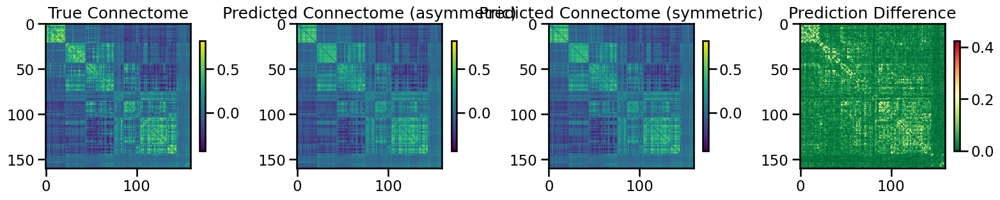

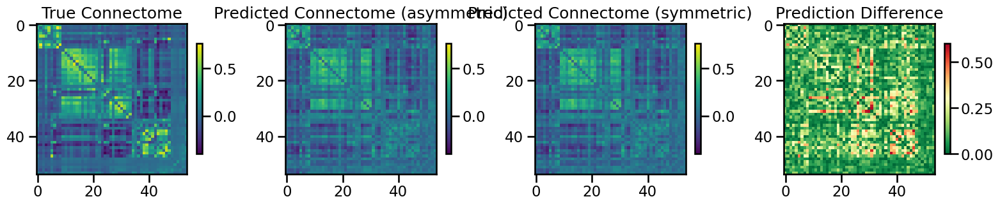

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0026324750849628254, 'mae': 0.034782820852416504, 'r2': 0.9254150188546583, 'pearson_corr': 0.9642918590973079, 'geodesic_distance': 12.30106447580331}
TEST METRICS: {'mse': 0.02491855587880085, 'mae': 0.11771800337494698, 'r2': 0.3244696892606651, 'pearson_corr': 0.5874767923938843, 'geodesic_distance': 9.402061811049439}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [256, 128], 'dropout_rate': 0.1889280621597764, 'learning_rate': 6.886282703506304e-05, 'weight_decay': 0.000317013880061797, 'batch_size': 449, 'epochs': 174, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▄▃▂▂▂▁▁▁▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▃▂▂▂▂▃▂▂▂▂▂
test_pearson,▁▁▆▆▆▃██▆▅▇▆██████▇█████████████████████
train_mse_loss,█▅▅▅▄▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▃▃▄▅▅▆▆▇██████████████████████████████
best_val_loss,0
test_mse_loss,0.00772
test_pearson,0.59251
train_mse_loss,0.0026
train_pearson,0.91277


Final evaluation metrics logged successfully.
CPU Usage: 1.8%
RAM Usage: 5.2%
Available RAM: 954.5G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 14% |

 Test fold num: 2 X_train shape: (25440, 14766) Y_train shape: (25440,) X_test shape: (2862, 14766) Y_test shape: (2862,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: cjoq8dth
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/cjoq8dth


wandb: Agent Starting Run: gyronr3j with config:
wandb: 	batch_size: 442
wandb: 	dropout_rate: 0.16866485241928705
wandb: 	epochs: 160
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.1712796227966497e-05
wandb: 	weight_decay: 0.00041125784179221465
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/160, Train Loss: 0.0234, Val Loss: 0.0124
Epoch 10/160, Train Loss: 0.0201, Val Loss: 0.0106
Epoch 15/160, Train Loss: 0.0179, Val Loss: 0.0101
Epoch 20/160, Train Loss: 0.0162, Val Loss: 0.0097
Epoch 25/160, Train Loss: 0.0148, Val Loss: 0.0092
Epoch 30/160, Train Loss: 0.0133, Val Loss: 0.0089


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 35/160, Train Loss: 0.0121, Val Loss: 0.0090
Epoch 40/160, Train Loss: 0.0111, Val Loss: 0.0084
Epoch 45/160, Train Loss: 0.0099, Val Loss: 0.0085
Epoch 50/160, Train Loss: 0.0089, Val Loss: 0.0083
Epoch 55/160, Train Loss: 0.0082, Val Loss: 0.0090
Epoch 60/160, Train Loss: 0.0073, Val Loss: 0.0079
Epoch 65/160, Train Loss: 0.0066, Val Loss: 0.0088
Epoch 70/160, Train Loss: 0.0059, Val Loss: 0.0087
Epoch 75/160, Train Loss: 0.0053, Val Loss: 0.0085
Epoch 80/160, Train Loss: 0.0049, Val Loss: 0.0090
Epoch 85/160, Train Loss: 0.0046, Val Loss: 0.0087
Epoch 90/160, Train Loss: 0.0043, Val Loss: 0.0082
Epoch 95/160, Train Loss: 0.0036, Val Loss: 0.0080
Epoch 100/160, Train Loss: 0.0035, Val Loss: 0.0083
Epoch 105/160, Train Loss: 0.0035, Val Loss: 0.0081
Epoch 110/160, Train Loss: 0.0033, Val Loss: 0.0082
Epoch 115/160, Train Loss: 0.0034, Val Loss: 0.0083
Epoch 120/160, Train Loss: 0.0034, Val Loss: 0.0083
Epoch 125/160, Train Loss: 0.0034, Val Loss: 0.0083
Epoch 130/160, Train Loss

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇█
fold0_train_loss,█▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▂▂▃▃▃▄▄▄▅▅▆▆▇▇▇▇▇▇███████████████████
fold0_val_loss,█▄▃▃▂▂▃▂▁▂▁▂▁▁▂▂▁▁▁▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▄▅▅▅▇▇▇▇▆█▇███▇▇▆██████████████████████
fold1_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇████
fold1_train_loss,█▆▅▄▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▃▃▄▄▄▄▆▇▇▇▇▇▇█▇██████████████████████
fold1_val_loss,█▅▄▆▂▂▃▂▂▂▂▂▁▁▁▁▁▁▂▁▂▂▂▁▁▁▁▂▁▂▁▂▁▂▁▁▁▂▂▂
fold1_val_pearson,▁▂▅▆▅▆▅▇▃▇▆▇▄▇█▇█▇███▇█▇██▇██████▇▇█▇███
fold2_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇██


wandb: Agent Starting Run: adh4b77b with config:
wandb: 	batch_size: 440
wandb: 	dropout_rate: 0.27346516651421415
wandb: 	epochs: 137
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.464727571140846e-05
wandb: 	weight_decay: 0.0004091277633949128
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/137, Train Loss: 0.0273, Val Loss: 0.0114
Epoch 10/137, Train Loss: 0.0222, Val Loss: 0.0109
Epoch 15/137, Train Loss: 0.0198, Val Loss: 0.0099
Epoch 20/137, Train Loss: 0.0168, Val Loss: 0.0096


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 25/137, Train Loss: 0.0150, Val Loss: 0.0093
Epoch 30/137, Train Loss: 0.0135, Val Loss: 0.0094
Epoch 35/137, Train Loss: 0.0121, Val Loss: 0.0084
Epoch 40/137, Train Loss: 0.0110, Val Loss: 0.0088
Epoch 45/137, Train Loss: 0.0098, Val Loss: 0.0088
Epoch 50/137, Train Loss: 0.0086, Val Loss: 0.0086
Epoch 55/137, Train Loss: 0.0077, Val Loss: 0.0089
Epoch 60/137, Train Loss: 0.0067, Val Loss: 0.0090
Epoch 65/137, Train Loss: 0.0060, Val Loss: 0.0091
Epoch 70/137, Train Loss: 0.0054, Val Loss: 0.0082
Epoch 75/137, Train Loss: 0.0051, Val Loss: 0.0089
Epoch 80/137, Train Loss: 0.0047, Val Loss: 0.0087
Epoch 85/137, Train Loss: 0.0044, Val Loss: 0.0083
Epoch 90/137, Train Loss: 0.0041, Val Loss: 0.0090
Epoch 95/137, Train Loss: 0.0039, Val Loss: 0.0088
Epoch 100/137, Train Loss: 0.0033, Val Loss: 0.0082
Epoch 105/137, Train Loss: 0.0032, Val Loss: 0.0081
Epoch 110/137, Train Loss: 0.0031, Val Loss: 0.0081
Epoch 115/137, Train Loss: 0.0031, Val Loss: 0.0081
Epoch 120/137, Train Loss: 

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇████
fold0_train_loss,█▇▆▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▁▂▂▂▂▃▃▃▃▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇██████████
fold0_val_loss,█▆▆▆▄▄▃▃▄▃▃▂▂▂▄▃▃▃▃▂▂▁▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂
fold0_val_pearson,▁▂▂▁▁▆▅▇▇▇▆▇▆▅▇▅▅▇█▆▆▄▇▅█▇▇█▇▇▇▇▇▇▇▇▇▇▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇███
fold1_train_loss,██▇▇▆▅▅▅▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▂▂▃▄▄▄▄▅▅▅▆▆▇▇███████████████████████
fold1_val_loss,█▅▃▃▄▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▂▃▄▃▅▆▆▇▇█▇▇█▇█▇█▇▅█▇▇████▇████████████
fold2_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇███


wandb: Agent Starting Run: l8o66e31 with config:
wandb: 	batch_size: 413
wandb: 	dropout_rate: 0.27945760811820963
wandb: 	epochs: 156
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 8.017764323108266e-05
wandb: 	weight_decay: 6.050380042374849e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/156, Train Loss: 0.0255, Val Loss: 0.0123
Epoch 10/156, Train Loss: 0.0211, Val Loss: 0.0107


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 15/156, Train Loss: 0.0177, Val Loss: 0.0097
Epoch 20/156, Train Loss: 0.0153, Val Loss: 0.0094
Epoch 25/156, Train Loss: 0.0132, Val Loss: 0.0088
Epoch 30/156, Train Loss: 0.0116, Val Loss: 0.0102
Epoch 35/156, Train Loss: 0.0099, Val Loss: 0.0092
Epoch 40/156, Train Loss: 0.0084, Val Loss: 0.0092
Epoch 45/156, Train Loss: 0.0073, Val Loss: 0.0091
Epoch 50/156, Train Loss: 0.0064, Val Loss: 0.0091
Epoch 55/156, Train Loss: 0.0056, Val Loss: 0.0090
Epoch 60/156, Train Loss: 0.0049, Val Loss: 0.0091
Epoch 65/156, Train Loss: 0.0044, Val Loss: 0.0092
Epoch 70/156, Train Loss: 0.0042, Val Loss: 0.0093
Epoch 75/156, Train Loss: 0.0039, Val Loss: 0.0088
Epoch 80/156, Train Loss: 0.0036, Val Loss: 0.0091
Epoch 85/156, Train Loss: 0.0035, Val Loss: 0.0090
Epoch 90/156, Train Loss: 0.0035, Val Loss: 0.0090
Epoch 95/156, Train Loss: 0.0035, Val Loss: 0.0091
Epoch 100/156, Train Loss: 0.0034, Val Loss: 0.0091
Epoch 105/156, Train Loss: 0.0034, Val Loss: 0.0091
Epoch 110/156, Train Loss: 0.

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇███
fold0_train_loss,█▆▆▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▂▃▄▅▅▆▆▇▇█████████████████████████████
fold0_val_loss,█▃▃▄▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▆▇▇█████▇▇▇▇███████████████████████████
fold1_epoch,▁▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
fold1_train_loss,█▆▅▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▃▄▄▅▅▅▅▆▆▆▇▇▇▇███████████████████████
fold1_val_loss,▆█▅▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▁▃▄▆▆▆▇▆▇▇▆▇▇▆█████████████████████████
fold2_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▆▆▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 160, 'input_dim': 14766, 'batch_size': 442, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.16866485241928705, 'weight_decay': 0.00041125784179221465, 'learning_rate': 5.1712796227966497e-05}
Number of learnable parameters in MLP: 7726849
Epoch 5/160, Train Loss: 0.0190, Val Loss: 0.0094
Epoch 10/160, Train Loss: 0.0152, Val Loss: 0.0082
Epoch 15/160, Train Loss: 0.0126, Val Loss: 0.0074
Epoch 20/160, Train Loss: 0.0104, Val Loss: 0.0073
Epoch 25/160, Train Loss: 0.0083, Val Loss: 0.0073
Epoch 30/160, Train Loss: 0.0067, Val Loss: 0.0071
Epoch 35/160, Train Loss: 0.0053, Val Loss: 0.0071
Epoch 40/160, Train Loss: 0.0043, Val Loss: 0.0071
Epoch 45/160, Train Loss: 0.0040, Val Loss: 0.0083
Epoch 50/160, Train Loss: 0.0037, Val Loss: 0.0074
Epoch 55/160, Train Loss: 0.0029, Val Loss: 0.0062
Epoch 60/160, Train Loss: 0.0026, Val Loss: 0.0060
Epoch 65/160, Train Loss: 0.0025, Val Loss: 0.0061
Epoch 70/160, Train Loss: 0.0024, Val Loss: 0.0061
Epoch 75/160, Train Los

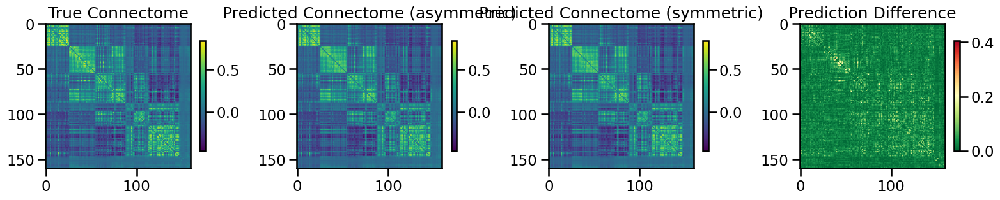

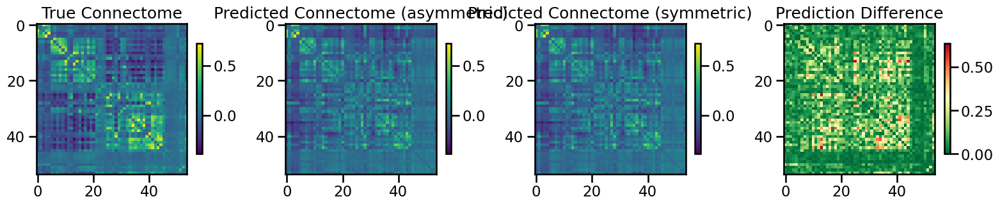

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.001342710810680662, 'mae': 0.027062578255897526, 'r2': 0.9651860921396469, 'pearson_corr': 0.9837494530770324, 'geodesic_distance': 10.294298638871469}
TEST METRICS: {'mse': 0.018976148389030698, 'mae': 0.09838304222484635, 'r2': 0.3284431002132905, 'pearson_corr': 0.5935806259994073, 'geodesic_distance': 10.674418208090572}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.16866485241928705, 'learning_rate': 5.1712796227966497e-05, 'weight_decay': 0.00041125784179221465, 'batch_size': 442, 'epochs': 160, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▃▂▂▂▂▂▂▂▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▁▃▃▅▄▅▅▆▅▅▅▆▆▄▄▄▅███▇▇███▇██████████████
train_mse_loss,█▇▆▅▅▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▂▃▄▅▆▆▇▇▇▇▇█▇█████████████████████████
best_val_loss,0
test_mse_loss,0.00611
test_pearson,0.59383
train_mse_loss,0.00222
train_pearson,0.91045


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 5.2%
Available RAM: 954.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 18% |

 Test fold num: 3 X_train shape: (25760, 14766) Y_train shape: (25760,) X_test shape: (2756, 14766) Y_test shape: (2756,)
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: bblrjpo9
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/bblrjpo9


wandb: Agent Starting Run: to2665bq with config:
wandb: 	batch_size: 298
wandb: 	dropout_rate: 0.27394208454470326
wandb: 	epochs: 165
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 8.96979516033976e-05
wandb: 	weight_decay: 0.00012943051548891876
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/165, Train Loss: 0.0249, Val Loss: 0.0106
Epoch 10/165, Train Loss: 0.0201, Val Loss: 0.0096
Epoch 15/165, Train Loss: 0.0163, Val Loss: 0.0098
Epoch 20/165, Train Loss: 0.0135, Val Loss: 0.0094
Epoch 25/165, Train Loss: 0.0111, Val Loss: 0.0082


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 30/165, Train Loss: 0.0090, Val Loss: 0.0082
Epoch 35/165, Train Loss: 0.0077, Val Loss: 0.0089
Epoch 40/165, Train Loss: 0.0065, Val Loss: 0.0084
Epoch 45/165, Train Loss: 0.0055, Val Loss: 0.0080
Epoch 50/165, Train Loss: 0.0050, Val Loss: 0.0094
Epoch 55/165, Train Loss: 0.0049, Val Loss: 0.0088
Epoch 60/165, Train Loss: 0.0044, Val Loss: 0.0081
Epoch 65/165, Train Loss: 0.0039, Val Loss: 0.0081
Epoch 70/165, Train Loss: 0.0038, Val Loss: 0.0080
Epoch 75/165, Train Loss: 0.0038, Val Loss: 0.0078
Epoch 80/165, Train Loss: 0.0038, Val Loss: 0.0078
Epoch 85/165, Train Loss: 0.0036, Val Loss: 0.0080
Epoch 90/165, Train Loss: 0.0037, Val Loss: 0.0079
Epoch 95/165, Train Loss: 0.0035, Val Loss: 0.0080
Epoch 100/165, Train Loss: 0.0036, Val Loss: 0.0080
Epoch 105/165, Train Loss: 0.0036, Val Loss: 0.0080
Epoch 110/165, Train Loss: 0.0035, Val Loss: 0.0079
Epoch 115/165, Train Loss: 0.0036, Val Loss: 0.0079
Epoch 120/165, Train Loss: 0.0035, Val Loss: 0.0079
Epoch 125/165, Train Loss:

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇█████
fold0_train_loss,█▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▂▂▄▄▅▅▆▇▇▇▇▇▇▇███████████████████████
fold0_val_loss,▇█▅▄▄▅▄▃▂▃▇▂▁▁▃▃▄▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▄▄▅▇▅██▇█▆█▆▇▇█████████████████████████
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▇▇▇███
fold1_train_loss,█▅▄▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▂▃▃▃▅▆▆▇▇▇▇▇█████████████████████████
fold1_val_loss,█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▂▂▁▄▄▅▆▇▇█▆██▇▇█████████████████████████
fold2_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇███


wandb: Agent Starting Run: 4ywx8a2x with config:
wandb: 	batch_size: 494
wandb: 	dropout_rate: 0.2753333434704722
wandb: 	epochs: 137
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 8.197947831921595e-05
wandb: 	weight_decay: 0.00022225777534090545
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/137, Train Loss: 0.0270, Val Loss: 0.0299
Epoch 10/137, Train Loss: 0.0230, Val Loss: 0.0119
Epoch 15/137, Train Loss: 0.0202, Val Loss: 0.0102


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 20/137, Train Loss: 0.0171, Val Loss: 0.0097
Epoch 25/137, Train Loss: 0.0148, Val Loss: 0.0097
Epoch 30/137, Train Loss: 0.0130, Val Loss: 0.0091
Epoch 35/137, Train Loss: 0.0111, Val Loss: 0.0084
Epoch 40/137, Train Loss: 0.0096, Val Loss: 0.0105
Epoch 45/137, Train Loss: 0.0082, Val Loss: 0.0087
Epoch 50/137, Train Loss: 0.0071, Val Loss: 0.0084
Epoch 55/137, Train Loss: 0.0062, Val Loss: 0.0081
Epoch 60/137, Train Loss: 0.0055, Val Loss: 0.0080
Epoch 65/137, Train Loss: 0.0049, Val Loss: 0.0082
Epoch 70/137, Train Loss: 0.0045, Val Loss: 0.0086
Epoch 75/137, Train Loss: 0.0044, Val Loss: 0.0098
Epoch 80/137, Train Loss: 0.0041, Val Loss: 0.0107
Epoch 85/137, Train Loss: 0.0037, Val Loss: 0.0085
Epoch 90/137, Train Loss: 0.0036, Val Loss: 0.0085
Epoch 95/137, Train Loss: 0.0035, Val Loss: 0.0083
Epoch 100/137, Train Loss: 0.0035, Val Loss: 0.0085
Epoch 105/137, Train Loss: 0.0034, Val Loss: 0.0085
Epoch 110/137, Train Loss: 0.0034, Val Loss: 0.0085
Epoch 115/137, Train Loss: 0

fold0_epoch,▁▁▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▇▇▇▇▇▇████
fold0_train_loss,█▇▅▅▅▄▄▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▂▂▂▃▃▃▃▄▄▄▅▅▆▇▇▇▇▇▇██████████████████
fold0_val_loss,▅█▂▂▂▂▁▁▁▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▃▂▁▂▂▄▃▅▇▇█▅█▇█▅▆▇▇█▇▅██████▇███████████
fold1_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇█████
fold1_train_loss,█▇▇▇▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▁▂▂▂▃▃▃▃▃▄▅▄▅▆▆▇▇█████████████████████
fold1_val_loss,█▇▅▂▂▃▁▂▁▂▂▁▂▁▁▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▅▅▆▆▆▆▇▆▇▇▇▇██▇▇▇▆▇████████████████████
fold2_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇████


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: monb5n9y with config:
wandb: 	batch_size: 366
wandb: 	dropout_rate: 0.22346391120153805
wandb: 	epochs: 142
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.8610689131317606e-05
wandb: 	weight_decay: 0.00015483814476841492
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/142, Train Loss: 0.0254, Val Loss: 0.0110
Epoch 10/142, Train Loss: 0.0214, Val Loss: 0.0093


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 15/142, Train Loss: 0.0189, Val Loss: 0.0090
Epoch 20/142, Train Loss: 0.0168, Val Loss: 0.0089
Epoch 25/142, Train Loss: 0.0147, Val Loss: 0.0085
Epoch 30/142, Train Loss: 0.0129, Val Loss: 0.0085
Epoch 35/142, Train Loss: 0.0114, Val Loss: 0.0084
Epoch 40/142, Train Loss: 0.0097, Val Loss: 0.0077
Epoch 45/142, Train Loss: 0.0088, Val Loss: 0.0077
Epoch 50/142, Train Loss: 0.0076, Val Loss: 0.0078
Epoch 55/142, Train Loss: 0.0068, Val Loss: 0.0077
Epoch 60/142, Train Loss: 0.0062, Val Loss: 0.0086
Epoch 65/142, Train Loss: 0.0055, Val Loss: 0.0084
Epoch 70/142, Train Loss: 0.0048, Val Loss: 0.0087
Epoch 75/142, Train Loss: 0.0044, Val Loss: 0.0079
Epoch 80/142, Train Loss: 0.0039, Val Loss: 0.0077
Epoch 85/142, Train Loss: 0.0038, Val Loss: 0.0078
Epoch 90/142, Train Loss: 0.0036, Val Loss: 0.0076
Epoch 95/142, Train Loss: 0.0035, Val Loss: 0.0077
Epoch 100/142, Train Loss: 0.0035, Val Loss: 0.0077
Epoch 105/142, Train Loss: 0.0036, Val Loss: 0.0077
Epoch 110/142, Train Loss: 0.

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▆▆▆▆▆▆▆▇▇████
fold0_train_loss,█▇▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▂▂▂▂▃▃▃▄▄▄▅▅▆▆▇▇▇▇████████████████████
fold0_val_loss,█▃▃▃▂▂▂▂▂▂▂▂▁▂▁▂▁▁▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▅▅▅▆▆▆▄▇▇█▇▇██▇█▇▇▇▇▇██████████████████
fold1_epoch,▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇█████
fold1_train_loss,█▇▅▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▂▂▂▃▃▄▄▄▅▅▅▆▆▆▇▇▇▇▇▇██████████████████
fold1_val_loss,█▄▄▃▃▂▂▂▂▂▁▂▂▁▁▁▁▁▇▁▁▁▁▁▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▃▆▅▆▇▇▇█▇▇▇█▃██████▇█▇█▆▆▅█████████████
fold2_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 142, 'input_dim': 14766, 'batch_size': 366, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.22346391120153805, 'weight_decay': 0.00015483814476841492, 'learning_rate': 5.8610689131317606e-05}
Number of learnable parameters in MLP: 7726849
Epoch 5/142, Train Loss: 0.0198, Val Loss: 0.0094
Epoch 10/142, Train Loss: 0.0153, Val Loss: 0.0091
Epoch 15/142, Train Loss: 0.0116, Val Loss: 0.0084
Epoch 20/142, Train Loss: 0.0088, Val Loss: 0.0086
Epoch 25/142, Train Loss: 0.0067, Val Loss: 0.0086
Epoch 30/142, Train Loss: 0.0053, Val Loss: 0.0112
Epoch 35/142, Train Loss: 0.0043, Val Loss: 0.0082
Epoch 40/142, Train Loss: 0.0036, Val Loss: 0.0085
Epoch 45/142, Train Loss: 0.0032, Val Loss: 0.0096
Epoch 50/142, Train Loss: 0.0029, Val Loss: 0.0089
Epoch 55/142, Train Loss: 0.0027, Val Loss: 0.0084
Epoch 60/142, Train Loss: 0.0021, Val Loss: 0.0084
Epoch 65/142, Train Loss: 0.0021, Val Loss: 0.0085
Epoch 70/142, Train Loss: 0.0020, Val Loss: 0.0087
Epoch 75/142, Train Los

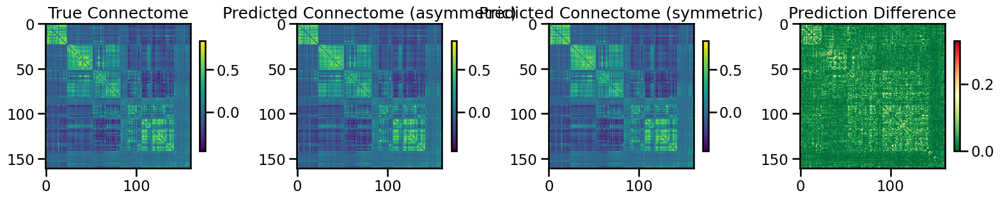

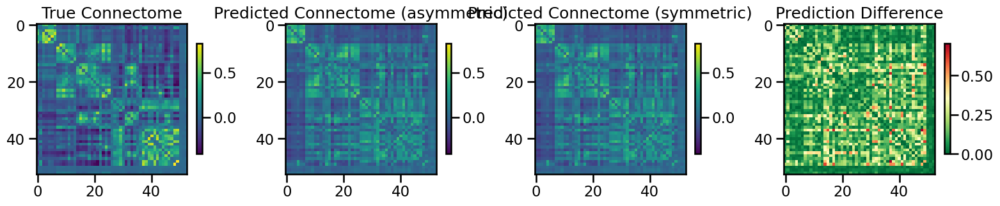

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0013387551409300106, 'mae': 0.026243450211937473, 'r2': 0.9614348541852158, 'pearson_corr': 0.9808826773205392, 'geodesic_distance': 9.75869456773328}
TEST METRICS: {'mse': 0.03020804699886512, 'mae': 0.1252276953976605, 'r2': 0.242895460917413, 'pearson_corr': 0.5458151552681908, 'geodesic_distance': 8.15541650285859}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.22346391120153805, 'learning_rate': 5.8610689131317606e-05, 'weight_decay': 0.00015483814476841492, 'batch_size': 366, 'epochs': 142, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▇▄▄▄▂▁▁▂▃█▄▄▁▃▂▁▁▁▁▂▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁
test_pearson,▂▅▅▅▆▇▇▇█▇▁▇▇▇▆▇▆██▇████████████████████
train_mse_loss,█▇▆▅▅▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▁▁▂▂▄▅▆▇▇▇▇▇██████████████████████████
best_val_loss,0
test_mse_loss,0.0087
test_pearson,0.53993
train_mse_loss,0.00185
train_pearson,0.94166


Final evaluation metrics logged successfully.
CPU Usage: 2.4%
RAM Usage: 6.5%
Available RAM: 941.3G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 4 X_train shape: (25760, 14766) Y_train shape: (25760,) X_test shape: (2756, 14766) Y_test shape: (2756,)
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: goevee78
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/goevee78


wandb: Agent Starting Run: b3gx3a1e with config:
wandb: 	batch_size: 488
wandb: 	dropout_rate: 0.238021643097371
wandb: 	epochs: 107
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 7.200124766889115e-05
wandb: 	weight_decay: 0.00040878478893529815
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/107, Train Loss: 0.0260, Val Loss: 0.0111
Epoch 10/107, Train Loss: 0.0217, Val Loss: 0.0101
Epoch 15/107, Train Loss: 0.0192, Val Loss: 0.0090
Epoch 20/107, Train Loss: 0.0168, Val Loss: 0.0092
Epoch 25/107, Train Loss: 0.0150, Val Loss: 0.0083
Epoch 30/107, Train Loss: 0.0129, Val Loss: 0.0079
Epoch 35/107, Train Loss: 0.0115, Val Loss: 0.0085


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 40/107, Train Loss: 0.0098, Val Loss: 0.0078
Epoch 45/107, Train Loss: 0.0090, Val Loss: 0.0091
Epoch 50/107, Train Loss: 0.0077, Val Loss: 0.0075
Epoch 55/107, Train Loss: 0.0069, Val Loss: 0.0072
Epoch 60/107, Train Loss: 0.0062, Val Loss: 0.0087
Epoch 65/107, Train Loss: 0.0054, Val Loss: 0.0073
Epoch 70/107, Train Loss: 0.0049, Val Loss: 0.0085
Epoch 75/107, Train Loss: 0.0044, Val Loss: 0.0068
Epoch 80/107, Train Loss: 0.0039, Val Loss: 0.0068
Epoch 85/107, Train Loss: 0.0039, Val Loss: 0.0067
Epoch 90/107, Train Loss: 0.0037, Val Loss: 0.0068
Epoch 95/107, Train Loss: 0.0035, Val Loss: 0.0068
Epoch 100/107, Train Loss: 0.0037, Val Loss: 0.0067
Epoch 105/107, Train Loss: 0.0035, Val Loss: 0.0067
Processing inner fold 1
Number of learnable parameters in MLP: 7726849
Epoch 5/107, Train Loss: 0.0238, Val Loss: 0.0093
Epoch 10/107, Train Loss: 0.0196, Val Loss: 0.0088
Epoch 15/107, Train Loss: 0.0172, Val Loss: 0.0083
Epoch 20/107, Train Loss: 0.0152, Val Loss: 0.0078
Epoch 25/1

fold0_epoch,▁▁▁▁▂▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,█▆▆▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▄▄▅▅▆▆▆▇▇▇▇▇██████████████
fold0_val_loss,█▇▄▃▃▂▂▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▂▁▁▁▂▂▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▃▄▄▄▅▅▄▆▆▆▇▅▇▇▇▇▇▇██▇▆▇▇▇▇▆▆███████████
fold1_epoch,▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,█▆▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▂▂▂▂▃▃▃▄▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███████████████
fold1_val_loss,█▆▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▂▃▁▂▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▂▄▄▄▆▆▆▆▆▇▆▇▆▆▆▇▆▆▇▇▇▆█████████████████
fold2_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇████


wandb: Agent Starting Run: vln43qin with config:
wandb: 	batch_size: 483
wandb: 	dropout_rate: 0.19872076116282428
wandb: 	epochs: 113
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.678724751611074e-05
wandb: 	weight_decay: 5.408835420206746e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/113, Train Loss: 0.0248, Val Loss: 0.0108
Epoch 10/113, Train Loss: 0.0211, Val Loss: 0.0099
Epoch 15/113, Train Loss: 0.0191, Val Loss: 0.0098
Epoch 20/113, Train Loss: 0.0170, Val Loss: 0.0088


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 25/113, Train Loss: 0.0157, Val Loss: 0.0083
Epoch 30/113, Train Loss: 0.0139, Val Loss: 0.0080
Epoch 35/113, Train Loss: 0.0126, Val Loss: 0.0080
Epoch 40/113, Train Loss: 0.0113, Val Loss: 0.0077
Epoch 45/113, Train Loss: 0.0101, Val Loss: 0.0075
Epoch 50/113, Train Loss: 0.0092, Val Loss: 0.0079
Epoch 55/113, Train Loss: 0.0080, Val Loss: 0.0075
Epoch 60/113, Train Loss: 0.0071, Val Loss: 0.0078
Epoch 65/113, Train Loss: 0.0063, Val Loss: 0.0073
Epoch 70/113, Train Loss: 0.0055, Val Loss: 0.0072
Epoch 75/113, Train Loss: 0.0050, Val Loss: 0.0076
Epoch 80/113, Train Loss: 0.0044, Val Loss: 0.0072
Epoch 85/113, Train Loss: 0.0040, Val Loss: 0.0073
Epoch 90/113, Train Loss: 0.0037, Val Loss: 0.0074
Epoch 95/113, Train Loss: 0.0034, Val Loss: 0.0072
Epoch 100/113, Train Loss: 0.0031, Val Loss: 0.0071
Epoch 105/113, Train Loss: 0.0028, Val Loss: 0.0070
Epoch 110/113, Train Loss: 0.0027, Val Loss: 0.0071
Processing inner fold 1
Number of learnable parameters in MLP: 7726849
Epoch 5/

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▇▇▇▇▇▇████
fold0_train_loss,██▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▆▆▇▇▇▇▇▇▇▇▇█████████
fold0_val_loss,█▅▄▃▃▃▃▂▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▃▄▄▅▅▅▅▅▆▆▇▇▇▇▇▇▇█▇█▆██▇▇██▇████▇██████
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█
fold1_train_loss,█▆▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▁▁▂▂▂▂▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇█████████
fold1_val_loss,█▄▄▃▃▂▃▃▂▂▂▂▂▂▂▁▁▂▁▂▁▂▂▁▂▂▂▁▁▁▁▁▁▂▂▁▁▁▁▁
fold1_val_pearson,▁▃▄▄▅▆▆▆▅▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▇▇▇▇▇▇▇█▇▇▇▇██
fold2_epoch,▁▁▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇████


wandb: Agent Starting Run: vt1mji7x with config:
wandb: 	batch_size: 267
wandb: 	dropout_rate: 0.13664363080144565
wandb: 	epochs: 144
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.647182218540801e-05
wandb: 	weight_decay: 5.233038351709646e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/144, Train Loss: 0.0182, Val Loss: 0.0104
Epoch 10/144, Train Loss: 0.0150, Val Loss: 0.0086
Epoch 15/144, Train Loss: 0.0126, Val Loss: 0.0080
Epoch 20/144, Train Loss: 0.0109, Val Loss: 0.0077
Epoch 25/144, Train Loss: 0.0092, Val Loss: 0.0075
Epoch 30/144, Train Loss: 0.0078, Val Loss: 0.0075
Epoch 35/144, Train Loss: 0.0063, Val Loss: 0.0077
Epoch 40/144, Train Loss: 0.0053, Val Loss: 0.0073
Epoch 45/144, Train Loss: 0.0045, Val Loss: 0.0074
Epoch 50/144, Train Loss: 0.0038, Val Loss: 0.0070


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 55/144, Train Loss: 0.0032, Val Loss: 0.0070
Epoch 60/144, Train Loss: 0.0029, Val Loss: 0.0073
Epoch 65/144, Train Loss: 0.0026, Val Loss: 0.0070
Epoch 70/144, Train Loss: 0.0023, Val Loss: 0.0071
Epoch 75/144, Train Loss: 0.0020, Val Loss: 0.0068
Epoch 80/144, Train Loss: 0.0019, Val Loss: 0.0067
Epoch 85/144, Train Loss: 0.0019, Val Loss: 0.0068
Epoch 90/144, Train Loss: 0.0019, Val Loss: 0.0068
Epoch 95/144, Train Loss: 0.0018, Val Loss: 0.0067
Epoch 100/144, Train Loss: 0.0017, Val Loss: 0.0068
Epoch 105/144, Train Loss: 0.0017, Val Loss: 0.0068
Epoch 110/144, Train Loss: 0.0017, Val Loss: 0.0068
Epoch 115/144, Train Loss: 0.0017, Val Loss: 0.0068
Epoch 120/144, Train Loss: 0.0017, Val Loss: 0.0068
Epoch 125/144, Train Loss: 0.0017, Val Loss: 0.0067
Epoch 130/144, Train Loss: 0.0017, Val Loss: 0.0067
Epoch 135/144, Train Loss: 0.0017, Val Loss: 0.0068
Epoch 140/144, Train Loss: 0.0017, Val Loss: 0.0068
Processing inner fold 1
Number of learnable parameters in MLP: 7726849
Ep

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇██
fold0_train_loss,█▆▅▅▅▄▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▂▂▂▃▃▄▄▄▅▅▆▆▆▆▇▇▇▇████████████████████
fold0_val_loss,█▇▄▄▆▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▄▂▅▆▆▇▇▇▇▇▇▇▇▇██▇▇█████████████████████
fold1_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,█▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▃▄▄▅▅▅▅▆▆▆▇▇▇▇▇▇▇████████████████████
fold1_val_loss,█▆▅▄▄▃▂▃▃▃▃▂▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▂▂▁▂▂▂▁▂▁▁
fold1_val_pearson,▁▃▃▄▅▆▆▆▆▇▇▆▆▆▇▇▆▆▇▇▇▇▇▇▇▇▇▇▇▆▇█▇▇▇█████
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 144, 'input_dim': 14766, 'batch_size': 267, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.13664363080144565, 'weight_decay': 5.233038351709646e-05, 'learning_rate': 6.647182218540801e-05}
Number of learnable parameters in MLP: 7726849
Epoch 5/144, Train Loss: 0.0150, Val Loss: 0.0079
Epoch 10/144, Train Loss: 0.0108, Val Loss: 0.0081
Epoch 15/144, Train Loss: 0.0078, Val Loss: 0.0075
Epoch 20/144, Train Loss: 0.0056, Val Loss: 0.0076
Epoch 25/144, Train Loss: 0.0041, Val Loss: 0.0080
Epoch 30/144, Train Loss: 0.0032, Val Loss: 0.0074
Epoch 35/144, Train Loss: 0.0025, Val Loss: 0.0087
Epoch 40/144, Train Loss: 0.0023, Val Loss: 0.0075
Epoch 45/144, Train Loss: 0.0020, Val Loss: 0.0075
Epoch 50/144, Train Loss: 0.0019, Val Loss: 0.0077
Epoch 55/144, Train Loss: 0.0017, Val Loss: 0.0076
Epoch 60/144, Train Loss: 0.0016, Val Loss: 0.0074
Epoch 65/144, Train Loss: 0.0017, Val Loss: 0.0076
Epoch 70/144, Train Loss: 0.0016, Val Loss: 0.0077
Epoch 75/144, Train Loss:

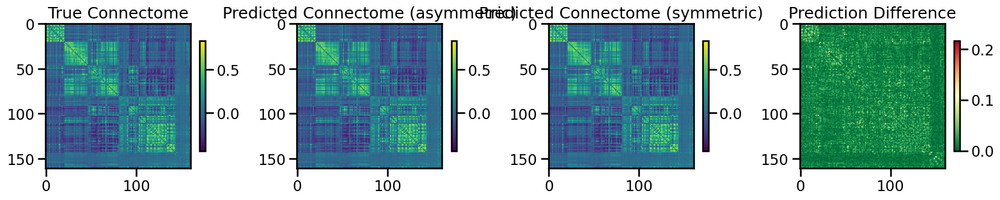

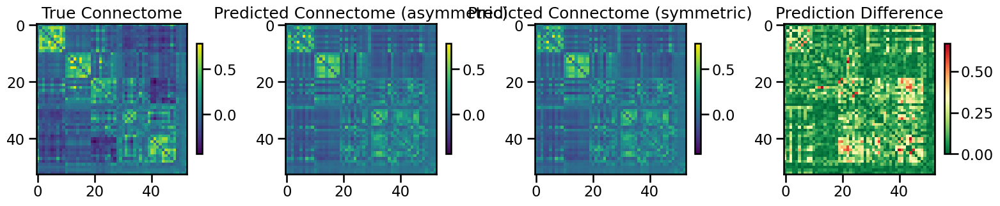

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0004050602360578179, 'mae': 0.014893174192289043, 'r2': 0.9883532985774204, 'pearson_corr': 0.9943182222055945, 'geodesic_distance': 8.664142604060466}
TEST METRICS: {'mse': 0.023902682942216168, 'mae': 0.10827913501808162, 'r2': 0.36675986694861384, 'pearson_corr': 0.6268862634863419, 'geodesic_distance': 9.851217342630664}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.13664363080144565, 'learning_rate': 6.647182218540801e-05, 'weight_decay': 5.233038351709646e-05, 'batch_size': 267, 'epochs': 144, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▂▃▂▂▂▂▂▂▄▃▂▂▁▂▂▂▂▃▃▃▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▂▆▆▆▇▆▆▅▁▄▇▇▇▇▅▆▆▇▇▆▅▇█▇▆▇▇▆▅█████▇█████
train_mse_loss,█▆▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▄▄▄▅▆▆▆▆▇▇▇███████████████████████████
best_val_loss,0
test_mse_loss,0.00704
test_pearson,0.6281
train_mse_loss,0.00092
train_pearson,0.9748


Final evaluation metrics logged successfully.
CPU Usage: 1.4%
RAM Usage: 5.2%
Available RAM: 954.6G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 26% |


  gc.collect()



Running simulation with: dynamic_mlp, random, S400, SC, seed=1
Number of components for 95% variance PCA: 105
X shape: (214, 7380)
X_pca shape: (214, 105)
Y_sc shape: (214, 214)
Y_sc_spectralL shape: (214, 222)
Y_sc_spectralA shape: (214, 223)
Y_fc shape: (214, 214)
Coordinates shape: (214, 3)
Y shape (214, 214)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (214, 7383)

 Test fold num: 1 X_train shape: (25440, 14766) Y_train shape: (25440,) X_test shape: (2862, 14766) Y_test shape: (2862,)
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: x8k47t7w
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/x8k47t7w


wandb: Agent Starting Run: mq6145bb with config:
wandb: 	batch_size: 415
wandb: 	dropout_rate: 0.22503022233706463
wandb: 	epochs: 108
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 8.771072225777827e-05
wandb: 	weight_decay: 0.00016067918505074746
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/108, Train Loss: 0.0940, Val Loss: 0.1063
Epoch 10/108, Train Loss: 0.0899, Val Loss: 0.1060
Epoch 15/108, Train Loss: 0.0871, Val Loss: 0.1052
Epoch 20/108, Train Loss: 0.0850, Val Loss: 0.1070
Epoch 25/108, Train Loss: 0.0833, Val Loss: 0.1103
Epoch 30/108, Train Loss: 0.0814, Val Loss: 0.1105
Epoch 35/108, Train Loss: 0.0789, Val Loss: 0.1088
Epoch 40/108, Train Loss: 0.0786, Val Loss: 0.1103
Epoch 45/108, Train Loss: 0.0777, Val Loss: 0.1088
Epoch 50/108, Train Loss: 0.0773, Val Loss: 0.1095
Epoch 55/108, Train Loss: 0.0771, Val Loss: 0.1100


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 60/108, Train Loss: 0.0772, Val Loss: 0.1101
Epoch 65/108, Train Loss: 0.0773, Val Loss: 0.1104
Epoch 70/108, Train Loss: 0.0773, Val Loss: 0.1104
Epoch 75/108, Train Loss: 0.0768, Val Loss: 0.1102
Epoch 80/108, Train Loss: 0.0769, Val Loss: 0.1106
Epoch 85/108, Train Loss: 0.0769, Val Loss: 0.1102
Epoch 90/108, Train Loss: 0.0768, Val Loss: 0.1107
Epoch 95/108, Train Loss: 0.0767, Val Loss: 0.1106
Epoch 100/108, Train Loss: 0.0769, Val Loss: 0.1104
Epoch 105/108, Train Loss: 0.0769, Val Loss: 0.1106
Processing inner fold 1
Number of learnable parameters in MLP: 3814145
Epoch 5/108, Train Loss: 0.1149, Val Loss: 0.0687
Epoch 10/108, Train Loss: 0.1082, Val Loss: 0.0687
Epoch 15/108, Train Loss: 0.1039, Val Loss: 0.0691
Epoch 20/108, Train Loss: 0.1001, Val Loss: 0.0712
Epoch 25/108, Train Loss: 0.0964, Val Loss: 0.0742
Epoch 30/108, Train Loss: 0.0940, Val Loss: 0.0734
Epoch 35/108, Train Loss: 0.0916, Val Loss: 0.0728
Epoch 40/108, Train Loss: 0.0909, Val Loss: 0.0733
Epoch 45/1

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇██
fold0_train_loss,█▇▇▇▅▄▄▄▃▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▃▃▄▅▅▅▆▇▇▇▇▇▇▇███████████████████████
fold0_val_loss,▃▂▁▂▁▂▃█▃▅▄▄▅▄▅▆▄▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅
fold0_val_pearson,▁▆█▇▇▇▇▇▆▇▆▇▆▆▇█▇▇▇██▇█████▇██████▇█████
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█████
fold1_train_loss,█▇▇▆▆▄▄▄▃▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▃▄▆▆▇▇▇▇▇▇█████████████████████████████
fold1_val_loss,█▂▁▁▁▁▂▃▂▄▅▃▂▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
fold1_val_pearson,▇▇▅█▆▄▃▄▁▄▄▃▅▅▅▆▆▆▅▅▆▆▆▆▆▆▅▇▆▆▆▆▆▆▆▅▆▅▆▆
fold2_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▇▇▇▇▇▇▇▇█████


wandb: Sweep Agent: Waiting for job.
500 response executing GraphQL.
{"errors":[{"message":"Post \"http://anaconda2.default.svc.cluster.local/search\": read tcp 10.54.231.6:53208-\u003e10.55.247.53:80: read: connection reset by peer","path":["agentHeartbeat"]}],"data":{"agentHeartbeat":null}}
wandb: ERROR Error while calling W&B API: Post "http://anaconda2.default.svc.cluster.local/search": read tcp 10.54.231.6:53208->10.55.247.53:80: read: connection reset by peer (<Response [500]>)
wandb: Job received.
wandb: Agent Starting Run: 3opbrxio with config:
wandb: 	batch_size: 262
wandb: 	dropout_rate: 0.24083461790174857
wandb: 	epochs: 120
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.326300059021453e-05
wandb: 	weight_decay: 8.184499211182727e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  se

  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/120, Train Loss: 0.0990, Val Loss: 0.1051
Epoch 10/120, Train Loss: 0.0943, Val Loss: 0.1038
Epoch 15/120, Train Loss: 0.0911, Val Loss: 0.1028
Epoch 20/120, Train Loss: 0.0882, Val Loss: 0.1045
Epoch 25/120, Train Loss: 0.0862, Val Loss: 0.1034
Epoch 30/120, Train Loss: 0.0828, Val Loss: 0.1084
Epoch 35/120, Train Loss: 0.0800, Val Loss: 0.1068
Epoch 40/120, Train Loss: 0.0772, Val Loss: 0.1178
Epoch 45/120, Train Loss: 0.0753, Val Loss: 0.1084
Epoch 50/120, Train Loss: 0.0747, Val Loss: 0.1087
Epoch 55/120, Train Loss: 0.0742, Val Loss: 0.1092
Epoch 60/120, Train Loss: 0.0738, Val Loss: 0.1079
Epoch 65/120, Train Loss: 0.0732, Val Loss: 0.1083


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 70/120, Train Loss: 0.0738, Val Loss: 0.1089
Epoch 75/120, Train Loss: 0.0734, Val Loss: 0.1093
Epoch 80/120, Train Loss: 0.0734, Val Loss: 0.1088
Epoch 85/120, Train Loss: 0.0729, Val Loss: 0.1091
Epoch 90/120, Train Loss: 0.0727, Val Loss: 0.1083
Epoch 95/120, Train Loss: 0.0727, Val Loss: 0.1090
Epoch 100/120, Train Loss: 0.0730, Val Loss: 0.1087
Epoch 105/120, Train Loss: 0.0729, Val Loss: 0.1090
Epoch 110/120, Train Loss: 0.0736, Val Loss: 0.1091
Epoch 115/120, Train Loss: 0.0736, Val Loss: 0.1089
Epoch 120/120, Train Loss: 0.0729, Val Loss: 0.1089
Processing inner fold 1
Number of learnable parameters in MLP: 7726849
Epoch 5/120, Train Loss: 0.1185, Val Loss: 0.0672
Epoch 10/120, Train Loss: 0.1135, Val Loss: 0.0663
Epoch 15/120, Train Loss: 0.1095, Val Loss: 0.0666
Epoch 20/120, Train Loss: 0.1038, Val Loss: 0.0678
Epoch 25/120, Train Loss: 0.0996, Val Loss: 0.0679
Epoch 30/120, Train Loss: 0.0955, Val Loss: 0.0698
Epoch 35/120, Train Loss: 0.0927, Val Loss: 0.0670
Epoch 4

fold0_epoch,▁▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇█
fold0_train_loss,█▇▇▆▆▅▅▅▄▄▃▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▁▂▃▄▅▆▆▆▇█████████████████████████████
fold0_val_loss,▅▂▁▁▂▂▃▂▃▅█▃▃▃▃▃▄▃▃▃▃▃▄▃▃▃▄▃▄▃▃▃▃▃▃▄▃▃▃▃
fold0_val_pearson,▆▄▆▇▆▄▆▂▇▅▃▅▇▆▁▆▇▅▇█▆▇▇▅█▇▆▄▇▇▇▆██▆▇▇▆█▇
fold1_epoch,▁▁▁▁▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇████
fold1_train_loss,█▆▆▆▆▅▄▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▃▄▅▅▆▆▇▇▇▇▇▇███████████████████████████
fold1_val_loss,▅▂▁▃▁▅▃▅▅▇█▇▅▅▄▆▆▇▆▅▄▆▆▅▅▆▆▄▆▂▂▅▅▅▃▆▆▅▄▆
fold1_val_pearson,▄█▇▇█▇▁▂▅▃▃▄▃▄▄▂▃▃▃▃▃▃▃▃▃▃▄▃▃▄▃▃▄▃▃▃▃▄▃▄
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ympa6hc4 with config:
wandb: 	batch_size: 433
wandb: 	dropout_rate: 0.16845836710669354
wandb: 	epochs: 132
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9.5317786312623e-05
wandb: 	weight_decay: 0.0004218453085073359
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/132, Train Loss: 0.0928, Val Loss: 0.1055


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 10/132, Train Loss: 0.0882, Val Loss: 0.1060
Epoch 15/132, Train Loss: 0.0844, Val Loss: 0.1054
Epoch 20/132, Train Loss: 0.0797, Val Loss: 0.1181
Epoch 25/132, Train Loss: 0.0770, Val Loss: 0.1437
Epoch 30/132, Train Loss: 0.0722, Val Loss: 0.1092
Epoch 35/132, Train Loss: 0.0700, Val Loss: 0.1072
Epoch 40/132, Train Loss: 0.0689, Val Loss: 0.1079
Epoch 45/132, Train Loss: 0.0680, Val Loss: 0.1096
Epoch 50/132, Train Loss: 0.0671, Val Loss: 0.1116
Epoch 55/132, Train Loss: 0.0664, Val Loss: 0.1095
Epoch 60/132, Train Loss: 0.0665, Val Loss: 0.1098
Epoch 65/132, Train Loss: 0.0667, Val Loss: 0.1103
Epoch 70/132, Train Loss: 0.0666, Val Loss: 0.1103
Epoch 75/132, Train Loss: 0.0666, Val Loss: 0.1101
Epoch 80/132, Train Loss: 0.0662, Val Loss: 0.1090
Epoch 85/132, Train Loss: 0.0668, Val Loss: 0.1099
Epoch 90/132, Train Loss: 0.0668, Val Loss: 0.1106
Epoch 95/132, Train Loss: 0.0664, Val Loss: 0.1092
Epoch 100/132, Train Loss: 0.0667, Val Loss: 0.1100
Epoch 105/132, Train Loss: 0.0

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,█▇▇▆▅▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▆▆▆▆▇▇▇▇███████████████████████████████
fold0_val_loss,▂▁▁▁▂▁▂▆█▂▂▃▃▃▃▃▃▃▃▃▃▃▃▄▃▄▃▄▃▃▃▃▃▃▃▃▃▄▃▃
fold0_val_pearson,▁▇▇▆▇▇▆▇▇▇▇▇███▇▇▇▇▇█▇▇█████▇████▇▇███▇█
fold1_epoch,▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇████
fold1_train_loss,█▇▇▇▆▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▃▃▅▅▅▆▆▇▇▇▇▇▇████████████████████████
fold1_val_loss,▂▂▂▃▁█▃▃▄▁▃▁▁▁▁▁▁▂▁▂▁▁▂▂▁▁▂▁▂▁▁▁▁▁▁▁▂▁▁▁
fold1_val_pearson,▂▁▃▂▂▂▂▄▃▄▅▇▆▇▇▇▇▇▇▆▇█▇█▇▇██▇██████▇▇█▇█
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 132, 'input_dim': 14766, 'batch_size': 433, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.16845836710669354, 'weight_decay': 0.0004218453085073359, 'learning_rate': 9.5317786312623e-05}
Number of learnable parameters in MLP: 7726849
Epoch 5/132, Train Loss: 0.0920, Val Loss: 0.0786
Epoch 10/132, Train Loss: 0.0842, Val Loss: 0.0790
Epoch 15/132, Train Loss: 0.0798, Val Loss: 0.0783
Epoch 20/132, Train Loss: 0.0732, Val Loss: 0.0772
Epoch 25/132, Train Loss: 0.0650, Val Loss: 0.0907
Epoch 30/132, Train Loss: 0.0592, Val Loss: 0.0881
Epoch 35/132, Train Loss: 0.0556, Val Loss: 0.0783
Epoch 40/132, Train Loss: 0.0534, Val Loss: 0.0770
Epoch 45/132, Train Loss: 0.0523, Val Loss: 0.0871
Epoch 50/132, Train Loss: 0.0504, Val Loss: 0.0744
Epoch 55/132, Train Loss: 0.0490, Val Loss: 0.0766
Epoch 60/132, Train Loss: 0.0475, Val Loss: 0.0784
Epoch 65/132, Train Loss: 0.0474, Val Loss: 0.0859
Epoch 70/132, Train Loss: 0.0470, Val Loss: 0.0852
Epoch 75/132, Train Loss: 0

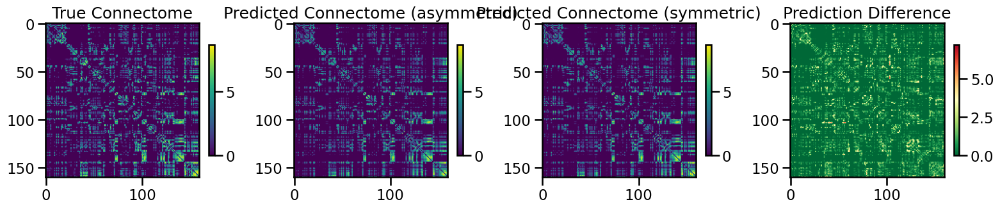

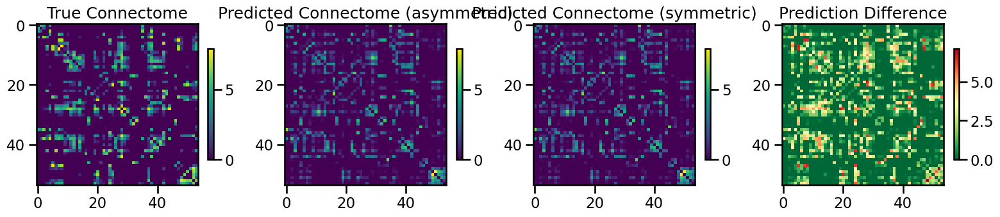

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.5760356693584231, 'mae': 0.31501673482206166, 'r2': 0.8334739006923864, 'pearson_corr': 0.9179349601623463, 'geodesic_distance': 13.636266860824296}
TEST METRICS: {'mse': 2.688667274896811, 'mae': 0.8161354994519785, 'r2': 0.05675230429738343, 'pearson_corr': 0.3968847512387133, 'geodesic_distance': 13.604314916746326}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.16845836710669354, 'learning_rate': 9.5317786312623e-05, 'weight_decay': 0.0004218453085073359, 'batch_size': 433, 'epochs': 132, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▁▁▁▁▁▁█▁▁▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▄▃▄▃▄▅▇▃▁▄▅▄▅▂▅▅▅▂▆▆▅▆▆▆███▇▇▇██▇██▇▇███
train_mse_loss,█▆▆▆▆▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▂▃▃▄▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇████████████████
best_val_loss,0
test_mse_loss,0.07829
test_pearson,0.3999
train_mse_loss,0.03743
train_pearson,0.88564


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 5.2%
Available RAM: 954.5G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 25% |

 Test fold num: 2 X_train shape: (25440, 14766) Y_train shape: (25440,) X_test shape: (2862, 14766) Y_test shape: (2862,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 0432irz8
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/0432irz8


wandb: Agent Starting Run: p6vyo85s with config:
wandb: 	batch_size: 358
wandb: 	dropout_rate: 0.13207702189962364
wandb: 	epochs: 110
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.137821177559852e-05
wandb: 	weight_decay: 0.00021519610252411847
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/110, Train Loss: 0.0961, Val Loss: 0.0792
Epoch 10/110, Train Loss: 0.0928, Val Loss: 0.0783
Epoch 15/110, Train Loss: 0.0900, Val Loss: 0.0799
Epoch 20/110, Train Loss: 0.0862, Val Loss: 0.0791
Epoch 25/110, Train Loss: 0.0858, Val Loss: 0.0803


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 30/110, Train Loss: 0.0822, Val Loss: 0.0802
Epoch 35/110, Train Loss: 0.0805, Val Loss: 0.0798
Epoch 40/110, Train Loss: 0.0773, Val Loss: 0.0808
Epoch 45/110, Train Loss: 0.0778, Val Loss: 0.0809
Epoch 50/110, Train Loss: 0.0768, Val Loss: 0.0811
Epoch 55/110, Train Loss: 0.0753, Val Loss: 0.0811
Epoch 60/110, Train Loss: 0.0755, Val Loss: 0.0810
Epoch 65/110, Train Loss: 0.0746, Val Loss: 0.0814
Epoch 70/110, Train Loss: 0.0754, Val Loss: 0.0813
Epoch 75/110, Train Loss: 0.0757, Val Loss: 0.0813
Epoch 80/110, Train Loss: 0.0753, Val Loss: 0.0812
Epoch 85/110, Train Loss: 0.0751, Val Loss: 0.0816
Epoch 90/110, Train Loss: 0.0740, Val Loss: 0.0814
Epoch 95/110, Train Loss: 0.0756, Val Loss: 0.0814
Epoch 100/110, Train Loss: 0.0744, Val Loss: 0.0814
Epoch 105/110, Train Loss: 0.0747, Val Loss: 0.0815
Epoch 110/110, Train Loss: 0.0755, Val Loss: 0.0815
Processing inner fold 1
Number of learnable parameters in MLP: 7726849
Epoch 5/110, Train Loss: 0.1065, Val Loss: 0.0735
Epoch 10/

fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▇▆▆▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▂▁▁▂▁▂▁▁▁▂▁▁
fold0_train_pearson,▁▁▂▂▃▃▃▄▄▄▅▆▆▆▇▇▇▇██████████████████████
fold0_val_loss,█▂▁▂▁▁▁▁▁▁▂▂▁▁▂▃▄▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▂▂▂▂
fold0_val_pearson,▁▅▆▇▆▇▆▇▆▆▇▇▇▇█████▇█▇████▇█████████████
fold1_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██
fold1_train_loss,█▇▇▇▆▅▅▄▄▄▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▃▄▄▄▄▅▅▆▆▇▇▇▇██████████████████████████
fold1_val_loss,▅▄▁▂▇▁▂▁▁█▂▇▄▄▂▃▃▃▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▃▄▄▄
fold1_val_pearson,▁▃▅▅▅▅██▇█▇▇█▇▇▇█▇▇▇█▇▇▇▇█▇█▇█▇██▇▇█▇█▇▇
fold2_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇███


wandb: Agent Starting Run: hkcjtpmb with config:
wandb: 	batch_size: 377
wandb: 	dropout_rate: 0.25541964981428494
wandb: 	epochs: 155
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.891083107697445e-05
wandb: 	weight_decay: 0.0003029908606593228
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/155, Train Loss: 0.1001, Val Loss: 0.0800
Epoch 10/155, Train Loss: 0.0947, Val Loss: 0.0782
Epoch 15/155, Train Loss: 0.0913, Val Loss: 0.0772
Epoch 20/155, Train Loss: 0.0896, Val Loss: 0.0779
Epoch 25/155, Train Loss: 0.0875, Val Loss: 0.0805
Epoch 30/155, Train Loss: 0.0842, Val Loss: 0.0821


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 35/155, Train Loss: 0.0826, Val Loss: 0.0858
Epoch 40/155, Train Loss: 0.0809, Val Loss: 0.0782
Epoch 45/155, Train Loss: 0.0797, Val Loss: 0.0807
Epoch 50/155, Train Loss: 0.0789, Val Loss: 0.0812
Epoch 55/155, Train Loss: 0.0790, Val Loss: 0.0801
Epoch 60/155, Train Loss: 0.0782, Val Loss: 0.0810
Epoch 65/155, Train Loss: 0.0785, Val Loss: 0.0812
Epoch 70/155, Train Loss: 0.0782, Val Loss: 0.0809
Epoch 75/155, Train Loss: 0.0780, Val Loss: 0.0805
Epoch 80/155, Train Loss: 0.0775, Val Loss: 0.0803
Epoch 85/155, Train Loss: 0.0781, Val Loss: 0.0805
Epoch 90/155, Train Loss: 0.0781, Val Loss: 0.0816
Epoch 95/155, Train Loss: 0.0783, Val Loss: 0.0807
Epoch 100/155, Train Loss: 0.0779, Val Loss: 0.0805
Epoch 105/155, Train Loss: 0.0779, Val Loss: 0.0809
Epoch 110/155, Train Loss: 0.0778, Val Loss: 0.0802
Epoch 115/155, Train Loss: 0.0779, Val Loss: 0.0806
Epoch 120/155, Train Loss: 0.0779, Val Loss: 0.0812
Epoch 125/155, Train Loss: 0.0782, Val Loss: 0.0815
Epoch 130/155, Train Loss

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇██
fold0_train_loss,█▇▅▅▅▄▄▃▃▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▃▃▃▄▄▅▅▅▆▇▇▇▇█████████████████████████
fold0_val_loss,█▂▂▁▁▁▁▂▃▃▂▂▂▃▂▂▂▃▃▃▂▃▃▃▃▂▃▃▃▃▂▃▃▂▃▂▃▃▃▃
fold0_val_pearson,▅▅▇▆▂▂▁▃▁▅▇▆▆▅▄▇▇▇▅▅▆▅▆▄█▄▅▆▆▇▆▆▆█▆▆▅▅▆▆
fold1_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇██
fold1_train_loss,█▅▅▄▄▄▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▃▄▅▇▇▇▇██████████████████████████████
fold1_val_loss,▄▃▁▃▃▃▃▃▇▄▅▅▄▇▆▆▆▅▇▅▆▆▅▅▆▄▆▆▆▆▇▆▆▆▇▇▆▆▇█
fold1_val_pearson,▂▄▆▃▅▂▁▂▇▆▅▄▆▆▅█▇▆▄▄▆▇▅▆▅▅▇▅▆▆▇▆▆▇█▇▅▆▆▅
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████


wandb: Agent Starting Run: s4czarpg with config:
wandb: 	batch_size: 487
wandb: 	dropout_rate: 0.2960641687158551
wandb: 	epochs: 167
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.76873231983979e-05
wandb: 	weight_decay: 0.00025681350590809986
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/167, Train Loss: 0.0990, Val Loss: 0.0810
Epoch 10/167, Train Loss: 0.0943, Val Loss: 0.0810


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 15/167, Train Loss: 0.0916, Val Loss: 0.0801
Epoch 20/167, Train Loss: 0.0895, Val Loss: 0.0811
Epoch 25/167, Train Loss: 0.0878, Val Loss: 0.0804
Epoch 30/167, Train Loss: 0.0864, Val Loss: 0.0782
Epoch 35/167, Train Loss: 0.0855, Val Loss: 0.0788
Epoch 40/167, Train Loss: 0.0839, Val Loss: 0.0859
Epoch 45/167, Train Loss: 0.0830, Val Loss: 0.0802
Epoch 50/167, Train Loss: 0.0820, Val Loss: 0.0853
Epoch 55/167, Train Loss: 0.0803, Val Loss: 0.0838
Epoch 60/167, Train Loss: 0.0802, Val Loss: 0.0829
Epoch 65/167, Train Loss: 0.0799, Val Loss: 0.0825
Epoch 70/167, Train Loss: 0.0793, Val Loss: 0.0854
Epoch 75/167, Train Loss: 0.0793, Val Loss: 0.0839
Epoch 80/167, Train Loss: 0.0792, Val Loss: 0.0841
Epoch 85/167, Train Loss: 0.0787, Val Loss: 0.0842
Epoch 90/167, Train Loss: 0.0789, Val Loss: 0.0846
Epoch 95/167, Train Loss: 0.0789, Val Loss: 0.0844
Epoch 100/167, Train Loss: 0.0789, Val Loss: 0.0843
Epoch 105/167, Train Loss: 0.0790, Val Loss: 0.0845
Epoch 110/167, Train Loss: 0.

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇██
fold0_train_loss,█▅▅▅▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▃▃▃▄▄▅▅▆▆▇▇▇█████████████████████████
fold0_val_loss,▃▄▅▁▅▃▂▃▁▁▁▂▃█▅▅▅▅▅▆▅▅▅▆▅▆▅▅▅▆▆▅▅▅▆▅▅▆▅▅
fold0_val_pearson,▁█▇▇▇▇▇▇█▆▇▅▅▆▇▇▇▇▇▇██████▇▇▇▇███▇██▇▇▇█
fold1_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇█
fold1_train_loss,█▇▅▅▄▃▂▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▄▅▅▅▇▇▇▇███████████████████████████████
fold1_val_loss,▁▂▂▁▂▄▅▅▆█▆▇▇▆▆▆▆▆▇█▆▆▇▆▆▆▆▆▆▆▆▆▇▆▅▇▇▇▆▇
fold1_val_pearson,▃▄▄▁▂█▅█▆▇▇▇█▆▆▇▆▅▇▆▆▅▅▆▅▆▆▆▆▆▆▅▇▇▆▅▇▆▃▆
fold2_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇█


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 110, 'input_dim': 14766, 'batch_size': 358, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.13207702189962364, 'weight_decay': 0.00021519610252411847, 'learning_rate': 5.137821177559852e-05}
Number of learnable parameters in MLP: 7726849
Epoch 5/110, Train Loss: 0.0901, Val Loss: 0.1046
Epoch 10/110, Train Loss: 0.0853, Val Loss: 0.1050
Epoch 15/110, Train Loss: 0.0804, Val Loss: 0.1055
Epoch 20/110, Train Loss: 0.0754, Val Loss: 0.1092
Epoch 25/110, Train Loss: 0.0705, Val Loss: 0.1014
Epoch 30/110, Train Loss: 0.0668, Val Loss: 0.1143
Epoch 35/110, Train Loss: 0.0625, Val Loss: 0.1073
Epoch 40/110, Train Loss: 0.0573, Val Loss: 0.1001
Epoch 45/110, Train Loss: 0.0547, Val Loss: 0.1078
Epoch 50/110, Train Loss: 0.0513, Val Loss: 0.1010
Epoch 55/110, Train Loss: 0.0493, Val Loss: 0.0980
Epoch 60/110, Train Loss: 0.0463, Val Loss: 0.0994
Epoch 65/110, Train Loss: 0.0460, Val Loss: 0.1187
Epoch 70/110, Train Loss: 0.0442, Val Loss: 0.0898
Epoch 75/110, Train Loss

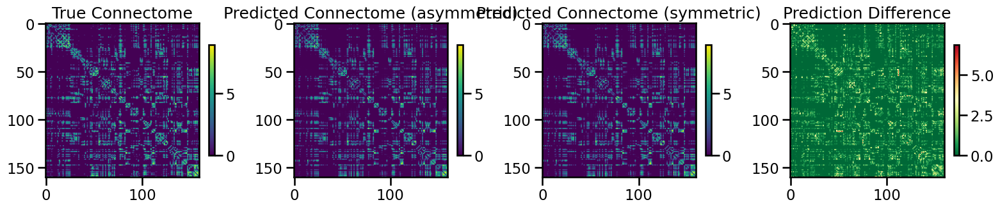

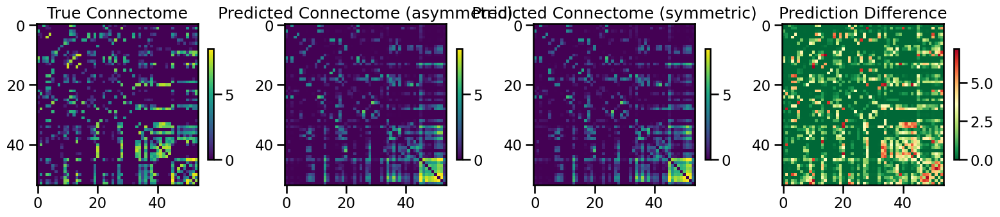

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.4771678278229177, 'mae': 0.2895247582278841, 'r2': 0.848026324669358, 'pearson_corr': 0.927547021530531, 'geodesic_distance': 14.268080607479583}
TEST METRICS: {'mse': 3.337190817686891, 'mae': 0.9487245601402097, 'r2': 0.2047757039953716, 'pearson_corr': 0.5203285543241103, 'geodesic_distance': 11.4930099373366}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.13207702189962364, 'learning_rate': 5.137821177559852e-05, 'weight_decay': 0.00021519610252411847, 'batch_size': 358, 'epochs': 110, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▃▄▄▃▄▄▅█▄▇▃▆▄▄▄▃▃▄▃▂▂▆▃▂▃▃▃▂▂▂▁▂▁▁▁▁▁▁▂▁
test_pearson,▂▁▁▂▂▂▁▂▁▁▃▃▄▄▅▅▅▆▆▆▆▆▅▇▆▆▅▇▆▇▇▆▆▇▇█████
train_mse_loss,█▇▇▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁
train_pearson,▁▂▃▃▄▄▅▅▅▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████
best_val_loss,0
test_mse_loss,0.09166
test_pearson,0.51823
train_mse_loss,0.03505
train_pearson,0.89299


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 5.2%
Available RAM: 954.5G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 25% |

 Test fold num: 3 X_train shape: (25760, 14766) Y_train shape: (25760,) X_test shape: (2756, 14766) Y_test shape: (2756,)
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: otogmd3m
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/otogmd3m


wandb: Agent Starting Run: nqnw0vsf with config:
wandb: 	batch_size: 391
wandb: 	dropout_rate: 0.13217508292828029
wandb: 	epochs: 175
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.944905927423208e-05
wandb: 	weight_decay: 0.00039336307257533705
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849


  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 5/175, Train Loss: 0.1173, Val Loss: 0.0802
Epoch 10/175, Train Loss: 0.1085, Val Loss: 0.0811


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 15/175, Train Loss: 0.1066, Val Loss: 0.0786
Epoch 20/175, Train Loss: 0.1071, Val Loss: 0.0786
Epoch 25/175, Train Loss: 0.1028, Val Loss: 0.0790
Epoch 30/175, Train Loss: 0.1062, Val Loss: 0.0798
Epoch 35/175, Train Loss: 0.1020, Val Loss: 0.0797
Epoch 40/175, Train Loss: 0.1018, Val Loss: 0.0799
Epoch 45/175, Train Loss: 0.1035, Val Loss: 0.0804
Epoch 50/175, Train Loss: 0.1060, Val Loss: 0.0813
Epoch 55/175, Train Loss: 0.1025, Val Loss: 0.0786
Epoch 60/175, Train Loss: 0.1013, Val Loss: 0.0813
Epoch 65/175, Train Loss: 0.1015, Val Loss: 0.0809
Epoch 70/175, Train Loss: 0.1026, Val Loss: 0.0796
Epoch 75/175, Train Loss: 0.1019, Val Loss: 0.0804
Epoch 80/175, Train Loss: 0.1063, Val Loss: 0.0802
Epoch 85/175, Train Loss: 0.1000, Val Loss: 0.0818
Epoch 90/175, Train Loss: 0.1024, Val Loss: 0.0807
Epoch 95/175, Train Loss: 0.1003, Val Loss: 0.0815
Epoch 100/175, Train Loss: 0.1015, Val Loss: 0.0804
Epoch 105/175, Train Loss: 0.1011, Val Loss: 0.0783
Epoch 110/175, Train Loss: 0.

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇███
fold0_train_loss,█▃▃▃▂▂▂▂▂▅▂▂▁▁▁▁▂▂▁▁▁▂▂▁▂▄▁▁▂▁▃▁▁▂▄▁▃▃▂▂
fold0_train_pearson,▂▁▄▁▂▃▆▄▆▅▆ ▆ ▆▃▇ ▂▇█ ▄██ ▂▆ ▆▇ ▇
fold0_val_loss,▂▄▃▂▂▂▂█▃▃▁▂▂▂▃▂▂▂▂▁▂▂▂▃▂▂▂▂▃▁▂▂▂▂▃▂▃▂▂▂
fold0_val_pearson,▁▅▅▇▅▅▁▇▅▇▅▆▅▆▆▆▅▅▅▄▇▅▆▆▇█▆▇▅▅▄▅▄▅▆▅▆▆▄▄
fold1_epoch,▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇█████
fold1_train_loss,█▅▃▂▂▂▄▃▂▄▂▁▁▅▄▁▃▁▂▄▂▂▂▂▄▁▁▁▂▁▁▁▃▁▂▁▂▃▁▂
fold1_train_pearson,▁▃▂▁ ▄ ▇▇▄▆▅▄▇█ ▆▅▆ ▅▇█▇▇▄ ▅█ ▄ █
fold1_val_loss,██▄█▄▆▃▂▂▁▃▃▁▄▄▅▂▄▆▂▁▃▄▂▃▃▄▃▁▅▄▅▄▃▂▃▃▄▅▃
fold1_val_pearson,▅█▅▅▃▄▃▆▁▁▅▅▅▄▅▄▅▄▄▄▃▅▆▅▆▄▅▅▄▃▅▅▆▆▆▅▃▄▄▅
fold2_epoch,▁▁▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇████


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: wc37vlap with config:
wandb: 	batch_size: 454
wandb: 	dropout_rate: 0.1539817541620933
wandb: 	epochs: 131
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.125790868837537e-05
wandb: 	weight_decay: 0.00018678381204941745
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/131, Train Loss: 0.1094, Val Loss: 0.0857


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 10/131, Train Loss: 0.1051, Val Loss: 0.0819
Epoch 15/131, Train Loss: 0.1013, Val Loss: 0.0828
Epoch 20/131, Train Loss: 0.0985, Val Loss: 0.0877
Epoch 25/131, Train Loss: 0.0952, Val Loss: 0.0854
Epoch 30/131, Train Loss: 0.0928, Val Loss: 0.0889
Epoch 35/131, Train Loss: 0.0921, Val Loss: 0.0864
Epoch 40/131, Train Loss: 0.0920, Val Loss: 0.0894
Epoch 45/131, Train Loss: 0.0912, Val Loss: 0.0869
Epoch 50/131, Train Loss: 0.0910, Val Loss: 0.0890
Epoch 55/131, Train Loss: 0.0907, Val Loss: 0.0899
Epoch 60/131, Train Loss: 0.0908, Val Loss: 0.0906
Epoch 65/131, Train Loss: 0.0907, Val Loss: 0.0894
Epoch 70/131, Train Loss: 0.0907, Val Loss: 0.0877
Epoch 75/131, Train Loss: 0.0911, Val Loss: 0.0885
Epoch 80/131, Train Loss: 0.0903, Val Loss: 0.0896
Epoch 85/131, Train Loss: 0.0910, Val Loss: 0.0872
Epoch 90/131, Train Loss: 0.0905, Val Loss: 0.0896
Epoch 95/131, Train Loss: 0.0905, Val Loss: 0.0863
Epoch 100/131, Train Loss: 0.0906, Val Loss: 0.0905
Epoch 105/131, Train Loss: 0.0

fold0_epoch,▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇█
fold0_train_loss,█▇▇▆▆▅▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▃▄▄▅▆▆▆▆▇▇▇▇██████████████████████████
fold0_val_loss,█▁▁▁▂▅▃▄▅▃▄▅▆▅▅▆▆▅▆▄▄▄▄▆▄▆▆▄▅▃▇▄▆▄▅▅▅▅▄▄
fold0_val_pearson,▁▅▃█▅▆▆▃▄▄▃▄▄▄▄▄▃▃▃▅▃▃▄▂▅▂▆▄▅▄▄▄▃▄▄▂▃▃▃▅
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
fold1_train_loss,██▆▆▆▅▅▄▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▄▄▆▆▆▇▇██████████████████████████████
fold1_val_loss,▃▁▅▃▆▃▃▃▃▅▆▇▆▅▆▅▅█▆▆▆▅▄▆▆▅▅▆▆▅▅▅▇▅█▇▅▅▅▅
fold1_val_pearson,▁▆▆▆▇▆█▄▇█▅▇▆▇▇▇███▆▇▇▇▆▇▇█▆▇█▇▆▇▇▇▆█▆▇▇
fold2_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇█████


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: uitblvwo with config:
wandb: 	batch_size: 480
wandb: 	dropout_rate: 0.16689142043915697
wandb: 	epochs: 162
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.223593816960084e-05
wandb: 	weight_decay: 0.0003787960294950508
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/162, Train Loss: 0.1142, Val Loss: 0.0868
Epoch 10/162, Train Loss: 0.1109, Val Loss: 0.0805
Epoch 15/162, Train Loss: 0.1071, Val Loss: 0.0853
Epoch 20/162, Train Loss: 0.1037, Val Loss: 0.0826
Epoch 25/162, Train Loss: 0.1010, Val Loss: 0.0837
Epoch 30/162, Train Loss: 0.0988, Val Loss: 0.0851


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 35/162, Train Loss: 0.0958, Val Loss: 0.0837
Epoch 40/162, Train Loss: 0.0944, Val Loss: 0.0842
Epoch 45/162, Train Loss: 0.0940, Val Loss: 0.0848
Epoch 50/162, Train Loss: 0.0934, Val Loss: 0.0851
Epoch 55/162, Train Loss: 0.0930, Val Loss: 0.0854
Epoch 60/162, Train Loss: 0.0929, Val Loss: 0.0852
Epoch 65/162, Train Loss: 0.0927, Val Loss: 0.0855
Epoch 70/162, Train Loss: 0.0930, Val Loss: 0.0854
Epoch 75/162, Train Loss: 0.0931, Val Loss: 0.0854
Epoch 80/162, Train Loss: 0.0927, Val Loss: 0.0856
Epoch 85/162, Train Loss: 0.0927, Val Loss: 0.0856
Epoch 90/162, Train Loss: 0.0929, Val Loss: 0.0856
Epoch 95/162, Train Loss: 0.0931, Val Loss: 0.0853
Epoch 100/162, Train Loss: 0.0928, Val Loss: 0.0853
Epoch 105/162, Train Loss: 0.0927, Val Loss: 0.0855
Epoch 110/162, Train Loss: 0.0933, Val Loss: 0.0854
Epoch 115/162, Train Loss: 0.0931, Val Loss: 0.0853
Epoch 120/162, Train Loss: 0.0925, Val Loss: 0.0856
Epoch 125/162, Train Loss: 0.0931, Val Loss: 0.0855
Epoch 130/162, Train Loss

fold0_epoch,▁▁▂▂▂▂▂▂▂▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▇▇▆▅▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▃▅▆▆▇▇▇█▇████████████████████████████
fold0_val_loss,▅▂▃▁▂█▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
fold0_val_pearson,▁▁▆▆▅▆▆▆▁▁█▆▅▅▄▅▅▄▄▄▄▅▄▄▄▄▄▄▄▄▄▄▄▄▄▅▄▄▄▅
fold1_epoch,▁▁▁▁▂▂▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇█████
fold1_train_loss,█▆▆▅▅▅▄▄▃▃▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▄▄▅▆▇██████████████████████████████████
fold1_val_loss,▆▁▁▂▄█▃▅▄▄▆▆▇▆▆▇▇▇▇▇▇▇▇▇▇▇▆▇▇▇▇▇▇▆▇▇▇▇▇▇
fold1_val_pearson,▆▃▁▇▅▄▇▇▄▇▆▇▆█▆▆█▆▇▇█▇▇▇██▆▇▆▇▇▇▆▇▇▇▇▇▆▆
fold2_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 175, 'input_dim': 14766, 'batch_size': 391, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.13217508292828029, 'weight_decay': 0.00039336307257533705, 'learning_rate': 6.944905927423208e-05}
Number of learnable parameters in MLP: 7726849
Epoch 5/175, Train Loss: 0.0967, Val Loss: 0.0602
Epoch 10/175, Train Loss: 0.0893, Val Loss: 0.0681
Epoch 15/175, Train Loss: 0.0825, Val Loss: 0.0750
Epoch 20/175, Train Loss: 0.0755, Val Loss: 0.0643
Epoch 25/175, Train Loss: 0.0695, Val Loss: 0.0806
Epoch 30/175, Train Loss: 0.0635, Val Loss: 0.0670
Epoch 35/175, Train Loss: 0.0620, Val Loss: 0.0642
Epoch 40/175, Train Loss: 0.0609, Val Loss: 0.0673
Epoch 45/175, Train Loss: 0.0593, Val Loss: 0.0605
Epoch 50/175, Train Loss: 0.0584, Val Loss: 0.0655
Epoch 55/175, Train Loss: 0.0580, Val Loss: 0.0597


  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 60/175, Train Loss: 0.0580, Val Loss: 0.0589
Epoch 65/175, Train Loss: 0.0577, Val Loss: 0.0684
Epoch 70/175, Train Loss: 0.0574, Val Loss: 0.0634
Epoch 75/175, Train Loss: 0.0574, Val Loss: 0.0645
Epoch 80/175, Train Loss: 0.0578, Val Loss: 0.0583
Epoch 85/175, Train Loss: 0.0573, Val Loss: 0.0590
Epoch 90/175, Train Loss: 0.0575, Val Loss: 0.0612
Epoch 95/175, Train Loss: 0.0573, Val Loss: 0.0698
Epoch 100/175, Train Loss: 0.0574, Val Loss: 0.0642
Epoch 105/175, Train Loss: 0.0572, Val Loss: 0.0669
Epoch 110/175, Train Loss: 0.0578, Val Loss: 0.0600
Epoch 115/175, Train Loss: 0.0575, Val Loss: 0.0659
Epoch 120/175, Train Loss: 0.0575, Val Loss: 0.0661
Epoch 125/175, Train Loss: 0.0574, Val Loss: 0.0595
Epoch 130/175, Train Loss: 0.0573, Val Loss: 0.0584
Epoch 135/175, Train Loss: 0.0574, Val Loss: 0.0609
Epoch 140/175, Train Loss: 0.0575, Val Loss: 0.0610
Epoch 145/175, Train Loss: 0.0577, Val Loss: 0.0636
Epoch 150/175, Train Loss: 0.0575, Val Loss: 0.0669
Epoch 155/175, Train

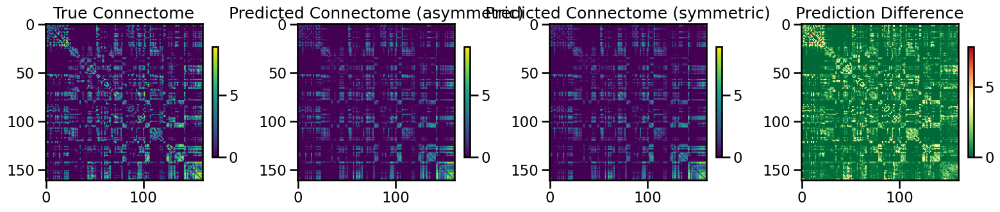

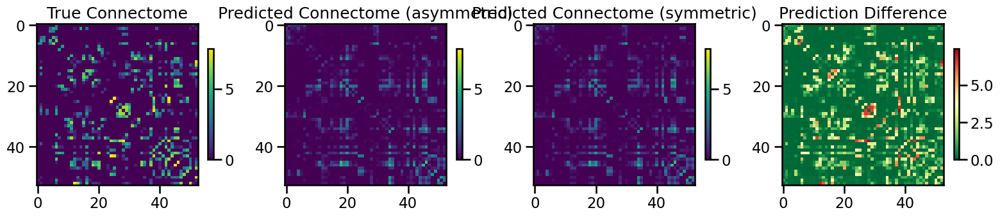

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 1.3418725162834833, 'mae': 0.5328731418208376, 'r2': 0.6245884805633262, 'pearson_corr': 0.8244958141236096, 'geodesic_distance': 24.766116975764348}
TEST METRICS: {'mse': 2.097029208611578, 'mae': 0.664039547259126, 'r2': 0.14991932151702758, 'pearson_corr': 0.4521599875615142, 'geodesic_distance': 15.079278753859931}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.13217508292828029, 'learning_rate': 6.944905927423208e-05, 'weight_decay': 0.00039336307257533705, 'batch_size': 391, 'epochs': 175, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▃▂█▅▃▅▃▃▃▂▆▃▃▁▃▂▁▁▃▄▂▄▄▂▃▂▃▃▂▂▁▆▃▃▂▃▂▂▅
test_pearson,▁▃▁▆▄▆▅▇▆▆▇▆▆▇▇▇▆▇▇▅▆▇█▅█▆█▆▆▆▇▆▅▆▆▅█▆▇▅
train_mse_loss,█▇▆▅▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▄▆▇▇▇▇▇███████████████████████████████
best_val_loss,0
test_mse_loss,0.0612
test_pearson,0.37194
train_mse_loss,0.05741
train_pearson,0.79215


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 5.2%
Available RAM: 954.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 26% |

 Test fold num: 4 X_train shape: (25760, 14766) Y_train shape: (25760,) X_test shape: (2756, 14766) Y_test shape: (2756,)
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: y84jbjm7
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/y84jbjm7


wandb: Agent Starting Run: ytl08om3 with config:
wandb: 	batch_size: 449
wandb: 	dropout_rate: 0.28068635112526585
wandb: 	epochs: 141
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 8.014444042289714e-05
wandb: 	weight_decay: 0.0003724609754253254
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 5/141, Train Loss: 0.0947, Val Loss: 0.0849
Epoch 10/141, Train Loss: 0.0898, Val Loss: 0.0816
Epoch 15/141, Train Loss: 0.0864, Val Loss: 0.0819
Epoch 20/141, Train Loss: 0.0846, Val Loss: 0.0807
Epoch 25/141, Train Loss: 0.0837, Val Loss: 0.0838
Epoch 30/141, Train Loss: 0.0810, Val Loss: 0.0803
Epoch 35/141, Train Loss: 0.0796, Val Loss: 0.0797
Epoch 40/141, Train Loss: 0.0793, Val Loss: 0.0807
Epoch 45/141, Train Loss: 0.0785, Val Loss: 0.0842
Epoch 50/141, Train Loss: 0.0771, Val Loss: 0.0861
Epoch 55/141, Train Loss: 0.0771, Val Loss: 0.0783
Epoch 60/141, Train Loss: 0.0749, Val Loss: 0.0825
Epoch 65/141, Train Loss: 0.0749, Val Loss: 0.0833
Epoch 70/141, Train Loss: 0.0740, Val Loss: 0.0815
Epoch 75/141, Train Loss: 0.0745, Val Loss: 0.0801
Epoch 80/141, Train Loss: 0.0741, Val Loss: 0.0802
Epoch 85/141, Train Loss: 0.0743, Val Loss: 0.0805
Epoch 90/141, Train Loss: 0.0740, Val Loss: 0.0859
Epoch 95/141, Train Loss: 0.0748, Val Loss: 0.0801
Epoch 100/141, Train Loss: 0.074

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▇▅▅▅▄▄▃▃▃▃▃▂▃▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▂▂▂▃▃▄▄▄▅▅▆▆▆▇▇▇▇▇████████████████████
fold0_val_loss,▇▇▃▁▂▃▃▂█▃▂▃▅▁▆▁▄▂▃▂▂▃▁▂▃▂▃▃▃▂▂▃▃▄▃▄▃▄▄▃
fold0_val_pearson,▇█▇▆▆▅▄▅▃▁▅▆▆▅▇▆▄▃▃▅▃▆▅▅▅▄▅▆▆▅▅▅▅▅▅▅▅▅▅▅
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇██
fold1_train_loss,██▇▇▅▄▄▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▂▃▄▄▄▅▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇██████████████
fold1_val_loss,▂▂█▂▃▂▂▂▁▂▂▂▂▂▂▂▁▁▆▂▂▆▅▂▂▁▁▁▁▁▁▂▂▁▁▁▂▂▂▁
fold1_val_pearson,▁▇▇▆▆▇▇▆▆▇▆▄▆▃▄▅▆▇▃▄▇▇▇▇▇██▇▇██▇▇███████
fold2_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇███


wandb: Agent Starting Run: dy9q7kqj with config:
wandb: 	batch_size: 339
wandb: 	dropout_rate: 0.11698968706263024
wandb: 	epochs: 160
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9.942717716290992e-05
wandb: 	weight_decay: 0.000358136854649361
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/160, Train Loss: 0.0848, Val Loss: 0.0794


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 10/160, Train Loss: 0.0802, Val Loss: 0.0787
Epoch 15/160, Train Loss: 0.0765, Val Loss: 0.0847
Epoch 20/160, Train Loss: 0.0727, Val Loss: 0.0825
Epoch 25/160, Train Loss: 0.0679, Val Loss: 0.0816
Epoch 30/160, Train Loss: 0.0616, Val Loss: 0.0812
Epoch 35/160, Train Loss: 0.0573, Val Loss: 0.0819
Epoch 40/160, Train Loss: 0.0516, Val Loss: 0.0786
Epoch 45/160, Train Loss: 0.0491, Val Loss: 0.0780
Epoch 50/160, Train Loss: 0.0481, Val Loss: 0.0789
Epoch 55/160, Train Loss: 0.0477, Val Loss: 0.0788
Epoch 60/160, Train Loss: 0.0466, Val Loss: 0.0771
Epoch 65/160, Train Loss: 0.0460, Val Loss: 0.0797
Epoch 70/160, Train Loss: 0.0459, Val Loss: 0.0784
Epoch 75/160, Train Loss: 0.0440, Val Loss: 0.0769
Epoch 80/160, Train Loss: 0.0456, Val Loss: 0.0785
Epoch 85/160, Train Loss: 0.0442, Val Loss: 0.0788
Epoch 90/160, Train Loss: 0.0444, Val Loss: 0.0792
Epoch 95/160, Train Loss: 0.0440, Val Loss: 0.0773
Epoch 100/160, Train Loss: 0.0447, Val Loss: 0.0791
Epoch 105/160, Train Loss: 0.0

fold0_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇████
fold0_train_loss,█▇▇▆▆▅▅▅▄▄▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▄▄▅▅▆▇▇▇▇██████████████████████████████
fold0_val_loss,█▃▃▅▃▇▄▂▁▂▃▃▂▂▁▂▃▃▂▂▂▃▂▂▂▂▁▂▂▂▂▁▃▂▂▁▂▁▂▂
fold0_val_pearson,▅▇█▇▇▇▁▃███▇█████████████▇█▇█████▇███▇██
fold1_epoch,▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇█████
fold1_train_loss,██▇▇▇▆▆▆▆▆▆▆▅▅▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▃▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇████████████████████
fold1_val_loss,▆▅▅▅▅█▆█▅▅▄▃▄▃▅▃▄▄▅▄▆▃▂▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
fold1_val_pearson,▁▃▃▁▃▃▃▃▃▃▃▂▂▅▄▃▄▆▇▇▄▁█▃▄███▇▇▇▇▇████▇██
fold2_epoch,▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▆▆▆▆▆▇▇▇▇▇▇████


wandb: Agent Starting Run: ksr23u05 with config:
wandb: 	batch_size: 487
wandb: 	dropout_rate: 0.2425510872735034
wandb: 	epochs: 123
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.488234171760344e-05
wandb: 	weight_decay: 9.012939053284818e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/123, Train Loss: 0.0983, Val Loss: 0.0839
Epoch 10/123, Train Loss: 0.0935, Val Loss: 0.0815
Epoch 15/123, Train Loss: 0.0891, Val Loss: 0.0791
Epoch 20/123, Train Loss: 0.0871, Val Loss: 0.0793
Epoch 25/123, Train Loss: 0.0848, Val Loss: 0.0778
Epoch 30/123, Train Loss: 0.0829, Val Loss: 0.0788
Epoch 35/123, Train Loss: 0.0810, Val Loss: 0.0786


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 40/123, Train Loss: 0.0791, Val Loss: 0.0785
Epoch 45/123, Train Loss: 0.0779, Val Loss: 0.0801
Epoch 50/123, Train Loss: 0.0755, Val Loss: 0.0788
Epoch 55/123, Train Loss: 0.0750, Val Loss: 0.0796
Epoch 60/123, Train Loss: 0.0752, Val Loss: 0.0792
Epoch 65/123, Train Loss: 0.0756, Val Loss: 0.0794
Epoch 70/123, Train Loss: 0.0742, Val Loss: 0.0791
Epoch 75/123, Train Loss: 0.0742, Val Loss: 0.0790
Epoch 80/123, Train Loss: 0.0742, Val Loss: 0.0792
Epoch 85/123, Train Loss: 0.0741, Val Loss: 0.0792
Epoch 90/123, Train Loss: 0.0744, Val Loss: 0.0789
Epoch 95/123, Train Loss: 0.0745, Val Loss: 0.0792
Epoch 100/123, Train Loss: 0.0740, Val Loss: 0.0792
Epoch 105/123, Train Loss: 0.0743, Val Loss: 0.0791
Epoch 110/123, Train Loss: 0.0748, Val Loss: 0.0791
Epoch 115/123, Train Loss: 0.0747, Val Loss: 0.0792
Epoch 120/123, Train Loss: 0.0749, Val Loss: 0.0797
Processing inner fold 1
Number of learnable parameters in MLP: 7726849
Epoch 5/123, Train Loss: 0.0853, Val Loss: 0.1101
Epoch 1

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇█
fold0_train_loss,█▆▆▅▅▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▃▂▄▄▄▄▅▅▆▆▆▇▇▇▇▇▇████████████████████
fold0_val_loss,█▇▂▃▁▁▁▁▂▂▁▁▂▁▁▂▁▂▁▁▁▂▂▁▁▁▁▂▁▁▁▂▁▁▁▁▂▂▁▁
fold0_val_pearson,▁▄▆▇▇▇█▇▇▇▇█▆▇▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇██
fold1_train_loss,██▇▇▆▅▅▅▅▄▃▃▃▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▃▂▃▄▄▅▅▆▆▆▇▇▇████████████████████████
fold1_val_loss,█▅▃▂▂▁▁▁▁▂▁▂▁▁▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▇▇▁▇███▇█▇█▇▇▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇█████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 160, 'input_dim': 14766, 'batch_size': 339, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.11698968706263024, 'weight_decay': 0.000358136854649361, 'learning_rate': 9.942717716290992e-05}
Number of learnable parameters in MLP: 7726849
Epoch 5/160, Train Loss: 0.0798, Val Loss: 0.1091
Epoch 10/160, Train Loss: 0.0744, Val Loss: 0.1394
Epoch 15/160, Train Loss: 0.0672, Val Loss: 0.1100
Epoch 20/160, Train Loss: 0.0584, Val Loss: 0.1184
Epoch 25/160, Train Loss: 0.0532, Val Loss: 0.1028
Epoch 30/160, Train Loss: 0.0490, Val Loss: 0.0978
Epoch 35/160, Train Loss: 0.0468, Val Loss: 0.1052
Epoch 40/160, Train Loss: 0.0449, Val Loss: 0.1048
Epoch 45/160, Train Loss: 0.0444, Val Loss: 0.0965
Epoch 50/160, Train Loss: 0.0426, Val Loss: 0.1010
Epoch 55/160, Train Loss: 0.0422, Val Loss: 0.1023
Epoch 60/160, Train Loss: 0.0411, Val Loss: 0.0929
Epoch 65/160, Train Loss: 0.0406, Val Loss: 0.0993
Epoch 70/160, Train Loss: 0.0395, Val Loss: 0.0989
Epoch 75/160, Train Loss: 

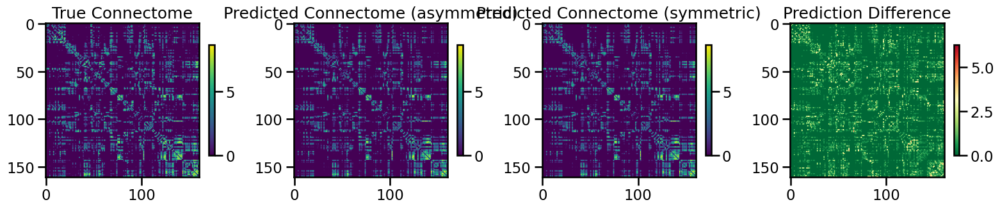

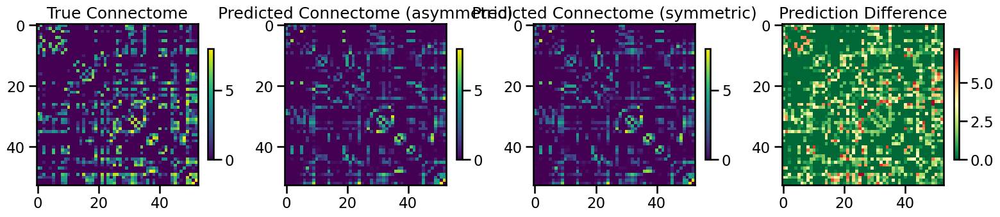

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.4018096940727926, 'mae': 0.2455322782396229, 'r2': 0.8660671433122316, 'pearson_corr': 0.933986100663849, 'geodesic_distance': 15.063602162706417}
TEST METRICS: {'mse': 3.435076247249876, 'mae': 0.9883970004115767, 'r2': 0.128511972852561, 'pearson_corr': 0.4772230531160958, 'geodesic_distance': 10.182098449540224}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.11698968706263024, 'learning_rate': 9.942717716290992e-05, 'weight_decay': 0.000358136854649361, 'batch_size': 339, 'epochs': 160, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▃▃▂▂▂▂▂▂▂▁▂▃█▂▁▁▂▁▁▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▄▁▅▆▇▇▇▅▇▇▅▇▆▇▇▆▇▇▇▇██▇▇▇▇▇▇█▇█▇████▇█▇█
train_mse_loss,█▆▆▆▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▃▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████████████
best_val_loss,0
test_mse_loss,0.09621
test_pearson,0.47276
train_mse_loss,0.02947
train_pearson,0.90721


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 5.2%
Available RAM: 954.5G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 26% |


  gc.collect()



Running simulation with: dynamic_mlp, spatial, S100, FC, seed=1
Number of components for 95% variance PCA: 34
X shape: (114, 10760)
X_pca shape: (114, 34)
Y_sc shape: (114, 114)
Y_sc_spectralL shape: (114, 113)
Y_sc_spectralA shape: (114, 114)
Y_fc shape: (114, 114)
Coordinates shape: (114, 3)
Y shape (114, 114)
Network coverage: 100.0% of regions
Network sizes: [28, 28, 28, 30]
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (114, 10763)

 Test fold num: 1 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 36idbxia
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/36idbxia


wandb: Agent Starting Run: nfn8urp4 with config:
wandb: 	batch_size: 335
wandb: 	dropout_rate: 0.1939039232356865
wandb: 	epochs: 147
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.764781809818746e-05
wandb: 	weight_decay: 0.000492895774056583
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/147, Train Loss: 0.0325, Val Loss: 0.0198
Epoch 10/147, Train Loss: 0.0278, Val Loss: 0.0209
Epoch 15/147, Train Loss: 0.0252, Val Loss: 0.0188
Epoch 20/147, Train Loss: 0.0230, Val Loss: 0.0175
Epoch 25/147, Train Loss: 0.0210, Val Loss: 0.0213
Epoch 30/147, Train Loss: 0.0191, Val Loss: 0.0101
Epoch 35/147, Train Loss: 0.0175, Val Loss: 0.0089
Epoch 40/147, Train Loss: 0.0166, Val Loss: 0.0084
Epoch 45/147, Train Loss: 0.0147, Val Loss: 0.0078
Epoch 50/147, Train Loss: 0.0135, Val Loss: 0.0076
Epoch 55/147, Train Loss: 0.0128, Val Loss: 0.0082
Epoch 60/147, Train Loss: 0.0116, Val Loss: 0.0083
Epoch 65/147, Train Loss: 0.0100, Val Loss: 0.0074
Epoch 70/147, Train Loss: 0.0093, Val Loss: 0.0074
Epoch 75/147, Train Loss: 0.0085, Val Loss: 0.0098
Epoch 80/147, Train Loss: 0.0078, Val Loss: 0.0078
Epoch 85/147, Train Loss: 0.0071, Val Loss: 0.0097
Epoch 90/147, Train Loss: 0.0069, Val Loss: 0.0099
Epoch 95/14

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 15/147, Train Loss: 0.0281, Val Loss: 0.0336
Epoch 20/147, Train Loss: 0.0261, Val Loss: 0.0232
Epoch 25/147, Train Loss: 0.0236, Val Loss: 0.0187
Epoch 30/147, Train Loss: 0.0213, Val Loss: 0.0244
Epoch 35/147, Train Loss: 0.0195, Val Loss: 0.0208
Epoch 40/147, Train Loss: 0.0182, Val Loss: 0.0134
Epoch 45/147, Train Loss: 0.0157, Val Loss: 0.0140
Epoch 50/147, Train Loss: 0.0145, Val Loss: 0.0141
Epoch 55/147, Train Loss: 0.0132, Val Loss: 0.0127
Epoch 60/147, Train Loss: 0.0118, Val Loss: 0.0141
Epoch 65/147, Train Loss: 0.0107, Val Loss: 0.0103
Epoch 70/147, Train Loss: 0.0093, Val Loss: 0.0086
Epoch 75/147, Train Loss: 0.0088, Val Loss: 0.0097
Epoch 80/147, Train Loss: 0.0079, Val Loss: 0.0062
Epoch 85/147, Train Loss: 0.0075, Val Loss: 0.0063
Epoch 90/147, Train Loss: 0.0070, Val Loss: 0.0061
Epoch 95/147, Train Loss: 0.0067, Val Loss: 0.0081
Epoch 100/147, Train Loss: 0.0060, Val Loss: 0.0053
Epoch 105/147, Train Loss: 0.0061, Val Loss: 0.0065
Epoch 110/147, Train Loss: 0.

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▇▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▄▄▄▅▅▅▆▅▅▆▆▅▆▆▅▆▆▆▆▆▆▆▆▇▆▇▇▇▇▇█▇█▇▇▇█▇▇
fold0_val_loss,█▇▄▄▄▄▁▂▂▁▁▁▁▁▂▁▁▁▁▂▂▂▂▂▂▂▂▃▂▂▂▃▃▃▃▂▂▂▂▃
fold0_val_pearson,▂▁▃▂▄▂▅▃▅▄▄▅▆▅▃▄▆▄▇▅█▆▄█▆▄▄▇▇▆▆▇▅▆▅▅▆▆▆▅
fold1_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇█
fold1_train_loss,██▇▇▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▂▃▃▃▃▃▄▃▄▄▃▄▃▄▄▄▅▅▄▆▅▅▆▆▆▆▆▆▆▆▆▆▇█▇▇▆█
fold1_val_loss,▇█▅▅▃▂▄▃▄▃▂▂▂▃▄▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▄▄▅▄▃▄▄▆▇▇▅▆▇▇▇▆▇▆█▅▇▆▆▅█▇▆▆▆▇▆▇▇▅▇▇▇▇▇
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▇▇▇▇▇▇███


wandb: Agent Starting Run: naoka8lq with config:
wandb: 	batch_size: 478
wandb: 	dropout_rate: 0.21866433742726216
wandb: 	epochs: 166
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 8.374465191753736e-05
wandb: 	weight_decay: 8.942149985895228e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import display



  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/166, Train Loss: 0.0358, Val Loss: 0.0309
Epoch 10/166, Train Loss: 0.0317, Val Loss: 0.0157
Epoch 15/166, Train Loss: 0.0278, Val Loss: 0.0116
Epoch 20/166, Train Loss: 0.0271, Val Loss: 0.0091
Epoch 25/166, Train Loss: 0.0251, Val Loss: 0.0107
Epoch 30/166, Train Loss: 0.0253, Val Loss: 0.0100
Epoch 35/166, Train Loss: 0.0238, Val Loss: 0.0098
Epoch 40/166, Train Loss: 0.0242, Val Loss: 0.0096
Epoch 45/166, Train Loss: 0.0244, Val Loss: 0.0092
Epoch 50/166, Train Loss: 0.0241, Val Loss: 0.0094
Epoch 55/166, Train Loss: 0.0243, Val Loss: 0.0094
Epoch 60/166, Train Loss: 0.0239, Val Loss: 0.0092
Epoch 65/166, Train Loss: 0.0245, Val Loss: 0.0096
Epoch 70/166, Train Loss: 0.0240, Val Loss: 0.0094
Epoch 75/166, Train Loss: 0.0242, Val Loss: 0.0094
Epoch 80/166, Train Loss: 0.0241, Val Loss: 0.0094
Epoch 85/166, Train Loss: 0.0247, Val Loss: 0.0095
Epoch 90/166, Train Loss: 0.0240, Val Loss: 0.0093
Epoch 95/16

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 150/166, Train Loss: 0.0242, Val Loss: 0.0093
Epoch 155/166, Train Loss: 0.0243, Val Loss: 0.0092
Epoch 160/166, Train Loss: 0.0242, Val Loss: 0.0093
Epoch 165/166, Train Loss: 0.0248, Val Loss: 0.0092
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/166, Train Loss: 0.0327, Val Loss: 0.0124
Epoch 10/166, Train Loss: 0.0278, Val Loss: 0.0155
Epoch 15/166, Train Loss: 0.0254, Val Loss: 0.0235
Epoch 20/166, Train Loss: 0.0232, Val Loss: 0.0246
Epoch 25/166, Train Loss: 0.0218, Val Loss: 0.0214
Epoch 30/166, Train Loss: 0.0217, Val Loss: 0.0206
Epoch 35/166, Train Loss: 0.0219, Val Loss: 0.0201
Epoch 40/166, Train Loss: 0.0220, Val Loss: 0.0205
Epoch 45/166, Train Loss: 0.0213, Val Loss: 0.0196
Epoch 50/166, Train Loss: 0.0211, Val Loss: 0.0193
Epoch 55/166, Train Loss: 0.0211, Val Loss: 0.0196
Epoch 60/166, Train Loss: 0.0217, Val Loss: 0.0201
Epoch 65/166, Train Loss: 0.0212, Val Loss: 0.0197
Epoch 70/166, Train Loss: 0.0210, Val Loss: 0.0191
Epoch 7

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▆▅▅▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▄▄▃▆▅▅▅▅█▆▆█▆▆▆█▅▅▆▆█▆▅▆▇▇▆▆█▆▅▅█▆▅▆▅█
fold0_val_loss,█▆▅▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,█▆▅▁▃▁▃▅▇▇▇▇▇█▇█▇█▇██▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇█
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇█
fold1_train_loss,█▇▅▄▄▃▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▂▁▁▂▁▂▁▂▂▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▅▃▆▄▇▆▄▃▇▇▃▇▅▄▅▄▅▃▁▆█▆▅▅▆▇▁▄▅▄▅▄█▆▅▃▅▃▅
fold1_val_loss,▄▇▁██▇▅▄▄▄▅▅▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▅▅▄▄▅▄▄▄▄▄
fold1_val_pearson,▃▁▂█▅█▇▆▆▆▇▇▇▇▇▇▇▇█▇▇▇▇█▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 7xcvaa9q with config:
wandb: 	batch_size: 452
wandb: 	dropout_rate: 0.11138334628098562
wandb: 	epochs: 174
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.287380298350734e-05
wandb: 	weight_decay: 0.00016938989799891878
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 5/174, Train Loss: 0.0215, Val Loss: 0.0210
Epoch 10/174, Train Loss: 0.0183, Val Loss: 0.0103
Epoch 15/174, Train Loss: 0.0166, Val Loss: 0.0140
Epoch 20/174, Train Loss: 0.0147, Val Loss: 0.0089
Epoch 25/174, Train Loss: 0.0134, Val Loss: 0.0089
Epoch 30/174, Train Loss: 0.0123, Val Loss: 0.0107
Epoch 35/174, Train Loss: 0.0115, Val Loss: 0.0102
Epoch 40/174, Train Loss: 0.0107, Val Loss: 0.0102
Epoch 45/174, Train Loss: 0.0093, Val Loss: 0.0085
Epoch 50/174, Train Loss: 0.0089, Val Loss: 0.0099
Epoch 55/174, Train Loss: 0.0094, Val Loss: 0.0097
Epoch 60/174, Train Loss: 0.0087, Val Loss: 0.0098
Epoch 65/174, Train Loss: 0.0088, Val Loss: 0.0099
Epoch 70/174, Train Loss: 0.0089, Val Loss: 0.0098
Epoch 75/174, Train Loss: 0.0089, Val Loss: 0.0100
Epoch 80/174, Train Loss: 0.0088, Val Loss: 0.0100
Epoch 85/174, Train Loss: 0.0090, Val Loss: 0.0097
Epoch 90/174, Train Loss: 0.0085, Val Loss: 0.0098
Epoch 95/174, Train Loss: 0.0087, Val Loss: 0.0099
Epoch 100/174, Train Loss: 0.008

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇████
fold0_train_loss,█▄▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▂▁▂▂▃▅▆▅▄▅▅▆▇▆▇▆▆▇▆▇▆▆▇█▆▇▇▆▇▇▇▇▆▇▇▇▅▇█▇
fold0_val_loss,▃█▂▅▄▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
fold0_val_pearson,▁▄▄▆▅█▇▇▇▇█▇▇▇▇▇█▇▇▇█▇▇▇█▇██▇███▇▇█▇█▇██
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇█
fold1_train_loss,█▇▇▆▆▅▅▅▅▅▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▄▄▄▄▅▄▄▅▅▅▄▅▅▅▆▅▆▆▆▆▆▆▆▆▇▆▇▆▇▇▇▇▇▇▇█▇
fold1_val_loss,█▂▂▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▃▆▆▅▅▆▆▆▅▅▆▆▆▅▅▅▃▅██▆▆▅▅▄▅▆▁▂█▇▁▂▅▇██▇▇▇
fold2_epoch,▁▁▁▁▁▂▂▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇█████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 174, 'input_dim': 21526, 'batch_size': 452, 'hidden_dims': [256, 128], 'dropout_rate': 0.11138334628098562, 'weight_decay': 0.00016938989799891878, 'learning_rate': 9.287380298350734e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/174, Train Loss: 0.0251, Val Loss: 0.1795
Epoch 10/174, Train Loss: 0.0209, Val Loss: 0.0396
Epoch 15/174, Train Loss: 0.0172, Val Loss: 0.0418
Epoch 20/174, Train Loss: 0.0149, Val Loss: 0.0218
Epoch 25/174, Train Loss: 0.0126, Val Loss: 0.0248
Epoch 30/174, Train Loss: 0.0109, Val Loss: 0.0140
Epoch 35/174, Train Loss: 0.0099, Val Loss: 0.0138
Epoch 40/174, Train Loss: 0.0092, Val Loss: 0.0107
Epoch 45/174, Train Loss: 0.0080, Val Loss: 0.0074
Epoch 50/174, Train Loss: 0.0072, Val Loss: 0.0266
Epoch 55/174, Train Loss: 0.0065, Val Loss: 0.0089
Epoch 60/174, Train Loss: 0.0061, Val Loss: 0.0052
Epoch 65/174, Train Loss: 0.0056, Val Loss: 0.0040
Epoch 70/174, Train Loss: 0.0053, Val Loss: 0.0188
Epoch 75/174, Train Loss: 0.0

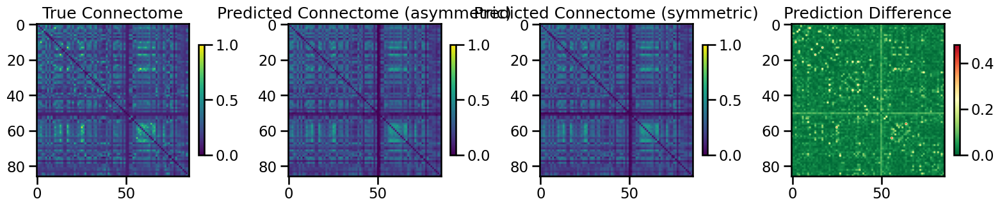

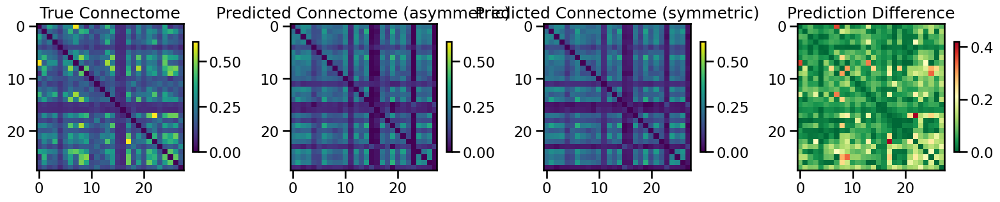

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0022032018076036867, 'mae': 0.030670476750639643, 'r2': 0.8654858400361186, 'pearson_corr': 0.943215002376983, 'geodesic_distance': 8.925390453659158}
TEST METRICS: {'mse': 0.010152538801431, 'mae': 0.07391685559732696, 'r2': 0.1474606483524512, 'pearson_corr': 0.6186635523677493, 'geodesic_distance': 6.056011949760594}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.11138334628098562, 'learning_rate': 9.287380298350734e-05, 'weight_decay': 0.00016938989799891878, 'batch_size': 452, 'epochs': 174, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▅▇▆▅▄▄▃▃▂▂▂▂▇▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▂▇▇▇▆▅▆▃▅▆▅▇▆▁▇▆█▇▇█▇▆▇▇▇▇██████████████
train_mse_loss,█▆▅▅▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▂▃▃▃▃▃▃▃▄▃▄▅▅▅▅▅▅▅▆▆▇▇▇▇▇█▇█▇▇██▇█▇███
best_val_loss,0
test_mse_loss,0.00402
test_pearson,0.61909
train_mse_loss,0.00322
train_pearson,0.66733


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 4.5%
Available RAM: 962.0G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 2 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: kketeqbq
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/kketeqbq


wandb: Agent Starting Run: vpxyeudz with config:
wandb: 	batch_size: 489
wandb: 	dropout_rate: 0.25628443205994267
wandb: 	epochs: 125
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.500329732731071e-05
wandb: 	weight_decay: 7.944045456113312e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/125, Train Loss: 0.0328, Val Loss: 0.0152
Epoch 10/125, Train Loss: 0.0289, Val Loss: 0.0410
Epoch 15/125, Train Loss: 0.0266, Val Loss: 0.0325
Epoch 20/125, Train Loss: 0.0239, Val Loss: 0.0180
Epoch 25/125, Train Loss: 0.0233, Val Loss: 0.0235
Epoch 30/125, Train Loss: 0.0213, Val Loss: 0.0363
Epoch 35/125, Train Loss: 0.0207, Val Loss: 0.0226
Epoch 40/125, Train Loss: 0.0193, Val Loss: 0.0148
Epoch 45/125, Train Loss: 0.0194, Val Loss: 0.0173
Epoch 50/125, Train Loss: 0.0186, Val Loss: 0.0156
Epoch 55/125, Train Loss: 0.0182, Val Loss: 0.0166
Epoch 60/125, Train Loss: 0.0183, Val Loss: 0.0173
Epoch 65/125, Train Loss: 0.0182, Val Loss: 0.0164
Epoch 70/125, Train Loss: 0.0182, Val Loss: 0.0166
Epoch 75/125, Train Loss: 0.0190, Val Loss: 0.0165
Epoch 80/125, Train Loss: 0.0184, Val Loss: 0.0166
Epoch 85/125, Train Loss: 0.0190, Val Loss: 0.0163
Epoch 90/125, Train Loss: 0.0187, Val Loss: 0.0161
Epoch 95/125

  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 10/125, Train Loss: 0.0311, Val Loss: 0.0110
Epoch 15/125, Train Loss: 0.0291, Val Loss: 0.0093
Epoch 20/125, Train Loss: 0.0273, Val Loss: 0.0075
Epoch 25/125, Train Loss: 0.0245, Val Loss: 0.0083
Epoch 30/125, Train Loss: 0.0236, Val Loss: 0.0076
Epoch 35/125, Train Loss: 0.0219, Val Loss: 0.0098
Epoch 40/125, Train Loss: 0.0210, Val Loss: 0.0071
Epoch 45/125, Train Loss: 0.0197, Val Loss: 0.0071
Epoch 50/125, Train Loss: 0.0188, Val Loss: 0.0064
Epoch 55/125, Train Loss: 0.0174, Val Loss: 0.0062
Epoch 60/125, Train Loss: 0.0167, Val Loss: 0.0060
Epoch 65/125, Train Loss: 0.0158, Val Loss: 0.0059
Epoch 70/125, Train Loss: 0.0156, Val Loss: 0.0056
Epoch 75/125, Train Loss: 0.0148, Val Loss: 0.0058
Epoch 80/125, Train Loss: 0.0141, Val Loss: 0.0054
Epoch 85/125, Train Loss: 0.0140, Val Loss: 0.0055
Epoch 90/125, Train Loss: 0.0137, Val Loss: 0.0054
Epoch 95/125, Train Loss: 0.0141, Val Loss: 0.0055
Epoch 100/125, Train Loss: 0.0133, Val Loss: 0.0055
Epoch 105/125, Train Loss: 0.0

fold0_epoch,▁▁▁▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇█████
fold0_train_loss,█▅▄▄▄▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▄▃▄▃▆▅▅▆▆▇▆▆▇▇▆▆▇▆▆▅▇▆██▇▇▆▇▇▆▇▇▇▆▇█▇▇█
fold0_val_loss,▆█▆▅▆▁▁▁▁▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▃▁▇█▇▇██▇▆██████████████████████████████
fold1_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,█▇▆▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▂▁▂▃▃▂▂▃▅▆▄▆▆▅▄▇▆▅▅▅▅▇▇█▆▇▇▆▇▇▇▇▇▇█▇▇▆██
fold1_val_loss,█▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▄▄▅▃▄▄▆▅▆▆▇▆▄▇▇▇▇▇▇▇▇▆▆▆▇██▇████▇██████
fold2_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇███


wandb: Agent Starting Run: 8ft6obgh with config:
wandb: 	batch_size: 469
wandb: 	dropout_rate: 0.10682554283261264
wandb: 	epochs: 139
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.928762674537503e-05
wandb: 	weight_decay: 7.275498360773973e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/139, Train Loss: 0.0211, Val Loss: 0.0203
Epoch 10/139, Train Loss: 0.0191, Val Loss: 0.0188
Epoch 15/139, Train Loss: 0.0175, Val Loss: 0.0374
Epoch 20/139, Train Loss: 0.0159, Val Loss: 0.0109
Epoch 25/139, Train Loss: 0.0145, Val Loss: 0.0115
Epoch 30/139, Train Loss: 0.0130, Val Loss: 0.0070
Epoch 35/139, Train Loss: 0.0129, Val Loss: 0.0116
Epoch 40/139, Train Loss: 0.0131, Val Loss: 0.0086
Epoch 45/139, Train Loss: 0.0126, Val Loss: 0.0136
Epoch 50/139, Train Loss: 0.0115, Val Loss: 0.0041
Epoch 55/139, Train Loss: 0.0112, Val Loss: 0.0062
Epoch 60/139, Train Loss: 0.0108, Val Loss: 0.0037
Epoch 65/139, Train Loss: 0.0114, Val Loss: 0.0048
Epoch 70/139, Train Loss: 0.0103, Val Loss: 0.0051
Epoch 75/139, Train Loss: 0.0089, Val Loss: 0.0042
Epoch 80/139, Train Loss: 0.0094, Val Loss: 0.0038
Epoch 85/139, Train Loss: 0.0099, Val Loss: 0.0038
Epoch 90/139, Train Loss: 0.0094, Val Loss: 0.0038
Epoch 95/139

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 120/139, Train Loss: 0.0093, Val Loss: 0.0035
Epoch 125/139, Train Loss: 0.0100, Val Loss: 0.0036
Epoch 130/139, Train Loss: 0.0095, Val Loss: 0.0037
Epoch 135/139, Train Loss: 0.0092, Val Loss: 0.0035
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/139, Train Loss: 0.0266, Val Loss: 0.0643
Epoch 10/139, Train Loss: 0.0251, Val Loss: 0.0293
Epoch 15/139, Train Loss: 0.0234, Val Loss: 0.0352
Epoch 20/139, Train Loss: 0.0212, Val Loss: 0.0113
Epoch 25/139, Train Loss: 0.0199, Val Loss: 0.0224
Epoch 30/139, Train Loss: 0.0187, Val Loss: 0.0195
Epoch 35/139, Train Loss: 0.0169, Val Loss: 0.0230
Epoch 40/139, Train Loss: 0.0166, Val Loss: 0.0109
Epoch 45/139, Train Loss: 0.0149, Val Loss: 0.0090
Epoch 50/139, Train Loss: 0.0143, Val Loss: 0.0106
Epoch 55/139, Train Loss: 0.0139, Val Loss: 0.0099
Epoch 60/139, Train Loss: 0.0130, Val Loss: 0.0094
Epoch 65/139, Train Loss: 0.0125, Val Loss: 0.0084
Epoch 70/139, Train Loss: 0.0114, Val Loss: 0.0090
Epoch 75

fold0_epoch,▁▁▁▁▁▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇██
fold0_train_loss,█▇▇▆▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁▂
fold0_train_pearson,▁▁▄▄▃▄▄▆▆▅▆▄▅▃▇▇▅▇▅▅▇▆▆▆▆▇▇▅▇▇▆▆█▆▇██▆▅▆
fold0_val_loss,█▇▇▅▇▂▃▄▃▄▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▃▁▄▆▄▇▆▅▃▃▇▅▅▁▅▄▇▇█▇█▇▇▆▇███████████████
fold1_epoch,▁▁▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▇▇▇▇▇███
fold1_train_loss,█▇▇▆▆▆▅▅▅▅▅▄▄▄▄▃▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
fold1_train_pearson,▂▂▃▅▄▅▂▃▁▅▅▄▅▅▅▃▅▇▅▄▅▇▅▅▆▇▆▅▅▇█▇▆▆▇▇▇██▆
fold1_val_loss,▇▃█▃▄▄▄▄▄▃▃▂▂▂▂▂▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▃▁▁▁▁▁▁
fold1_val_pearson,▄▁▃▁▃▆▇▆▇▅▇▆▆▅▇▇▇█▇▇▇▇▇▇▇▇██▆▇████▇████▇
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇██


wandb: Agent Starting Run: f7kaprbe with config:
wandb: 	batch_size: 434
wandb: 	dropout_rate: 0.26690411762737
wandb: 	epochs: 167
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.303707180751432e-05
wandb: 	weight_decay: 0.0003383005654171916
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/167, Train Loss: 0.0375, Val Loss: 0.0338
Epoch 10/167, Train Loss: 0.0313, Val Loss: 0.0238
Epoch 15/167, Train Loss: 0.0280, Val Loss: 0.0186
Epoch 20/167, Train Loss: 0.0270, Val Loss: 0.0123
Epoch 25/167, Train Loss: 0.0244, Val Loss: 0.0125
Epoch 30/167, Train Loss: 0.0239, Val Loss: 0.0116
Epoch 35/167, Train Loss: 0.0247, Val Loss: 0.0118
Epoch 40/167, Train Loss: 0.0242, Val Loss: 0.0119
Epoch 45/167, Train Loss: 0.0238, Val Loss: 0.0111
Epoch 50/167, Train Loss: 0.0242, Val Loss: 0.0115
Epoch 55/167, Train Loss: 0.0240, Val Loss: 0.0112
Epoch 60/167, Train Loss: 0.0237, Val Loss: 0.0112
Epoch 65/167, Train Loss: 0.0236, Val Loss: 0.0115
Epoch 70/167, Train Loss: 0.0236, Val Loss: 0.0111
Epoch 75/167, Train Loss: 0.0235, Val Loss: 0.0111


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 80/167, Train Loss: 0.0243, Val Loss: 0.0116
Epoch 85/167, Train Loss: 0.0238, Val Loss: 0.0112
Epoch 90/167, Train Loss: 0.0239, Val Loss: 0.0117
Epoch 95/167, Train Loss: 0.0244, Val Loss: 0.0112
Epoch 100/167, Train Loss: 0.0234, Val Loss: 0.0113
Epoch 105/167, Train Loss: 0.0234, Val Loss: 0.0118
Epoch 110/167, Train Loss: 0.0245, Val Loss: 0.0115
Epoch 115/167, Train Loss: 0.0236, Val Loss: 0.0115
Epoch 120/167, Train Loss: 0.0236, Val Loss: 0.0115
Epoch 125/167, Train Loss: 0.0231, Val Loss: 0.0111
Epoch 130/167, Train Loss: 0.0236, Val Loss: 0.0113
Epoch 135/167, Train Loss: 0.0245, Val Loss: 0.0116
Epoch 140/167, Train Loss: 0.0240, Val Loss: 0.0113
Epoch 145/167, Train Loss: 0.0242, Val Loss: 0.0114
Epoch 150/167, Train Loss: 0.0236, Val Loss: 0.0118
Epoch 155/167, Train Loss: 0.0243, Val Loss: 0.0113
Epoch 160/167, Train Loss: 0.0231, Val Loss: 0.0113
Epoch 165/167, Train Loss: 0.0242, Val Loss: 0.0112
Processing inner fold 1
Number of learnable parameters in MLP: 11187

  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 5/167, Train Loss: 0.0381, Val Loss: 0.0229
Epoch 10/167, Train Loss: 0.0341, Val Loss: 0.0326
Epoch 15/167, Train Loss: 0.0316, Val Loss: 0.0221
Epoch 20/167, Train Loss: 0.0301, Val Loss: 0.0221
Epoch 25/167, Train Loss: 0.0273, Val Loss: 0.0276
Epoch 30/167, Train Loss: 0.0249, Val Loss: 0.0143
Epoch 35/167, Train Loss: 0.0249, Val Loss: 0.0092
Epoch 40/167, Train Loss: 0.0231, Val Loss: 0.0107
Epoch 45/167, Train Loss: 0.0221, Val Loss: 0.0069
Epoch 50/167, Train Loss: 0.0222, Val Loss: 0.0092
Epoch 55/167, Train Loss: 0.0205, Val Loss: 0.0131
Epoch 60/167, Train Loss: 0.0204, Val Loss: 0.0072
Epoch 65/167, Train Loss: 0.0187, Val Loss: 0.0132
Epoch 70/167, Train Loss: 0.0186, Val Loss: 0.0057
Epoch 75/167, Train Loss: 0.0181, Val Loss: 0.0055
Epoch 80/167, Train Loss: 0.0177, Val Loss: 0.0070
Epoch 85/167, Train Loss: 0.0187, Val Loss: 0.0092
Epoch 90/167, Train Loss: 0.0188, Val Loss: 0.0109
Epoch 95/167, Train Loss: 0.0185, Val Loss: 0.0092
Epoch 100/167, Train Loss: 0.018

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇████
fold0_train_loss,██▆▆▄▂▂▃▂▂▁▂▂▁▂▂▁▂▁▂▂▂▂▂▁▂▂▁▁▁▂▂▂▂▁▂▁▂▁▂
fold0_train_pearson,▁▂▃▄▃▄▂▇▄▃▅▆▄▇▄▄▂▄█▄▄█▄▇▂▅▇▇▅▆▆▄█▅▄▆▂▅▃▄
fold0_val_loss,█▇▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▃▄▇▇███████████████████████████████████
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇████
fold1_train_loss,█▇▆▅▄▃▃▃▃▃▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
fold1_train_pearson,▁▆▆▆▅▆▅▅▄█▆▇▇▄▅▅▆▆▆▆▅▆█▆▄▆▇▆▇▆▇▆▆▄▆▇▅▇▇▅
fold1_val_loss,▇█▅▁▁▂▄▃▂▂▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
fold1_val_pearson,▄▁▁▄█▃▅▃████▇█▇██▇▇▇█▇█████▇████████████
fold2_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 139, 'input_dim': 21526, 'batch_size': 469, 'hidden_dims': [256, 128], 'dropout_rate': 0.10682554283261264, 'weight_decay': 7.275498360773973e-05, 'learning_rate': 6.928762674537503e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/139, Train Loss: 0.0177, Val Loss: 0.0143
Epoch 10/139, Train Loss: 0.0150, Val Loss: 0.0110
Epoch 15/139, Train Loss: 0.0135, Val Loss: 0.0096
Epoch 20/139, Train Loss: 0.0122, Val Loss: 0.0090
Epoch 25/139, Train Loss: 0.0113, Val Loss: 0.0095
Epoch 30/139, Train Loss: 0.0102, Val Loss: 0.0092
Epoch 35/139, Train Loss: 0.0096, Val Loss: 0.0085
Epoch 40/139, Train Loss: 0.0091, Val Loss: 0.0081
Epoch 45/139, Train Loss: 0.0083, Val Loss: 0.0081
Epoch 50/139, Train Loss: 0.0076, Val Loss: 0.0078
Epoch 55/139, Train Loss: 0.0072, Val Loss: 0.0077
Epoch 60/139, Train Loss: 0.0066, Val Loss: 0.0081
Epoch 65/139, Train Loss: 0.0061, Val Loss: 0.0080
Epoch 70/139, Train Loss: 0.0057, Val Loss: 0.0084
Epoch 75/139, Train Loss: 0.00

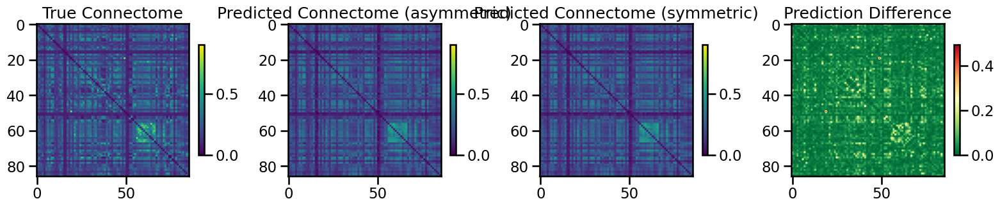

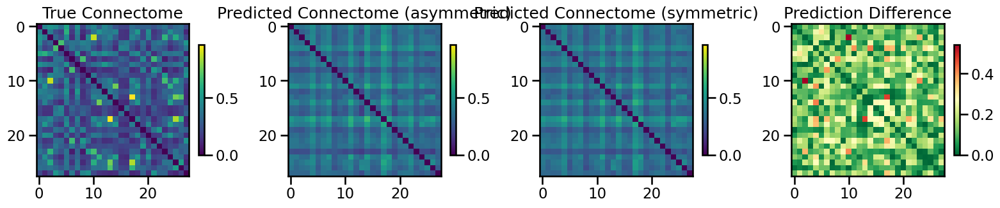

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0027460275673104346, 'mae': 0.03513823497832763, 'r2': 0.7894613877766358, 'pearson_corr': 0.8974910417203832, 'geodesic_distance': 6.8067149455524305}
TEST METRICS: {'mse': 0.027068128660430343, 'mae': 0.1349393173800184, 'r2': -0.30435944518724845, 'pearson_corr': 0.208631383379818, 'geodesic_distance': 5.796757295310944}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.10682554283261264, 'learning_rate': 6.928762674537503e-05, 'weight_decay': 7.275498360773973e-05, 'batch_size': 469, 'epochs': 139, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▅▅▃▄▂▃▂▂▁▂▁▂▁▂▂▃▂▂▂▂▂▂▃▂▃▂▃▂▃▃▃▃▃▃▃▃▃▃
test_pearson,▁▅▅▆▇▆▇▅▇▅▇██▇▇█▇▇█▇▆▇▇▆▇▇▇▇▆▇▆▇▇▆▇▇▇▆▇▆
train_mse_loss,█▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▂▂▃▃▃▃▄▄▄▄▅▄▅▅▅▅▆▆▇▇▆▇▇▇█▇▇███▇██▇████
best_val_loss,0
test_mse_loss,0.00915
test_pearson,0.20391
train_mse_loss,0.00475
train_pearson,0.58538


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 4.5%
Available RAM: 961.9G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 3 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 79v843m6
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/79v843m6


wandb: Agent Starting Run: d76wek7w with config:
wandb: 	batch_size: 290
wandb: 	dropout_rate: 0.18163755749100727
wandb: 	epochs: 164
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 8.173634927033742e-05
wandb: 	weight_decay: 5.761260616961223e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/164, Train Loss: 0.0289, Val Loss: 0.0352
Epoch 10/164, Train Loss: 0.0239, Val Loss: 0.0159
Epoch 15/164, Train Loss: 0.0216, Val Loss: 0.0141
Epoch 20/164, Train Loss: 0.0182, Val Loss: 0.0108
Epoch 25/164, Train Loss: 0.0167, Val Loss: 0.0113
Epoch 30/164, Train Loss: 0.0151, Val Loss: 0.0125
Epoch 35/164, Train Loss: 0.0131, Val Loss: 0.0117
Epoch 40/164, Train Loss: 0.0118, Val Loss: 0.0074
Epoch 45/164, Train Loss: 0.0111, Val Loss: 0.0069
Epoch 50/164, Train Loss: 0.0115, Val Loss: 0.0070
Epoch 55/164, Train Loss: 0.0107, Val Loss: 0.0072
Epoch 60/164, Train Loss: 0.0111, Val Loss: 0.0068
Epoch 65/164, Train Loss: 0.0105, Val Loss: 0.0071
Epoch 70/164, Train Loss: 0.0108, Val Loss: 0.0065
Epoch 75/164, Train Loss: 0.0101, Val Loss: 0.0068
Epoch 80/164, Train Loss: 0.0102, Val Loss: 0.0065
Epoch 85/164, Train Loss: 0.0102, Val Loss: 0.0072
Epoch 90/164, Train Loss: 0.0098, Val Loss: 0.0063
Epoch 95/16

  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 65/164, Train Loss: 0.0143, Val Loss: 0.0078
Epoch 70/164, Train Loss: 0.0143, Val Loss: 0.0079
Epoch 75/164, Train Loss: 0.0143, Val Loss: 0.0077
Epoch 80/164, Train Loss: 0.0144, Val Loss: 0.0078
Epoch 85/164, Train Loss: 0.0143, Val Loss: 0.0076
Epoch 90/164, Train Loss: 0.0138, Val Loss: 0.0077
Epoch 95/164, Train Loss: 0.0142, Val Loss: 0.0080
Epoch 100/164, Train Loss: 0.0143, Val Loss: 0.0074
Epoch 105/164, Train Loss: 0.0143, Val Loss: 0.0075
Epoch 110/164, Train Loss: 0.0146, Val Loss: 0.0076
Epoch 115/164, Train Loss: 0.0143, Val Loss: 0.0077
Epoch 120/164, Train Loss: 0.0142, Val Loss: 0.0076
Epoch 125/164, Train Loss: 0.0148, Val Loss: 0.0077
Epoch 130/164, Train Loss: 0.0148, Val Loss: 0.0076
Epoch 135/164, Train Loss: 0.0142, Val Loss: 0.0077
Epoch 140/164, Train Loss: 0.0139, Val Loss: 0.0076
Epoch 145/164, Train Loss: 0.0143, Val Loss: 0.0077
Epoch 150/164, Train Loss: 0.0139, Val Loss: 0.0076
Epoch 155/164, Train Loss: 0.0140, Val Loss: 0.0076
Epoch 160/164, Trai

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,██▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▄▄▅▅▆▆▆▇▇▆▆▆▇▇▇▇▆▇▇▇▇▇▇▇▇▇█▇███▇▇▇▇▇█▇
fold0_val_loss,█▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▅▄█▇▇▇▅▇▅▇▅▆▅▅▅▆▅▅▆▆▇▇▆▇▇▇█▆▇▇▆▆▇▆▆▆▆▆▇
fold1_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇███
fold1_train_loss,█▆▄▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▃▃▅▅▆▇▇▇▆▄▇▅▇▇▆▇▇▇▇▇▇▆▇█▅▇▇█▇▇▇▇▇▇▇▆██▇
fold1_val_loss,█▅▄▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▄▂▅▅▁▆▅▅▆▇█▇▇██▆▆▇▇▇▇▆██▇▇▇▇█▇█▇▇▆▇▇▆▇▇▇
fold2_epoch,▁▁▁▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███


wandb: Agent Starting Run: yejzrun7 with config:
wandb: 	batch_size: 322
wandb: 	dropout_rate: 0.25541394388196975
wandb: 	epochs: 102
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.80289992339714e-05
wandb: 	weight_decay: 6.251086722397674e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/102, Train Loss: 0.0364, Val Loss: 0.0386
Epoch 10/102, Train Loss: 0.0311, Val Loss: 0.0347
Epoch 15/102, Train Loss: 0.0273, Val Loss: 0.0313
Epoch 20/102, Train Loss: 0.0248, Val Loss: 0.0249


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 25/102, Train Loss: 0.0235, Val Loss: 0.0226
Epoch 30/102, Train Loss: 0.0235, Val Loss: 0.0235
Epoch 35/102, Train Loss: 0.0226, Val Loss: 0.0237
Epoch 40/102, Train Loss: 0.0223, Val Loss: 0.0209
Epoch 45/102, Train Loss: 0.0225, Val Loss: 0.0236
Epoch 50/102, Train Loss: 0.0225, Val Loss: 0.0197
Epoch 55/102, Train Loss: 0.0234, Val Loss: 0.0212
Epoch 60/102, Train Loss: 0.0229, Val Loss: 0.0212
Epoch 65/102, Train Loss: 0.0226, Val Loss: 0.0223
Epoch 70/102, Train Loss: 0.0217, Val Loss: 0.0217
Epoch 75/102, Train Loss: 0.0230, Val Loss: 0.0212
Epoch 80/102, Train Loss: 0.0217, Val Loss: 0.0218
Epoch 85/102, Train Loss: 0.0224, Val Loss: 0.0216
Epoch 90/102, Train Loss: 0.0224, Val Loss: 0.0220
Epoch 95/102, Train Loss: 0.0220, Val Loss: 0.0227
Epoch 100/102, Train Loss: 0.0224, Val Loss: 0.0217
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/102, Train Loss: 0.0325, Val Loss: 0.0104
Epoch 10/102, Train Loss: 0.0278, Val Loss: 0.0090
Epoch 15/1

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▇▆▆▅▅▄▄▄▄▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▂▁▂▁▁▂▂▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▂▂▅▇▇▆▇▅▆▅▆▆▇█▇▇▇▇▆▇▇▆▆▇▆▇▆▆▅▇▇▇▆▅▇▆▇
fold0_val_loss,▁▂▅█▆▃▃▄▄▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
fold0_val_pearson,▁▇▇▆▇▆▆▇▆▇█▇▇▆▇█▇██▆██▆▇▇▇▇▇▇█▇▇▇▇▆▇▇▇██
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇███
fold1_train_loss,█▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▄▅▄▄▅▅▅▆▆▄▅▆▅▆▆▆▆▅▆▆▇▆▇▇▆▇██▆▆▇▆▇▇▇▇▆
fold1_val_loss,██▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▃▂▁▄▂▄▅▅▄▃▅▅▅▅▄▄▆▆▅▅▆▇▆▇▇█████▇▇▇▇█▇▇▇█▇
fold2_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇███


wandb: Agent Starting Run: s4pv3we5 with config:
wandb: 	batch_size: 309
wandb: 	dropout_rate: 0.10519831840179616
wandb: 	epochs: 155
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.1996318453433106e-05
wandb: 	weight_decay: 0.000488264383639188
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/155, Train Loss: 0.0331, Val Loss: 0.0311
Epoch 10/155, Train Loss: 0.0301, Val Loss: 0.0452
Epoch 15/155, Train Loss: 0.0275, Val Loss: 0.0633


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 20/155, Train Loss: 0.0262, Val Loss: 0.0568
Epoch 25/155, Train Loss: 0.0250, Val Loss: 0.0389
Epoch 30/155, Train Loss: 0.0250, Val Loss: 0.0431
Epoch 35/155, Train Loss: 0.0245, Val Loss: 0.0410
Epoch 40/155, Train Loss: 0.0236, Val Loss: 0.0406
Epoch 45/155, Train Loss: 0.0237, Val Loss: 0.0409
Epoch 50/155, Train Loss: 0.0243, Val Loss: 0.0414
Epoch 55/155, Train Loss: 0.0241, Val Loss: 0.0419
Epoch 60/155, Train Loss: 0.0241, Val Loss: 0.0413
Epoch 65/155, Train Loss: 0.0246, Val Loss: 0.0423
Epoch 70/155, Train Loss: 0.0240, Val Loss: 0.0417
Epoch 75/155, Train Loss: 0.0242, Val Loss: 0.0415
Epoch 80/155, Train Loss: 0.0240, Val Loss: 0.0408
Epoch 85/155, Train Loss: 0.0242, Val Loss: 0.0417
Epoch 90/155, Train Loss: 0.0242, Val Loss: 0.0410
Epoch 95/155, Train Loss: 0.0241, Val Loss: 0.0425
Epoch 100/155, Train Loss: 0.0245, Val Loss: 0.0419
Epoch 105/155, Train Loss: 0.0237, Val Loss: 0.0417
Epoch 110/155, Train Loss: 0.0237, Val Loss: 0.0420
Epoch 115/155, Train Loss: 0

fold0_epoch,▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇████
fold0_train_loss,█▅▄▄▄▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▄▅▅▅▆▇▆▆▇███▆█▇█▇█▇▇▇▇▇█▇▆█▇▇█▇▇▇▇▇▇██▇
fold0_val_loss,▁▄▄▂▆█▇▆▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
fold0_val_pearson,▁▇█▇█▇█▅▆▇▇█▇█▇▇▇▇█████▇██▇█▇██████▇▇███
fold1_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
fold1_train_loss,██▇▇▆▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▄▄▆▄▆▆▆▆▇▇█▇█▇▇▇▇▇▇▇█▇█▇█▇▆██▇██▇▇▇▇█▇
fold1_val_loss,▆▇▆▆█▅▃▅▄▃▂▂▄▃▂▂▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▂▄▁█▄▆█▅▅▄▄▃▁▄▅▄▅▆▆▆▆▄▆▇▇▇▅▆▇█▇██▆▇▆▆▆▆▆
fold2_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 164, 'input_dim': 21526, 'batch_size': 290, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.18163755749100727, 'weight_decay': 5.761260616961223e-05, 'learning_rate': 8.173634927033742e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/164, Train Loss: 0.0230, Val Loss: 0.0178
Epoch 10/164, Train Loss: 0.0180, Val Loss: 0.0127
Epoch 15/164, Train Loss: 0.0143, Val Loss: 0.0091
Epoch 20/164, Train Loss: 0.0122, Val Loss: 0.0072
Epoch 25/164, Train Loss: 0.0102, Val Loss: 0.0065
Epoch 30/164, Train Loss: 0.0086, Val Loss: 0.0067
Epoch 35/164, Train Loss: 0.0078, Val Loss: 0.0058
Epoch 40/164, Train Loss: 0.0066, Val Loss: 0.0058
Epoch 45/164, Train Loss: 0.0058, Val Loss: 0.0052
Epoch 50/164, Train Loss: 0.0052, Val Loss: 0.0054
Epoch 55/164, Train Loss: 0.0044, Val Loss: 0.0052
Epoch 60/164, Train Loss: 0.0044, Val Loss: 0.0052
Epoch 65/164, Train Loss: 0.0038, Val Loss: 0.0051
Epoch 70/164, Train Loss: 0.0038, Val Loss: 0.0050
Epoch 75/164, Train Loss

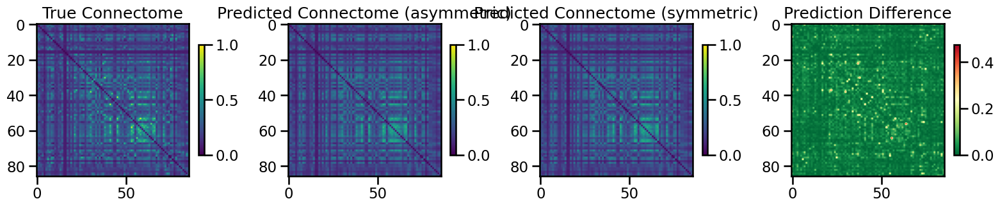

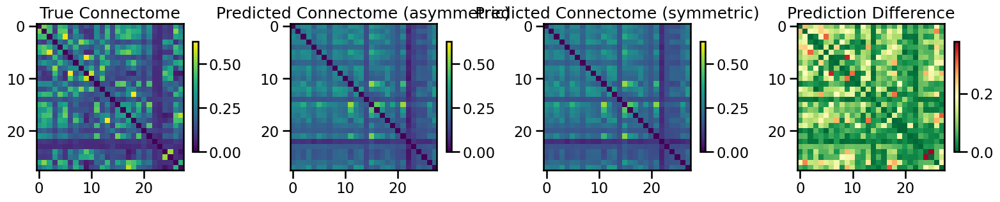

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.001681344192267876, 'mae': 0.0262045869718639, 'r2': 0.8896525630194686, 'pearson_corr': 0.9452149638319265, 'geodesic_distance': 7.988768141084065}
TEST METRICS: {'mse': 0.012450339761038463, 'mae': 0.08649912809331115, 'r2': 0.24993852717076726, 'pearson_corr': 0.5080004824339138, 'geodesic_distance': 5.24724943586068}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.18163755749100727, 'learning_rate': 8.173634927033742e-05, 'weight_decay': 5.761260616961223e-05, 'batch_size': 290, 'epochs': 164, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▆▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▁▄▆▇▇▇▇▇█▇▇▇▇█▇███▇█████████████████████
train_mse_loss,█▅▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▃▃▃▃▄▄▅▅▆▆▆▆▆▇▇█▇▇████████████████████
best_val_loss,0
test_mse_loss,0.005
test_pearson,0.49436
train_mse_loss,0.00249
train_pearson,0.73617


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 4.5%
Available RAM: 962.1G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 4 X_train shape: (6972, 21526) Y_train shape: (6972,) X_test shape: (870, 21526) Y_test shape: (870,)
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: f8ado189
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/f8ado189


wandb: Agent Starting Run: hurcgifp with config:
wandb: 	batch_size: 279
wandb: 	dropout_rate: 0.12177850325889944
wandb: 	epochs: 140
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.39330637182927e-05
wandb: 	weight_decay: 0.00010735397063596836
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/140, Train Loss: 0.0253, Val Loss: 0.0245
Epoch 10/140, Train Loss: 0.0232, Val Loss: 0.0314
Epoch 15/140, Train Loss: 0.0200, Val Loss: 0.0233
Epoch 20/140, Train Loss: 0.0188, Val Loss: 0.0191
Epoch 25/140, Train Loss: 0.0180, Val Loss: 0.0203
Epoch 30/140, Train Loss: 0.0182, Val Loss: 0.0210
Epoch 35/140, Train Loss: 0.0186, Val Loss: 0.0210
Epoch 40/140, Train Loss: 0.0165, Val Loss: 0.0207
Epoch 45/140, Train Loss: 0.0177, Val Loss: 0.0198
Epoch 50/140, Train Loss: 0.0173, Val Loss: 0.0207
Epoch 55/140, Train Loss: 0.0177, Val Loss: 0.0207
Epoch 60/140, Train Loss: 0.0173, Val Loss: 0.0201
Epoch 65/140, Train Loss: 0.0175, Val Loss: 0.0221
Epoch 70/140, Train Loss: 0.0169, Val Loss: 0.0192
Epoch 75/140, Train Loss: 0.0162, Val Loss: 0.0189
Epoch 80/140, Train Loss: 0.0180, Val Loss: 0.0185
Epoch 85/140, Train Loss: 0.0176, Val Loss: 0.0186
Epoch 90/140, Train Loss: 0.0186, Val Loss: 0.0226


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 95/140, Train Loss: 0.0169, Val Loss: 0.0198
Epoch 100/140, Train Loss: 0.0168, Val Loss: 0.0200
Epoch 105/140, Train Loss: 0.0160, Val Loss: 0.0200
Epoch 110/140, Train Loss: 0.0164, Val Loss: 0.0192
Epoch 115/140, Train Loss: 0.0169, Val Loss: 0.0197
Epoch 120/140, Train Loss: 0.0163, Val Loss: 0.0199
Epoch 125/140, Train Loss: 0.0170, Val Loss: 0.0194
Epoch 130/140, Train Loss: 0.0167, Val Loss: 0.0189
Epoch 135/140, Train Loss: 0.0167, Val Loss: 0.0200
Epoch 140/140, Train Loss: 0.0170, Val Loss: 0.0206
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/140, Train Loss: 0.0244, Val Loss: 0.0245
Epoch 10/140, Train Loss: 0.0208, Val Loss: 0.0116
Epoch 15/140, Train Loss: 0.0190, Val Loss: 0.0112
Epoch 20/140, Train Loss: 0.0177, Val Loss: 0.0118
Epoch 25/140, Train Loss: 0.0162, Val Loss: 0.0143
Epoch 30/140, Train Loss: 0.0164, Val Loss: 0.0083
Epoch 35/140, Train Loss: 0.0140, Val Loss: 0.0075
Epoch 40/140, Train Loss: 0.0135, Val Loss: 0.0083
Epo

fold0_epoch,▁▁▁▁▁▂▂▂▂▃▃▄▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇███
fold0_train_loss,██▇▆▃▄▃▃▃▂▃▂▂▂▂▂▂▂▂▁▂▂▃▁▂▁▂▂▂▂▂▂▃▁▂▃▂▁▂▂
fold0_train_pearson,▂▁▅▆▄▄▅▆▄▆▆▄▅▆▆▇▄▅█▇▅▇▇▆▅▂▄▂▅▅▄▅▆▆▅▅▅▆▇▆
fold0_val_loss,▃█▄▂▂▁▂▂▁▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▂▂▂▂▂▂▂▂▁▂▂▂▂▂
fold0_val_pearson,▆▁▇▆▇▅▅▆▇▇▇▇█▇▇▇▇██▇▇▇▇▇██▇▇█▇▇█▇███████
fold1_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇██
fold1_train_loss,█▇▆▅▅▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▂▁▄▂▂▃▅▃▄▁▇▆▆▄▇▄▅▄▅▆▆▇▆▆▆▅▇█▅▆▆▆▇▇▇▆▆█▆█
fold1_val_loss,▃▃█▇▃▂▄▃▁▁▁▁▂▁▂▂▁▂▁▁▂▁▁▂▁▂▁▁▁▁▂▂▁▁▁▁▁▁▁▁
fold1_val_pearson,▂▁▂▂▁▂▄▅▄▃▆▆▅▆▅▄▄▄▇▇██▇▆▆▆▆▆▆▇▇▆▆▆▇▇▆▇▇▇
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇█


wandb: Agent Starting Run: vzjn86f4 with config:
wandb: 	batch_size: 348
wandb: 	dropout_rate: 0.1902978381172155
wandb: 	epochs: 133
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.60782680766579e-05
wandb: 	weight_decay: 0.0001390142470057537
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/133, Train Loss: 0.0361, Val Loss: 0.0463
Epoch 10/133, Train Loss: 0.0321, Val Loss: 0.0222
Epoch 15/133, Train Loss: 0.0282, Val Loss: 0.0289
Epoch 20/133, Train Loss: 0.0256, Val Loss: 0.0252
Epoch 25/133, Train Loss: 0.0251, Val Loss: 0.0242
Epoch 30/133, Train Loss: 0.0244, Val Loss: 0.0245
Epoch 35/133, Train Loss: 0.0241, Val Loss: 0.0265
Epoch 40/133, Train Loss: 0.0242, Val Loss: 0.0253
Epoch 45/133, Train Loss: 0.0241, Val Loss: 0.0248
Epoch 50/133, Train Loss: 0.0240, Val Loss: 0.0247
Epoch 55/133, Train Loss: 0.0236, Val Loss: 0.0236
Epoch 60/133, Train Loss: 0.0234, Val Loss: 0.0254
Epoch 65/133, Train Loss: 0.0248, Val Loss: 0.0239
Epoch 70/133, Train Loss: 0.0240, Val Loss: 0.0242
Epoch 75/133, Train Loss: 0.0241, Val Loss: 0.0259
Epoch 80/133, Train Loss: 0.0235, Val Loss: 0.0239
Epoch 85/133, Train Loss: 0.0232, Val Loss: 0.0234
Epoch 90/133, Train Loss: 0.0241, Val Loss: 0.0236
Epoch 95/13

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 130/133, Train Loss: 0.0243, Val Loss: 0.0230
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/133, Train Loss: 0.0289, Val Loss: 0.0110
Epoch 10/133, Train Loss: 0.0253, Val Loss: 0.0202
Epoch 15/133, Train Loss: 0.0226, Val Loss: 0.0098
Epoch 20/133, Train Loss: 0.0219, Val Loss: 0.0084
Epoch 25/133, Train Loss: 0.0198, Val Loss: 0.0101
Epoch 30/133, Train Loss: 0.0186, Val Loss: 0.0080
Epoch 35/133, Train Loss: 0.0175, Val Loss: 0.0077
Epoch 40/133, Train Loss: 0.0164, Val Loss: 0.0101
Epoch 45/133, Train Loss: 0.0159, Val Loss: 0.0073
Epoch 50/133, Train Loss: 0.0147, Val Loss: 0.0070
Epoch 55/133, Train Loss: 0.0139, Val Loss: 0.0076
Epoch 60/133, Train Loss: 0.0135, Val Loss: 0.0075
Epoch 65/133, Train Loss: 0.0127, Val Loss: 0.0080
Epoch 70/133, Train Loss: 0.0123, Val Loss: 0.0090
Epoch 75/133, Train Loss: 0.0121, Val Loss: 0.0083
Epoch 80/133, Train Loss: 0.0121, Val Loss: 0.0085
Epoch 85/133, Train Loss: 0.0119, Val Loss: 0.0085
Epoch 90/1

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,█▆▅▃▃▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▂
fold0_train_pearson,▁▂▃▃▂▆▆█▇▆▇▇▇▇▇▆▇▇██▆▆▇▆▇▇▇▇▆▇▇▇▆▇▇▇▇▇▆▇
fold0_val_loss,▁█▆▃▄▄▅▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
fold0_val_pearson,▆▁▂▅▄▇█▆▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇█▇▇▇▇██
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇████
fold1_train_loss,█▇▇▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▁▄▄▄▃▅▄▃▃▄▅▅▄▅▅▅▅▆▆▇▇▇▇▇▆▇▇▅▇██▇▆█▇▇▇▇
fold1_val_loss,▄▅▅▅█▄▃▃▂▂▄▁▃▁▂▁▁▂▂▁▂▁▁▂▃▂▂▂▂▃▂▃▃▃▃▃▂▃▂▂
fold1_val_pearson,▃▃▅▆▆▅▁▃▃▅▄▅▆▆▅▆▇▇▇▇█▅▇▇▇▇▆█▆▇▆▆▇▆▇▅▆▆▇█
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇█████


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: mls83efq with config:
wandb: 	batch_size: 298
wandb: 	dropout_rate: 0.10546939574121734
wandb: 	epochs: 167
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.470366904406316e-05
wandb: 	weight_decay: 0.0004029113362310774
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/167, Train Loss: 0.0306, Val Loss: 0.0175
Epoch 10/167, Train Loss: 0.0268, Val Loss: 0.0387
Epoch 15/167, Train Loss: 0.0258, Val Loss: 0.1075
Epoch 20/167, Train Loss: 0.0234, Val Loss: 0.0229
Epoch 25/167, Train Loss: 0.0225, Val Loss: 0.0274
Epoch 30/167, Train Loss: 0.0216, Val Loss: 0.0251
Epoch 35/167, Train Loss: 0.0216, Val Loss: 0.0259
Epoch 40/167, Train Loss: 0.0215, Val Loss: 0.0281
Epoch 45/167, Train Loss: 0.0215, Val Loss: 0.0272
Epoch 50/167, Train Loss: 0.0208, Val Loss: 0.0264


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 55/167, Train Loss: 0.0212, Val Loss: 0.0273
Epoch 60/167, Train Loss: 0.0210, Val Loss: 0.0266
Epoch 65/167, Train Loss: 0.0218, Val Loss: 0.0280
Epoch 70/167, Train Loss: 0.0211, Val Loss: 0.0270
Epoch 75/167, Train Loss: 0.0217, Val Loss: 0.0278
Epoch 80/167, Train Loss: 0.0209, Val Loss: 0.0274
Epoch 85/167, Train Loss: 0.0212, Val Loss: 0.0272
Epoch 90/167, Train Loss: 0.0212, Val Loss: 0.0272
Epoch 95/167, Train Loss: 0.0214, Val Loss: 0.0266
Epoch 100/167, Train Loss: 0.0214, Val Loss: 0.0266
Epoch 105/167, Train Loss: 0.0216, Val Loss: 0.0262
Epoch 110/167, Train Loss: 0.0216, Val Loss: 0.0274
Epoch 115/167, Train Loss: 0.0210, Val Loss: 0.0274
Epoch 120/167, Train Loss: 0.0207, Val Loss: 0.0279
Epoch 125/167, Train Loss: 0.0211, Val Loss: 0.0276
Epoch 130/167, Train Loss: 0.0215, Val Loss: 0.0262
Epoch 135/167, Train Loss: 0.0210, Val Loss: 0.0272
Epoch 140/167, Train Loss: 0.0217, Val Loss: 0.0268
Epoch 145/167, Train Loss: 0.0211, Val Loss: 0.0271
Epoch 150/167, Train 

fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇███
fold0_train_loss,█▆▅▅▅▄▄▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▅▃▅▆▇▆▇▇▆▇▆▇▇▇▇▇█▇▇▆▆▆█▇█▇█▇▇▇▆▇▇▇▇▇▆▇
fold0_val_loss,▁█▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
fold0_val_pearson,█▅▃█▇▁▄▆▇▇▆▆▆▇▇▇▆▆▆▇▆▆▆▇▇▆▇▇▆▇▇▇▇▇▇▆▇▆▇▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
fold1_train_loss,█▇▆▆▆▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▄▃▃▆▅▆▅▅▅▆▆▇▆▇▇▇▇▇█▇█▇▇▇▇▇█▇█▇████▇█▇█
fold1_val_loss,▆▃█▄▂▃▁▂▁▂▂▁▁▁▂▆▂▁▂▆▁▃▂▂▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
fold1_val_pearson,▁▄▅▄▄▄█▃▇▅█▁▇▅▆██▄▆▇█▇▆▅▇▇▆▆▆▇▆▇▆▆▆▇▆▆▆▇
fold2_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇█████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 140, 'input_dim': 21526, 'batch_size': 279, 'hidden_dims': [256, 128], 'dropout_rate': 0.12177850325889944, 'weight_decay': 0.00010735397063596836, 'learning_rate': 6.39330637182927e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/140, Train Loss: 0.0165, Val Loss: 0.0228
Epoch 10/140, Train Loss: 0.0140, Val Loss: 0.0069
Epoch 15/140, Train Loss: 0.0120, Val Loss: 0.0056
Epoch 20/140, Train Loss: 0.0103, Val Loss: 0.0053
Epoch 25/140, Train Loss: 0.0095, Val Loss: 0.0050
Epoch 30/140, Train Loss: 0.0085, Val Loss: 0.0048
Epoch 35/140, Train Loss: 0.0077, Val Loss: 0.0049
Epoch 40/140, Train Loss: 0.0068, Val Loss: 0.0047
Epoch 45/140, Train Loss: 0.0064, Val Loss: 0.0047
Epoch 50/140, Train Loss: 0.0057, Val Loss: 0.0062
Epoch 55/140, Train Loss: 0.0051, Val Loss: 0.0049
Epoch 60/140, Train Loss: 0.0047, Val Loss: 0.0050
Epoch 65/140, Train Loss: 0.0044, Val Loss: 0.0051
Epoch 70/140, Train Loss: 0.0043, Val Loss: 0.0048
Epoch 75/140, Train Loss: 0.00

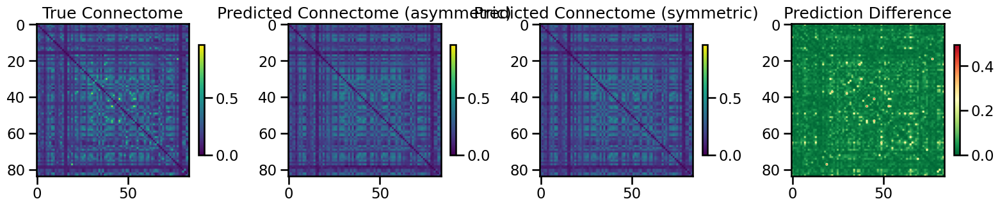

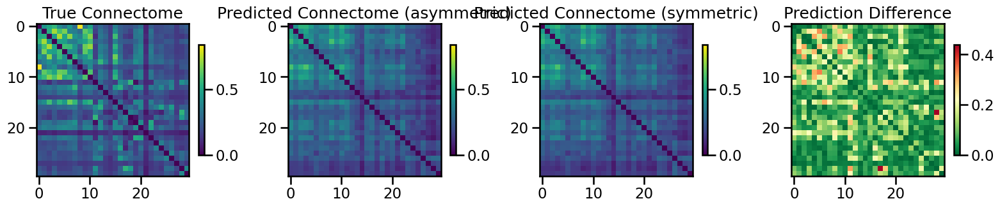

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.002379730135839757, 'mae': 0.030568720833055896, 'r2': 0.8399921911563404, 'pearson_corr': 0.9218335564382207, 'geodesic_distance': 7.590932374059844}
TEST METRICS: {'mse': 0.01309667334694527, 'mae': 0.0858081027884362, 'r2': 0.29104524472786797, 'pearson_corr': 0.5767480881563267, 'geodesic_distance': 4.88993314816187}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.12177850325889944, 'learning_rate': 6.39330637182927e-05, 'weight_decay': 0.00010735397063596836, 'batch_size': 279, 'epochs': 140, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▂▁▁█▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▃▄▅▆▁█▇█▇▇▇▇▇▆▇▆█▆▇▆▇▇▆▇▇▇▆▇▇▆▆▇▆▇▇▇▇▆▇▇
train_mse_loss,█▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▂▂▂▃▂▃▃▃▃▄▄▄▄▄▅▅▅▅▆▇▇▇▇▇█▇▇█▇█████████
best_val_loss,0
test_mse_loss,0.00523
test_pearson,0.54709
train_mse_loss,0.0041
train_pearson,0.61488


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 4.5%
Available RAM: 962.0G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |


  gc.collect()



Running simulation with: dynamic_mlp, spatial, S100, SC, seed=1
Number of components for 95% variance PCA: 34
X shape: (114, 10760)
X_pca shape: (114, 34)
Y_sc shape: (114, 114)
Y_sc_spectralL shape: (114, 113)
Y_sc_spectralA shape: (114, 114)
Y_fc shape: (114, 114)
Coordinates shape: (114, 3)
Y shape (114, 114)
Network coverage: 100.0% of regions
Network sizes: [28, 28, 28, 30]
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (114, 10763)

 Test fold num: 1 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 8on6sks9
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/8on6sks9


wandb: Agent Starting Run: 3aoanbsl with config:
wandb: 	batch_size: 292
wandb: 	dropout_rate: 0.1501624242999961
wandb: 	epochs: 145
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.63637963336513e-05
wandb: 	weight_decay: 9.402853334491806e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/145, Train Loss: 0.2457, Val Loss: 0.3931
Epoch 10/145, Train Loss: 0.2366, Val Loss: 0.3204
Epoch 15/145, Train Loss: 0.2351, Val Loss: 0.3265
Epoch 20/145, Train Loss: 0.2335, Val Loss: 0.3031
Epoch 25/145, Train Loss: 0.2292, Val Loss: 0.3107
Epoch 30/145, Train Loss: 0.2278, Val Loss: 0.3103
Epoch 35/145, Train Loss: 0.2302, Val Loss: 0.3003
Epoch 40/145, Train Loss: 0.2288, Val Loss: 0.3136
Epoch 45/145, Train Loss: 0.2278, Val Loss: 0.3103
Epoch 50/145, Train Loss: 0.2296, Val Loss: 0.3061
Epoch 55/145, Train Loss: 0.2260, Val Loss: 0.3090
Epoch 60/145, Train Loss: 0.2301, Val Loss: 0.3098
Epoch 65/145, Train Loss: 0.2260, Val Loss: 0.3076
Epoch 70/145, Train Loss: 0.2247, Val Loss: 0.3064
Epoch 75/145, Train Loss: 0.2254, Val Loss: 0.3112
Epoch 80/145, Train Loss: 0.2246, Val Loss: 0.3108
Epoch 85/145, Train Loss: 0.2264, Val Loss: 0.3075
Epoch 90/145, Train Loss: 0.2286, Val Loss: 0.3091
Epoch 95/145

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 120/145, Train Loss: 0.1822, Val Loss: 0.4030
Epoch 125/145, Train Loss: 0.1794, Val Loss: 0.4119
Epoch 130/145, Train Loss: 0.1836, Val Loss: 0.4124
Epoch 135/145, Train Loss: 0.1843, Val Loss: 0.4107
Epoch 140/145, Train Loss: 0.1847, Val Loss: 0.4082
Epoch 145/145, Train Loss: 0.1817, Val Loss: 0.4189
Processing inner fold 2
Number of learnable parameters in MLP: 5544705
Epoch 5/145, Train Loss: 0.2607, Val Loss: 0.2961
Epoch 10/145, Train Loss: 0.2574, Val Loss: 0.2623
Epoch 15/145, Train Loss: 0.2527, Val Loss: 0.2864
Epoch 20/145, Train Loss: 0.2505, Val Loss: 0.2599
Epoch 25/145, Train Loss: 0.2489, Val Loss: 0.2615
Epoch 30/145, Train Loss: 0.2452, Val Loss: 0.2638
Epoch 35/145, Train Loss: 0.2424, Val Loss: 0.2591
Epoch 40/145, Train Loss: 0.2437, Val Loss: 0.2595
Epoch 45/145, Train Loss: 0.2419, Val Loss: 0.2594
Epoch 50/145, Train Loss: 0.2407, Val Loss: 0.2590
Epoch 55/145, Train Loss: 0.2420, Val Loss: 0.2590
Epoch 60/145, Train Loss: 0.2408, Val Loss: 0.2591
Epoch 

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▇█▄▆▄▃▂▃▂▁▃▄▂▃▃▁▂▃▃▃▃▂▃▃▂▂▁▁▂▂▁▃▂▁▂▁▂▂▂
fold0_train_pearson,▁▆▇▆▆▆▆▇▇▇█▇▇▇█▇█▇███▇████████████▇█████
fold0_val_loss,▁▆█▆▆▇▆▄▂▂▁▃▃▃▄▃▂▂▃▃▄▃▃▃▃▃▃▃▄▄▅▂▃▄▂▃▃▃▃▅
fold0_val_pearson,▁▃▆▆█▅▄▅▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▇▇▇▇▇▇▇▇
fold1_epoch,▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇████
fold1_train_loss,█▆▅▃▃▃▃▄▄▃▃▂▃▂▂▄▁▃▃▁▂▂▂▂▃▃▂▃▁▃▂▁▄▃▃▃▂▃▂▂
fold1_train_pearson,▁▃▅▆▆▆▇▇▇▇▇▇███▇███████▇▇███████████████
fold1_val_loss,▂▄▆█▅▂▃▆▅▆▁▃▄▄▆▅▃▂▁▂▂▁▂▂▂▂▃▃▂▄▃▃▃▄▂▄▁▁▁▂
fold1_val_pearson,▁▄▅▆▆▇▇▇██▇████████▇▇████▇██▇██▇▇█████▇█
fold2_epoch,▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█████


wandb: Agent Starting Run: ycbexanc with config:
wandb: 	batch_size: 447
wandb: 	dropout_rate: 0.10255732600559192
wandb: 	epochs: 115
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.298406818239122e-05
wandb: 	weight_decay: 7.87323708129313e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/115, Train Loss: 0.2383, Val Loss: 0.3350
Epoch 10/115, Train Loss: 0.2302, Val Loss: 0.3187
Epoch 15/115, Train Loss: 0.2275, Val Loss: 0.3114
Epoch 20/115, Train Loss: 0.2277, Val Loss: 0.3145
Epoch 25/115, Train Loss: 0.2230, Val Loss: 0.3150
Epoch 30/115, Train Loss: 0.2244, Val Loss: 0.3165
Epoch 35/115, Train Loss: 0.2198, Val Loss: 0.3156
Epoch 40/115, Train Loss: 0.2182, Val Loss: 0.3167
Epoch 45/115, Train Loss: 0.2209, Val Loss: 0.3105


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 50/115, Train Loss: 0.2216, Val Loss: 0.3139
Epoch 55/115, Train Loss: 0.2167, Val Loss: 0.3155
Epoch 60/115, Train Loss: 0.2217, Val Loss: 0.3135
Epoch 65/115, Train Loss: 0.2190, Val Loss: 0.3155
Epoch 70/115, Train Loss: 0.2185, Val Loss: 0.3137
Epoch 75/115, Train Loss: 0.2233, Val Loss: 0.3129
Epoch 80/115, Train Loss: 0.2206, Val Loss: 0.3137
Epoch 85/115, Train Loss: 0.2169, Val Loss: 0.3148
Epoch 90/115, Train Loss: 0.2212, Val Loss: 0.3139
Epoch 95/115, Train Loss: 0.2230, Val Loss: 0.3157
Epoch 100/115, Train Loss: 0.2225, Val Loss: 0.3162
Epoch 105/115, Train Loss: 0.2245, Val Loss: 0.3175
Epoch 110/115, Train Loss: 0.2202, Val Loss: 0.3106
Epoch 115/115, Train Loss: 0.2167, Val Loss: 0.3158
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/115, Train Loss: 0.1937, Val Loss: 0.4456
Epoch 10/115, Train Loss: 0.1909, Val Loss: 0.4050
Epoch 15/115, Train Loss: 0.1910, Val Loss: 0.4300
Epoch 20/115, Train Loss: 0.1869, Val Loss: 0.4152
Epoch 2

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▇▇▇▇███
fold0_train_loss,█▇▆▅▅▅▅▄▂▃▃▃▂▂▃▂▃▂▂▄▂▃▂▃▂▂▂▂▂▂▁▄▂▃▃▂▃▃▃▂
fold0_train_pearson,▁▆▆▇▇▇██▇▇██████████████████████████████
fold0_val_loss,▆▇█▇▅▁▄▂▃▄▅▄▄▃▃▄▃▃▃▃▃▂▃▃▄▃▃▃▃▄▄▃▃▄▃▄▃▄▃▄
fold0_val_pearson,▁▅▇▄█▄▅▆▇▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇████
fold1_train_loss,█▆▆▅▄▅▅▄▃▃▃▃▃▃▂▂▃▂▂▁▁▂▂▂▂▁▂▁▂▂▂▂▂▁▁▁▃▃▂▂
fold1_train_pearson,▁▃▅▄▄▆▆▇▇▇▇██▇▇█▇███████▇██████▇▇████▇██
fold1_val_loss,█▄▅▄▁▃▃▃▃▃▄▂▃▂▂▂▂▂▁▂▂▂▂▃▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃
fold1_val_pearson,▁▃▃▆▅█▇████████████████▇█████▇█▇███▇████
fold2_epoch,▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇███


wandb: Agent Starting Run: fouhrd2t with config:
wandb: 	batch_size: 508
wandb: 	dropout_rate: 0.2712053799260548
wandb: 	epochs: 153
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.63204652948148e-05
wandb: 	weight_decay: 0.00012392590899574718
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/153, Train Loss: 0.2413, Val Loss: 0.3522
Epoch 10/153, Train Loss: 0.2383, Val Loss: 0.3363
Epoch 15/153, Train Loss: 0.2385, Val Loss: 0.3116
Epoch 20/153, Train Loss: 0.2365, Val Loss: 0.3180
Epoch 25/153, Train Loss: 0.2357, Val Loss: 0.3222
Epoch 30/153, Train Loss: 0.2324, Val Loss: 0.3154
Epoch 35/153, Train Loss: 0.2327, Val Loss: 0.3064
Epoch 40/153, Train Loss: 0.2334, Val Loss: 0.3165
Epoch 45/153, Train Loss: 0.2339, Val Loss: 0.3228
Epoch 50/153, Train Loss: 0.2315, Val Loss: 0.3129
Epoch 55/153, Train Loss: 0.2309, Val Loss: 0.3230
Epoch 60/153, Train Loss: 0.2327, Val Loss: 0.3131
Epoch 65/153, Train Loss: 0.2315, Val Loss: 0.3144


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 70/153, Train Loss: 0.2319, Val Loss: 0.3134
Epoch 75/153, Train Loss: 0.2315, Val Loss: 0.3109
Epoch 80/153, Train Loss: 0.2303, Val Loss: 0.3149
Epoch 85/153, Train Loss: 0.2297, Val Loss: 0.3127
Epoch 90/153, Train Loss: 0.2341, Val Loss: 0.3112
Epoch 95/153, Train Loss: 0.2312, Val Loss: 0.3252
Epoch 100/153, Train Loss: 0.2313, Val Loss: 0.3184
Epoch 105/153, Train Loss: 0.2319, Val Loss: 0.3133
Epoch 110/153, Train Loss: 0.2321, Val Loss: 0.3155
Epoch 115/153, Train Loss: 0.2316, Val Loss: 0.3155
Epoch 120/153, Train Loss: 0.2315, Val Loss: 0.3175
Epoch 125/153, Train Loss: 0.2315, Val Loss: 0.3236
Epoch 130/153, Train Loss: 0.2320, Val Loss: 0.3100
Epoch 135/153, Train Loss: 0.2328, Val Loss: 0.3086
Epoch 140/153, Train Loss: 0.2318, Val Loss: 0.3172
Epoch 145/153, Train Loss: 0.2309, Val Loss: 0.3163
Epoch 150/153, Train Loss: 0.2339, Val Loss: 0.3214
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/153, Train Loss: 0.2014, Val Loss: 0.4203


fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▆▆▆▇▇▇▇███
fold0_train_loss,█▅▄▃▃▂▂▂▁▂▂▂▂▂▂▁▂▂▂▂▂▁▂▂▁▂▂▂▂▂▁▂▂▂▂▁▁▂▂▂
fold0_train_pearson,▁▄▅▆▆▆▆▇▇▇▇█▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇█▇▇▇▇
fold0_val_loss,▂█▄▆▆▄▄▃▂▃▂▄▂▃▁▄▂▃▄▃▂▂▄▃▂▂▃▄▃▃▄▃▃▃▃▃▂▃▃▂
fold0_val_pearson,▄▃▆▃▁▅▄▆▇▅▅▆▄▇█▆▆▆▇▆▆▆▅▆▅▆▇▄▄▇█▆▅▅█▅▆▆▇▆
fold1_epoch,▁▁▁▂▂▂▂▂▂▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████
fold1_train_loss,█▆▆▅▅▄▃▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▂▂▂▂▂▁▁▂▁▁
fold1_train_pearson,▁▁▂▂▃▃▄▄▅▅▆▆▆▇▇▇▇▇▇██████████████▇███▇██
fold1_val_loss,█▅▇▄▇▅▃▃▆▆▄▄▂▂▄▂▂▄▂▃▄▄▃▃▂▄▂▂▃▂▂▃▄▃▁▃▂▂▂▂
fold1_val_pearson,▂▁▂▂▃██▇▇▇▇▇█▇▇█▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
fold2_epoch,▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 153, 'input_dim': 21526, 'batch_size': 508, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.2712053799260548, 'weight_decay': 0.00012392590899574718, 'learning_rate': 7.63204652948148e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/153, Train Loss: 0.2043, Val Loss: 0.3733
Epoch 10/153, Train Loss: 0.1988, Val Loss: 0.3624
Epoch 15/153, Train Loss: 0.1943, Val Loss: 0.3626
Epoch 20/153, Train Loss: 0.1917, Val Loss: 0.3403
Epoch 25/153, Train Loss: 0.1914, Val Loss: 0.3400
Epoch 30/153, Train Loss: 0.1855, Val Loss: 0.3537
Epoch 35/153, Train Loss: 0.1846, Val Loss: 0.3484
Epoch 40/153, Train Loss: 0.1819, Val Loss: 0.3695
Epoch 45/153, Train Loss: 0.1789, Val Loss: 0.3432
Epoch 50/153, Train Loss: 0.1791, Val Loss: 0.3408
Epoch 55/153, Train Loss: 0.1766, Val Loss: 0.3694
Epoch 60/153, Train Loss: 0.1726, Val Loss: 0.3598
Epoch 65/153, Train Loss: 0.1670, Val Loss: 0.3402
Epoch 70/153, Train Loss: 0.1663, Val Loss: 0.3539
Epoch 75/153, Train Loss:

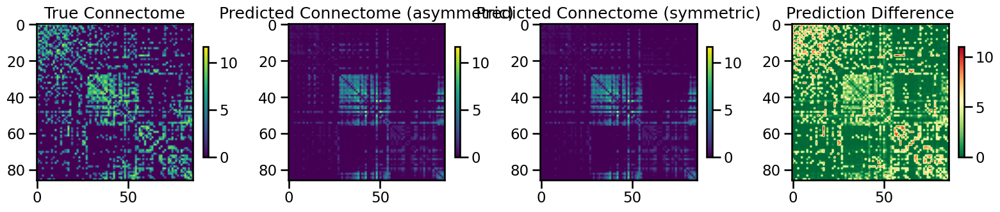

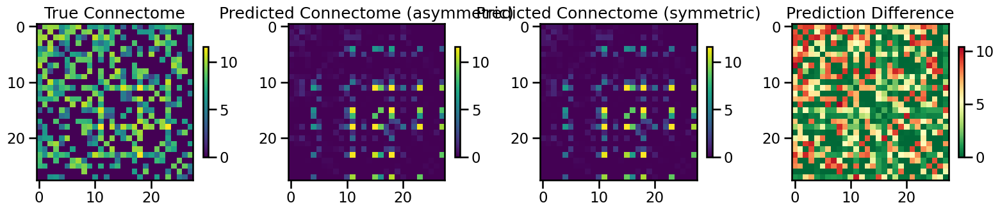

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 9.460829576934914, 'mae': 1.6094575115918488, 'r2': 0.13476479649144124, 'pearson_corr': 0.5969731200320672, 'geodesic_distance': 25.44484068995201}
TEST METRICS: {'mse': 24.776113142852154, 'mae': 3.5529987250222494, 'r2': -0.572513265999171, 'pearson_corr': 0.37403736697849277, 'geodesic_distance': 15.759195852629563}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.2712053799260548, 'learning_rate': 7.63204652948148e-05, 'weight_decay': 0.00012392590899574718, 'batch_size': 508, 'epochs': 153, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▄▂▄▂▄▃▂▂▃▃▂▄▂▂▁▂▂▃▂▂▃▃▂▃▃▂▂▃▂▃▃▃▂▃▂▁▃▂
test_pearson,▁▇▇▆▆▆▇▇▇▇█▇▇▇▇██▇███████▇▇▇█▇█▇██▇▇▇▇██
train_mse_loss,█▆▆▅▅▅▄▄▃▄▃▃▃▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▂▁▁▂▂▃▃▃▃▃▃▃▄▄▅▅▅▆▇▇▇█████████████████
best_val_loss,0
test_mse_loss,0.34458
test_pearson,0.37099
train_mse_loss,0.16544
train_pearson,0.55488


Final evaluation metrics logged successfully.
CPU Usage: 1.2%
RAM Usage: 4.5%
Available RAM: 962.1G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 2 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: yfmu5ghe
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/yfmu5ghe


wandb: Agent Starting Run: q4xvpcld with config:
wandb: 	batch_size: 337
wandb: 	dropout_rate: 0.15255719992087177
wandb: 	epochs: 112
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.24387528548711e-05
wandb: 	weight_decay: 0.0004464983296007462
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/112, Train Loss: 0.2421, Val Loss: 0.3685
Epoch 10/112, Train Loss: 0.2378, Val Loss: 0.3873
Epoch 15/112, Train Loss: 0.2349, Val Loss: 0.3641
Epoch 20/112, Train Loss: 0.2321, Val Loss: 0.3757
Epoch 25/112, Train Loss: 0.2298, Val Loss: 0.3623
Epoch 30/112, Train Loss: 0.2275, Val Loss: 0.3344
Epoch 35/112, Train Loss: 0.2245, Val Loss: 0.3684
Epoch 40/112, Train Loss: 0.2223, Val Loss: 0.3768


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 45/112, Train Loss: 0.2216, Val Loss: 0.3555
Epoch 50/112, Train Loss: 0.2175, Val Loss: 0.3795
Epoch 55/112, Train Loss: 0.2144, Val Loss: 0.3653
Epoch 60/112, Train Loss: 0.2131, Val Loss: 0.3511
Epoch 65/112, Train Loss: 0.2126, Val Loss: 0.3628
Epoch 70/112, Train Loss: 0.2128, Val Loss: 0.3631
Epoch 75/112, Train Loss: 0.2122, Val Loss: 0.3625
Epoch 80/112, Train Loss: 0.2120, Val Loss: 0.3686
Epoch 85/112, Train Loss: 0.2125, Val Loss: 0.3748
Epoch 90/112, Train Loss: 0.2133, Val Loss: 0.3590
Epoch 95/112, Train Loss: 0.2129, Val Loss: 0.3644
Epoch 100/112, Train Loss: 0.2119, Val Loss: 0.3563
Epoch 105/112, Train Loss: 0.2123, Val Loss: 0.3552
Epoch 110/112, Train Loss: 0.2122, Val Loss: 0.3543
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/112, Train Loss: 0.2155, Val Loss: 0.4515
Epoch 10/112, Train Loss: 0.2120, Val Loss: 0.4621
Epoch 15/112, Train Loss: 0.2092, Val Loss: 0.4251
Epoch 20/112, Train Loss: 0.2068, Val Loss: 0.4275
Epoch 25

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,██▆▆▆▅▅▅▄▄▃▃▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇█▇████████████████████
fold0_val_loss,▇▇█▄▇▇▆▅▅▅▄▇▆▆▅▅▃▆▆▂▃▅▅▅▃▃▄▄▇▄▅▆▅▇▆▄▃▄▁▅
fold0_val_pearson,▁▇▇▇▇▇▆▇▇▆█▇▇▆█▇▇▇▇▇▇███▇▇▇▇▇█▇▇██▇▇███▇
fold1_epoch,▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇████
fold1_train_loss,█▆▆▆▅▅▄▄▄▃▂▂▁▂▁▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▄▄▆▇▆▇▆▇▇▇█▇▇▇▇▇▇█▇█▇▇▇██████▇▇▇█▇▇███
fold1_val_loss,█▆▇█▇▆▅▇▅▆▆▂▆▄▃▄▅▆▄▅▆▄▆▄▄▄▄▄▅▃▅▅▆▅▁▅▄▅▅▆
fold1_val_pearson,▁▄▅▇▃▅▆▇█▆▆▆▇▇▇▇▇▆▆▇██▇▆▇▇▅▇▆▇▇▇▆█▇▇█▇▆▆
fold2_epoch,▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██


wandb: Agent Starting Run: wosvz5fd with config:
wandb: 	batch_size: 486
wandb: 	dropout_rate: 0.16418902177038922
wandb: 	epochs: 142
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.472857830890136e-05
wandb: 	weight_decay: 8.426212413574006e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/142, Train Loss: 0.2460, Val Loss: 0.3675
Epoch 10/142, Train Loss: 0.2424, Val Loss: 0.3707
Epoch 15/142, Train Loss: 0.2387, Val Loss: 0.3664
Epoch 20/142, Train Loss: 0.2387, Val Loss: 0.3752
Epoch 25/142, Train Loss: 0.2362, Val Loss: 0.3776
Epoch 30/142, Train Loss: 0.2351, Val Loss: 0.3705
Epoch 35/142, Train Loss: 0.2350, Val Loss: 0.3704
Epoch 40/142, Train Loss: 0.2353, Val Loss: 0.3773
Epoch 45/142, Train Loss: 0.2343, Val Loss: 0.3715
Epoch 50/142, Train Loss: 0.2340, Val Loss: 0.3717
Epoch 55/142, Train Loss: 0.2348, Val Loss: 0.3682
Epoch 60/142, Train Loss: 0.2347, Val Loss: 0.3749
Epoch 65/142, Train Loss: 0.2348, Val Loss: 0.3716
Epoch 70/142, Train Loss: 0.2359, Val Loss: 0.3669
Epoch 75/142, Train Loss: 0.2337, Val Loss: 0.3714
Epoch 80/142, Train Loss: 0.2334, Val Loss: 0.3685
Epoch 85/142, Train Loss: 0.2337, Val Loss: 0.3741
Epoch 90/142, Train Loss: 0.2341, Val Loss: 0.3693
Epoch 95/14

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 10/142, Train Loss: 0.2067, Val Loss: 0.4027
Epoch 15/142, Train Loss: 0.2048, Val Loss: 0.4151
Epoch 20/142, Train Loss: 0.2028, Val Loss: 0.4124
Epoch 25/142, Train Loss: 0.2012, Val Loss: 0.4185
Epoch 30/142, Train Loss: 0.1989, Val Loss: 0.4050
Epoch 35/142, Train Loss: 0.1981, Val Loss: 0.4160
Epoch 40/142, Train Loss: 0.1985, Val Loss: 0.4121
Epoch 45/142, Train Loss: 0.1979, Val Loss: 0.4095
Epoch 50/142, Train Loss: 0.1986, Val Loss: 0.4066
Epoch 55/142, Train Loss: 0.1979, Val Loss: 0.4138
Epoch 60/142, Train Loss: 0.1973, Val Loss: 0.4088
Epoch 65/142, Train Loss: 0.1983, Val Loss: 0.4064
Epoch 70/142, Train Loss: 0.1980, Val Loss: 0.4037
Epoch 75/142, Train Loss: 0.1971, Val Loss: 0.4148
Epoch 80/142, Train Loss: 0.1978, Val Loss: 0.4093
Epoch 85/142, Train Loss: 0.1969, Val Loss: 0.4085
Epoch 90/142, Train Loss: 0.1971, Val Loss: 0.4095
Epoch 95/142, Train Loss: 0.1972, Val Loss: 0.4090
Epoch 100/142, Train Loss: 0.1975, Val Loss: 0.4150
Epoch 105/142, Train Loss: 0.1

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇█████
fold0_train_loss,█▅▄▄▄▃▃▃▃▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▂▁▁▁
fold0_train_pearson,▁▃▅▆▇▇▆▇▇▇▇▇▇▇▇▇█▇██▇█▇█▇▇█▇█▇▇▇█▇▇██▇██
fold0_val_loss,█▁▃▅▄▄▂▅▄▃▄▃▃▄▃▄▅▅▅▄▄▅▄▅▂▅▄▃▂▅▅▇▃▃▄▄▅▄▃▁
fold0_val_pearson,▁▄▇█▇▆▆▇▆▇▇▆▇▅▆▆▆▇▆▆▆▇▇▆▇▇▆▆▇▇▆▆▆▆▇▇▇▇▇▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇█████
fold1_train_loss,█▇▅▅▄▄▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▄▃▄▅▆▆▇▇▇▇█▇▇▇█▇▇▇▇█▇▇▇█▇▆▇█▇▇▇█▇███▇█
fold1_val_loss,█▇▃▂▄▄▃▄▁▃▂▅▂▃▂▄▁▃▄▄▄▁▂▂▃▃▄▁▂▄▃▂▄▁▃▃▃▂▄▄
fold1_val_pearson,▁▂▂█▇▆█▇▇█▇█▇▇▇▇▇▇▇█▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇▇█
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇██


wandb: Agent Starting Run: ip4dep0d with config:
wandb: 	batch_size: 373
wandb: 	dropout_rate: 0.14167327190346451
wandb: 	epochs: 156
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.064892815977235e-05
wandb: 	weight_decay: 5.439345829170502e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/156, Train Loss: 0.2380, Val Loss: 0.3195
Epoch 10/156, Train Loss: 0.2334, Val Loss: 0.3463
Epoch 15/156, Train Loss: 0.2312, Val Loss: 0.3859
Epoch 20/156, Train Loss: 0.2286, Val Loss: 0.3824
Epoch 25/156, Train Loss: 0.2259, Val Loss: 0.3429
Epoch 30/156, Train Loss: 0.2248, Val Loss: 0.4509
Epoch 35/156, Train Loss: 0.2237, Val Loss: 0.4203
Epoch 40/156, Train Loss: 0.2245, Val Loss: 0.3551
Epoch 45/156, Train Loss: 0.2231, Val Loss: 0.4023
Epoch 50/156, Train Loss: 0.2230, Val Loss: 0.2879
Epoch 55/156, Train Loss: 0.2225, Val Loss: 0.3756
Epoch 60/156, Train Loss: 0.2224, Val Loss: 0.3661


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 65/156, Train Loss: 0.2221, Val Loss: 0.4642
Epoch 70/156, Train Loss: 0.2218, Val Loss: 0.4545
Epoch 75/156, Train Loss: 0.2218, Val Loss: 0.3356
Epoch 80/156, Train Loss: 0.2213, Val Loss: 0.3964
Epoch 85/156, Train Loss: 0.2222, Val Loss: 0.3801
Epoch 90/156, Train Loss: 0.2210, Val Loss: 0.4686
Epoch 95/156, Train Loss: 0.2211, Val Loss: 0.2900
Epoch 100/156, Train Loss: 0.2217, Val Loss: 0.3260
Epoch 105/156, Train Loss: 0.2214, Val Loss: 0.3719
Epoch 110/156, Train Loss: 0.2209, Val Loss: 0.3952
Epoch 115/156, Train Loss: 0.2221, Val Loss: 0.4167
Epoch 120/156, Train Loss: 0.2218, Val Loss: 0.3602
Epoch 125/156, Train Loss: 0.2212, Val Loss: 0.3795
Epoch 130/156, Train Loss: 0.2214, Val Loss: 0.3349
Epoch 135/156, Train Loss: 0.2214, Val Loss: 0.3125
Epoch 140/156, Train Loss: 0.2203, Val Loss: 0.3930
Epoch 145/156, Train Loss: 0.2205, Val Loss: 0.3533
Epoch 150/156, Train Loss: 0.2209, Val Loss: 0.4015
Epoch 155/156, Train Loss: 0.2213, Val Loss: 0.4027
Processing inner fo

fold0_epoch,▁▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇██
fold0_train_loss,█▅▄▄▃▂▂▁▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▅▆▆▆▆▇▇▇▇▇▇▇▇▇████▇████████████████████
fold0_val_loss,▃█▁▆▆▆▇▅▆▅▃▇▇▆▃▄▂▅▆▂▃▃▇▇▄▆▂▅▃▅▆▃▅▆▄▂▁▇▃▆
fold0_val_pearson,▅▁▄▅▆▆▄▇▅▆▃▅▅▇▆▆█▅▅▅▇▇▆▃▇▇▇▆▇▆▅▂▆▇▇▇▂█▇▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▆▆▇▇▇▇█
fold1_train_loss,█▇▆▆▅▅▅▅▅▄▄▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▃▄▅▅▅▅▅▅▆▇▇▇▇▇█▇████████████▇█████▇▇█
fold1_val_loss,▆▇▅▇▇▅▄▅▆▅▆█▅▄▄▆█▂▄▇▆▄▄▅▆▆▆▆▁▅▆▇▅▆▆▄█▆▆▄
fold1_val_pearson,▇▆▅▂▆▃▁█▇▅▅▅▂▆▄▇▇▁▃▆▁▅▄▂▅▄▆▆▆▅▇▃▆▅▄▆▇█▂▆
fold2_epoch,▁▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 112, 'input_dim': 21526, 'batch_size': 337, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.15255719992087177, 'weight_decay': 0.0004464983296007462, 'learning_rate': 7.24387528548711e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/112, Train Loss: 0.2035, Val Loss: 0.3181
Epoch 10/112, Train Loss: 0.1979, Val Loss: 0.3104
Epoch 15/112, Train Loss: 0.1946, Val Loss: 0.2961
Epoch 20/112, Train Loss: 0.1907, Val Loss: 0.3041
Epoch 25/112, Train Loss: 0.1874, Val Loss: 0.3045
Epoch 30/112, Train Loss: 0.1849, Val Loss: 0.3087
Epoch 35/112, Train Loss: 0.1799, Val Loss: 0.3077
Epoch 40/112, Train Loss: 0.1752, Val Loss: 0.2955
Epoch 45/112, Train Loss: 0.1687, Val Loss: 0.3002
Epoch 50/112, Train Loss: 0.1616, Val Loss: 0.2964
Epoch 55/112, Train Loss: 0.1516, Val Loss: 0.2926
Epoch 60/112, Train Loss: 0.1491, Val Loss: 0.3032
Epoch 65/112, Train Loss: 0.1477, Val Loss: 0.2954
Epoch 70/112, Train Loss: 0.1468, Val Loss: 0.3047
Epoch 75/112, Train Loss:

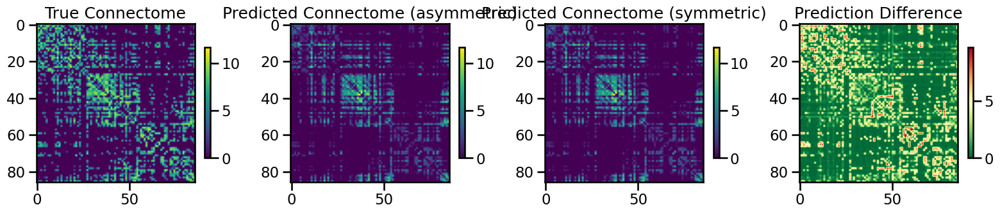

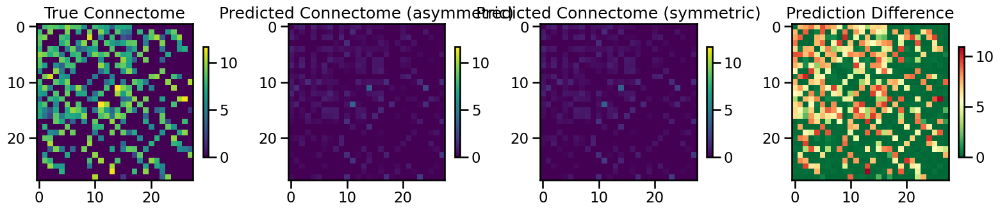

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 6.841582450444087, 'mae': 1.395285585426855, 'r2': 0.38687376652879846, 'pearson_corr': 0.7475406972890558, 'geodesic_distance': 15.513421298050575}
TEST METRICS: {'mse': 21.474189560015763, 'mae': 2.992472207549808, 'r2': -0.4661973630377343, 'pearson_corr': 0.5225218097670081, 'geodesic_distance': 14.079841453126614}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.15255719992087177, 'learning_rate': 7.24387528548711e-05, 'weight_decay': 0.0004464983296007462, 'batch_size': 337, 'epochs': 112, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▄▄▂█▄▃▄▃▃▂▃▄▃▃▂▂▃▁▃▂▂▃▂▂▂▂▃▂▂▂▂▂▃▂▂▁▃▂▄▂
test_pearson,▂▃▂▃▂▂▄▃▁▃▄▃▂▂▆▆▃▇▇█████▇███▇█▇▇████▇▇██
train_mse_loss,███▇▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▄▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▂▂▂▂▃▃▃▃▄▄▄▅▆▆▆▆▇▇▇▇▇█████████████████
best_val_loss,0
test_mse_loss,0.29078
test_pearson,0.53563
train_mse_loss,0.14212
train_pearson,0.72486


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 4.5%
Available RAM: 962.2G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 3 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 0nfn0act
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/0nfn0act


wandb: Agent Starting Run: vpdg0ngu with config:
wandb: 	batch_size: 337
wandb: 	dropout_rate: 0.2411141761255434
wandb: 	epochs: 145
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.857685757254786e-05
wandb: 	weight_decay: 0.0001129583696600986
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/145, Train Loss: 0.2049, Val Loss: 0.3615
Epoch 10/145, Train Loss: 0.2000, Val Loss: 0.3570
Epoch 15/145, Train Loss: 0.1978, Val Loss: 0.3630
Epoch 20/145, Train Loss: 0.1957, Val Loss: 0.3799
Epoch 25/145, Train Loss: 0.1942, Val Loss: 0.3779
Epoch 30/145, Train Loss: 0.1924, Val Loss: 0.3729
Epoch 35/145, Train Loss: 0.1907, Val Loss: 0.3545
Epoch 40/145, Train Loss: 0.1909, Val Loss: 0.3586
Epoch 45/145, Train Loss: 0.1898, Val Loss: 0.3887
Epoch 50/145, Train Loss: 0.1910, Val Loss: 0.3454
Epoch 55/145, Train Loss: 0.1908, Val Loss: 0.3738
Epoch 60/145, Train Loss: 0.1894, Val Loss: 0.3542
Epoch 65/145, Train Loss: 0.1890, Val Loss: 0.3495
Epoch 70/145, Train Loss: 0.1896, Val Loss: 0.3612
Epoch 75/145, Train Loss: 0.1888, Val Loss: 0.3462


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 80/145, Train Loss: 0.1896, Val Loss: 0.3607
Epoch 85/145, Train Loss: 0.1893, Val Loss: 0.3447
Epoch 90/145, Train Loss: 0.1894, Val Loss: 0.3707
Epoch 95/145, Train Loss: 0.1892, Val Loss: 0.3575
Epoch 100/145, Train Loss: 0.1891, Val Loss: 0.3485
Epoch 105/145, Train Loss: 0.1900, Val Loss: 0.3581
Epoch 110/145, Train Loss: 0.1890, Val Loss: 0.3718
Epoch 115/145, Train Loss: 0.1896, Val Loss: 0.3787
Epoch 120/145, Train Loss: 0.1894, Val Loss: 0.3448
Epoch 125/145, Train Loss: 0.1888, Val Loss: 0.3558
Epoch 130/145, Train Loss: 0.1890, Val Loss: 0.3641
Epoch 135/145, Train Loss: 0.1904, Val Loss: 0.3625
Epoch 140/145, Train Loss: 0.1893, Val Loss: 0.3468
Epoch 145/145, Train Loss: 0.1905, Val Loss: 0.3735
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/145, Train Loss: 0.2186, Val Loss: 0.3125
Epoch 10/145, Train Loss: 0.2148, Val Loss: 0.2927
Epoch 15/145, Train Loss: 0.2105, Val Loss: 0.3073
Epoch 20/145, Train Loss: 0.2085, Val Loss: 0.3309
E

fold0_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▆▅▆▄▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▂▂▁▁▁▁▂▂▁▁▁▁▁▂▁▁▁▂▁▂
fold0_train_pearson,▁▅▄▅▅▅▆▆▆▇▆▆▇▇▇▇▇▇█▇▇█▇▇█▇▇▇▇▇██▇███▇▇█▇
fold0_val_loss,▆▂▄▅▃▆▄▅▅▅▅▅▄▃█▄▅▂▃▃▃▇▄▄▆▄▃▃▂▃▃▁▄▄▃▄▄▂▄▆
fold0_val_pearson,▁▇▁▅▄▅▁▄▂▄▅▃▄██▆▄▂▇▅▆▅▆▇▅▆▅▃▃▄▂▆▃▅▇▅▅▅▆▆
fold1_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
fold1_train_loss,█▇▅▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▃▄▃▅▅▅▆▇▇▇▇▇█▇▇█████▇█▇████▇█▇████▇▇███
fold1_val_loss,▇▃▅█▄▃▃▆▁▄▅▅▆▃▄▆▅▃▄▂▅▃▃▁▄▆▄▃▃▅▆▅▅▄█▅▄▃▇▄
fold1_val_pearson,▁▃▄▄▆▄▃▇▇▄▆▆▇▇▇█▇▇▆█▆▆▇▇▇▇▇▆▇▇▇█▇███▇▇▇▇
fold2_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇████


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: maytcq51 with config:
wandb: 	batch_size: 381
wandb: 	dropout_rate: 0.2361316438770266
wandb: 	epochs: 121
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.0874640755135793e-05
wandb: 	weight_decay: 0.00021535998305130492
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/121, Train Loss: 0.1997, Val Loss: 0.3666
Epoch 10/121, Train Loss: 0.1960, Val Loss: 0.3682
Epoch 15/121, Train Loss: 0.1936, Val Loss: 0.3657
Epoch 20/121, Train Loss: 0.1915, Val Loss: 0.3623
Epoch 25/121, Train Loss: 0.1905, Val Loss: 0.3589
Epoch 30/121, Train Loss: 0.1892, Val Loss: 0.3582
Epoch 35/121, Train Loss: 0.1875, Val Loss: 0.3678
Epoch 40/121, Train Loss: 0.1873, Val Loss: 0.3516
Epoch 45/121, Train Loss: 0.1847, Val Loss: 0.3517
Epoch 50/121, Train Loss: 0.1847, Val Loss: 0.3560


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 55/121, Train Loss: 0.1840, Val Loss: 0.3501
Epoch 60/121, Train Loss: 0.1836, Val Loss: 0.3576
Epoch 65/121, Train Loss: 0.1820, Val Loss: 0.3485
Epoch 70/121, Train Loss: 0.1824, Val Loss: 0.3540
Epoch 75/121, Train Loss: 0.1806, Val Loss: 0.3477
Epoch 80/121, Train Loss: 0.1784, Val Loss: 0.3487
Epoch 85/121, Train Loss: 0.1790, Val Loss: 0.3499
Epoch 90/121, Train Loss: 0.1786, Val Loss: 0.3507
Epoch 95/121, Train Loss: 0.1784, Val Loss: 0.3516
Epoch 100/121, Train Loss: 0.1772, Val Loss: 0.3484
Epoch 105/121, Train Loss: 0.1781, Val Loss: 0.3505
Epoch 110/121, Train Loss: 0.1752, Val Loss: 0.3510
Epoch 115/121, Train Loss: 0.1768, Val Loss: 0.3509
Epoch 120/121, Train Loss: 0.1764, Val Loss: 0.3503
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/121, Train Loss: 0.2174, Val Loss: 0.3062
Epoch 10/121, Train Loss: 0.2145, Val Loss: 0.3113
Epoch 15/121, Train Loss: 0.2135, Val Loss: 0.3164
Epoch 20/121, Train Loss: 0.2108, Val Loss: 0.3054
Epoch 2

fold0_epoch,▁▁▁▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇██
fold0_train_loss,██▇▆▆▅▅▅▅▅▅▄▄▄▄▄▃▄▄▃▃▃▃▃▂▂▂▂▁▂▂▂▂▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▃▄▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇███▇▇██████████
fold0_val_loss,▅▄▄▃█▄▄▃▄▄▂▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▃▂▂▂▁▁▂▁▁▂▂▁▁
fold0_val_pearson,▁▆▅▅▇▆▇▆▇▇██▇▇▇▆▆▆▇▇▆▆▆▇▆▆▆▆▆▆▆▆▆▆▅▆▆▆▆▆
fold1_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇████
fold1_train_loss,██▆▆▆▅▅▅▅▄▃▃▃▃▂▃▃▂▃▂▂▂▂▂▁▃▃▂▃▃▃▃▂▃▂▂▂▂▂▂
fold1_train_pearson,▁▁▂▃▄▆▅▇▆▇▇▇▇▇▆▇▇▇▇▇▇▇▇███▇▇▇▇▇▇▇▇█▇▇███
fold1_val_loss,▇▄█▆▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▄▃▁▁▄▇▇▅▆█████▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇▇
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇███


wandb: Agent Starting Run: 4uiehz2w with config:
wandb: 	batch_size: 489
wandb: 	dropout_rate: 0.2577996167074825
wandb: 	epochs: 163
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 8.638782694994045e-05
wandb: 	weight_decay: 0.00015032304862354923
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/163, Train Loss: 0.2001, Val Loss: 0.3626
Epoch 10/163, Train Loss: 0.1967, Val Loss: 0.3572
Epoch 15/163, Train Loss: 0.1950, Val Loss: 0.3631
Epoch 20/163, Train Loss: 0.1920, Val Loss: 0.3571
Epoch 25/163, Train Loss: 0.1912, Val Loss: 0.3599
Epoch 30/163, Train Loss: 0.1886, Val Loss: 0.3665
Epoch 35/163, Train Loss: 0.1865, Val Loss: 0.3574
Epoch 40/163, Train Loss: 0.1858, Val Loss: 0.3632
Epoch 45/163, Train Loss: 0.1845, Val Loss: 0.3580
Epoch 50/163, Train Loss: 0.1842, Val Loss: 0.3528
Epoch 55/163, Train Loss: 0.1824, Val Loss: 0.3533
Epoch 60/163, Train Loss: 0.1817, Val Loss: 0.3600
Epoch 65/163, Train Loss: 0.1812, Val Loss: 0.3598
Epoch 70/163, Train Loss: 0.1805, Val Loss: 0.3570
Epoch 75/163, Train Loss: 0.1807, Val Loss: 0.3572
Epoch 80/163, Train Loss: 0.1799, Val Loss: 0.3613
Epoch 85/163, Train Loss: 0.1802, Val Loss: 0.3509
Epoch 90/163, Train Loss: 0.1811, Val Loss: 0.3564
Epoch 95/163

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 150/163, Train Loss: 0.1808, Val Loss: 0.3509
Epoch 155/163, Train Loss: 0.1801, Val Loss: 0.3548
Epoch 160/163, Train Loss: 0.1812, Val Loss: 0.3571
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/163, Train Loss: 0.2113, Val Loss: 0.3367
Epoch 10/163, Train Loss: 0.2083, Val Loss: 0.3123
Epoch 15/163, Train Loss: 0.2072, Val Loss: 0.3016
Epoch 20/163, Train Loss: 0.2053, Val Loss: 0.3029
Epoch 25/163, Train Loss: 0.2032, Val Loss: 0.3003
Epoch 30/163, Train Loss: 0.2018, Val Loss: 0.3061
Epoch 35/163, Train Loss: 0.2016, Val Loss: 0.3014
Epoch 40/163, Train Loss: 0.2002, Val Loss: 0.2999
Epoch 45/163, Train Loss: 0.1994, Val Loss: 0.3000
Epoch 50/163, Train Loss: 0.1984, Val Loss: 0.3028
Epoch 55/163, Train Loss: 0.2005, Val Loss: 0.3022
Epoch 60/163, Train Loss: 0.1988, Val Loss: 0.3020
Epoch 65/163, Train Loss: 0.1995, Val Loss: 0.3023
Epoch 70/163, Train Loss: 0.1990, Val Loss: 0.2976
Epoch 75/163, Train Loss: 0.1994, Val Loss: 0.3072
Epoch 80/

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇██
fold0_train_loss,█▇▇▇▇▅▅▄▄▄▄▃▃▃▃▂▃▂▂▂▂▂▁▂▁▂▁▁▁▁▂▂▂▁▂▂▁▂▂▁
fold0_train_pearson,▁▁▂▃▄▅▆▆▆▆▇▇█▇██▇██▇██████████████▇█████
fold0_val_loss,▅█▅▅▄▆▅▅▃▁▅▄▂▅▄▄▁▄▃▃▅▅▁▂▃▃▄▅▃▃▂▄▂▄▃▄▂▂▆▂
fold0_val_pearson,▁▇▇▇▇▇█▇▇▇▇▇▇███████████▇████▇▇█▇██▇██▇▇
fold1_epoch,▁▁▁▁▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇███
fold1_train_loss,█▇▆▆▆▅▄▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▂▂▁▂▁▁▂▂▁▂▁▂▂▂▂▁
fold1_train_pearson,▃▂▁▂▃▅▅▄▅▆▅▅▇▅▇▇▆█▇▇▇▇▆▇▇▆█▇▆▆▇▇▆▇▅▆▆▇▆▇
fold1_val_loss,▆█▅▃▃▁▁▁▁▁▂▁▁▂▁▁▁▁▂▁▁▂▁▂▁▁▁▁▂▁▂▂▁▂▂▁▁▁▁▁
fold1_val_pearson,▁▁▆▆▇▆▆▇▇▇▇▇█▇▇█▇▇██▇▇▇██▇▇▇██▇▇▇▇▇▇█▇▇▇
fold2_epoch,▁▁▁▁▂▂▂▂▂▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 163, 'input_dim': 21526, 'batch_size': 489, 'hidden_dims': [256, 128], 'dropout_rate': 0.2577996167074825, 'weight_decay': 0.00015032304862354923, 'learning_rate': 8.638782694994045e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/163, Train Loss: 0.1897, Val Loss: 0.4184
Epoch 10/163, Train Loss: 0.1856, Val Loss: 0.4104
Epoch 15/163, Train Loss: 0.1825, Val Loss: 0.4071
Epoch 20/163, Train Loss: 0.1799, Val Loss: 0.4044
Epoch 25/163, Train Loss: 0.1780, Val Loss: 0.4075
Epoch 30/163, Train Loss: 0.1770, Val Loss: 0.4042
Epoch 35/163, Train Loss: 0.1753, Val Loss: 0.4066
Epoch 40/163, Train Loss: 0.1739, Val Loss: 0.4036
Epoch 45/163, Train Loss: 0.1741, Val Loss: 0.4087
Epoch 50/163, Train Loss: 0.1724, Val Loss: 0.4007
Epoch 55/163, Train Loss: 0.1719, Val Loss: 0.4077
Epoch 60/163, Train Loss: 0.1719, Val Loss: 0.4042
Epoch 65/163, Train Loss: 0.1716, Val Loss: 0.4113
Epoch 70/163, Train Loss: 0.1722, Val Loss: 0.4100
Epoch 75/163, Train Loss: 0.17

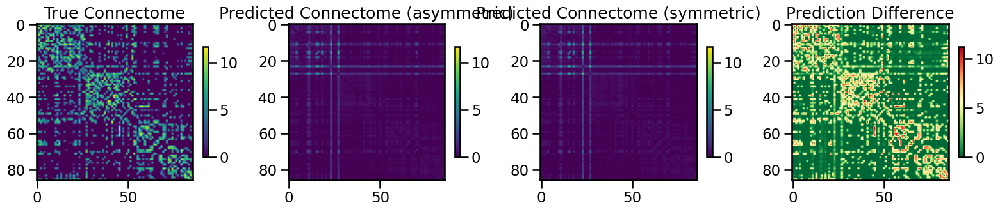

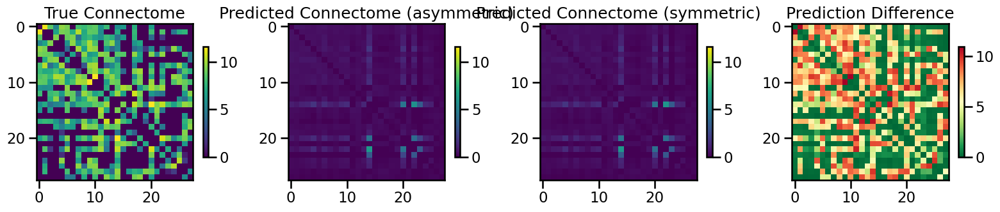

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 11.18560833374831, 'mae': 1.7110962287262739, 'r2': -0.0860306581648751, 'pearson_corr': 0.4063963257002921, 'geodesic_distance': 31.619997574431178}
TEST METRICS: {'mse': 30.166337997862158, 'mae': 4.123454899420943, 'r2': -0.8893054693067899, 'pearson_corr': 0.33510845238127807, 'geodesic_distance': 16.40696718168996}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.2577996167074825, 'learning_rate': 8.638782694994045e-05, 'weight_decay': 0.00015032304862354923, 'batch_size': 489, 'epochs': 163, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▄▃▃▁▄▂▃▅▂▃▄▂▂▃▃▃▃▄▃▂▃▂▂▂▃▃▃▃▂▄▃▃▃▃▃▂▃▃
test_pearson,▁▅▄▅█▆▅▅▅▄▅▆▆▇▇▇▇▇▇▇▇██▇▇█▇▇▇▇▇██▇▇█▇▇▇▇
train_mse_loss,█▇▆▅▄▄▄▃▃▃▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▃▅▄▅▆▆▆▆▇▇▇█▇▇▇████▇██▇▇██▇███▇▇███▇███
best_val_loss,0
test_mse_loss,0.40449
test_pearson,0.339
train_mse_loss,0.17113
train_pearson,0.36884


Final evaluation metrics logged successfully.
CPU Usage: 1.0%
RAM Usage: 4.5%
Available RAM: 962.1G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 4 X_train shape: (6972, 21526) Y_train shape: (6972,) X_test shape: (870, 21526) Y_test shape: (870,)
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: c6mdpmbq
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/c6mdpmbq


wandb: Agent Starting Run: kd5danit with config:
wandb: 	batch_size: 333
wandb: 	dropout_rate: 0.24461508210296457
wandb: 	epochs: 146
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.672488166806899e-05
wandb: 	weight_decay: 0.0002772103637810285
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/146, Train Loss: 0.2611, Val Loss: 0.3763
Epoch 10/146, Train Loss: 0.2630, Val Loss: 0.4231
Epoch 15/146, Train Loss: 0.2609, Val Loss: 0.4132
Epoch 20/146, Train Loss: 0.2571, Val Loss: 0.3973
Epoch 25/146, Train Loss: 0.2571, Val Loss: 0.3914


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 30/146, Train Loss: 0.2542, Val Loss: 0.3739
Epoch 35/146, Train Loss: 0.2542, Val Loss: 0.3662
Epoch 40/146, Train Loss: 0.2514, Val Loss: 0.3799
Epoch 45/146, Train Loss: 0.2492, Val Loss: 0.3778
Epoch 50/146, Train Loss: 0.2524, Val Loss: 0.3853
Epoch 55/146, Train Loss: 0.2472, Val Loss: 0.3868
Epoch 60/146, Train Loss: 0.2410, Val Loss: 0.3789
Epoch 65/146, Train Loss: 0.2417, Val Loss: 0.3871
Epoch 70/146, Train Loss: 0.2419, Val Loss: 0.3727
Epoch 75/146, Train Loss: 0.2440, Val Loss: 0.3657
Epoch 80/146, Train Loss: 0.2435, Val Loss: 0.3836
Epoch 85/146, Train Loss: 0.2376, Val Loss: 0.3760
Epoch 90/146, Train Loss: 0.2360, Val Loss: 0.3794
Epoch 95/146, Train Loss: 0.2374, Val Loss: 0.3792
Epoch 100/146, Train Loss: 0.2391, Val Loss: 0.4072
Epoch 105/146, Train Loss: 0.2440, Val Loss: 0.3860
Epoch 110/146, Train Loss: 0.2432, Val Loss: 0.3969
Epoch 115/146, Train Loss: 0.2427, Val Loss: 0.3846
Epoch 120/146, Train Loss: 0.2384, Val Loss: 0.3745
Epoch 125/146, Train Loss:

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇██
fold0_train_loss,▇██▇▇▆▆▆▆▆▄▄▅▅▃▅▂▃▂▂▃▃▃▃▁▁▂▃▃▃▂▃▃▂▂▄▂▂▂▄
fold0_train_pearson,▁▃▃▃▅▆▆▇▆▆▆▆▇▇▇▇▇█▇▇▇▇▇█▇▇▇▇▇▇▇▇█▇▇▇▇█▇█
fold0_val_loss,▅▃▇█▇▁▅▆▅▇▄▄▄▄▄▆▅▅▄▄▅▅▄▄▄▅▄▄▃▅▃▅▄▄▄▅▅▅▅▄
fold0_val_pearson,▂▄▆▁█▄▄▆▆▇▇█▄▇▅▆▇▆▇▆▆▇▅▇▇▇▇▇▆▅▇▆▅▅▆▆▄█▇▆
fold1_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇████
fold1_train_loss,▇█▆▆▅▆▄▃▄▅▂▄▂▃▃▃▂▃▂▃▂▃▄▂▃▄▁▁▃▁▁▂▂▁▂▁▁▂▃▃
fold1_train_pearson,▁▁▃▄▅▄▅▆▆▆▆▇▆▆▇▇▇▇█▇▇▇█▇▆▇▆▆▇▆▇█▇█▆▆█▇▇▆
fold1_val_loss,▃▆▅▇▄▄▄▅▄▅▃▄▃▅▆▅▆▃▄▅▃▄▄▆▅▆▄▅▃▄▆▃▁█▅▄▆▅▄▆
fold1_val_pearson,▅▇▆▇█▅▆▁▃▄▄▄▃▄▄▃▄▂▅▅▅▃▄▅▅▄▄▄▅▃▄▄▄▅▅▃▅▄▄▃
fold2_epoch,▁▁▁▁▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇████


wandb: Agent Starting Run: 1vvh7t8g with config:
wandb: 	batch_size: 421
wandb: 	dropout_rate: 0.21617719412065128
wandb: 	epochs: 166
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.650947070371506e-05
wandb: 	weight_decay: 0.00027649460837955036
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/166, Train Loss: 0.2632, Val Loss: 0.3929
Epoch 10/166, Train Loss: 0.2625, Val Loss: 0.3942
Epoch 15/166, Train Loss: 0.2601, Val Loss: 0.3954
Epoch 20/166, Train Loss: 0.2603, Val Loss: 0.3803
Epoch 25/166, Train Loss: 0.2532, Val Loss: 0.3892
Epoch 30/166, Train Loss: 0.2557, Val Loss: 0.3824
Epoch 35/166, Train Loss: 0.2508, Val Loss: 0.3818


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 40/166, Train Loss: 0.2529, Val Loss: 0.3788
Epoch 45/166, Train Loss: 0.2542, Val Loss: 0.3836
Epoch 50/166, Train Loss: 0.2511, Val Loss: 0.3757
Epoch 55/166, Train Loss: 0.2496, Val Loss: 0.3713
Epoch 60/166, Train Loss: 0.2467, Val Loss: 0.3807
Epoch 65/166, Train Loss: 0.2461, Val Loss: 0.3630
Epoch 70/166, Train Loss: 0.2462, Val Loss: 0.3669
Epoch 75/166, Train Loss: 0.2438, Val Loss: 0.3582
Epoch 80/166, Train Loss: 0.2418, Val Loss: 0.3524
Epoch 85/166, Train Loss: 0.2372, Val Loss: 0.3614
Epoch 90/166, Train Loss: 0.2370, Val Loss: 0.3526
Epoch 95/166, Train Loss: 0.2405, Val Loss: 0.3502
Epoch 100/166, Train Loss: 0.2424, Val Loss: 0.3337
Epoch 105/166, Train Loss: 0.2379, Val Loss: 0.3316
Epoch 110/166, Train Loss: 0.2332, Val Loss: 0.3497
Epoch 115/166, Train Loss: 0.2318, Val Loss: 0.3462
Epoch 120/166, Train Loss: 0.2263, Val Loss: 0.3381
Epoch 125/166, Train Loss: 0.2277, Val Loss: 0.3489
Epoch 130/166, Train Loss: 0.2264, Val Loss: 0.3300
Epoch 135/166, Train Los

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇█
fold0_train_loss,█▇██▇▇▇▇▇▆▇▆▆▆▆▅▆▅▆▅▅▅▅▅▄▄▄▅▃▃▄▃▂▃▃▂▂▂▁▁
fold0_train_pearson,▁▃▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇███████
fold0_val_loss,█▇█▇██▇█▇▇▇▆▇▆▆▆▆▅▅▄▄▄▄▂▅▄▃▃▄▄▄▂▁▂▄▃▄▂▁▁
fold0_val_pearson,▂▂▃▄▄▅▅▅▄▅▅▆▅▅▅▆▄▅▄▅▄▄▄▄▄▅▅▁▅▄▅▅▆▇▆▅▅▇█▇
fold1_epoch,▁▁▁▂▂▂▂▂▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██
fold1_train_loss,█▆▄▄▄▃▅▂▃▂▂▂▃▂▃▂▃▁▂▂▂▃▂▂▂▁▂▂▃▃▃▃▂▁▂▃▂▂▂▂
fold1_train_pearson,▃▁▁▂▅▅▅▆▇▅▇▇▅▇▆▆▅▅▆█▇▇▅█▆▆▇▆▄▆▅▆▆▅▆▆▇▇▇▆
fold1_val_loss,█▁▂▁▂▃▃▂▃▃▂▂▂▁▂▁▂▁▂▁▃▂▄▄▃▂▂▃▁▁▁▂▂▂▃▁▂▂▂▂
fold1_val_pearson,▁▇▇▅▇▇▆▆▆▇▆█▆▇▆▆▆▇▇▆▇▆▇▆▇▆▇▇▆▆▇▆▇▇▆▇▆▆▇▆
fold2_epoch,▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▇▇▇████


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: jeq8kyzv with config:
wandb: 	batch_size: 464
wandb: 	dropout_rate: 0.2534394247453274
wandb: 	epochs: 173
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.4930428273987106e-05
wandb: 	weight_decay: 8.403052752255971e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/173, Train Loss: 0.2638, Val Loss: 0.4035
Epoch 10/173, Train Loss: 0.2601, Val Loss: 0.3859
Epoch 15/173, Train Loss: 0.2564, Val Loss: 0.3806
Epoch 20/173, Train Loss: 0.2538, Val Loss: 0.3668
Epoch 25/173, Train Loss: 0.2518, Val Loss: 0.3853
Epoch 30/173, Train Loss: 0.2526, Val Loss: 0.3748
Epoch 35/173, Train Loss: 0.2482, Val Loss: 0.3730
Epoch 40/173, Train Loss: 0.2495, Val Loss: 0.3784
Epoch 45/173, Train Loss: 0.2458, Val Loss: 0.3702
Epoch 50/173, Train Loss: 0.2445, Val Loss: 0.3796
Epoch 55/173, Train Loss: 0.2452, Val Loss: 0.3772
Epoch 60/173, Train Loss: 0.2433, Val Loss: 0.3813
Epoch 65/173, Train Loss: 0.2439, Val Loss: 0.3768
Epoch 70/173, Train Loss: 0.2435, Val Loss: 0.3762


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 75/173, Train Loss: 0.2424, Val Loss: 0.3836
Epoch 80/173, Train Loss: 0.2435, Val Loss: 0.3818
Epoch 85/173, Train Loss: 0.2412, Val Loss: 0.3816
Epoch 90/173, Train Loss: 0.2431, Val Loss: 0.3801
Epoch 95/173, Train Loss: 0.2449, Val Loss: 0.3781
Epoch 100/173, Train Loss: 0.2445, Val Loss: 0.3832
Epoch 105/173, Train Loss: 0.2420, Val Loss: 0.3841
Epoch 110/173, Train Loss: 0.2449, Val Loss: 0.3866
Epoch 115/173, Train Loss: 0.2416, Val Loss: 0.3835
Epoch 120/173, Train Loss: 0.2423, Val Loss: 0.3851
Epoch 125/173, Train Loss: 0.2430, Val Loss: 0.3775
Epoch 130/173, Train Loss: 0.2435, Val Loss: 0.3787
Epoch 135/173, Train Loss: 0.2417, Val Loss: 0.3849
Epoch 140/173, Train Loss: 0.2468, Val Loss: 0.3787
Epoch 145/173, Train Loss: 0.2439, Val Loss: 0.3802
Epoch 150/173, Train Loss: 0.2416, Val Loss: 0.3839
Epoch 155/173, Train Loss: 0.2442, Val Loss: 0.3837
Epoch 160/173, Train Loss: 0.2438, Val Loss: 0.3860
Epoch 165/173, Train Loss: 0.2419, Val Loss: 0.3809
Epoch 170/173, Tr

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇██
fold0_train_loss,█▇▆▄▄▄▃▃▄▃▂▃▂▂▂▂▂▁▁▂▁▂▂▂▁▁▁▂▁▂▁▂▁▂▂▁▂▂▂▂
fold0_train_pearson,▁▄▅▅▅▇▇▇▇▇▇██▇████████▇████████████████▇
fold0_val_loss,▂▅▆█▂▃▃▂▂▁▃▃▃▃▄▃▃▃▄▄▃▃▃▃▃▄▃▃▄▃▃▃▃▃▃▄▃▃▃▃
fold0_val_pearson,▁▅▅██████▇▇▇▇█▇█▇███▇▇███▇▇█▇█▇█▇██▇▇███
fold1_epoch,▁▁▁▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇████
fold1_train_loss,█▇▅▄▃▂▃▃▂▃▂▃▃▂▂▂▁▂▂▁▂▂▁▁▂▂▁▂▁▂▂▂▁▂▁▁▂▂▂▁
fold1_train_pearson,▁▃▃▃▄▅▆▆▇▆▆█▆▅▅▇▆▆▇▇█▅▆█▇▇█▆▆▆▇▆▇▇▅▅▇▆▇▇
fold1_val_loss,▃▄▄▅▃▃▄▅▃▃▆▄▅▄▇▇▅▂▄▁▄▃▅▄█▆▅▅▃▃▄▅▅▁▅▅▁▅▄▂
fold1_val_pearson,█▄▄▂▁▁▁▁▁▂▂▃▃▂▂▃▃▃▃▃▃▃▃▂▃▃▃▃▄▃▃▃▃▃▃▃▃▃▃▄
fold2_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 166, 'input_dim': 21526, 'batch_size': 421, 'hidden_dims': [256, 128], 'dropout_rate': 0.21617719412065128, 'weight_decay': 0.00027649460837955036, 'learning_rate': 6.650947070371506e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/166, Train Loss: 0.2307, Val Loss: 0.2548
Epoch 10/166, Train Loss: 0.2261, Val Loss: 0.2361
Epoch 15/166, Train Loss: 0.2225, Val Loss: 0.2746
Epoch 20/166, Train Loss: 0.2203, Val Loss: 0.2283
Epoch 25/166, Train Loss: 0.2189, Val Loss: 0.2415
Epoch 30/166, Train Loss: 0.2167, Val Loss: 0.2217
Epoch 35/166, Train Loss: 0.2149, Val Loss: 0.2428
Epoch 40/166, Train Loss: 0.2143, Val Loss: 0.2442
Epoch 45/166, Train Loss: 0.2147, Val Loss: 0.2549
Epoch 50/166, Train Loss: 0.2134, Val Loss: 0.3039
Epoch 55/166, Train Loss: 0.2134, Val Loss: 0.2525
Epoch 60/166, Train Loss: 0.2136, Val Loss: 0.2694
Epoch 65/166, Train Loss: 0.2135, Val Loss: 0.2229
Epoch 70/166, Train Loss: 0.2119, Val Loss: 0.2512
Epoch 75/166, Train Loss: 0.2

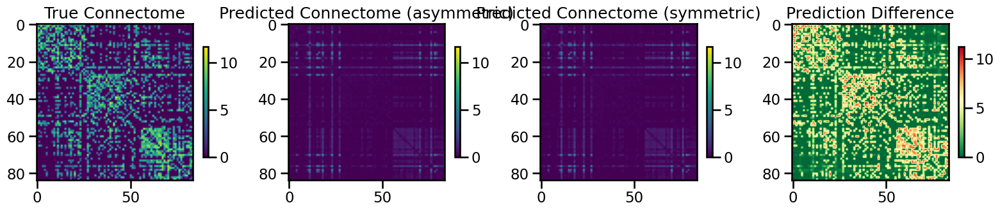

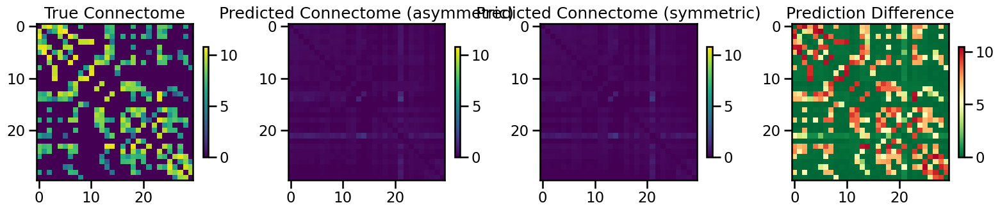

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 14.319208248227577, 'mae': 2.119490308453536, 'r2': -0.21372217753487455, 'pearson_corr': 0.4163928204723529, 'geodesic_distance': 33.77485678088931}
TEST METRICS: {'mse': 19.710043718947436, 'mae': 2.633760293673678, 'r2': -0.38408680503153825, 'pearson_corr': 0.37161961222137035, 'geodesic_distance': 19.425376924522492}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.21617719412065128, 'learning_rate': 6.650947070371506e-05, 'weight_decay': 0.00027649460837955036, 'batch_size': 421, 'epochs': 166, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▂▃▃▇▇▆▅▂▄▄▂▃█▄▆▇▃▃▆▁▅▃▄█▃▅▅▆▆▆▅▅▄▇▆▅▆▄▅
test_pearson,█▆▅▅▃▁▄▃▅▅▄▄▅▁▄▅▃▇▅▃▄▃▄▅▄▄▄▃▄▅▇▆▄▃▇▂▂▇▅▃
train_mse_loss,█▆▆▅▄▄▄▂▃▂▂▁▂▁▂▂▂▁▂▂▂▂▂▂▂▂▂▂▁▁▂▂▂▁▂▂▂▂▁▁
train_pearson,▁▃▄▂▃▄▄▆▇▇▇▇▇▇▇█▇▇▇▇▇▇█▇▇▆▇██▇▇▆▇▇▇▇█▇▇▇
best_val_loss,0
test_mse_loss,0.25312
test_pearson,0.40132
train_mse_loss,0.21351
train_pearson,0.38269


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 4.5%
Available RAM: 962.1G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |


  gc.collect()



Running simulation with: dynamic_mlp, spatial, S400, FC, seed=1
Number of components for 95% variance PCA: 105
X shape: (214, 7380)
X_pca shape: (214, 105)
Y_sc shape: (214, 214)
Y_sc_spectralL shape: (214, 222)
Y_sc_spectralA shape: (214, 223)
Y_fc shape: (214, 214)
Coordinates shape: (214, 3)
Y shape (214, 214)
Network coverage: 100.0% of regions
Network sizes: [53, 53, 53, 55]
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (214, 7383)

 Test fold num: 1 X_train shape: (25760, 14766) Y_train shape: (25760,) X_test shape: (2756, 14766) Y_test shape: (2756,)
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: nxo6bl7d
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/nxo6bl7d


wandb: Agent Starting Run: 86qcxj7d with config:
wandb: 	batch_size: 473
wandb: 	dropout_rate: 0.13710006612409684
wandb: 	epochs: 175
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.848089269641373e-05
wandb: 	weight_decay: 9.01707274877328e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/175, Train Loss: 0.0196, Val Loss: 0.0180
Epoch 10/175, Train Loss: 0.0169, Val Loss: 0.0169
Epoch 15/175, Train Loss: 0.0155, Val Loss: 0.0166
Epoch 20/175, Train Loss: 0.0142, Val Loss: 0.0158
Epoch 25/175, Train Loss: 0.0129, Val Loss: 0.0147
Epoch 30/175, Train Loss: 0.0118, Val Loss: 0.0154
Epoch 35/175, Train Loss: 0.0107, Val Loss: 0.0146
Epoch 40/175, Train Loss: 0.0096, Val Loss: 0.0137


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 45/175, Train Loss: 0.0089, Val Loss: 0.0147
Epoch 50/175, Train Loss: 0.0078, Val Loss: 0.0143
Epoch 55/175, Train Loss: 0.0072, Val Loss: 0.0139
Epoch 60/175, Train Loss: 0.0065, Val Loss: 0.0140
Epoch 65/175, Train Loss: 0.0058, Val Loss: 0.0140
Epoch 70/175, Train Loss: 0.0054, Val Loss: 0.0136
Epoch 75/175, Train Loss: 0.0049, Val Loss: 0.0139
Epoch 80/175, Train Loss: 0.0045, Val Loss: 0.0146
Epoch 85/175, Train Loss: 0.0040, Val Loss: 0.0130
Epoch 90/175, Train Loss: 0.0038, Val Loss: 0.0131
Epoch 95/175, Train Loss: 0.0035, Val Loss: 0.0131
Epoch 100/175, Train Loss: 0.0031, Val Loss: 0.0129
Epoch 105/175, Train Loss: 0.0030, Val Loss: 0.0131
Epoch 110/175, Train Loss: 0.0030, Val Loss: 0.0130
Epoch 115/175, Train Loss: 0.0030, Val Loss: 0.0130
Epoch 120/175, Train Loss: 0.0030, Val Loss: 0.0130
Epoch 125/175, Train Loss: 0.0030, Val Loss: 0.0131
Epoch 130/175, Train Loss: 0.0030, Val Loss: 0.0131
Epoch 135/175, Train Loss: 0.0030, Val Loss: 0.0131
Epoch 140/175, Train Lo

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▇▇▇████
fold0_train_loss,█▇▅▅▅▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▂▂▂▃▃▃▃▅▅▅▆▆▆▇▇▇▇█████████████████████
fold0_val_loss,█▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▃▃▂▂▂▁▁▅▃▅▆▆▆▆▇▇▇███▇███████████████████
fold1_epoch,▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇█████
fold1_train_loss,█▇▆▆▅▄▄▄▄▃▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▅▆▆▆▇▇▇██████████████████████████████
fold1_val_loss,█▁▄▆▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▃█▇▇▂▆▅▅▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▇▆▆▆▆▆▆
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: vok2oxlr with config:
wandb: 	batch_size: 310
wandb: 	dropout_rate: 0.14338746989986395
wandb: 	epochs: 152
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.273392510510484e-05
wandb: 	weight_decay: 0.00028564509814421596
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/152, Train Loss: 0.0192, Val Loss: 0.0179
Epoch 10/152, Train Loss: 0.0159, Val Loss: 0.0153
Epoch 15/152, Train Loss: 0.0143, Val Loss: 0.0149
Epoch 20/152, Train Loss: 0.0123, Val Loss: 0.0153
Epoch 25/152, Train Loss: 0.0106, Val Loss: 0.0136
Epoch 30/152, Train Loss: 0.0091, Val Loss: 0.0135


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 35/152, Train Loss: 0.0078, Val Loss: 0.0145
Epoch 40/152, Train Loss: 0.0066, Val Loss: 0.0138
Epoch 45/152, Train Loss: 0.0060, Val Loss: 0.0146
Epoch 50/152, Train Loss: 0.0051, Val Loss: 0.0149
Epoch 55/152, Train Loss: 0.0045, Val Loss: 0.0152
Epoch 60/152, Train Loss: 0.0040, Val Loss: 0.0135
Epoch 65/152, Train Loss: 0.0037, Val Loss: 0.0136
Epoch 70/152, Train Loss: 0.0031, Val Loss: 0.0136
Epoch 75/152, Train Loss: 0.0028, Val Loss: 0.0140
Epoch 80/152, Train Loss: 0.0027, Val Loss: 0.0139
Epoch 85/152, Train Loss: 0.0027, Val Loss: 0.0139
Epoch 90/152, Train Loss: 0.0027, Val Loss: 0.0135
Epoch 95/152, Train Loss: 0.0026, Val Loss: 0.0140
Epoch 100/152, Train Loss: 0.0025, Val Loss: 0.0139
Epoch 105/152, Train Loss: 0.0026, Val Loss: 0.0139
Epoch 110/152, Train Loss: 0.0025, Val Loss: 0.0138
Epoch 115/152, Train Loss: 0.0026, Val Loss: 0.0139
Epoch 120/152, Train Loss: 0.0026, Val Loss: 0.0140
Epoch 125/152, Train Loss: 0.0025, Val Loss: 0.0136
Epoch 130/152, Train Loss

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇██
fold0_train_loss,█▅▅▅▄▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▃▄▅▆▆▆▆▇▇▇▇▇▇████████████████████████
fold0_val_loss,█▅▃▃▃▂▂▂▂▃▁▂▂▂▂▂▂▂▁▂▃▁▃▂▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂
fold0_val_pearson,▁▁▃▃▃▃▄▄▅▃▆▅▆▆█▇▅▇▆▄▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇██
fold1_train_loss,█▇▄▄▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▃▃▄▄▅▅▅▆▆▇▇██████████████████████████
fold1_val_loss,▁▃██▅▆▇█▃▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄▄
fold1_val_pearson,▂▁▆▆██▇▅▆▄▃▃▆▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇█


wandb: Agent Starting Run: tlhuz5tl with config:
wandb: 	batch_size: 410
wandb: 	dropout_rate: 0.20124289400771064
wandb: 	epochs: 157
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.17827654570086e-05
wandb: 	weight_decay: 8.288764226367571e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/157, Train Loss: 0.0223, Val Loss: 0.0165
Epoch 10/157, Train Loss: 0.0191, Val Loss: 0.0157


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 15/157, Train Loss: 0.0176, Val Loss: 0.0158
Epoch 20/157, Train Loss: 0.0159, Val Loss: 0.0157
Epoch 25/157, Train Loss: 0.0142, Val Loss: 0.0150
Epoch 30/157, Train Loss: 0.0130, Val Loss: 0.0146
Epoch 35/157, Train Loss: 0.0118, Val Loss: 0.0143
Epoch 40/157, Train Loss: 0.0107, Val Loss: 0.0136
Epoch 45/157, Train Loss: 0.0098, Val Loss: 0.0136
Epoch 50/157, Train Loss: 0.0087, Val Loss: 0.0140
Epoch 55/157, Train Loss: 0.0078, Val Loss: 0.0132
Epoch 60/157, Train Loss: 0.0069, Val Loss: 0.0139
Epoch 65/157, Train Loss: 0.0063, Val Loss: 0.0140
Epoch 70/157, Train Loss: 0.0058, Val Loss: 0.0133
Epoch 75/157, Train Loss: 0.0052, Val Loss: 0.0132
Epoch 80/157, Train Loss: 0.0048, Val Loss: 0.0129
Epoch 85/157, Train Loss: 0.0044, Val Loss: 0.0128
Epoch 90/157, Train Loss: 0.0041, Val Loss: 0.0132
Epoch 95/157, Train Loss: 0.0039, Val Loss: 0.0127
Epoch 100/157, Train Loss: 0.0035, Val Loss: 0.0127
Epoch 105/157, Train Loss: 0.0033, Val Loss: 0.0137
Epoch 110/157, Train Loss: 0.

fold0_epoch,▁▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇█
fold0_train_loss,█▇▆▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▂▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇███████████████
fold0_val_loss,█▄▆▅▅▅▅▅▄▄▃▃▂▃▂▂▂▂▃▂▂▂▁▂▂▁▃▂▃▃▂▂▃▂▃▃▂▃▂▂
fold0_val_pearson,▃▁▂▁▂▂▁▁▂▃▃▄▅▆▆▆▇▇▇▆▇▇█▇▇▇▇███▇█████████
fold1_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▇▇▇▇▇▇▇▇█████
fold1_train_loss,██▆▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▂▃▄▄▄▄▆▆▆▆▆▆▇▇▇▇▇▇████████████████████
fold1_val_loss,▃█▆▇▅▅▅▃▄▃▁▃▃▃▁▁▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▃▆▇▆▆▆▇▅▆▇█▇▇▇▇▇██████████▇█▇▇▇▇▇▇▇█▇▇▇
fold2_epoch,▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 175, 'input_dim': 14766, 'batch_size': 473, 'hidden_dims': [256, 128], 'dropout_rate': 0.13710006612409684, 'weight_decay': 9.01707274877328e-05, 'learning_rate': 5.848089269641373e-05}
Number of learnable parameters in MLP: 3814145
Epoch 5/175, Train Loss: 0.0169, Val Loss: 0.0125
Epoch 10/175, Train Loss: 0.0137, Val Loss: 0.0122
Epoch 15/175, Train Loss: 0.0110, Val Loss: 0.0102
Epoch 20/175, Train Loss: 0.0090, Val Loss: 0.0103
Epoch 25/175, Train Loss: 0.0073, Val Loss: 0.0131
Epoch 30/175, Train Loss: 0.0060, Val Loss: 0.0118
Epoch 35/175, Train Loss: 0.0049, Val Loss: 0.0119
Epoch 40/175, Train Loss: 0.0043, Val Loss: 0.0119
Epoch 45/175, Train Loss: 0.0041, Val Loss: 0.0117
Epoch 50/175, Train Loss: 0.0039, Val Loss: 0.0117
Epoch 55/175, Train Loss: 0.0039, Val Loss: 0.0116
Epoch 60/175, Train Loss: 0.0037, Val Loss: 0.0114
Epoch 65/175, Train Loss: 0.0038, Val Loss: 0.0114
Epoch 70/175, Train Loss: 0.0038, Val Loss: 0.0114
Epoch 75/175, Train Loss: 0.003

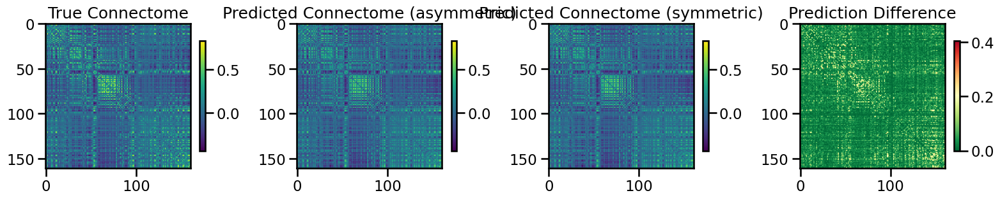

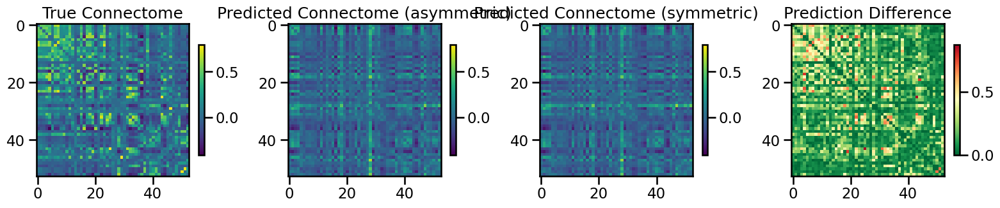

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.002920821660234487, 'mae': 0.03682085316583487, 'r2': 0.922705562205924, 'pearson_corr': 0.9633941347865732, 'geodesic_distance': 13.282518719810923}
TEST METRICS: {'mse': 0.0461595309750853, 'mae': 0.15636579746267318, 'r2': -0.0870321083007155, 'pearson_corr': 0.37109841892469075, 'geodesic_distance': 14.315165669872078}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [256, 128], 'dropout_rate': 0.13710006612409684, 'learning_rate': 5.848089269641373e-05, 'weight_decay': 9.01707274877328e-05, 'batch_size': 473, 'epochs': 175, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▃▂▂▁▃▅▃▄▃▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
test_pearson,▄▁▇█▇▇▇█▇██▇████████████████████████████
train_mse_loss,█▆▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▅▆▇███████████████████████████████████
best_val_loss,0
test_mse_loss,0.01152
test_pearson,0.3706
train_mse_loss,0.00369
train_pearson,0.85908


Final evaluation metrics logged successfully.
CPU Usage: 1.4%
RAM Usage: 5.2%
Available RAM: 954.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 24% |

 Test fold num: 2 X_train shape: (25760, 14766) Y_train shape: (25760,) X_test shape: (2756, 14766) Y_test shape: (2756,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 1zna3ulo
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/1zna3ulo


wandb: Agent Starting Run: a9pbwt4w with config:
wandb: 	batch_size: 387
wandb: 	dropout_rate: 0.22540646530061248
wandb: 	epochs: 152
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.979991704652111e-05
wandb: 	weight_decay: 7.55663338888795e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 5/152, Train Loss: 0.0228, Val Loss: 0.0129
Epoch 10/152, Train Loss: 0.0198, Val Loss: 0.0159
Epoch 15/152, Train Loss: 0.0172, Val Loss: 0.0142
Epoch 20/152, Train Loss: 0.0156, Val Loss: 0.0137
Epoch 25/152, Train Loss: 0.0141, Val Loss: 0.0127
Epoch 30/152, Train Loss: 0.0120, Val Loss: 0.0137
Epoch 35/152, Train Loss: 0.0105, Val Loss: 0.0138
Epoch 40/152, Train Loss: 0.0091, Val Loss: 0.0129
Epoch 45/152, Train Loss: 0.0080, Val Loss: 0.0119
Epoch 50/152, Train Loss: 0.0069, Val Loss: 0.0126
Epoch 55/152, Train Loss: 0.0062, Val Loss: 0.0125
Epoch 60/152, Train Loss: 0.0054, Val Loss: 0.0129
Epoch 65/152, Train Loss: 0.0049, Val Loss: 0.0119
Epoch 70/152, Train Loss: 0.0046, Val Loss: 0.0118
Epoch 75/152, Train Loss: 0.0041, Val Loss: 0.0118
Epoch 80/152, Train Loss: 0.0038, Val Loss: 0.0117
Epoch 85/152, Train Loss: 0.0037, Val Loss: 0.0116
Epoch 90/152, Train Loss: 0.0036, Val Loss: 0.0115
Epoch 95/152, Train Loss: 0.0036, Val Loss: 0.0116
Epoch 100/152, Train Loss: 0.003

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▆▆▇▇▇▇█████
fold0_train_loss,█▇▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▂▂▃▄▄▄▅▅▆▆▆▆▇▇▇██████████████████████
fold0_val_loss,▃█▄▅▄▅▅▅▃▄▂▃▂▃▃▂▃▂▂▁▂▂▁▁▁▂▁▁▁▂▂▁▂▂▁▂▂▂▁▂
fold0_val_pearson,▁▃▂▁▁▂▃▂▂▃▄▄▄▅▅▄▃▄▆▆▆▅▆▇▆▇▇█▇█▇▇▇▇█▇██▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇███
fold1_train_loss,██▇▆▅▅▅▄▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▁▂▂▂▂▃▃▄▄▄▄▅▆▇████████████████████████
fold1_val_loss,█▃▄▂▂▄▁▂▄▄▂▂▂▂▂▂▂▂▁▂▂▁▂▁▂▂▁▂▁▂▂▂▁▁▁▂▂▂▁▂
fold1_val_pearson,▁▄▅▅▆▇▇██▇▇▆▆▇▇██▇▇█▇▇▇█████████████████
fold2_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇████


wandb: Agent Starting Run: uqwxbop7 with config:
wandb: 	batch_size: 508
wandb: 	dropout_rate: 0.12866151884952717
wandb: 	epochs: 138
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 8.856855278989622e-05
wandb: 	weight_decay: 0.0003744128166500621
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/138, Train Loss: 0.0170, Val Loss: 0.0149
Epoch 10/138, Train Loss: 0.0145, Val Loss: 0.0128
Epoch 15/138, Train Loss: 0.0127, Val Loss: 0.0118
Epoch 20/138, Train Loss: 0.0110, Val Loss: 0.0117
Epoch 25/138, Train Loss: 0.0095, Val Loss: 0.0120


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 30/138, Train Loss: 0.0081, Val Loss: 0.0127
Epoch 35/138, Train Loss: 0.0072, Val Loss: 0.0119
Epoch 40/138, Train Loss: 0.0062, Val Loss: 0.0109
Epoch 45/138, Train Loss: 0.0053, Val Loss: 0.0128
Epoch 50/138, Train Loss: 0.0046, Val Loss: 0.0110
Epoch 55/138, Train Loss: 0.0040, Val Loss: 0.0102
Epoch 60/138, Train Loss: 0.0036, Val Loss: 0.0114
Epoch 65/138, Train Loss: 0.0033, Val Loss: 0.0113
Epoch 70/138, Train Loss: 0.0029, Val Loss: 0.0104
Epoch 75/138, Train Loss: 0.0026, Val Loss: 0.0102
Epoch 80/138, Train Loss: 0.0025, Val Loss: 0.0106
Epoch 85/138, Train Loss: 0.0023, Val Loss: 0.0108
Epoch 90/138, Train Loss: 0.0021, Val Loss: 0.0115
Epoch 95/138, Train Loss: 0.0020, Val Loss: 0.0098
Epoch 100/138, Train Loss: 0.0019, Val Loss: 0.0104
Epoch 105/138, Train Loss: 0.0018, Val Loss: 0.0114
Epoch 110/138, Train Loss: 0.0017, Val Loss: 0.0101
Epoch 115/138, Train Loss: 0.0017, Val Loss: 0.0097
Epoch 120/138, Train Loss: 0.0013, Val Loss: 0.0093
Epoch 125/138, Train Loss:

fold0_epoch,▁▁▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇████
fold0_train_loss,█▇▇▇▆▅▅▅▅▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▃▄▅▅▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇███████████████████
fold0_val_loss,█▇▆▅▆▄▅▅▄▅▃▃▃▄▄▄▃▄▃▂▂▄▅▃▃▂▁█▃▁▆▂▂▄▁▁▁▁▁▁
fold0_val_pearson,▁▂▂▂▂▃▃▄▃▅▃▆▄▅▅▇▅▆▆▅▄▅▆▄▇▅▆▆▇▇█▅████████
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇██
fold1_train_loss,█▇▆▆▅▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▂▃▃▄▄▄▄▆▆▆▆▆▆▆▇▇▇▇▇██████████████████
fold1_val_loss,▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂█▁▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▄▁▃▇▆▆▆▆▆▇▇▇▇▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇▇█▇████▇
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███


wandb: Agent Starting Run: 52vmdikd with config:
wandb: 	batch_size: 468
wandb: 	dropout_rate: 0.17162332970022737
wandb: 	epochs: 166
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.1829788374217696e-05
wandb: 	weight_decay: 0.00017830707782560653
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/166, Train Loss: 0.0222, Val Loss: 0.0134
Epoch 10/166, Train Loss: 0.0192, Val Loss: 0.0120
Epoch 15/166, Train Loss: 0.0172, Val Loss: 0.0116
Epoch 20/166, Train Loss: 0.0158, Val Loss: 0.0111
Epoch 25/166, Train Loss: 0.0142, Val Loss: 0.0118


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 30/166, Train Loss: 0.0131, Val Loss: 0.0118
Epoch 35/166, Train Loss: 0.0118, Val Loss: 0.0122
Epoch 40/166, Train Loss: 0.0102, Val Loss: 0.0111
Epoch 45/166, Train Loss: 0.0090, Val Loss: 0.0106
Epoch 50/166, Train Loss: 0.0081, Val Loss: 0.0110
Epoch 55/166, Train Loss: 0.0070, Val Loss: 0.0114
Epoch 60/166, Train Loss: 0.0063, Val Loss: 0.0111
Epoch 65/166, Train Loss: 0.0058, Val Loss: 0.0107
Epoch 70/166, Train Loss: 0.0051, Val Loss: 0.0112
Epoch 75/166, Train Loss: 0.0047, Val Loss: 0.0113
Epoch 80/166, Train Loss: 0.0044, Val Loss: 0.0106
Epoch 85/166, Train Loss: 0.0040, Val Loss: 0.0107
Epoch 90/166, Train Loss: 0.0039, Val Loss: 0.0104
Epoch 95/166, Train Loss: 0.0036, Val Loss: 0.0106
Epoch 100/166, Train Loss: 0.0036, Val Loss: 0.0105
Epoch 105/166, Train Loss: 0.0035, Val Loss: 0.0104
Epoch 110/166, Train Loss: 0.0031, Val Loss: 0.0103
Epoch 115/166, Train Loss: 0.0030, Val Loss: 0.0101
Epoch 120/166, Train Loss: 0.0028, Val Loss: 0.0101
Epoch 125/166, Train Loss:

fold0_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,█▇▇▆▆▅▅▅▅▅▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▃▂▃▃▃▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇█▇███████
fold0_val_loss,█▄▂▂▂▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▂▁▁▂▂▂▃▄▃▃▄▄▄▄▆▅▅▇▆▆█▆▆▇▆▆▆▇████████████
fold1_epoch,▁▁▂▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇████
fold1_train_loss,█▇▆▅▅▅▄▄▄▄▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▂▂▃▃▄▄▄▇▇▇▇▇█████████████████████████
fold1_val_loss,█▄▂▂▁▂▂▁▁▁▁▁▂▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
fold1_val_pearson,▃▂▁▅▃▅▅▅▆██▇▆▅▄▃▃▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 138, 'input_dim': 14766, 'batch_size': 508, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.12866151884952717, 'weight_decay': 0.0003744128166500621, 'learning_rate': 8.856855278989622e-05}
Number of learnable parameters in MLP: 7726849
Epoch 5/138, Train Loss: 0.0137, Val Loss: 0.0144
Epoch 10/138, Train Loss: 0.0106, Val Loss: 0.0150
Epoch 15/138, Train Loss: 0.0079, Val Loss: 0.0137
Epoch 20/138, Train Loss: 0.0058, Val Loss: 0.0138
Epoch 25/138, Train Loss: 0.0045, Val Loss: 0.0156
Epoch 30/138, Train Loss: 0.0037, Val Loss: 0.0133
Epoch 35/138, Train Loss: 0.0028, Val Loss: 0.0135
Epoch 40/138, Train Loss: 0.0026, Val Loss: 0.0138
Epoch 45/138, Train Loss: 0.0025, Val Loss: 0.0139
Epoch 50/138, Train Loss: 0.0023, Val Loss: 0.0139
Epoch 55/138, Train Loss: 0.0023, Val Loss: 0.0143
Epoch 60/138, Train Loss: 0.0022, Val Loss: 0.0145
Epoch 65/138, Train Loss: 0.0022, Val Loss: 0.0143
Epoch 70/138, Train Loss: 0.0022, Val Loss: 0.0145
Epoch 75/138, Train Loss:

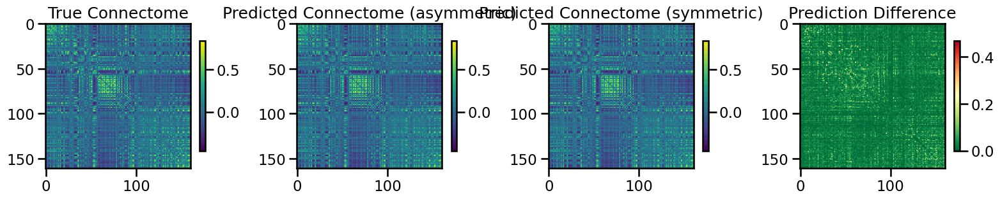

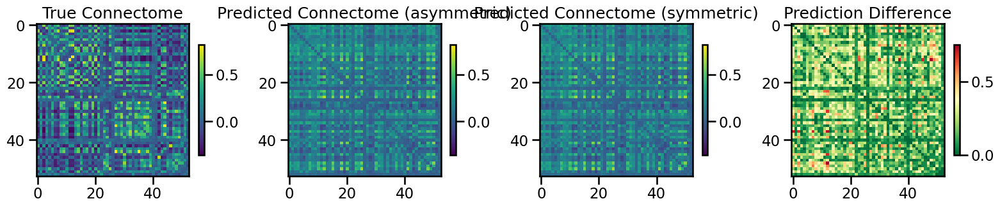

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.001653400544238508, 'mae': 0.028206126683767988, 'r2': 0.9546244406215125, 'pearson_corr': 0.977402554498609, 'geodesic_distance': 10.881875620905092}
TEST METRICS: {'mse': 0.056730142037869434, 'mae': 0.1886565111108522, 'r2': -0.013780644122563634, 'pearson_corr': 0.3570210775424027, 'geodesic_distance': 8.275569825389125}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.12866151884952717, 'learning_rate': 8.856855278989622e-05, 'weight_decay': 0.0003744128166500621, 'batch_size': 508, 'epochs': 138, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▆▇▅▂▁▁▁▃▂▃▄▂██▃▃▂▂▃▃▇▃▃▅▅▅▅▅▅▄▅▅▅▅▅▅▅▅▅▆
test_pearson,▁▄▇▄█▅▇▃▇▅▄▆▆▆▆▆▅▆▅▆▆▅▆▆▅▅▆▆▅▆▅▆▅▆▅▆▆▅▅▅
train_mse_loss,█▇▆▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▃▄▄▅▆▆▇███████████████████████████████
best_val_loss,0
test_mse_loss,0.01469
test_pearson,0.35098
train_mse_loss,0.00216
train_pearson,0.92589


Final evaluation metrics logged successfully.
CPU Usage: 1.1%
RAM Usage: 5.2%
Available RAM: 954.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 24% |

 Test fold num: 3 X_train shape: (25760, 14766) Y_train shape: (25760,) X_test shape: (2756, 14766) Y_test shape: (2756,)
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 4pu7xoyr
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/4pu7xoyr


wandb: Agent Starting Run: kpf2q77b with config:
wandb: 	batch_size: 323
wandb: 	dropout_rate: 0.20086635893813087
wandb: 	epochs: 157
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 9.935149932599793e-05
wandb: 	weight_decay: 0.0004680369196687012
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/157, Train Loss: 0.0196, Val Loss: 0.0131
Epoch 10/157, Train Loss: 0.0150, Val Loss: 0.0116
Epoch 15/157, Train Loss: 0.0124, Val Loss: 0.0106
Epoch 20/157, Train Loss: 0.0096, Val Loss: 0.0106
Epoch 25/157, Train Loss: 0.0077, Val Loss: 0.0112
Epoch 30/157, Train Loss: 0.0063, Val Loss: 0.0103
Epoch 35/157, Train Loss: 0.0053, Val Loss: 0.0101
Epoch 40/157, Train Loss: 0.0047, Val Loss: 0.0097
Epoch 45/157, Train Loss: 0.0043, Val Loss: 0.0105
Epoch 50/157, Train Loss: 0.0038, Val Loss: 0.0099
Epoch 55/157, Train Loss: 0.0035, Val Loss: 0.0105
Epoch 60/157, Train Loss: 0.0034, Val Loss: 0.0128
Epoch 65/157, Train Loss: 0.0032, Val Loss: 0.0102
Epoch 70/157, Train Loss: 0.0028, Val Loss: 0.0108
Epoch 75/157, Train Loss: 0.0028, Val Loss: 0.0112


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 80/157, Train Loss: 0.0026, Val Loss: 0.0096
Epoch 85/157, Train Loss: 0.0022, Val Loss: 0.0098
Epoch 90/157, Train Loss: 0.0018, Val Loss: 0.0098
Epoch 95/157, Train Loss: 0.0017, Val Loss: 0.0099
Epoch 100/157, Train Loss: 0.0017, Val Loss: 0.0097
Epoch 105/157, Train Loss: 0.0017, Val Loss: 0.0097
Epoch 110/157, Train Loss: 0.0016, Val Loss: 0.0097
Epoch 115/157, Train Loss: 0.0015, Val Loss: 0.0097
Epoch 120/157, Train Loss: 0.0015, Val Loss: 0.0097
Epoch 125/157, Train Loss: 0.0015, Val Loss: 0.0096
Epoch 130/157, Train Loss: 0.0015, Val Loss: 0.0098
Epoch 135/157, Train Loss: 0.0016, Val Loss: 0.0097
Epoch 140/157, Train Loss: 0.0015, Val Loss: 0.0098
Epoch 145/157, Train Loss: 0.0015, Val Loss: 0.0098
Epoch 150/157, Train Loss: 0.0015, Val Loss: 0.0097
Epoch 155/157, Train Loss: 0.0015, Val Loss: 0.0096
Processing inner fold 1
Number of learnable parameters in MLP: 7726849
Epoch 5/157, Train Loss: 0.0207, Val Loss: 0.0169
Epoch 10/157, Train Loss: 0.0162, Val Loss: 0.0156


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Epoch 80/111, Train Loss: 0.0461, Val Loss: 0.1411
Epoch 85/111, Train Loss: 0.0455, Val Loss: 0.1290
Epoch 90/111, Train Loss: 0.0418, Val Loss: 0.1260
Epoch 95/111, Train Loss: 0.0408, Val Loss: 0.1287
Epoch 100/111, Train Loss: 0.0403, Val Loss: 0.1264
Epoch 105/111, Train Loss: 0.0402, Val Loss: 0.1283
Epoch 110/111, Train Loss: 0.0390, Val Loss: 0.1268


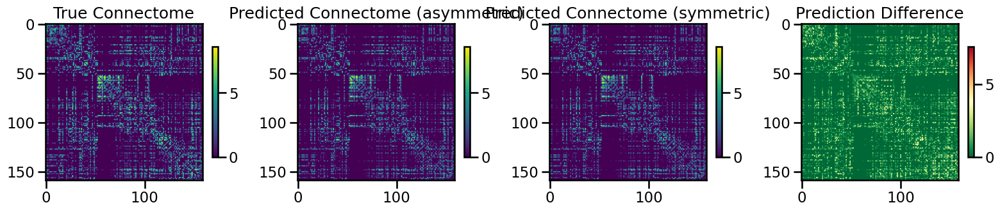

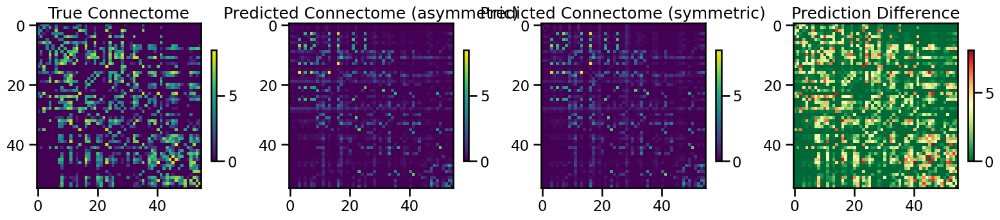

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.6968538090341092, 'mae': 0.33121579972053306, 'r2': 0.7894915969799771, 'pearson_corr': 0.8980038979693918, 'geodesic_distance': 14.509864269724613}
TEST METRICS: {'mse': 5.376237023223426, 'mae': 1.2991578642793176, 'r2': -0.07988492752888243, 'pearson_corr': 0.3480003802901886, 'geodesic_distance': 16.694329223621033}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.27215666666145044, 'learning_rate': 6.186241126289623e-05, 'weight_decay': 0.00042816533295891054, 'batch_size': 351, 'epochs': 111, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▇▅▅▆▅▅▄▅█▅▅▅▂▃▄▃▆▃▁▂▁▃▁▂▃▂▂▄▃▅▂▂▂▁▂▁▂▂▂▁
test_pearson,▃▁▁▃▃▃▄▄▅▄▂▆▅▅▆▆▆▇▇█▃▅▆▅▆▇▇▅▆▄▄▄▅▄▃▅▅▅▆▆
train_mse_loss,█▇▇▇▆▆▆▆▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▂▂▂▃▄▄▄▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██████████
best_val_loss,0
test_mse_loss,0.12519
test_pearson,0.35692
train_mse_loss,0.03951
train_pearson,0.85836


Final evaluation metrics logged successfully.
CPU Usage: 0.8%
RAM Usage: 5.1%
Available RAM: 956.1G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 26% |


  gc.collect()



Running simulation with: dynamic_mlp, random, S100, FC, seed=2
Number of components for 95% variance PCA: 34
X shape: (114, 10760)
X_pca shape: (114, 34)
Y_sc shape: (114, 114)
Y_sc_spectralL shape: (114, 113)
Y_sc_spectralA shape: (114, 114)
Y_fc shape: (114, 114)
Coordinates shape: (114, 3)
Y shape (114, 114)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (114, 10763)

 Test fold num: 1 X_train shape: (7140, 21526) Y_train shape: (7140,) X_test shape: (812, 21526) Y_test shape: (812,)
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: sdvsnu4s
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/sdvsnu4s


wandb: Agent Starting Run: rl4968mn with config:
wandb: 	batch_size: 356
wandb: 	dropout_rate: 0.15577434926699996
wandb: 	epochs: 132
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.329167918155484e-05
wandb: 	weight_decay: 8.424005154602691e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/132, Train Loss: 0.0236, Val Loss: 0.0161
Epoch 10/132, Train Loss: 0.0212, Val Loss: 0.0075
Epoch 15/132, Train Loss: 0.0191, Val Loss: 0.0076
Epoch 20/132, Train Loss: 0.0169, Val Loss: 0.0076
Epoch 25/132, Train Loss: 0.0157, Val Loss: 0.0051
Epoch 30/132, Train Loss: 0.0146, Val Loss: 0.0066
Epoch 35/132, Train Loss: 0.0142, Val Loss: 0.0058
Epoch 40/132, Train Loss: 0.0131, Val Loss: 0.0051
Epoch 45/132, Train Loss: 0.0126, Val Loss: 0.0051
Epoch 50/132, Train Loss: 0.0116, Val Loss: 0.0047
Epoch 55/132, Train Loss: 0.0112, Val Loss: 0.0046
Epoch 60/132, Train Loss: 0.0104, Val Loss: 0.0049
Epoch 65/132, Train Loss: 0.0100, Val Loss: 0.0050
Epoch 70/132, Train Loss: 0.0099, Val Loss: 0.0048
Epoch 75/132, Train Loss: 0.0090, Val Loss: 0.0051
Epoch 80/132, Train Loss: 0.0080, Val Loss: 0.0052
Epoch 85/132, Train Loss: 0.0082, Val Loss: 0.0047
Epoch 90/132, Train Loss: 0.0079, Val Loss: 0.0044
Epoch 95/132

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 125/132, Train Loss: 0.0073, Val Loss: 0.0049
Epoch 130/132, Train Loss: 0.0075, Val Loss: 0.0050
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/132, Train Loss: 0.0296, Val Loss: 0.0423
Epoch 10/132, Train Loss: 0.0270, Val Loss: 0.0300
Epoch 15/132, Train Loss: 0.0252, Val Loss: 0.0279
Epoch 20/132, Train Loss: 0.0236, Val Loss: 0.0191
Epoch 25/132, Train Loss: 0.0212, Val Loss: 0.0237
Epoch 30/132, Train Loss: 0.0200, Val Loss: 0.0182
Epoch 35/132, Train Loss: 0.0188, Val Loss: 0.0160
Epoch 40/132, Train Loss: 0.0174, Val Loss: 0.0140
Epoch 45/132, Train Loss: 0.0163, Val Loss: 0.0152
Epoch 50/132, Train Loss: 0.0150, Val Loss: 0.0122
Epoch 55/132, Train Loss: 0.0147, Val Loss: 0.0117
Epoch 60/132, Train Loss: 0.0137, Val Loss: 0.0108
Epoch 65/132, Train Loss: 0.0125, Val Loss: 0.0092
Epoch 70/132, Train Loss: 0.0114, Val Loss: 0.0090
Epoch 75/132, Train Loss: 0.0111, Val Loss: 0.0076
Epoch 80/132, Train Loss: 0.0106, Val Loss: 0.0063
Epoch 85/1

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▇▇▇▇▇▇▇█
fold0_train_loss,█▆▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▃▃▃▂▄▄▄▄▄▅▅▄▅▅▆▆▆▇▇▇▇▇███▇▇███████▇▇█▇
fold0_val_loss,▅█▂▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▅▆▅▆▄▇▇█▇▆▇▆▇▇▅▅▆▅▇▇▆▇▇▆▇▇██▇▇▇▆▇█▇▆▇▇▆
fold1_epoch,▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇██
fold1_train_loss,█▇▇▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁
fold1_train_pearson,▁▁▁▁▁▁▂▂▂▃▂▂▃▃▄▃▄▄▃▄▅▅▄▄▄▅▅▅▅▆▆▅▆▆▆▇▇▇██
fold1_val_loss,▅█▂▄▃▂▃▃▂▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂
fold1_val_pearson,▁▃▁▆▅▅▅▆▄▆▆▆▆▆▄▆▆▆▆▆▇▇▇▇▇▆▇▇█▇███▅▆▇███▆
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇█


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 3my5g3uz with config:
wandb: 	batch_size: 489
wandb: 	dropout_rate: 0.21764294928815103
wandb: 	epochs: 116
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.28714840749234e-05
wandb: 	weight_decay: 0.00013584730595230717
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/116, Train Loss: 0.0338, Val Loss: 0.0227
Epoch 10/116, Train Loss: 0.0283, Val Loss: 0.0196
Epoch 15/116, Train Loss: 0.0261, Val Loss: 0.0180
Epoch 20/116, Train Loss: 0.0231, Val Loss: 0.0149
Epoch 25/116, Train Loss: 0.0229, Val Loss: 0.0128
Epoch 30/116, Train Loss: 0.0222, Val Loss: 0.0128
Epoch 35/116, Train Loss: 0.0219, Val Loss: 0.0123


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 40/116, Train Loss: 0.0221, Val Loss: 0.0123
Epoch 45/116, Train Loss: 0.0219, Val Loss: 0.0119
Epoch 50/116, Train Loss: 0.0223, Val Loss: 0.0122
Epoch 55/116, Train Loss: 0.0217, Val Loss: 0.0122
Epoch 60/116, Train Loss: 0.0224, Val Loss: 0.0119
Epoch 65/116, Train Loss: 0.0219, Val Loss: 0.0119
Epoch 70/116, Train Loss: 0.0221, Val Loss: 0.0120
Epoch 75/116, Train Loss: 0.0217, Val Loss: 0.0122
Epoch 80/116, Train Loss: 0.0212, Val Loss: 0.0121
Epoch 85/116, Train Loss: 0.0217, Val Loss: 0.0119
Epoch 90/116, Train Loss: 0.0219, Val Loss: 0.0116
Epoch 95/116, Train Loss: 0.0219, Val Loss: 0.0116
Epoch 100/116, Train Loss: 0.0219, Val Loss: 0.0117
Epoch 105/116, Train Loss: 0.0224, Val Loss: 0.0121
Epoch 110/116, Train Loss: 0.0221, Val Loss: 0.0120
Epoch 115/116, Train Loss: 0.0222, Val Loss: 0.0120
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/116, Train Loss: 0.0322, Val Loss: 0.0157
Epoch 10/116, Train Loss: 0.0274, Val Loss: 0.0200
Epoch 1

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁
fold0_train_pearson,▁▂▃▄▅▆▇▅█▇▆▇▆█▇██▆████▇▇▆█▇▇▇█▆▇█▇▇▇▅▇▇▇
fold0_val_loss,▁▄▄█▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▅▆▃▇█▆█████████████████████████████████
fold1_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇█
fold1_train_loss,█▇▆▅▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▃▃▇▅▆▃▅▄▅▆▆▅▆▇▅▅▇▅▆▅▇█▇▇▇▇▇▇▇▇▇▇██▅▆▆▆▇
fold1_val_loss,▆▅▄▄▄▄█▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▇▁▆▆▇▅▆▅▇███████████████████████████████
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇███


wandb: Agent Starting Run: n8muy2h7 with config:
wandb: 	batch_size: 424
wandb: 	dropout_rate: 0.20723272173498297
wandb: 	epochs: 115
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.669043298202162e-05
wandb: 	weight_decay: 0.00014650203595671055
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/115, Train Loss: 0.0270, Val Loss: 0.0306
Epoch 10/115, Train Loss: 0.0242, Val Loss: 0.0090
Epoch 15/115, Train Loss: 0.0220, Val Loss: 0.0088
Epoch 20/115, Train Loss: 0.0207, Val Loss: 0.0094
Epoch 25/115, Train Loss: 0.0184, Val Loss: 0.0086
Epoch 30/115, Train Loss: 0.0181, Val Loss: 0.0057
Epoch 35/115, Train Loss: 0.0171, Val Loss: 0.0054


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 40/115, Train Loss: 0.0158, Val Loss: 0.0056
Epoch 45/115, Train Loss: 0.0154, Val Loss: 0.0049
Epoch 50/115, Train Loss: 0.0152, Val Loss: 0.0047
Epoch 55/115, Train Loss: 0.0138, Val Loss: 0.0048
Epoch 60/115, Train Loss: 0.0133, Val Loss: 0.0052
Epoch 65/115, Train Loss: 0.0130, Val Loss: 0.0069
Epoch 70/115, Train Loss: 0.0118, Val Loss: 0.0045
Epoch 75/115, Train Loss: 0.0116, Val Loss: 0.0045
Epoch 80/115, Train Loss: 0.0111, Val Loss: 0.0055
Epoch 85/115, Train Loss: 0.0107, Val Loss: 0.0049
Epoch 90/115, Train Loss: 0.0101, Val Loss: 0.0048
Epoch 95/115, Train Loss: 0.0096, Val Loss: 0.0045
Epoch 100/115, Train Loss: 0.0095, Val Loss: 0.0046
Epoch 105/115, Train Loss: 0.0093, Val Loss: 0.0046
Epoch 110/115, Train Loss: 0.0090, Val Loss: 0.0046
Epoch 115/115, Train Loss: 0.0091, Val Loss: 0.0047
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/115, Train Loss: 0.0357, Val Loss: 0.0645
Epoch 10/115, Train Loss: 0.0323, Val Loss: 0.0151
Epoch 15

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇███
fold0_train_loss,█▆▆▅▅▅▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▃▃▃▃▄▄▃▅▃▄▄▄▄▄▅▅▅▅▄▄▄▆▅▅▆▆▆▆▆▆▅▆▇▇▇▇██
fold0_val_loss,█▅▅▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▄▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▄▆▇▆▇▅▆▇▇███▇▇▇████▅▇▇▇█▇█▇▇▇▆▇▇▇▇▇▇▇▇▇
fold1_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇████
fold1_train_loss,██▇▆▇▂▂▂▂▂▁▁▂▂▂▁▂▁▁▁▁▂▁▂▁▂▁▂▁▂▂▂▂▁▁▁▂▂▁▁
fold1_train_pearson,▃▁▃▇▆▄▅▅▆▇▇▇▅▇▆▇▆▇▇▇▆▆▇▇▆▇▇▇▆█▆▆▇▇▇▇▆▇▇█
fold1_val_loss,▁▄█▄▁▅▁▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
fold1_val_pearson,▁▄▇▇█▇██████████████████████████████████
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 116, 'input_dim': 21526, 'batch_size': 489, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.21764294928815103, 'weight_decay': 0.00013584730595230717, 'learning_rate': 9.28714840749234e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/116, Train Loss: 0.0269, Val Loss: 0.0115
Epoch 10/116, Train Loss: 0.0218, Val Loss: 0.0100
Epoch 15/116, Train Loss: 0.0188, Val Loss: 0.0080
Epoch 20/116, Train Loss: 0.0157, Val Loss: 0.0067
Epoch 25/116, Train Loss: 0.0138, Val Loss: 0.0063
Epoch 30/116, Train Loss: 0.0121, Val Loss: 0.0053
Epoch 35/116, Train Loss: 0.0107, Val Loss: 0.0052
Epoch 40/116, Train Loss: 0.0094, Val Loss: 0.0049
Epoch 45/116, Train Loss: 0.0084, Val Loss: 0.0050
Epoch 50/116, Train Loss: 0.0076, Val Loss: 0.0045
Epoch 55/116, Train Loss: 0.0066, Val Loss: 0.0045
Epoch 60/116, Train Loss: 0.0057, Val Loss: 0.0048
Epoch 65/116, Train Loss: 0.0050, Val Loss: 0.0042
Epoch 70/116, Train Loss: 0.0047, Val Loss: 0.0066
Epoch 75/116, Train Loss

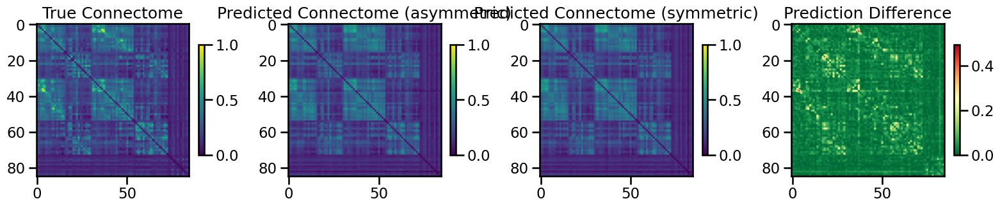

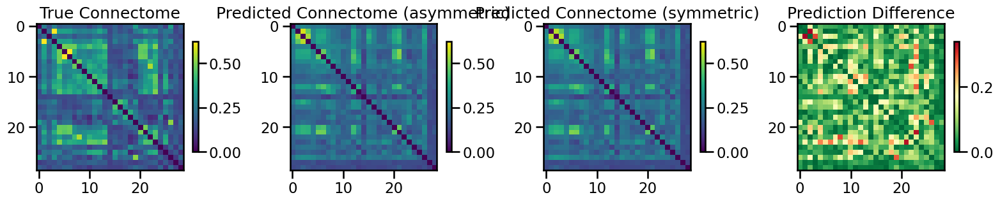

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0023068678299061943, 'mae': 0.030778099620998853, 'r2': 0.8574779888094761, 'pearson_corr': 0.9306886920402434, 'geodesic_distance': 7.74464643499351}
TEST METRICS: {'mse': 0.009759273931827208, 'mae': 0.07365487928006607, 'r2': 0.13139202968229124, 'pearson_corr': 0.45648718957232626, 'geodesic_distance': 3.751625044614108}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.21764294928815103, 'learning_rate': 9.28714840749234e-05, 'weight_decay': 0.00013584730595230717, 'batch_size': 489, 'epochs': 116, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▇▆█▄▅▄▄▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▂▅▂▁▃▃▅▆▅▃▁▄▅▅▅▃▄▅▆▇▅▇▇▆█▆▅██▇▆▇█▇█▇▇███
train_mse_loss,█▇▆▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▅▅▄▅▅▅▆▅▆▅▆▆▇▇▇▇█▇█████
best_val_loss,0
test_mse_loss,0.00395
test_pearson,0.45294
train_mse_loss,0.003
train_pearson,0.63485


Final evaluation metrics logged successfully.
CPU Usage: 2.4%
RAM Usage: 4.3%
Available RAM: 963.5G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 2 X_train shape: (7140, 21526) Y_train shape: (7140,) X_test shape: (812, 21526) Y_test shape: (812,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: susd1t7w
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/susd1t7w


wandb: Agent Starting Run: ffj9667f with config:
wandb: 	batch_size: 277
wandb: 	dropout_rate: 0.16903090346651878
wandb: 	epochs: 161
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.55702960120927e-05
wandb: 	weight_decay: 0.0003512455213651223
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/161, Train Loss: 0.0319, Val Loss: 0.0118
Epoch 10/161, Train Loss: 0.0277, Val Loss: 0.0221
Epoch 15/161, Train Loss: 0.0255, Val Loss: 0.0113
Epoch 20/161, Train Loss: 0.0237, Val Loss: 0.0169
Epoch 25/161, Train Loss: 0.0228, Val Loss: 0.0179
Epoch 30/161, Train Loss: 0.0205, Val Loss: 0.0225
Epoch 35/161, Train Loss: 0.0193, Val Loss: 0.0117
Epoch 40/161, Train Loss: 0.0178, Val Loss: 0.0118
Epoch 45/161, Train Loss: 0.0184, Val Loss: 0.0110
Epoch 50/161, Train Loss: 0.0185, Val Loss: 0.0112
Epoch 55/161, Train Loss: 0.0181, Val Loss: 0.0111
Epoch 60/161, Train Loss: 0.0176, Val Loss: 0.0120
Epoch 65/161, Train Loss: 0.0173, Val Loss: 0.0120
Epoch 70/161, Train Loss: 0.0179, Val Loss: 0.0120
Epoch 75/161, Train Loss: 0.0178, Val Loss: 0.0116
Epoch 80/161, Train Loss: 0.0181, Val Loss: 0.0118
Epoch 85/161, Train Loss: 0.0176, Val Loss: 0.0123
Epoch 90/161, Train Loss: 0.0176, Val Loss: 0.0119
Epoch 95/161

  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 100/161, Train Loss: 0.0179, Val Loss: 0.0119
Epoch 105/161, Train Loss: 0.0183, Val Loss: 0.0112
Epoch 110/161, Train Loss: 0.0172, Val Loss: 0.0114
Epoch 115/161, Train Loss: 0.0174, Val Loss: 0.0118
Epoch 120/161, Train Loss: 0.0176, Val Loss: 0.0114
Epoch 125/161, Train Loss: 0.0184, Val Loss: 0.0118
Epoch 130/161, Train Loss: 0.0187, Val Loss: 0.0113
Epoch 135/161, Train Loss: 0.0172, Val Loss: 0.0114
Epoch 140/161, Train Loss: 0.0179, Val Loss: 0.0116
Epoch 145/161, Train Loss: 0.0178, Val Loss: 0.0113
Epoch 150/161, Train Loss: 0.0179, Val Loss: 0.0113
Epoch 155/161, Train Loss: 0.0180, Val Loss: 0.0116
Epoch 160/161, Train Loss: 0.0179, Val Loss: 0.0119
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/161, Train Loss: 0.0287, Val Loss: 0.0326
Epoch 10/161, Train Loss: 0.0250, Val Loss: 0.0294
Epoch 15/161, Train Loss: 0.0222, Val Loss: 0.0246
Epoch 20/161, Train Loss: 0.0206, Val Loss: 0.0242
Epoch 25/161, Train Loss: 0.0183, Val Loss: 0.0225

fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇██
fold0_train_loss,██▇▆▆▅▄▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▂▁▁▂▁▁▁▂▁▂▁▁▂▁▁▁▁
fold0_train_pearson,▁▅█▅▇▆▇█▇█▇▇▇▇▇▇██▇▇▇▇▇▇▆▇▆▇▇██▆▇▇▇▆▇▇▇▇
fold0_val_loss,▂▇▆█▂▇▃▁▁▁▁▂▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁█▇▆▃██▇▇▇▇▆▆▆▆▇▆▇▇▇▆▇▇▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
fold1_train_loss,█▅▅▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▃▄▅▃▅▆▆▅▇▆▅▆▅▆▅▅▆▆▇▄▆▆▆▆▇▆▅▆▆▆▆▄▆▆▅▄█▆
fold1_val_loss,▅█▄█▂▁▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▆▃▁▇█▇▇█▇▇██████████████████████████████
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇██


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 3v4vjr4l with config:
wandb: 	batch_size: 377
wandb: 	dropout_rate: 0.2780544645124049
wandb: 	epochs: 120
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.951989686016613e-05
wandb: 	weight_decay: 0.00021595899165835491
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/120, Train Loss: 0.0366, Val Loss: 0.0247
Epoch 10/120, Train Loss: 0.0326, Val Loss: 0.0178
Epoch 15/120, Train Loss: 0.0293, Val Loss: 0.0147
Epoch 20/120, Train Loss: 0.0268, Val Loss: 0.0142
Epoch 25/120, Train Loss: 0.0245, Val Loss: 0.0122
Epoch 30/120, Train Loss: 0.0247, Val Loss: 0.0122
Epoch 35/120, Train Loss: 0.0237, Val Loss: 0.0123
Epoch 40/120, Train Loss: 0.0238, Val Loss: 0.0111
Epoch 45/120, Train Loss: 0.0246, Val Loss: 0.0113
Epoch 50/120, Train Loss: 0.0241, Val Loss: 0.0118
Epoch 55/120, Train Loss: 0.0240, Val Loss: 0.0113
Epoch 60/120, Train Loss: 0.0240, Val Loss: 0.0115
Epoch 65/120, Train Loss: 0.0240, Val Loss: 0.0108
Epoch 70/120, Train Loss: 0.0238, Val Loss: 0.0105
Epoch 75/120, Train Loss: 0.0243, Val Loss: 0.0111
Epoch 80/120, Train Loss: 0.0239, Val Loss: 0.0118


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 85/120, Train Loss: 0.0237, Val Loss: 0.0113
Epoch 90/120, Train Loss: 0.0235, Val Loss: 0.0123
Epoch 95/120, Train Loss: 0.0243, Val Loss: 0.0109
Epoch 100/120, Train Loss: 0.0238, Val Loss: 0.0110
Epoch 105/120, Train Loss: 0.0238, Val Loss: 0.0114
Epoch 110/120, Train Loss: 0.0222, Val Loss: 0.0111
Epoch 115/120, Train Loss: 0.0239, Val Loss: 0.0111
Epoch 120/120, Train Loss: 0.0237, Val Loss: 0.0123
Processing inner fold 1
Number of learnable parameters in MLP: 11187969


  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 5/120, Train Loss: 0.0328, Val Loss: 0.0131
Epoch 10/120, Train Loss: 0.0274, Val Loss: 0.0212
Epoch 15/120, Train Loss: 0.0248, Val Loss: 0.0216
Epoch 20/120, Train Loss: 0.0222, Val Loss: 0.0161
Epoch 25/120, Train Loss: 0.0209, Val Loss: 0.0105
Epoch 30/120, Train Loss: 0.0211, Val Loss: 0.0133
Epoch 35/120, Train Loss: 0.0205, Val Loss: 0.0123
Epoch 40/120, Train Loss: 0.0198, Val Loss: 0.0122
Epoch 45/120, Train Loss: 0.0210, Val Loss: 0.0126
Epoch 50/120, Train Loss: 0.0199, Val Loss: 0.0092
Epoch 55/120, Train Loss: 0.0201, Val Loss: 0.0167
Epoch 60/120, Train Loss: 0.0195, Val Loss: 0.0139
Epoch 65/120, Train Loss: 0.0204, Val Loss: 0.0113
Epoch 70/120, Train Loss: 0.0200, Val Loss: 0.0121
Epoch 75/120, Train Loss: 0.0199, Val Loss: 0.0148
Epoch 80/120, Train Loss: 0.0201, Val Loss: 0.0154
Epoch 85/120, Train Loss: 0.0203, Val Loss: 0.0091
Epoch 90/120, Train Loss: 0.0203, Val Loss: 0.0134
Epoch 95/120, Train Loss: 0.0202, Val Loss: 0.0123
Epoch 100/120, Train Loss: 0.019

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇█
fold0_train_loss,█▇▅▄▄▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▄▃▅▆▇▄▆▆▅▅▇▇█▇▇▆▅▇▆▆▆▇▆▆▆▆▆▆▇▅▅▆▆▅▅▆▅▇█
fold0_val_loss,▁██▆▆▅▅▅▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃
fold0_val_pearson,▁▄▄▅▁▆▅▆▇▆▇▆▇▆▇▇▇▆▇▇▇▇▇▆▇▇█▇█▇▆█▇▆▆█▆▇▇▆
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇████
fold1_train_loss,█▆▆▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▂▃▃▅▆▆▆▇▅▃▆▅█▆▆▅▇▆▇▆▆▇█▇▅▇▇█▇▇▇▇▇▆▇▆▇▆
fold1_val_loss,▁▁▃▃▂█▂▁▂▁▂▂▃▂▁▂▂▁▂▁▂▂▂▂▂▂▂▁▂▁▂▁▂▂▁▃▂▂▂▂
fold1_val_pearson,▆▁▂██▂▁▂████▂███▂█████▂▂██▂▂███▂██▂▂██▂█
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇████


wandb: Agent Starting Run: cyhbd5gj with config:
wandb: 	batch_size: 362
wandb: 	dropout_rate: 0.18293866596550773
wandb: 	epochs: 164
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.637430175150896e-05
wandb: 	weight_decay: 0.00045510786224398303
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/164, Train Loss: 0.0266, Val Loss: 0.0121
Epoch 10/164, Train Loss: 0.0238, Val Loss: 0.0085
Epoch 15/164, Train Loss: 0.0210, Val Loss: 0.0101
Epoch 20/164, Train Loss: 0.0197, Val Loss: 0.0091
Epoch 25/164, Train Loss: 0.0187, Val Loss: 0.0060
Epoch 30/164, Train Loss: 0.0173, Val Loss: 0.0061


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 35/164, Train Loss: 0.0164, Val Loss: 0.0073
Epoch 40/164, Train Loss: 0.0155, Val Loss: 0.0071
Epoch 45/164, Train Loss: 0.0149, Val Loss: 0.0061
Epoch 50/164, Train Loss: 0.0137, Val Loss: 0.0104
Epoch 55/164, Train Loss: 0.0126, Val Loss: 0.0095
Epoch 60/164, Train Loss: 0.0120, Val Loss: 0.0058
Epoch 65/164, Train Loss: 0.0115, Val Loss: 0.0057
Epoch 70/164, Train Loss: 0.0110, Val Loss: 0.0064
Epoch 75/164, Train Loss: 0.0105, Val Loss: 0.0061
Epoch 80/164, Train Loss: 0.0098, Val Loss: 0.0064
Epoch 85/164, Train Loss: 0.0089, Val Loss: 0.0051
Epoch 90/164, Train Loss: 0.0085, Val Loss: 0.0090
Epoch 95/164, Train Loss: 0.0081, Val Loss: 0.0061
Epoch 100/164, Train Loss: 0.0080, Val Loss: 0.0081
Epoch 105/164, Train Loss: 0.0074, Val Loss: 0.0057
Epoch 110/164, Train Loss: 0.0067, Val Loss: 0.0057
Epoch 115/164, Train Loss: 0.0063, Val Loss: 0.0049
Epoch 120/164, Train Loss: 0.0062, Val Loss: 0.0048
Epoch 125/164, Train Loss: 0.0058, Val Loss: 0.0058
Epoch 130/164, Train Loss

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▇▆▆▆▆▅▅▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▃▃▃▃▄▄▄▄▄▄▄▅▄▄▅▅▅▅▇▆▇▇▇▇█▇▇██▇▇▇▇████▇
fold0_val_loss,▃▃▃▆▂▃▃▂▂▂▄▂▂▂█▂▂▁▂▁▁▂▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▂▃▂▅▄▆▅▄▅▆▇▆▅▄▅▅▆▃▆▄▄▁▁▅▅▅▂▃█▇▆▇▇▆▇▇▇▇▇▇
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇█
fold1_train_loss,█▇▇▆▆▅▅▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▃▂▂▂▃▃▃▄▄▄▅▄▄▅▅▅▅▅▆▆▇▇▇▇▇▇▇▇▇▇▇█▇▇▇██▇▇
fold1_val_loss,▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▂▁▄▇▃▆██▅▆█▇▆▁█▅▇▄▆▇█▃▅█▇▇█▇███▇▇▇▇▇▇█▇▇
fold2_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 164, 'input_dim': 21526, 'batch_size': 362, 'hidden_dims': [256, 128], 'dropout_rate': 0.18293866596550773, 'weight_decay': 0.00045510786224398303, 'learning_rate': 7.637430175150896e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/164, Train Loss: 0.0248, Val Loss: 0.0181
Epoch 10/164, Train Loss: 0.0203, Val Loss: 0.0120
Epoch 15/164, Train Loss: 0.0172, Val Loss: 0.0107
Epoch 20/164, Train Loss: 0.0151, Val Loss: 0.0066
Epoch 25/164, Train Loss: 0.0133, Val Loss: 0.0060
Epoch 30/164, Train Loss: 0.0116, Val Loss: 0.0052
Epoch 35/164, Train Loss: 0.0103, Val Loss: 0.1882
Epoch 40/164, Train Loss: 0.0090, Val Loss: 0.0060
Epoch 45/164, Train Loss: 0.0076, Val Loss: 0.0053
Epoch 50/164, Train Loss: 0.0069, Val Loss: 0.0111
Epoch 55/164, Train Loss: 0.0065, Val Loss: 0.0045
Epoch 60/164, Train Loss: 0.0057, Val Loss: 0.0045
Epoch 65/164, Train Loss: 0.0054, Val Loss: 0.0045
Epoch 70/164, Train Loss: 0.0053, Val Loss: 0.0047
Epoch 75/164, Train Loss: 0.0

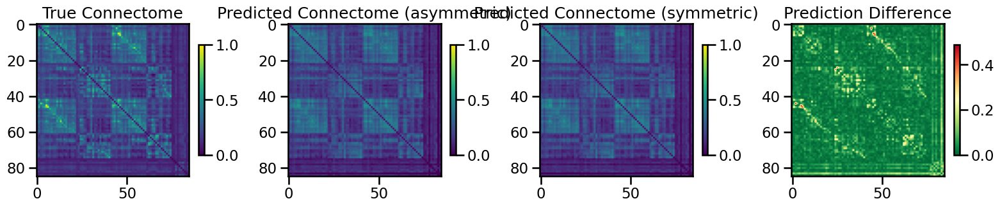

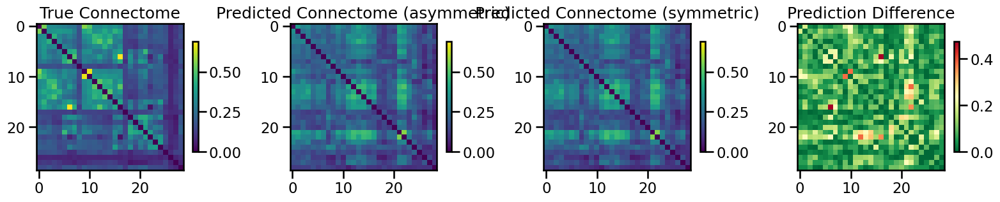

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0030677595040846037, 'mae': 0.035437243777181396, 'r2': 0.7919963365629359, 'pearson_corr': 0.9057270131792252, 'geodesic_distance': 7.612877627163171}
TEST METRICS: {'mse': 0.011774958146047041, 'mae': 0.08143666708399148, 'r2': 0.11771731840336386, 'pearson_corr': 0.4773731009382394, 'geodesic_distance': 4.856215214162377}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.18293866596550773, 'learning_rate': 7.637430175150896e-05, 'weight_decay': 0.00045510786224398303, 'batch_size': 362, 'epochs': 164, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▂▂▁▁▁▁▁▁▁▁█▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▇▃▇██▁█▇▇▃▅▇▆▇▆▇▇▇▇▇▆▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
train_mse_loss,██▆▆▆▅▅▄▄▄▄▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▂▁▁▂▃▃▃▃▄▄▄▄▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇█▇████▇▇███
best_val_loss,0
test_mse_loss,0.00435
test_pearson,0.49538
train_mse_loss,0.00462
train_pearson,0.53725


Final evaluation metrics logged successfully.
CPU Usage: 1.4%
RAM Usage: 4.4%
Available RAM: 963.2G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 3 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 90weaxm2
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/90weaxm2


wandb: Agent Starting Run: 9tp1hiik with config:
wandb: 	batch_size: 394
wandb: 	dropout_rate: 0.23821453132391016
wandb: 	epochs: 116
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.570121021798565e-05
wandb: 	weight_decay: 6.819553052158195e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/116, Train Loss: 0.0302, Val Loss: 0.0195
Epoch 10/116, Train Loss: 0.0262, Val Loss: 0.0117
Epoch 15/116, Train Loss: 0.0251, Val Loss: 0.0098
Epoch 20/116, Train Loss: 0.0209, Val Loss: 0.0097
Epoch 25/116, Train Loss: 0.0205, Val Loss: 0.0074
Epoch 30/116, Train Loss: 0.0191, Val Loss: 0.0078
Epoch 35/116, Train Loss: 0.0179, Val Loss: 0.0060
Epoch 40/116, Train Loss: 0.0167, Val Loss: 0.0053
Epoch 45/116, Train Loss: 0.0153, Val Loss: 0.0059
Epoch 50/116, Train Loss: 0.0148, Val Loss: 0.0044


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 55/116, Train Loss: 0.0142, Val Loss: 0.0057
Epoch 60/116, Train Loss: 0.0132, Val Loss: 0.0048
Epoch 65/116, Train Loss: 0.0127, Val Loss: 0.0045
Epoch 70/116, Train Loss: 0.0124, Val Loss: 0.0045
Epoch 75/116, Train Loss: 0.0114, Val Loss: 0.0042
Epoch 80/116, Train Loss: 0.0113, Val Loss: 0.0049
Epoch 85/116, Train Loss: 0.0109, Val Loss: 0.0038
Epoch 90/116, Train Loss: 0.0102, Val Loss: 0.0038
Epoch 95/116, Train Loss: 0.0099, Val Loss: 0.0038
Epoch 100/116, Train Loss: 0.0094, Val Loss: 0.0036
Epoch 105/116, Train Loss: 0.0091, Val Loss: 0.0034
Epoch 110/116, Train Loss: 0.0086, Val Loss: 0.0037
Epoch 115/116, Train Loss: 0.0092, Val Loss: 0.0037
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/116, Train Loss: 0.0292, Val Loss: 0.0195
Epoch 10/116, Train Loss: 0.0264, Val Loss: 0.0158
Epoch 15/116, Train Loss: 0.0234, Val Loss: 0.0116
Epoch 20/116, Train Loss: 0.0210, Val Loss: 0.0112
Epoch 25/116, Train Loss: 0.0199, Val Loss: 0.0209
Epoch 30

fold0_epoch,▁▁▁▁▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇█████
fold0_train_loss,██▇▆▅▅▅▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▂▂▃▄▂▂▄▄▄▃▃▂▅▅▄▄▄▄▄▄▃▆▄▃▅▃▆▄▅▄▆▄▅▆▆█▇▆
fold0_val_loss,▇▅█▃▃▃▄▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▄▂▅▂▅▃▆▇▆▅▆▅▇▆▆▄▆▆▇▇▆█▇▆▇▆▆▇▆▆▇▆▆███▇▆▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
fold1_train_loss,█▇▆▆▅▅▅▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▄▄▄▄▄▃▅▄▇▅▆▄▄▅▆▅▄▅▆▅▇▅█▅▆▆▇█▇██▇▇▆▇█▇▇█
fold1_val_loss,█▄▃▃▂▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▁▇▇▇▇▆▆▆▆▆▆▆▆▇▇▇▆█▇█▇▇▇▇▇█▇██▇███▇▇█▇██
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇██


wandb: Agent Starting Run: y8i36yoo with config:
wandb: 	batch_size: 313
wandb: 	dropout_rate: 0.23832019052662817
wandb: 	epochs: 155
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.918570448453639e-05
wandb: 	weight_decay: 0.00022311665112799916
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/155, Train Loss: 0.0350, Val Loss: 0.0254
Epoch 10/155, Train Loss: 0.0291, Val Loss: 0.0150
Epoch 15/155, Train Loss: 0.0279, Val Loss: 0.0167
Epoch 20/155, Train Loss: 0.0243, Val Loss: 0.0112
Epoch 25/155, Train Loss: 0.0231, Val Loss: 0.0108
Epoch 30/155, Train Loss: 0.0222, Val Loss: 0.0108
Epoch 35/155, Train Loss: 0.0229, Val Loss: 0.0110
Epoch 40/155, Train Loss: 0.0228, Val Loss: 0.0110
Epoch 45/155, Train Loss: 0.0222, Val Loss: 0.0107
Epoch 50/155, Train Loss: 0.0226, Val Loss: 0.0105
Epoch 55/155, Train Loss: 0.0223, Val Loss: 0.0107
Epoch 60/155, Train Loss: 0.0232, Val Loss: 0.0111
Epoch 65/155, Train Loss: 0.0221, Val Loss: 0.0102
Epoch 70/155, Train Loss: 0.0221, Val Loss: 0.0105
Epoch 75/155, Train Loss: 0.0218, Val Loss: 0.0106
Epoch 80/155, Train Loss: 0.0226, Val Loss: 0.0104
Epoch 85/155, Train Loss: 0.0229, Val Loss: 0.0107
Epoch 90/155, Train Loss: 0.0225, Val Loss: 0.0102
Epoch 95/15

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 55/155, Train Loss: 0.0256, Val Loss: 0.0161
Epoch 60/155, Train Loss: 0.0252, Val Loss: 0.0167
Epoch 65/155, Train Loss: 0.0248, Val Loss: 0.0166
Epoch 70/155, Train Loss: 0.0251, Val Loss: 0.0167
Epoch 75/155, Train Loss: 0.0255, Val Loss: 0.0167
Epoch 80/155, Train Loss: 0.0250, Val Loss: 0.0169
Epoch 85/155, Train Loss: 0.0253, Val Loss: 0.0168
Epoch 90/155, Train Loss: 0.0254, Val Loss: 0.0167
Epoch 95/155, Train Loss: 0.0253, Val Loss: 0.0171
Epoch 100/155, Train Loss: 0.0253, Val Loss: 0.0162
Epoch 105/155, Train Loss: 0.0249, Val Loss: 0.0167
Epoch 110/155, Train Loss: 0.0259, Val Loss: 0.0165
Epoch 115/155, Train Loss: 0.0251, Val Loss: 0.0161
Epoch 120/155, Train Loss: 0.0248, Val Loss: 0.0168
Epoch 125/155, Train Loss: 0.0250, Val Loss: 0.0171
Epoch 130/155, Train Loss: 0.0257, Val Loss: 0.0167
Epoch 135/155, Train Loss: 0.0251, Val Loss: 0.0164
Epoch 140/155, Train Loss: 0.0253, Val Loss: 0.0170
Epoch 145/155, Train Loss: 0.0248, Val Loss: 0.0160
Epoch 150/155, Train 

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██
fold0_train_loss,█▇▇▆▅▄▃▃▂▂▁▁▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▂▂▁▁▁▂▂▁▁
fold0_train_pearson,▂▂▁▅▄▄▅▅▅▄▄▄▄▂▄▆▅▃▁▅▄▄▇▅▄█▆▅▅▅▅▄▂▁▇▄▆▂▄▅
fold0_val_loss,▅▅█▅▄▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▂▃▃▅▁▄▅▆▇▇▇▇█▇▇█▇▇▇▇▇█▇▇██▇▇▇▇▇▇▇▇▇▇▇█▇█
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇██
fold1_train_loss,█▇▅▂▂▃▂▂▃▂▂▂▂▂▁▂▂▁▂▂▂▂▂▂▂▂▂▁▁▂▁▂▂▁▁▂▂▁▂▂
fold1_train_pearson,▄▅▁▄▄▅▇▆▅▆▅▆▆▇▇▅▆▆▇▆▅▆▆▅▆█▆▇▆▆▆▆█▇▅▆▆▆▆▆
fold1_val_loss,█▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▂▄▅▃▇▇▆▆▆▆▇▇▇██▇▇▇▇▇█▇▇▇█▇█▇▇▇█▇▇▇██▇█▇
fold2_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇███


wandb: Agent Starting Run: nt7htyua with config:
wandb: 	batch_size: 510
wandb: 	dropout_rate: 0.1251910704332142
wandb: 	epochs: 160
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.332319522808857e-05
wandb: 	weight_decay: 0.00024450641612889433
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/160, Train Loss: 0.0276, Val Loss: 0.0184
Epoch 10/160, Train Loss: 0.0248, Val Loss: 0.0090
Epoch 15/160, Train Loss: 0.0224, Val Loss: 0.0133
Epoch 20/160, Train Loss: 0.0202, Val Loss: 0.0072


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 25/160, Train Loss: 0.0196, Val Loss: 0.0170
Epoch 30/160, Train Loss: 0.0180, Val Loss: 0.0094
Epoch 35/160, Train Loss: 0.0168, Val Loss: 0.0176
Epoch 40/160, Train Loss: 0.0154, Val Loss: 0.0085
Epoch 45/160, Train Loss: 0.0149, Val Loss: 0.0065
Epoch 50/160, Train Loss: 0.0141, Val Loss: 0.0057
Epoch 55/160, Train Loss: 0.0133, Val Loss: 0.0061
Epoch 60/160, Train Loss: 0.0130, Val Loss: 0.0063
Epoch 65/160, Train Loss: 0.0129, Val Loss: 0.0054
Epoch 70/160, Train Loss: 0.0119, Val Loss: 0.0065
Epoch 75/160, Train Loss: 0.0114, Val Loss: 0.0063
Epoch 80/160, Train Loss: 0.0116, Val Loss: 0.0052
Epoch 85/160, Train Loss: 0.0108, Val Loss: 0.0049
Epoch 90/160, Train Loss: 0.0103, Val Loss: 0.0059
Epoch 95/160, Train Loss: 0.0094, Val Loss: 0.0049
Epoch 100/160, Train Loss: 0.0097, Val Loss: 0.0047
Epoch 105/160, Train Loss: 0.0092, Val Loss: 0.0049
Epoch 110/160, Train Loss: 0.0088, Val Loss: 0.0045
Epoch 115/160, Train Loss: 0.0091, Val Loss: 0.0144
Epoch 120/160, Train Loss: 

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇████
fold0_train_loss,██▇▇▇▆▆▆▅▅▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▂▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▃▃▄▅▄▄▄▅▅▄▅▅▅▅▅▆▆▅▅▅▆▅▆▅▆▆▇▇▇▆▇█▇▇▇███
fold0_val_loss,▄▂▅▅▅▃▂▃▃▄▂▁▂▂▂▂▂▁▁▂▂▂▁▁▁▁▁▁█▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▅▄▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▆▇▆▇███▆▇▅▆▇▁▄▇▃▇
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇███
fold1_train_loss,█▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▁▁▂▁▃▃▃▃▃▃▃▄▃▄▃▄▄▄▄▄▄▄▄▆▆▆▇▆▇▇████████
fold1_val_loss,█▇▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▆▇▇▇▆▇▇▇█▇▆▆▇▆▇▇▆▅▆███▇▇▁▅▇█▇██████████
fold2_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 116, 'input_dim': 21526, 'batch_size': 394, 'hidden_dims': [256, 128], 'dropout_rate': 0.23821453132391016, 'weight_decay': 6.819553052158195e-05, 'learning_rate': 7.570121021798565e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/116, Train Loss: 0.0232, Val Loss: 0.0163
Epoch 10/116, Train Loss: 0.0180, Val Loss: 0.0105
Epoch 15/116, Train Loss: 0.0157, Val Loss: 0.0080
Epoch 20/116, Train Loss: 0.0135, Val Loss: 0.0072
Epoch 25/116, Train Loss: 0.0115, Val Loss: 0.0063
Epoch 30/116, Train Loss: 0.0103, Val Loss: 0.0055
Epoch 35/116, Train Loss: 0.0091, Val Loss: 0.0056
Epoch 40/116, Train Loss: 0.0080, Val Loss: 0.0056
Epoch 45/116, Train Loss: 0.0070, Val Loss: 0.0050
Epoch 50/116, Train Loss: 0.0061, Val Loss: 0.0048
Epoch 55/116, Train Loss: 0.0057, Val Loss: 0.0047
Epoch 60/116, Train Loss: 0.0052, Val Loss: 0.0046
Epoch 65/116, Train Loss: 0.0047, Val Loss: 0.0047
Epoch 70/116, Train Loss: 0.0042, Val Loss: 0.0046
Epoch 75/116, Train Loss: 0.00

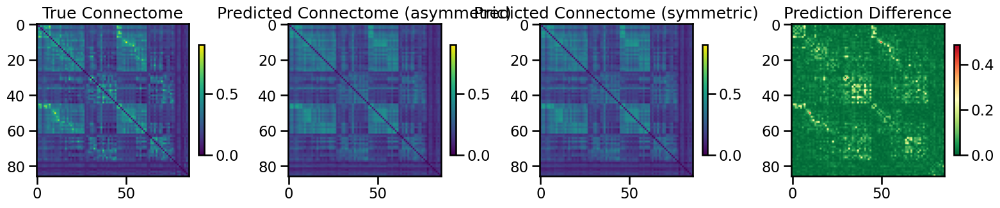

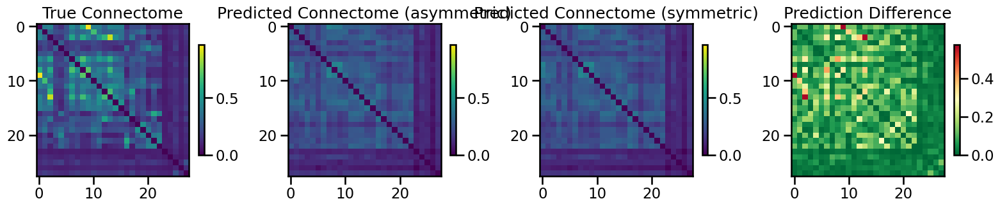

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0017183059074470982, 'mae': 0.025301852231249707, 'r2': 0.8701367818148792, 'pearson_corr': 0.9404397592151786, 'geodesic_distance': 7.700259615307568}
TEST METRICS: {'mse': 0.012584314240058236, 'mae': 0.07789430140151828, 'r2': 0.410798900943835, 'pearson_corr': 0.6695191693629482, 'geodesic_distance': 7.036580131344431}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.23821453132391016, 'learning_rate': 7.570121021798565e-05, 'weight_decay': 6.819553052158195e-05, 'batch_size': 394, 'epochs': 116, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▃▂█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▁▄▄▂▂▄▃▅▆▆▅▆▇▆▆▆▅▇▇▆▇▇▇▆▇▇▇▆▇▇▆▄████████
train_mse_loss,█▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▁▂▂▂▂▃▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▆▇▇▇█▇██████
best_val_loss,0
test_mse_loss,0.00437
test_pearson,0.6714
train_mse_loss,0.00275
train_pearson,0.65038


Final evaluation metrics logged successfully.
CPU Usage: 1.3%
RAM Usage: 4.3%
Available RAM: 963.4G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 24% |

 Test fold num: 4 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: fvhg7sfb
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/fvhg7sfb


wandb: Agent Starting Run: aen2dudi with config:
wandb: 	batch_size: 498
wandb: 	dropout_rate: 0.29757057665881737
wandb: 	epochs: 155
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.720155968133688e-05
wandb: 	weight_decay: 7.647610454300857e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/155, Train Loss: 0.0405, Val Loss: 0.0166
Epoch 10/155, Train Loss: 0.0330, Val Loss: 0.0167
Epoch 15/155, Train Loss: 0.0308, Val Loss: 0.0124
Epoch 20/155, Train Loss: 0.0288, Val Loss: 0.0118
Epoch 25/155, Train Loss: 0.0273, Val Loss: 0.0093
Epoch 30/155, Train Loss: 0.0261, Val Loss: 0.0097
Epoch 35/155, Train Loss: 0.0243, Val Loss: 0.0087
Epoch 40/155, Train Loss: 0.0229, Val Loss: 0.0062
Epoch 45/155, Train Loss: 0.0216, Val Loss: 0.0058
Epoch 50/155, Train Loss: 0.0205, Val Loss: 0.0061
Epoch 55/155, Train Loss: 0.0191, Val Loss: 0.0056
Epoch 60/155, Train Loss: 0.0186, Val Loss: 0.0050
Epoch 65/155, Train Loss: 0.0179, Val Loss: 0.0051
Epoch 70/155, Train Loss: 0.0160, Val Loss: 0.0051
Epoch 75/155, Train Loss: 0.0154, Val Loss: 0.0051
Epoch 80/155, Train Loss: 0.0143, Val Loss: 0.0050
Epoch 85/155, Train Loss: 0.0140, Val Loss: 0.0049
Epoch 90/155, Train Loss: 0.0133, Val Loss: 0.0050
Epoch 95/15

  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 45/155, Train Loss: 0.0205, Val Loss: 0.0066
Epoch 50/155, Train Loss: 0.0199, Val Loss: 0.0057
Epoch 55/155, Train Loss: 0.0190, Val Loss: 0.0052
Epoch 60/155, Train Loss: 0.0176, Val Loss: 0.0047
Epoch 65/155, Train Loss: 0.0166, Val Loss: 0.0049
Epoch 70/155, Train Loss: 0.0155, Val Loss: 0.0234
Epoch 75/155, Train Loss: 0.0147, Val Loss: 0.0051
Epoch 80/155, Train Loss: 0.0137, Val Loss: 0.0046
Epoch 85/155, Train Loss: 0.0122, Val Loss: 0.0041
Epoch 90/155, Train Loss: 0.0113, Val Loss: 0.0042
Epoch 95/155, Train Loss: 0.0111, Val Loss: 0.0040
Epoch 100/155, Train Loss: 0.0101, Val Loss: 0.0040
Epoch 105/155, Train Loss: 0.0099, Val Loss: 0.0042
Epoch 110/155, Train Loss: 0.0087, Val Loss: 0.0043
Epoch 115/155, Train Loss: 0.0090, Val Loss: 0.0041
Epoch 120/155, Train Loss: 0.0083, Val Loss: 0.0040
Epoch 125/155, Train Loss: 0.0079, Val Loss: 0.0039
Epoch 130/155, Train Loss: 0.0077, Val Loss: 0.0040
Epoch 135/155, Train Loss: 0.0079, Val Loss: 0.0041
Epoch 140/155, Train Lo

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇███
fold0_train_loss,█▇▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▂▁▄▅▄▅▆▆▅▅▆▅▆▅▆▆▇▇▆▆▆▇▇▆▇██▇██▇▆▇▇▇▇▇▇▆▇
fold0_val_loss,▇▇█▅▅▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▄▅▇▆▃▁▁▄▄▃▆▆▆▇▅▇▇█▇▇▇▇██████████████████
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇██
fold1_train_loss,█▆▆▆▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▂▃▁▃▅▃▃▄▄▅▅▄▅▅▅▄▅▅▅▆▅▆▆▄▆▅▆▇▆▇▇▅█▇▇▇▇█▇▇
fold1_val_loss,█▅▄▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▄▄▆▆▇▇▇▇▇▆▇▇▇▇▇▇█▇▅▆▇▇█▇██▇████████████
fold2_epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇██


wandb: Agent Starting Run: rv8ny3sy with config:
wandb: 	batch_size: 266
wandb: 	dropout_rate: 0.26077360366248387
wandb: 	epochs: 145
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 8.960330127235304e-05
wandb: 	weight_decay: 9.736893661676816e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/145, Train Loss: 0.0347, Val Loss: 0.0215
Epoch 10/145, Train Loss: 0.0298, Val Loss: 0.0164
Epoch 15/145, Train Loss: 0.0261, Val Loss: 0.0127
Epoch 20/145, Train Loss: 0.0227, Val Loss: 0.0091
Epoch 25/145, Train Loss: 0.0193, Val Loss: 0.0101
Epoch 30/145, Train Loss: 0.0196, Val Loss: 0.0091
Epoch 35/145, Train Loss: 0.0191, Val Loss: 0.0100
Epoch 40/145, Train Loss: 0.0197, Val Loss: 0.0096
Epoch 45/145, Train Loss: 0.0186, Val Loss: 0.0088
Epoch 50/145, Train Loss: 0.0190, Val Loss: 0.0084
Epoch 55/145, Train Loss: 0.0184, Val Loss: 0.0090
Epoch 60/145, Train Loss: 0.0178, Val Loss: 0.0091
Epoch 65/145, Train Loss: 0.0170, Val Loss: 0.0083
Epoch 70/145, Train Loss: 0.0176, Val Loss: 0.0079
Epoch 75/145, Train Loss: 0.0171, Val Loss: 0.0089
Epoch 80/145, Train Loss: 0.0163, Val Loss: 0.0079
Epoch 85/145, Train Loss: 0.0161, Val Loss: 0.0078
Epoch 90/145, Train Loss: 0.0162, Val Loss: 0.0081
Epoch 95/14

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 10/145, Train Loss: 0.0248, Val Loss: 0.0108
Epoch 15/145, Train Loss: 0.0216, Val Loss: 0.0082
Epoch 20/145, Train Loss: 0.0191, Val Loss: 0.0064
Epoch 25/145, Train Loss: 0.0171, Val Loss: 0.0067
Epoch 30/145, Train Loss: 0.0144, Val Loss: 0.0049
Epoch 35/145, Train Loss: 0.0128, Val Loss: 0.0047
Epoch 40/145, Train Loss: 0.0118, Val Loss: 0.0044
Epoch 45/145, Train Loss: 0.0103, Val Loss: 0.0042
Epoch 50/145, Train Loss: 0.0089, Val Loss: 0.0047
Epoch 55/145, Train Loss: 0.0084, Val Loss: 0.0036
Epoch 60/145, Train Loss: 0.0073, Val Loss: 0.0040
Epoch 65/145, Train Loss: 0.0069, Val Loss: 0.0038
Epoch 70/145, Train Loss: 0.0064, Val Loss: 0.0032
Epoch 75/145, Train Loss: 0.0063, Val Loss: 0.0038
Epoch 80/145, Train Loss: 0.0057, Val Loss: 0.0036
Epoch 85/145, Train Loss: 0.0055, Val Loss: 0.0044
Epoch 90/145, Train Loss: 0.0053, Val Loss: 0.0044
Epoch 95/145, Train Loss: 0.0057, Val Loss: 0.0034
Epoch 100/145, Train Loss: 0.0053, Val Loss: 0.0035
Epoch 105/145, Train Loss: 0.0

fold0_epoch,▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇██
fold0_train_loss,█▇▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▂▃▆▆▅▅▆▇▅▅▄▆▅▆▆▅▆▇▇▅▇▅▇▄▇▆▆▆▅▇▆▅▆▅██▆▆
fold0_val_loss,█▃▃▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▁▁▁▁▂▂▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▃▄▁▂▃▄▄▄▄▄▄▄▅▄▃▇▂▂▃▆▅▄▆▆▅▄▇▇▅▅█▆▅▅█▃▇▅▄▅
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇███
fold1_train_loss,█▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▂▂▁▃▂▂▃▂▃▃▂▃▃▃▃▃▄▃▃▃▄▄▃▅▅▅▅▅█▅▆▇▇▆▆▆▆▇▇▆
fold1_val_loss,█▅▅▄▃▃▃▂▂▂▂▂▁▁▂▁▁▂▁▁▁▂▁▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁
fold1_val_pearson,▃▄▅▆▁▅▆▅▅▆▆▇▇▇█▇▇██▇▆▆▇█▇▆▆▇██▇▇█▇█▇▇█▆▇
fold2_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇████


wandb: Agent Starting Run: 9wpqem6p with config:
wandb: 	batch_size: 269
wandb: 	dropout_rate: 0.2782528896179901
wandb: 	epochs: 110
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 8.772208524250752e-05
wandb: 	weight_decay: 7.588526887579485e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/110, Train Loss: 0.0338, Val Loss: 0.0117
Epoch 10/110, Train Loss: 0.0286, Val Loss: 0.0108
Epoch 15/110, Train Loss: 0.0247, Val Loss: 0.0085
Epoch 20/110, Train Loss: 0.0212, Val Loss: 0.0081
Epoch 25/110, Train Loss: 0.0187, Val Loss: 0.0061
Epoch 30/110, Train Loss: 0.0168, Val Loss: 0.0069
Epoch 35/110, Train Loss: 0.0150, Val Loss: 0.0051
Epoch 40/110, Train Loss: 0.0131, Val Loss: 0.0052
Epoch 45/110, Train Loss: 0.0120, Val Loss: 0.0064
Epoch 50/110, Train Loss: 0.0104, Val Loss: 0.0053
Epoch 55/110, Train Loss: 0.0092, Val Loss: 0.0044
Epoch 60/110, Train Loss: 0.0093, Val Loss: 0.0067
Epoch 65/110, Train Loss: 0.0092, Val Loss: 0.0044
Epoch 70/110, Train Loss: 0.0088, Val Loss: 0.0058


  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 75/110, Train Loss: 0.0087, Val Loss: 0.0055
Epoch 80/110, Train Loss: 0.0086, Val Loss: 0.0050
Epoch 85/110, Train Loss: 0.0086, Val Loss: 0.0050
Epoch 90/110, Train Loss: 0.0085, Val Loss: 0.0063
Epoch 95/110, Train Loss: 0.0082, Val Loss: 0.0046
Epoch 100/110, Train Loss: 0.0088, Val Loss: 0.0049
Epoch 105/110, Train Loss: 0.0089, Val Loss: 0.0060
Epoch 110/110, Train Loss: 0.0089, Val Loss: 0.0070
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/110, Train Loss: 0.0322, Val Loss: 0.0079
Epoch 10/110, Train Loss: 0.0276, Val Loss: 0.0075
Epoch 15/110, Train Loss: 0.0235, Val Loss: 0.0069
Epoch 20/110, Train Loss: 0.0212, Val Loss: 0.0060
Epoch 25/110, Train Loss: 0.0188, Val Loss: 0.0046
Epoch 30/110, Train Loss: 0.0170, Val Loss: 0.0040
Epoch 35/110, Train Loss: 0.0151, Val Loss: 0.0052
Epoch 40/110, Train Loss: 0.0139, Val Loss: 0.0051
Epoch 45/110, Train Loss: 0.0121, Val Loss: 0.0054
Epoch 50/110, Train Loss: 0.0116, Val Loss: 0.0059
Epoch 55

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 60/110, Train Loss: 0.0069, Val Loss: 0.0050
Epoch 65/110, Train Loss: 0.0065, Val Loss: 0.0047
Epoch 70/110, Train Loss: 0.0057, Val Loss: 0.0048
Epoch 75/110, Train Loss: 0.0052, Val Loss: 0.0046
Epoch 80/110, Train Loss: 0.0051, Val Loss: 0.0049
Epoch 85/110, Train Loss: 0.0050, Val Loss: 0.0052
Epoch 90/110, Train Loss: 0.0046, Val Loss: 0.0049
Epoch 95/110, Train Loss: 0.0047, Val Loss: 0.0050
Epoch 100/110, Train Loss: 0.0039, Val Loss: 0.0050
Epoch 105/110, Train Loss: 0.0046, Val Loss: 0.0052
Epoch 110/110, Train Loss: 0.0048, Val Loss: 0.0050


fold0_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,█▆▆▅▅▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▄▅▄▅▅▄▆▅▅▆▅▆▆▆▅▆▆▆▇▇██▆█▆▇▇▆▇▇▇▇▆█▇▇▇
fold0_val_loss,▄█▅▆▃▃▃▂▃▂▂▂▂▁▁▁▂▁▂▂▁▁▁▂▂▁▁▁▂▁▁▁▁▂▂▁▂▁▁▂
fold0_val_pearson,▁▆▂▆▇▃▅▃▅▄▅▅▄▇▂▅▆▇▁▄█▇▆▆▅█▆▄▆▆▄▆▆▇█▄▆▆▆█
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,█▇▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▂▁▂▂▂▁▂▂▃▂▃▃▂▃▃▄▂▄▄▅▅▄▄▅▅▆▆▅▅▆▆▆▆█▇██▇▇▇
fold1_val_loss,█▆▅▆▄▃▄▃▄▄▂▃▂▂▃▃▂▂▂▂▂▃▃▂▂▁▂▂▁▂▁▁▂▂▂▂▁▂▁▂
fold1_val_pearson,▅▃▆▃▅▃▆▁▆▇█▇▆▃▆▅▆▆▅▇█▇▃▇▇▆▇▇▆██▆█▅▅▇▆█▄█
fold2_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 110, 'input_dim': 21526, 'batch_size': 269, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.2782528896179901, 'weight_decay': 7.588526887579485e-05, 'learning_rate': 8.772208524250752e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/110, Train Loss: 0.0279, Val Loss: 0.0159
Epoch 10/110, Train Loss: 0.0212, Val Loss: 0.0098
Epoch 15/110, Train Loss: 0.0160, Val Loss: 0.0064
Epoch 20/110, Train Loss: 0.0134, Val Loss: 0.0063
Epoch 25/110, Train Loss: 0.0107, Val Loss: 0.0051
Epoch 30/110, Train Loss: 0.0087, Val Loss: 0.0050
Epoch 35/110, Train Loss: 0.0075, Val Loss: 0.0054
Epoch 40/110, Train Loss: 0.0065, Val Loss: 0.0048
Epoch 45/110, Train Loss: 0.0055, Val Loss: 0.0048
Epoch 50/110, Train Loss: 0.0050, Val Loss: 0.0049
Epoch 55/110, Train Loss: 0.0044, Val Loss: 0.0053
Epoch 60/110, Train Loss: 0.0042, Val Loss: 0.0047
Epoch 65/110, Train Loss: 0.0038, Val Loss: 0.0049
Epoch 70/110, Train Loss: 0.0038, Val Loss: 0.0048
Epoch 75/110, Train Loss:

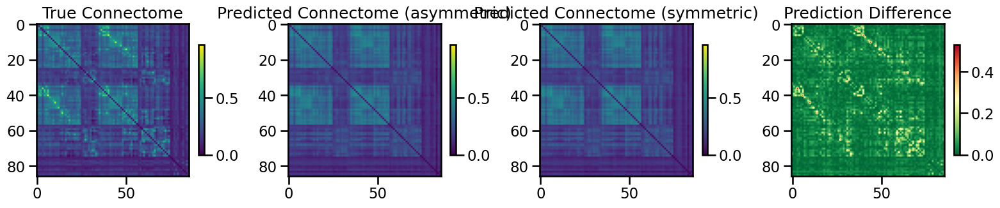

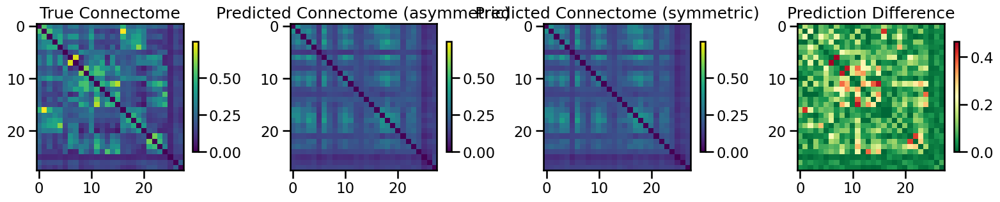

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0031956485424736456, 'mae': 0.03621669794731868, 'r2': 0.7789376162240964, 'pearson_corr': 0.888438424748395, 'geodesic_distance': 9.602666440878766}
TEST METRICS: {'mse': 0.014055715490284778, 'mae': 0.08285856527795288, 'r2': 0.0916838792164617, 'pearson_corr': 0.44568802540011343, 'geodesic_distance': 6.9868294311209596}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.2782528896179901, 'learning_rate': 8.772208524250752e-05, 'weight_decay': 7.588526887579485e-05, 'batch_size': 269, 'epochs': 110, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▅█▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▁▅▇███████████████████▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇
train_mse_loss,█▇▆▆▅▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▁▂▂▂▂▃▃▃▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇███▇███████████
best_val_loss,0
test_mse_loss,0.00483
test_pearson,0.44933
train_mse_loss,0.00355
train_pearson,0.60186


Final evaluation metrics logged successfully.
CPU Usage: 5.3%
RAM Usage: 7.4%
Available RAM: 932.1G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 24% |


  gc.collect()



Running simulation with: dynamic_mlp, random, S100, SC, seed=2
Number of components for 95% variance PCA: 34
X shape: (114, 10760)
X_pca shape: (114, 34)
Y_sc shape: (114, 114)
Y_sc_spectralL shape: (114, 113)
Y_sc_spectralA shape: (114, 114)
Y_fc shape: (114, 114)
Coordinates shape: (114, 3)
Y shape (114, 114)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (114, 10763)

 Test fold num: 1 X_train shape: (7140, 21526) Y_train shape: (7140,) X_test shape: (812, 21526) Y_test shape: (812,)
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: ab4ieds8
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/ab4ieds8


wandb: Agent Starting Run: dp8lja1t with config:
wandb: 	batch_size: 336
wandb: 	dropout_rate: 0.1107382432944878
wandb: 	epochs: 116
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.8088630773908146e-05
wandb: 	weight_decay: 0.000372080918769634
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/116, Train Loss: 0.2158, Val Loss: 0.1676
Epoch 10/116, Train Loss: 0.2089, Val Loss: 0.1449
Epoch 15/116, Train Loss: 0.2065, Val Loss: 0.1467
Epoch 20/116, Train Loss: 0.2084, Val Loss: 0.1483
Epoch 25/116, Train Loss: 0.2023, Val Loss: 0.1396
Epoch 30/116, Train Loss: 0.2043, Val Loss: 0.1447
Epoch 35/116, Train Loss: 0.2009, Val Loss: 0.1333
Epoch 40/116, Train Loss: 0.2048, Val Loss: 0.1517
Epoch 45/116, Train Loss: 0.2026, Val Loss: 0.1462
Epoch 50/116, Train Loss: 0.2059, Val Loss: 0.1450
Epoch 55/116, Train Loss: 0.2010, Val Loss: 0.1496
Epoch 60/116, Train Loss: 0.2042, Val Loss: 0.1434
Epoch 65/116, Train Loss: 0.1997, Val Loss: 0.1478
Epoch 70/116, Train Loss: 0.2040, Val Loss: 0.1468
Epoch 75/116, Train Loss: 0.2043, Val Loss: 0.1455
Epoch 80/116, Train Loss: 0.1974, Val Loss: 0.1436
Epoch 85/116, Train Loss: 0.2010, Val Loss: 0.1545
Epoch 90/116, Train Loss: 0.2096, Val Loss: 0.1483
Epoch 95/11

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 5/116, Train Loss: 0.1787, Val Loss: 0.2563
Epoch 10/116, Train Loss: 0.1726, Val Loss: 0.2423
Epoch 15/116, Train Loss: 0.1709, Val Loss: 0.2475
Epoch 20/116, Train Loss: 0.1691, Val Loss: 0.2482
Epoch 25/116, Train Loss: 0.1672, Val Loss: 0.2525
Epoch 30/116, Train Loss: 0.1650, Val Loss: 0.2393
Epoch 35/116, Train Loss: 0.1657, Val Loss: 0.2323
Epoch 40/116, Train Loss: 0.1616, Val Loss: 0.2339
Epoch 45/116, Train Loss: 0.1598, Val Loss: 0.2326
Epoch 50/116, Train Loss: 0.1617, Val Loss: 0.2305
Epoch 55/116, Train Loss: 0.1577, Val Loss: 0.2475
Epoch 60/116, Train Loss: 0.1556, Val Loss: 0.2219
Epoch 65/116, Train Loss: 0.1565, Val Loss: 0.2409
Epoch 70/116, Train Loss: 0.1553, Val Loss: 0.2292
Epoch 75/116, Train Loss: 0.1537, Val Loss: 0.2426
Epoch 80/116, Train Loss: 0.1551, Val Loss: 0.2362
Epoch 85/116, Train Loss: 0.1552, Val Loss: 0.2388
Epoch 90/116, Train Loss: 0.1520, Val Loss: 0.2422
Epoch 95/116, Train Loss: 0.1519, Val Loss: 0.2340
Epoch 100/116, Train Loss: 0.152

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇█
fold0_train_loss,██▆▇█▂▄▅▃▃▄▃▄▂▃▃▄▄▃▃▄▂▂▅▄▄▂▆▃▁▁▄▆▂▃▂▁▃▁▃
fold0_train_pearson,▁▅▆▅▆▆▆▇▇▆▇▇▇▇█▇▇█▇▇███▇█████▇▇████▇█▇▇█
fold0_val_loss,▃▆▇█▆█▃▄▂▃▂▄▄█▅▄▄▁▃▇▂▄▄▅▄▆▂▄▃▄▆█▃▄▅▅▁▅▄▃
fold0_val_pearson,▂█▅▃▆▆▆▃▃▃▅▄▅▄▃▄▄▄▅▃▂▃▂▁▂▃▄▃▃▄▃▃▃▃▂▃▃▄▁▃
fold1_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
fold1_train_loss,█▇▆▅▆▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▂▁▁▁▁
fold1_train_pearson,▁▂▂▃▃▄▅▅▅▅▅▅▆▆▅▆▆▆▇▇▇▇▇▇▇▇▇▇▇█████████▇▇
fold1_val_loss,█▆▅▃▄▆▄▂▅▄▄▂▃▅▄▄▄▅▃▂▄▄▄▄▄▃▅▂▅▁▄▃▁▅▃▄▃▄▃▅
fold1_val_pearson,▁▁▇▆▆▅▅▆▇▆▅▇▆▆▅▆▇▇▆▇█▇▇▆▇▇▇▇▇▇▇▆▅▇▇▇▇▆▇▇
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇████


wandb: Agent Starting Run: nlkotn55 with config:
wandb: 	batch_size: 463
wandb: 	dropout_rate: 0.16905902717300664
wandb: 	epochs: 175
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.153057401809903e-05
wandb: 	weight_decay: 7.498927375953076e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/175, Train Loss: 0.2102, Val Loss: 0.1613
Epoch 10/175, Train Loss: 0.2072, Val Loss: 0.1514
Epoch 15/175, Train Loss: 0.2031, Val Loss: 0.1488
Epoch 20/175, Train Loss: 0.2021, Val Loss: 0.1487
Epoch 25/175, Train Loss: 0.2012, Val Loss: 0.1513
Epoch 30/175, Train Loss: 0.2014, Val Loss: 0.1491
Epoch 35/175, Train Loss: 0.1991, Val Loss: 0.1491
Epoch 40/175, Train Loss: 0.2009, Val Loss: 0.1474
Epoch 45/175, Train Loss: 0.1992, Val Loss: 0.1469
Epoch 50/175, Train Loss: 0.1995, Val Loss: 0.1501


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 55/175, Train Loss: 0.1984, Val Loss: 0.1496
Epoch 60/175, Train Loss: 0.1990, Val Loss: 0.1488
Epoch 65/175, Train Loss: 0.1988, Val Loss: 0.1526
Epoch 70/175, Train Loss: 0.2004, Val Loss: 0.1490
Epoch 75/175, Train Loss: 0.1990, Val Loss: 0.1520
Epoch 80/175, Train Loss: 0.1985, Val Loss: 0.1482
Epoch 85/175, Train Loss: 0.2017, Val Loss: 0.1510
Epoch 90/175, Train Loss: 0.1988, Val Loss: 0.1506
Epoch 95/175, Train Loss: 0.1982, Val Loss: 0.1503
Epoch 100/175, Train Loss: 0.1992, Val Loss: 0.1506
Epoch 105/175, Train Loss: 0.2007, Val Loss: 0.1499
Epoch 110/175, Train Loss: 0.1991, Val Loss: 0.1503
Epoch 115/175, Train Loss: 0.1989, Val Loss: 0.1509
Epoch 120/175, Train Loss: 0.1996, Val Loss: 0.1502
Epoch 125/175, Train Loss: 0.1986, Val Loss: 0.1495
Epoch 130/175, Train Loss: 0.2003, Val Loss: 0.1497
Epoch 135/175, Train Loss: 0.1997, Val Loss: 0.1520
Epoch 140/175, Train Loss: 0.1998, Val Loss: 0.1534
Epoch 145/175, Train Loss: 0.1975, Val Loss: 0.1505
Epoch 150/175, Train 

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▇▇▇▇▇▇▇▇██
fold0_train_loss,█▇▆▄▃▄▃▃▄▂▃▃▂▂▃▂▂▂▃▁▂▃▂▂▂▂▃▂▂▂▁▁▁▁▂▂▁▃▃▂
fold0_train_pearson,▁▃▄▅▆▆▇▇▇▇▇▇▇█▇█▇▇▇▇█▇█▇▇██▇▇▇▇▇▇▇▇▇██▇█
fold0_val_loss,█▂▂▂▂▃▂▂▂▃▃▂▂▃▃▂▃▂▄▂▃▁▃▃▃▃▂▃▂▃▃▄▄▄▃▃▂▃▂▃
fold0_val_pearson,▁▃███▆▆▆▅▆▆▆▆▆▆▆▆▆▆▇▆▆▆▆▆▆▆▆▇▆▆▆▆▆▆▆▆▆▆▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇▇██
fold1_train_loss,█▆▅▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▂▂▂▂▂▂▂▂▁▂▂▂▁▁▂▁▁
fold1_train_pearson,▁▂▃▃▁▅▅▅▆▆▇▇▆▇▇▇█▇▇▇▇██▆▇▇▇▇▇█▆▇▇▇▇███▇▇
fold1_val_loss,▅▇█▄▅▄▃▃▂▄▂▂▂▃▃▅▂▃▁▃▄▂▂▂▄▄▃▄▄▃▅▂▄▃▂▄▂▂▄▂
fold1_val_pearson,▁▂███▇███▇██▇██████████████████████▇████
fold2_epoch,▁▁▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 608471zq with config:
wandb: 	batch_size: 395
wandb: 	dropout_rate: 0.19571206984930356
wandb: 	epochs: 128
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.192570289527291e-05
wandb: 	weight_decay: 0.00028712305875004803
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/128, Train Loss: 0.2211, Val Loss: 0.1537
Epoch 10/128, Train Loss: 0.2172, Val Loss: 0.1579
Epoch 15/128, Train Loss: 0.2160, Val Loss: 0.1557
Epoch 20/128, Train Loss: 0.2140, Val Loss: 0.1386
Epoch 25/128, Train Loss: 0.2121, Val Loss: 0.1290
Epoch 30/128, Train Loss: 0.2112, Val Loss: 0.1567


  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 35/128, Train Loss: 0.2086, Val Loss: 0.1164
Epoch 40/128, Train Loss: 0.2099, Val Loss: 0.1476
Epoch 45/128, Train Loss: 0.2103, Val Loss: 0.1256
Epoch 50/128, Train Loss: 0.2103, Val Loss: 0.1085
Epoch 55/128, Train Loss: 0.2091, Val Loss: 0.1409
Epoch 60/128, Train Loss: 0.2094, Val Loss: 0.1735
Epoch 65/128, Train Loss: 0.2095, Val Loss: 0.1118


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 70/128, Train Loss: 0.2093, Val Loss: 0.1379
Epoch 75/128, Train Loss: 0.2094, Val Loss: 0.1517
Epoch 80/128, Train Loss: 0.2100, Val Loss: 0.1327
Epoch 85/128, Train Loss: 0.2100, Val Loss: 0.1435
Epoch 90/128, Train Loss: 0.2095, Val Loss: 0.1503
Epoch 95/128, Train Loss: 0.2080, Val Loss: 0.1422
Epoch 100/128, Train Loss: 0.2092, Val Loss: 0.1860
Epoch 105/128, Train Loss: 0.2113, Val Loss: 0.1461
Epoch 110/128, Train Loss: 0.2077, Val Loss: 0.1578
Epoch 115/128, Train Loss: 0.2097, Val Loss: 0.1139
Epoch 120/128, Train Loss: 0.2085, Val Loss: 0.1499
Epoch 125/128, Train Loss: 0.2098, Val Loss: 0.1291
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/128, Train Loss: 0.1872, Val Loss: 0.2452
Epoch 10/128, Train Loss: 0.1776, Val Loss: 0.2417
Epoch 15/128, Train Loss: 0.1812, Val Loss: 0.2402
Epoch 20/128, Train Loss: 0.1732, Val Loss: 0.2421
Epoch 25/128, Train Loss: 0.1672, Val Loss: 0.2416
Epoch 30/128, Train Loss: 0.1756, Val Loss: 0.2429
Epoch

fold0_epoch,▁▁▁▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▆▆▅▄▄▄▃▃▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▅▄▅▆█▇▇▇▆▇▇▇▇█▇███▇█▇▇█▇█▇▇▇▇█▇█▇▇▇█▇▇
fold0_val_loss,▃▃▅█▅▃▄▂▅▁▄▃▄▄▄▄▃▂▂▆▄▁▃▆▅▃▆▃▅▆▂▄▅▆▄▁▄▃▄▂
fold0_val_pearson,▁▃▄▆█▁▇█▆▆▄▅▄██▆▆▅▄▆▆▅▅▇▅▆▇▆▅▇▆▅█▄▄▇▅▇▅▇
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇████
fold1_train_loss,▇▅▇█▄▅▅▄▄▄▅▃▆▃▂▄▃▃▃▄▃▄▃▃▂▁▄▃▂▄▃▂▃▂▂▆▂▃▄▂
fold1_train_pearson,▁▃▄▅▅▅▆▆▅▆▆▇▆▆▇▆▇▇▇█▆▇▇▇▇▆▇▇▇▇▆▆▆▇▅▆▇▇▅▆
fold1_val_loss,█▂▂▃▁▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▂
fold1_val_pearson,▁▁▇▆▆▆▆███▇█▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇
fold2_epoch,▁▁▁▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇███


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 116, 'input_dim': 21526, 'batch_size': 336, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.1107382432944878, 'weight_decay': 0.000372080918769634, 'learning_rate': 5.8088630773908146e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/116, Train Loss: 0.1829, Val Loss: 0.2297
Epoch 10/116, Train Loss: 0.1777, Val Loss: 0.2226
Epoch 15/116, Train Loss: 0.1753, Val Loss: 0.2277
Epoch 20/116, Train Loss: 0.1719, Val Loss: 0.2249
Epoch 25/116, Train Loss: 0.1717, Val Loss: 0.2213
Epoch 30/116, Train Loss: 0.1710, Val Loss: 0.2324
Epoch 35/116, Train Loss: 0.1659, Val Loss: 0.2222
Epoch 40/116, Train Loss: 0.1645, Val Loss: 0.2195
Epoch 45/116, Train Loss: 0.1608, Val Loss: 0.2229
Epoch 50/116, Train Loss: 0.1574, Val Loss: 0.2220
Epoch 55/116, Train Loss: 0.1527, Val Loss: 0.2180
Epoch 60/116, Train Loss: 0.1481, Val Loss: 0.2108
Epoch 65/116, Train Loss: 0.1412, Val Loss: 0.2137
Epoch 70/116, Train Loss: 0.1337, Val Loss: 0.2059
Epoch 75/116, Train Loss:

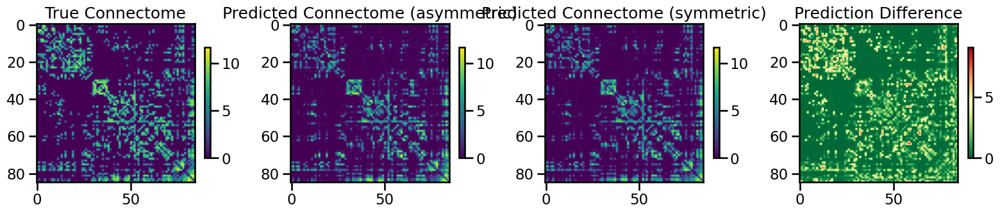

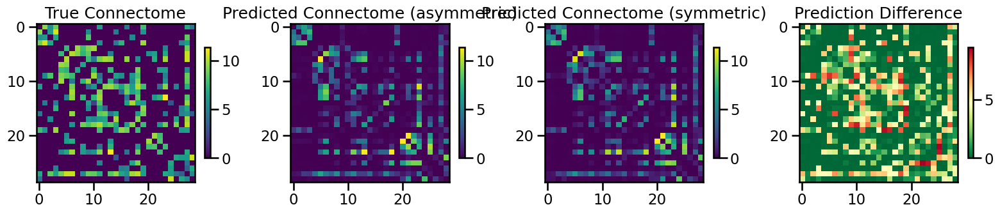

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 3.418821656557032, 'mae': 0.8892547382225059, 'r2': 0.6656012892007765, 'pearson_corr': 0.8374546227224487, 'geodesic_distance': 9.81129121883665}
TEST METRICS: {'mse': 9.86047586289974, 'mae': 1.8155848358438007, 'r2': 0.2076893315915631, 'pearson_corr': 0.5702861032483737, 'geodesic_distance': 8.752290534772484}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.1107382432944878, 'learning_rate': 5.8088630773908146e-05, 'weight_decay': 0.000372080918769634, 'batch_size': 336, 'epochs': 116, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▇▆▆▆▆▆▆▆▇▅▅▆▆▅▄▅▆▅▆▅▅▅▄▅▃▄▂▇▂▁▂▂▁▄▂▁▁▁
test_pearson,▁▃▅▃▄▄▃▂▅▃▃▂▃▄▃▃▃▂▃▅▄▅▅▃▅▄▅▆▄▆▇▆▇▇█▃▇▆▆█
train_mse_loss,█████▇▇▇▇▇▇▇▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▃▃▂▂▂▂▂▁▂▁▁
train_pearson,▁▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇███████
best_val_loss,0
test_mse_loss,0.18107
test_pearson,0.56123
train_mse_loss,0.09371
train_pearson,0.82694


Final evaluation metrics logged successfully.
CPU Usage: 7.1%
RAM Usage: 7.4%
Available RAM: 932.3G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 2 X_train shape: (7140, 21526) Y_train shape: (7140,) X_test shape: (812, 21526) Y_test shape: (812,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: c23dpj2p
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/c23dpj2p


wandb: Agent Starting Run: kic6g3xo with config:
wandb: 	batch_size: 393
wandb: 	dropout_rate: 0.2131197332322447
wandb: 	epochs: 113
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 8.01886829036736e-05
wandb: 	weight_decay: 0.00010740095847141082
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/113, Train Loss: 0.2170, Val Loss: 0.2663
Epoch 10/113, Train Loss: 0.2132, Val Loss: 0.2363
Epoch 15/113, Train Loss: 0.2094, Val Loss: 0.2493
Epoch 20/113, Train Loss: 0.2081, Val Loss: 0.2554
Epoch 25/113, Train Loss: 0.2061, Val Loss: 0.2592
Epoch 30/113, Train Loss: 0.2041, Val Loss: 0.2400
Epoch 35/113, Train Loss: 0.2029, Val Loss: 0.2332
Epoch 40/113, Train Loss: 0.2019, Val Loss: 0.2034
Epoch 45/113, Train Loss: 0.2022, Val Loss: 0.2120
Epoch 50/113, Train Loss: 0.2026, Val Loss: 0.2086
Epoch 55/113, Train Loss: 0.2013, Val Loss: 0.2180
Epoch 60/113, Train Loss: 0.2007, Val Loss: 0.2494
Epoch 65/113, Train Loss: 0.2016, Val Loss: 0.2695
Epoch 70/113, Train Loss: 0.2016, Val Loss: 0.2494
Epoch 75/113, Train Loss: 0.2016, Val Loss: 0.2293
Epoch 80/113, Train Loss: 0.2005, Val Loss: 0.2420
Epoch 85/113, Train Loss: 0.2010, Val Loss: 0.2435
Epoch 90/113, Train Loss: 0.2014, Val Loss: 0.2186
Epoch 95/11

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.

  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/113, Train Loss: 0.2347, Val Loss: 0.2486
Epoch 10/113, Train Loss: 0.2203, Val Loss: 0.2461
Epoch 15/113, Train Loss: 0.2269, Val Loss: 0.2529
Epoch 20/113, Train Loss: 0.2218, Val Loss: 0.2496
Epoch 25/113, Train Loss: 0.2207, Val Loss: 0.2525
Epoch 30/113, Train Loss: 0.2205, Val Loss: 0.2522
Epoch 35/113, Train Loss: 0.2229, Val Loss: 0.2520
Epoch 40/113, Train Loss: 0.2130, Val Loss: 0.2513
Epoch 45/113, Train Loss: 0.2225, Val Loss: 0.2511
Epoch 50/113, Train Loss: 0.2139, Val Loss: 0.2504
Epoch 55/113, Train Loss: 0.2143, Val Loss: 0.2527
Epoch 60/113, Train Loss: 0.2192, Val Loss: 0.2522
Epoch 65/113, Train Loss: 0.2183, Val Loss: 0.2517
Epoch 70/113, Train Loss: 0.2139, Val Loss: 0.2516
Epoch 75/113, Train Loss: 0.2202, Val Loss: 0.2519
Epoch 80/113, Train Loss: 0.2239, Val Loss: 0.2510
Epoch 85/113, Train Loss: 0.2297, Val Loss: 0.2528
Epoch 90/113, Train Loss: 0.2155, Val Loss: 0.2527
Epoch 95/11

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▇▆▅▅▄▃▃▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▄▆▆▅▅▆▆▆▆▇▇▇▇█▇▇▇▇███▇▇██████▇▇████████
fold0_val_loss,▅▄▅▆▄▅▄▃▃▆▃▃▃▇▇▄▅▃▂▃▃▄▅▇▅▇▄▄▄▄▄▅▁▃█▄▃▅▃▆
fold0_val_pearson,▂▃▄▄▅▅▄▅▅▃▄▆▅▄█▆▇▃▄▆▃▂▆▆▅▇▃▃▂▃▅▁▁▅▅▅▄▆▄▅
fold1_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇█
fold1_train_loss,▇█▅▅▆▂▃▄▃▄▄▂▃▂▂▁▃▂▃▃▅▂▃▂▃▃▂▁▂▅▃▄▂▂▃▃▂▂▄▃
fold1_train_pearson,▁▄▄▅▅▅▆▅▆▆▇▇▇▆▆▆▆▆▇▇▇▇▇█▇▇▆▇▇▇▇▇▇▆▆▇█▇▇▇
fold1_val_loss,▁▂▁█▄▄▂▅▅▅▃▃▃▄▃▃▄▄▃▄▄▄▃▄▄▃▄▃▄▄▄▄▄▄▄▄▃▃▃▅
fold1_val_pearson,▁▅▆█▇▆███▇█▇▇█▇▇▇███▇█▇▇▇█▇▇██▇▇█▇▇▇▇█▇█
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▆▆▆▇▇▇▇▇▇▇█████


wandb: Agent Starting Run: 54ecpcug with config:
wandb: 	batch_size: 510
wandb: 	dropout_rate: 0.2892331556490326
wandb: 	epochs: 146
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.906936498311106e-05
wandb: 	weight_decay: 8.060335479214559e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/146, Train Loss: 0.2104, Val Loss: 0.2875
Epoch 10/146, Train Loss: 0.2267, Val Loss: 0.2372
Epoch 15/146, Train Loss: 0.2059, Val Loss: 0.2290
Epoch 20/146, Train Loss: 0.2041, Val Loss: 0.2329
Epoch 25/146, Train Loss: 0.2094, Val Loss: 0.2303
Epoch 30/146, Train Loss: 0.2002, Val Loss: 0.2234
Epoch 35/146, Train Loss: 0.2006, Val Loss: 0.2282
Epoch 40/146, Train Loss: 0.1995, Val Loss: 0.2255
Epoch 45/146, Train Loss: 0.2209, Val Loss: 0.2227
Epoch 50/146, Train Loss: 0.2078, Val Loss: 0.2277
Epoch 55/146, Train Loss: 0.1996, Val Loss: 0.2260


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 60/146, Train Loss: 0.1999, Val Loss: 0.2236
Epoch 65/146, Train Loss: 0.1967, Val Loss: 0.2276
Epoch 70/146, Train Loss: 0.2274, Val Loss: 0.2324
Epoch 75/146, Train Loss: 0.1896, Val Loss: 0.2274
Epoch 80/146, Train Loss: 0.2031, Val Loss: 0.2200
Epoch 85/146, Train Loss: 0.2023, Val Loss: 0.2255
Epoch 90/146, Train Loss: 0.2240, Val Loss: 0.2250
Epoch 95/146, Train Loss: 0.2097, Val Loss: 0.2227
Epoch 100/146, Train Loss: 0.2009, Val Loss: 0.2300
Epoch 105/146, Train Loss: 0.2163, Val Loss: 0.2335
Epoch 110/146, Train Loss: 0.2071, Val Loss: 0.2275
Epoch 115/146, Train Loss: 0.2128, Val Loss: 0.2288
Epoch 120/146, Train Loss: 0.2046, Val Loss: 0.2266
Epoch 125/146, Train Loss: 0.1994, Val Loss: 0.2202
Epoch 130/146, Train Loss: 0.2117, Val Loss: 0.2264
Epoch 135/146, Train Loss: 0.2207, Val Loss: 0.2274
Epoch 140/146, Train Loss: 0.1940, Val Loss: 0.2259
Epoch 145/146, Train Loss: 0.1987, Val Loss: 0.2302
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
E

fold0_epoch,▁▁▁▁▁▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇███
fold0_train_loss,█▆▅▇▁▆▃▅▄▅▆▅▆▄▄▄▇▂▆▃▄▁▃█▄▆▃▁▃▇▃▃▇▅▃▆▅▅▂▂
fold0_train_pearson,▁▅▄▃▂▃▃▅▅▄▇▃▆▅▄▇█▇▇▆▆▆▆▇▅▅▄▆▆▆▅▆▆▆▆▅▆▆▇▅
fold0_val_loss,▆█▅▃▄▂▂▂▂▁▃▂▂▁▂▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▃▂▂
fold0_val_pearson,▁▃▅▇▆▅▅▆▇█▇▇▇█▇▇▇██▇▇▇▇█▇█▇▇▇▇███▇▇▇█▇▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇████
fold1_train_loss,█▅▅▅▄▆▃▄▄▄▄▃▄▄▅▂▃▃▂▃▂▃▂▂▃▂▃▂▂▃▃▄▁▃▂▂▂▂▂▂
fold1_train_pearson,▁▃▅▃▄▅▄▃▄▄▅▅▅▆▇▆▆▇▆▆▇█▅▇▇▇▇▇▇▇▇▆▆█▇▇▇▇▇▇
fold1_val_loss,█▃▃▂▂▂▂▂▃▂▂▁▂▂▂▂▂▂▁▂▂▂▂▁▃▁▂▂▂▁▂▂▂▁▃▂▂▂▂▂
fold1_val_pearson,▇▇▇▁▆▆▃▄▆▅▅▄▃▆▃▂▅▅▆▅▃▆▄▄▆▅▅▅▅▅▄▅▄█▅▂▆▆▅▅
fold2_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▄▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇███


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 62tffoxs with config:
wandb: 	batch_size: 482
wandb: 	dropout_rate: 0.22562653314945888
wandb: 	epochs: 109
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 5.003247450739992e-05
wandb: 	weight_decay: 0.00022623830427729376
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/109, Train Loss: 0.2154, Val Loss: 0.2300
Epoch 10/109, Train Loss: 0.2122, Val Loss: 0.2377
Epoch 15/109, Train Loss: 0.2135, Val Loss: 0.2334
Epoch 20/109, Train Loss: 0.2106, Val Loss: 0.2344
Epoch 25/109, Train Loss: 0.2086, Val Loss: 0.2378
Epoch 30/109, Train Loss: 0.2055, Val Loss: 0.2335
Epoch 35/109, Train Loss: 0.2105, Val Loss: 0.2336
Epoch 40/109, Train Loss: 0.2082, Val Loss: 0.2363
Epoch 45/109, Train Loss: 0.2051, Val Loss: 0.2319
Epoch 50/109, Train Loss: 0.2101, Val Loss: 0.2358
Epoch 55/109, Train Loss: 0.2091, Val Loss: 0.2344
Epoch 60/109, Train Loss: 0.2088, Val Loss: 0.2338
Epoch 65/109, Train Loss: 0.2065, Val Loss: 0.2346
Epoch 70/109, Train Loss: 0.2066, Val Loss: 0.2372
Epoch 75/109, Train Loss: 0.2075, Val Loss: 0.2384
Epoch 80/109, Train Loss: 0.2069, Val Loss: 0.2285


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 85/109, Train Loss: 0.2075, Val Loss: 0.2343
Epoch 90/109, Train Loss: 0.2067, Val Loss: 0.2344
Epoch 95/109, Train Loss: 0.2099, Val Loss: 0.2309
Epoch 100/109, Train Loss: 0.2034, Val Loss: 0.2310
Epoch 105/109, Train Loss: 0.2066, Val Loss: 0.2301
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/109, Train Loss: 0.2316, Val Loss: 0.2679
Epoch 10/109, Train Loss: 0.2291, Val Loss: 0.2456
Epoch 15/109, Train Loss: 0.2258, Val Loss: 0.2483
Epoch 20/109, Train Loss: 0.2267, Val Loss: 0.2549
Epoch 25/109, Train Loss: 0.2232, Val Loss: 0.2430
Epoch 30/109, Train Loss: 0.2251, Val Loss: 0.2472
Epoch 35/109, Train Loss: 0.2230, Val Loss: 0.2439
Epoch 40/109, Train Loss: 0.2229, Val Loss: 0.2391
Epoch 45/109, Train Loss: 0.2230, Val Loss: 0.2426
Epoch 50/109, Train Loss: 0.2231, Val Loss: 0.2516
Epoch 55/109, Train Loss: 0.2205, Val Loss: 0.2396
Epoch 60/109, Train Loss: 0.2229, Val Loss: 0.2396
Epoch 65/109, Train Loss: 0.2212, Val Loss: 0.2449
Epoch 70/1

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▇▄▄▅▅▃▃▃▂▂▁▃▂▁▂▃▃▂▂▂▂▃▂▂▂▃▂▁▂▂▂▁▂▁▁▂▂▁▂
fold0_train_pearson,▁▂▃▅▆▆▇▅▆▆█▇▅▆▇▆▇▇▇▆▇▇▆▆▆▆▆▇▆▆▇▆▆▇▆▇▇▆▇▇
fold0_val_loss,█▂▁▂▃▃▅▂▃▄▃▂▃▂▂▂▂▃▁▃▂▂▁▃▂▂▃▃▂▃▂▁▂▃▂▁▂▂▃▂
fold0_val_pearson,▁▁▃▅█▇█▇▇▆▇▆▆▆▇▇▇▆▇▆▆▇▆▇▇▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
fold1_train_loss,█▆▅▅▄▃▃▄▃▂▃▂▄▃▃▂▂▂▂▁▂▂▂▁▂▂▂▁▂▂▂▂▂▁▂▁▂▁▂▂
fold1_train_pearson,▁▁▃▄▅▅▄▆▅▅▅▅▇▆▅▄▆▇█▅▆▇▇▆▅▅▆▇▅▇█▇▄▇▇▅▆▅▇▅
fold1_val_loss,▁▃▃█▆▃▃▃▃▃▁▂▂▂▃▁▁▂▂▂▂▂▁▂▁▂▃▂▂▂▂▂▁▂▂▁▂▂▂▁
fold1_val_pearson,▁▂▅▆▇█▇▇█▇▇▇▇▇▇█▇▇▇▇██▇█▇████▇██▇▇▇██▇▇▇
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 109, 'input_dim': 21526, 'batch_size': 482, 'hidden_dims': [256, 128], 'dropout_rate': 0.22562653314945888, 'weight_decay': 0.00022623830427729376, 'learning_rate': 5.003247450739992e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/109, Train Loss: 0.2130, Val Loss: 0.1500
Epoch 10/109, Train Loss: 0.2085, Val Loss: 0.1524
Epoch 15/109, Train Loss: 0.2068, Val Loss: 0.1426
Epoch 20/109, Train Loss: 0.2052, Val Loss: 0.1448
Epoch 25/109, Train Loss: 0.2038, Val Loss: 0.1453
Epoch 30/109, Train Loss: 0.2015, Val Loss: 0.1395
Epoch 35/109, Train Loss: 0.2000, Val Loss: 0.1407
Epoch 40/109, Train Loss: 0.1987, Val Loss: 0.1418
Epoch 45/109, Train Loss: 0.1975, Val Loss: 0.1440
Epoch 50/109, Train Loss: 0.1966, Val Loss: 0.1459
Epoch 55/109, Train Loss: 0.1959, Val Loss: 0.1457
Epoch 60/109, Train Loss: 0.1960, Val Loss: 0.1438
Epoch 65/109, Train Loss: 0.1951, Val Loss: 0.1466
Epoch 70/109, Train Loss: 0.1948, Val Loss: 0.1418
Epoch 75/109, Train Loss: 0.1

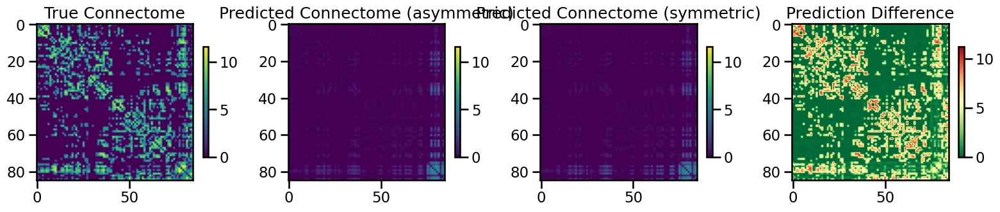

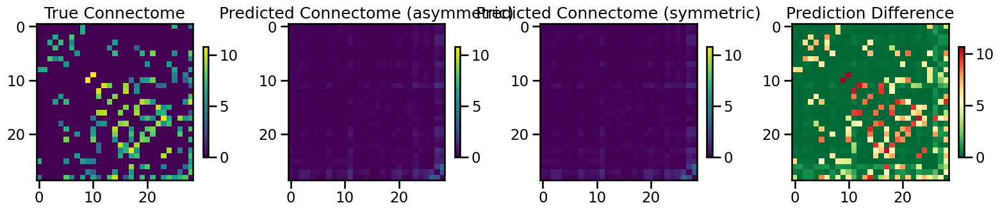

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 13.456230950685699, 'mae': 1.9471752331026941, 'r2': -0.20171071023203058, 'pearson_corr': 0.4051767782903608, 'geodesic_distance': 38.20192800248809}
TEST METRICS: {'mse': 9.490254437265692, 'mae': 1.4816253193279316, 'r2': -0.16895081010774304, 'pearson_corr': 0.23672686675378365, 'geodesic_distance': 19.310984779927544}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.22562653314945888, 'learning_rate': 5.003247450739992e-05, 'weight_decay': 0.00022623830427729376, 'batch_size': 482, 'epochs': 109, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▂▃▂▂▂▂▂▁▂▂▂▂▂▂▁▂▂▁▂▁▂▂▁▂▁▂▂▁▁▂▁▁▂▂▂▂▁▁▂
test_pearson,▃█▅▅▄▃▃▃▆▅▄▃▁▃▂▂▃▅▇▆▃▆▆▇▆▆▆▆▆▆▆▇▆▅▆▆▆▆▆▆
train_mse_loss,█▆▆▅▅▄▄▄▄▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▅▅▄▅▃▄▄▅▅▅▅▅▅▆▆▇▆▇▇▇▇▇█▇▇█▇▇▇████▇▇▇███
best_val_loss,0
test_mse_loss,0.14389
test_pearson,0.23503
train_mse_loss,0.19447
train_pearson,0.36719


Final evaluation metrics logged successfully.
CPU Usage: 5.9%
RAM Usage: 7.4%
Available RAM: 932.2G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 3 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: g3mwxouz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/g3mwxouz


wandb: Agent Starting Run: 8wwgqfyv with config:
wandb: 	batch_size: 262
wandb: 	dropout_rate: 0.20683677757148
wandb: 	epochs: 164
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.361544945438706e-05
wandb: 	weight_decay: 0.00020237824802989184
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/164, Train Loss: 0.1745, Val Loss: 0.2434
Epoch 10/164, Train Loss: 0.1698, Val Loss: 0.2413
Epoch 15/164, Train Loss: 0.1718, Val Loss: 0.2253
Epoch 20/164, Train Loss: 0.1675, Val Loss: 0.2328
Epoch 25/164, Train Loss: 0.1677, Val Loss: 0.2022
Epoch 30/164, Train Loss: 0.1674, Val Loss: 0.2352
Epoch 35/164, Train Loss: 0.1634, Val Loss: 0.2199
Epoch 40/164, Train Loss: 0.1567, Val Loss: 0.2421
Epoch 45/164, Train Loss: 0.1592, Val Loss: 0.2451
Epoch 50/164, Train Loss: 0.1564, Val Loss: 0.2198
Epoch 55/164, Train Loss: 0.1577, Val Loss: 0.2352
Epoch 60/164, Train Loss: 0.1533, Val Loss: 0.2325
Epoch 65/164, Train Loss: 0.1582, Val Loss: 0.2197
Epoch 70/164, Train Loss: 0.1545, Val Loss: 0.2407
Epoch 75/164, Train Loss: 0.1548, Val Loss: 0.2305
Epoch 80/164, Train Loss: 0.1558, Val Loss: 0.2060
Epoch 85/164, Train Loss: 0.1551, Val Loss: 0.1996
Epoch 90/164, Train Loss: 0.1541, Val Loss: 0.2071
Epoch 95/16

  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 120/164, Train Loss: 0.1567, Val Loss: 0.2201
Epoch 125/164, Train Loss: 0.1536, Val Loss: 0.2048
Epoch 130/164, Train Loss: 0.1574, Val Loss: 0.2193
Epoch 135/164, Train Loss: 0.1574, Val Loss: 0.2334
Epoch 140/164, Train Loss: 0.1538, Val Loss: 0.2251
Epoch 145/164, Train Loss: 0.1537, Val Loss: 0.2518
Epoch 150/164, Train Loss: 0.1575, Val Loss: 0.2326
Epoch 155/164, Train Loss: 0.1538, Val Loss: 0.2203
Epoch 160/164, Train Loss: 0.1589, Val Loss: 0.2071
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/164, Train Loss: 0.2306, Val Loss: 0.1365
Epoch 10/164, Train Loss: 0.2222, Val Loss: 0.1417
Epoch 15/164, Train Loss: 0.2208, Val Loss: 0.1600
Epoch 20/164, Train Loss: 0.2191, Val Loss: 0.1477
Epoch 25/164, Train Loss: 0.2117, Val Loss: 0.1484
Epoch 30/164, Train Loss: 0.2086, Val Loss: 0.1496
Epoch 35/164, Train Loss: 0.2069, Val Loss: 0.1482
Epoch 40/164, Train Loss: 0.2051, Val Loss: 0.1374
Epoch 45/164, Train Loss: 0.2044, Val Loss: 0.1624
Ep

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇█
fold0_train_loss,██▇▆▆▇▆▆▅▅▅▃▄▄▂▂▂▂▃▂▃▂▃▁▂▂▃▃▂▃▂▃▄▃▃▃▂▄▃▃
fold0_train_pearson,▁▃▃▄▅▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇█▇▇▇▇
fold0_val_loss,▇▇▂▆▃▄▄▄█▁▂▂▅▃▂▅▅▃▄▆▅▃█▅▂▄▅▄▅▅▃▇▆▄▆▁▆▅▅▃
fold0_val_pearson,▃▆▅▅▁▅▆▆▅▇▇▆▇█▇▇▅▆▇██▇▇▇▆█▆▆▅▆▇▇▇█▇▇▆▇▆▇
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇██
fold1_train_loss,██▇▇▆▆▇▆▄▄▃▄▂▂▂▂▂▂▃▂▂▃▂▃▂▃▃▂▂▂▃▂▂▄▁▂▃▂▂▂
fold1_train_pearson,▁▃▃▄▄▆▆▆▆▆▇▆██▇▇▇▇███▇████▇████████████▇
fold1_val_loss,▃▄▃▂▃▂▂▂▁▃▂▅▂▅▆▃▃▄█▄▄▄▅▂▅▁▂▄▃▅▄▃▃▄▃▃▅▄▃▁
fold1_val_pearson,▁▄▇▇▆▇▇▅██▇▇▇▅▆▄▆▅▄▇▅▄▅▄▆▆▇▆▄▄▄▃▄▄▄▅▅▅▇▄
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇███


wandb: Agent Starting Run: is7acu4v with config:
wandb: 	batch_size: 267
wandb: 	dropout_rate: 0.23462834108783967
wandb: 	epochs: 102
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.025601953050043e-05
wandb: 	weight_decay: 0.00010477287760625766
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/102, Train Loss: 0.1841, Val Loss: 0.1930
Epoch 10/102, Train Loss: 0.1790, Val Loss: 0.2086
Epoch 15/102, Train Loss: 0.1755, Val Loss: 0.2523
Epoch 20/102, Train Loss: 0.1744, Val Loss: 0.2428
Epoch 25/102, Train Loss: 0.1711, Val Loss: 0.2242
Epoch 30/102, Train Loss: 0.1714, Val Loss: 0.2087
Epoch 35/102, Train Loss: 0.1705, Val Loss: 0.2522
Epoch 40/102, Train Loss: 0.1698, Val Loss: 0.2061
Epoch 45/102, Train Loss: 0.1698, Val Loss: 0.2110
Epoch 50/102, Train Loss: 0.1700, Val Loss: 0.1916
Epoch 55/102, Train Loss: 0.1701, Val Loss: 0.2185
Epoch 60/102, Train Loss: 0.1689, Val Loss: 0.2220
Epoch 65/102, Train Loss: 0.1698, Val Loss: 0.2218
Epoch 70/102, Train Loss: 0.1696, Val Loss: 0.2224
Epoch 75/102, Train Loss: 0.1697, Val Loss: 0.2054
Epoch 80/102, Train Loss: 0.1689, Val Loss: 0.2282
Epoch 85/102, Train Loss: 0.1689, Val Loss: 0.2079
Epoch 90/102, Train Loss: 0.1694, Val Loss: 0.2165
Epoch 95/10

  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 25/102, Train Loss: 0.2137, Val Loss: 0.1346
Epoch 30/102, Train Loss: 0.2119, Val Loss: 0.1526
Epoch 35/102, Train Loss: 0.2091, Val Loss: 0.2080
Epoch 40/102, Train Loss: 0.2077, Val Loss: 0.1366
Epoch 45/102, Train Loss: 0.2044, Val Loss: 0.1517
Epoch 50/102, Train Loss: 0.2030, Val Loss: 0.1701
Epoch 55/102, Train Loss: 0.2034, Val Loss: 0.1405
Epoch 60/102, Train Loss: 0.2024, Val Loss: 0.1856
Epoch 65/102, Train Loss: 0.2026, Val Loss: 0.2032
Epoch 70/102, Train Loss: 0.2007, Val Loss: 0.1387


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 75/102, Train Loss: 0.2026, Val Loss: 0.1312
Epoch 80/102, Train Loss: 0.2022, Val Loss: 0.1369
Epoch 85/102, Train Loss: 0.2025, Val Loss: 0.1668
Epoch 90/102, Train Loss: 0.2016, Val Loss: 0.1416
Epoch 95/102, Train Loss: 0.2006, Val Loss: 0.1421
Epoch 100/102, Train Loss: 0.2010, Val Loss: 0.1590
Processing inner fold 2
Number of learnable parameters in MLP: 11187969
Epoch 5/102, Train Loss: 0.1811, Val Loss: 0.2171
Epoch 10/102, Train Loss: 0.1770, Val Loss: 0.2156
Epoch 15/102, Train Loss: 0.1756, Val Loss: 0.2162
Epoch 20/102, Train Loss: 0.1728, Val Loss: 0.2174
Epoch 25/102, Train Loss: 0.1694, Val Loss: 0.2153
Epoch 30/102, Train Loss: 0.1661, Val Loss: 0.2149
Epoch 35/102, Train Loss: 0.1631, Val Loss: 0.2151
Epoch 40/102, Train Loss: 0.1647, Val Loss: 0.2164
Epoch 45/102, Train Loss: 0.1633, Val Loss: 0.2168
Epoch 50/102, Train Loss: 0.1596, Val Loss: 0.2135
Epoch 55/102, Train Loss: 0.1577, Val Loss: 0.2180
Epoch 60/102, Train Loss: 0.1553, Val Loss: 0.2156
Epoch 65/1

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇█
fold0_train_loss,█▆▅▅▅▄▃▃▂▂▂▂▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▃▃▃▄▅▅▄▅▅▅▇▇▆▇▆█▇▇▇██▇█▇█▇▇█▇▇█▇██▇█▇▇▇
fold0_val_loss,▅▅▁▇▃▆█▆▃▄▅▄▄▁▇▄▄▃▅▆▇▅▄▂▃▃▅▄▆▄▄█▃▂▃▅▃▃▄▃
fold0_val_pearson,▁▅▆▅▅▅▅▇▇▄▆▆▇▆▅▅▆▇▇▇▇▆█▇▆▆▆▆▆▇▇█▇▆▇▇▅▆▇▆
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇█████
fold1_train_loss,█▅▅▅▅▄▄▄▄▄▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▄▅▄▅▅▅▆▆▆▆▆▆▆▆▆▇▇▆▆▇▇▇█▇▇██████████████
fold1_val_loss,▆▄▆▄▁▁▄▁▁▄▄▄▆▆▄▃▅▃▄▆▅▄▆▂▇▅▄█▂▂▄▇▅▅▄▄█▃▃▃
fold1_val_pearson,▅▁▄▅█▅▆▃▄▄ ▆▃▃▃▅▆▃▁▃ ▄▂▂ ▃▅▅ ▃▂▄▄▂▄▅█▇ ▃
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███


wandb: Agent Starting Run: wgw35nt6 with config:
wandb: 	batch_size: 258
wandb: 	dropout_rate: 0.17524411490034536
wandb: 	epochs: 173
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.589233131209538e-05
wandb: 	weight_decay: 0.00016212703883215475
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/173, Train Loss: 0.1782, Val Loss: 0.2450
Epoch 10/173, Train Loss: 0.1716, Val Loss: 0.2209
Epoch 15/173, Train Loss: 0.1731, Val Loss: 0.2317
Epoch 20/173, Train Loss: 0.1695, Val Loss: 0.2389
Epoch 25/173, Train Loss: 0.1673, Val Loss: 0.2320
Epoch 30/173, Train Loss: 0.1650, Val Loss: 0.2294
Epoch 35/173, Train Loss: 0.1620, Val Loss: 0.2140
Epoch 40/173, Train Loss: 0.1610, Val Loss: 0.2336
Epoch 45/173, Train Loss: 0.1593, Val Loss: 0.2389
Epoch 50/173, Train Loss: 0.1592, Val Loss: 0.2319
Epoch 55/173, Train Loss: 0.1576, Val Loss: 0.2219
Epoch 60/173, Train Loss: 0.1546, Val Loss: 0.2210
Epoch 65/173, Train Loss: 0.1526, Val Loss: 0.2466
Epoch 70/173, Train Loss: 0.1490, Val Loss: 0.2553
Epoch 75/173, Train Loss: 0.1439, Val Loss: 0.2248
Epoch 80/173, Train Loss: 0.1468, Val Loss: 0.2097
Epoch 85/173, Train Loss: 0.1435, Val Loss: 0.2182
Epoch 90/173, Train Loss: 0.1437, Val Loss: 0.2325
Epoch 95/17

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 155/173, Train Loss: 0.1406, Val Loss: 0.2131
Epoch 160/173, Train Loss: 0.1424, Val Loss: 0.2204
Epoch 165/173, Train Loss: 0.1418, Val Loss: 0.2238
Epoch 170/173, Train Loss: 0.1416, Val Loss: 0.2294
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/173, Train Loss: 0.2335, Val Loss: 0.1503
Epoch 10/173, Train Loss: 0.2253, Val Loss: 0.1535
Epoch 15/173, Train Loss: 0.2270, Val Loss: 0.1423
Epoch 20/173, Train Loss: 0.2207, Val Loss: 0.1573
Epoch 25/173, Train Loss: 0.2198, Val Loss: 0.1542
Epoch 30/173, Train Loss: 0.2160, Val Loss: 0.1529
Epoch 35/173, Train Loss: 0.2135, Val Loss: 0.1508
Epoch 40/173, Train Loss: 0.2127, Val Loss: 0.1548
Epoch 45/173, Train Loss: 0.2093, Val Loss: 0.1485
Epoch 50/173, Train Loss: 0.2066, Val Loss: 0.1528
Epoch 55/173, Train Loss: 0.2075, Val Loss: 0.1458
Epoch 60/173, Train Loss: 0.2101, Val Loss: 0.1579
Epoch 65/173, Train Loss: 0.2080, Val Loss: 0.1406
Epoch 70/173, Train Loss: 0.2066, Val Loss: 0.1495
Epoch 7

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▆▆▆▆▇▇▇▇▇█████
fold0_train_loss,█▆▅▅▅▄▄▄▄▃▃▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▂▃▄▄▅▅▅▅▅▅▆▆▇▇▇▇▇▇▇███▇███████████████
fold0_val_loss,▆▅▃▆▆▃▄▅▄▆▅▆█▂▃▁▄▃▅▄▅▄▅▂▆▄▅▄▅▃▃▆▃▃▄▂▄▅▆▃
fold0_val_pearson,▄▄▂▄▃█▇▇█▃▄▅█▁▇▇▆▁▇█▆▇▇▆▇▇▇▅▅▇▇█▅▆█▇█▇▇▅
fold1_epoch,▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇██
fold1_train_loss,█▇▆▆▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▃▂▁▂▂▂▂▂▂▃▂▂▁▂▁
fold1_train_pearson,▁▃▄▄▅▅▅▅▆▅▆▇▆▇▇▇█▇█▇████▇▇█▇█▇▇▇▇▇█▇█▇█▇
fold1_val_loss,▇▆▃▁▆▂▂▅▅▄▃▅▃▅▃▅▇▅▆▅▅▄▆▅▃▄▆▄▁▅▄▇█▄▃▅▅▃▃▅
fold1_val_pearson,▁▆▅▆█▆▇▄▅▅▅▆▃▄▄▄▇▆▇▅▄▅▆▃▇▅▇▃▅▄▅▆▃▅▅▃▃▂▄▄
fold2_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇██


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 173, 'input_dim': 21526, 'batch_size': 258, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.17524411490034536, 'weight_decay': 0.00016212703883215475, 'learning_rate': 6.589233131209538e-05}
Number of learnable parameters in MLP: 11187969
Epoch 5/173, Train Loss: 0.1912, Val Loss: 0.2394
Epoch 10/173, Train Loss: 0.1850, Val Loss: 0.2385
Epoch 15/173, Train Loss: 0.1837, Val Loss: 0.2367
Epoch 20/173, Train Loss: 0.1804, Val Loss: 0.2346
Epoch 25/173, Train Loss: 0.1769, Val Loss: 0.2321
Epoch 30/173, Train Loss: 0.1748, Val Loss: 0.2372
Epoch 35/173, Train Loss: 0.1710, Val Loss: 0.2309
Epoch 40/173, Train Loss: 0.1643, Val Loss: 0.2300
Epoch 45/173, Train Loss: 0.1609, Val Loss: 0.2248
Epoch 50/173, Train Loss: 0.1514, Val Loss: 0.2290
Epoch 55/173, Train Loss: 0.1425, Val Loss: 0.2128
Epoch 60/173, Train Loss: 0.1332, Val Loss: 0.2112
Epoch 65/173, Train Loss: 0.1219, Val Loss: 0.2099
Epoch 70/173, Train Loss: 0.1134, Val Loss: 0.2012
Epoch 75/173, Train Los

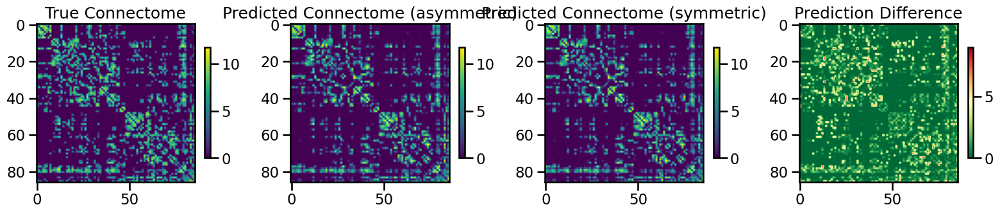

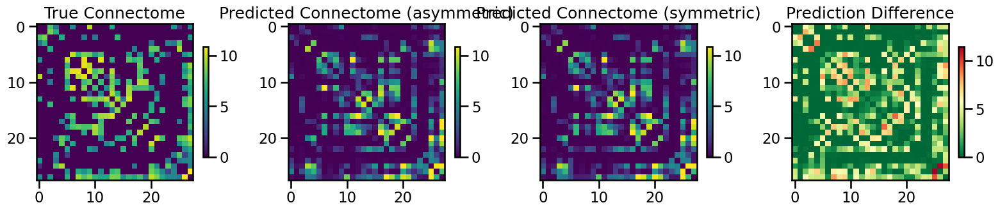

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 2.312270845372248, 'mae': 0.671450957685808, 'r2': 0.7765489778204073, 'pearson_corr': 0.8857447509974188, 'geodesic_distance': 9.228328722979755}
TEST METRICS: {'mse': 10.173158962887477, 'mae': 1.9193599102628438, 'r2': 0.17843338877219184, 'pearson_corr': 0.5390420413408333, 'geodesic_distance': 7.48485239539953}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.17524411490034536, 'learning_rate': 6.589233131209538e-05, 'weight_decay': 0.00016212703883215475, 'batch_size': 258, 'epochs': 173, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▇▇▇▇▆▇▆▇▆▆▅▆▅▅▄▃▂▃▃▂▃▃▂▁▃▂▂▃▂▄▂▂▅▁▁▁▁▁
test_pearson,▂▁▁▂▁▂▃▂▃▅▅▆▇▇▆▇▇▇▇▇▇██▆▇▆██▇▇▇█▇███████
train_mse_loss,███▇▇▇▆▅▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁
train_pearson,▁▂▃▃▃▃▃▄▃▅▅▅▅▆▆▇▆▇▇▇▇▇▇▇█▇██████████████
best_val_loss,0
test_mse_loss,0.18749
test_pearson,0.53733
train_mse_loss,0.08582
train_pearson,0.84619


Final evaluation metrics logged successfully.
CPU Usage: 2.7%
RAM Usage: 7.4%
Available RAM: 932.1G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |

 Test fold num: 4 X_train shape: (7310, 21526) Y_train shape: (7310,) X_test shape: (756, 21526) Y_test shape: (756,)
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: qdwp9721
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/qdwp9721


wandb: Agent Starting Run: hrplg6rx with config:
wandb: 	batch_size: 500
wandb: 	dropout_rate: 0.13338799540366614
wandb: 	epochs: 171
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 9.065600645760426e-05
wandb: 	weight_decay: 0.00028311618607348944
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/171, Train Loss: 0.1810, Val Loss: 0.2373
Epoch 10/171, Train Loss: 0.1770, Val Loss: 0.2436
Epoch 15/171, Train Loss: 0.1767, Val Loss: 0.2426
Epoch 20/171, Train Loss: 0.1735, Val Loss: 0.2316
Epoch 25/171, Train Loss: 0.1692, Val Loss: 0.2327
Epoch 30/171, Train Loss: 0.1703, Val Loss: 0.2308
Epoch 35/171, Train Loss: 0.1671, Val Loss: 0.2269


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 40/171, Train Loss: 0.1677, Val Loss: 0.2311
Epoch 45/171, Train Loss: 0.1691, Val Loss: 0.2332
Epoch 50/171, Train Loss: 0.1655, Val Loss: 0.2305
Epoch 55/171, Train Loss: 0.1618, Val Loss: 0.2358
Epoch 60/171, Train Loss: 0.1598, Val Loss: 0.2331
Epoch 65/171, Train Loss: 0.1593, Val Loss: 0.2286
Epoch 70/171, Train Loss: 0.1605, Val Loss: 0.2336
Epoch 75/171, Train Loss: 0.1587, Val Loss: 0.2262
Epoch 80/171, Train Loss: 0.1591, Val Loss: 0.2314
Epoch 85/171, Train Loss: 0.1562, Val Loss: 0.2284
Epoch 90/171, Train Loss: 0.1577, Val Loss: 0.2357
Epoch 95/171, Train Loss: 0.1560, Val Loss: 0.2335
Epoch 100/171, Train Loss: 0.1526, Val Loss: 0.2296
Epoch 105/171, Train Loss: 0.1529, Val Loss: 0.2347
Epoch 110/171, Train Loss: 0.1564, Val Loss: 0.2300
Epoch 115/171, Train Loss: 0.1557, Val Loss: 0.2300
Epoch 120/171, Train Loss: 0.1571, Val Loss: 0.2288
Epoch 125/171, Train Loss: 0.1559, Val Loss: 0.2323
Epoch 130/171, Train Loss: 0.1539, Val Loss: 0.2361
Epoch 135/171, Train Los

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▂▂▂▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇████
fold0_train_loss,▇█▇▆▆▅▅▄▄▅▄▃▄▃▄▃▂▃▃▂▂▂▂▂▂▂▁▂▂▁▁▁▂▁▂▁▁▂▁▁
fold0_train_pearson,▁▁▁▂▂▂▄▄▃▅▅▅▆▆▆▆▇▆▇▇▇▇▇█▇█▇████▇█▇▇█▇█▇▇
fold0_val_loss,▃▆▇▆▆▅▂▆▃▄▃▅▄▆▂▃▄▃▂▃▂▁▂▄▂▁▃▄▇▃█▄█▁▃▅▂▃▃▅
fold0_val_pearson,▁▄▆▆▆▃▆█▆▇▆▆▅▅▆▅▅▆▆▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▅▆▅▅
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇█████
fold1_train_loss,██▇▃▆▃▄▃▃▂▂▂▃▃▁▃▂▂▃▂▂▂▃▁▂▂▂▁▃▃▂▃▃▃▃▃▂▃▃▂
fold1_train_pearson,▄▁▄▅▅▅▆▅▆▅▅▇▄█▆▆▆▇▇▆▆▇▇▆█▅▅▇▆▆▆█▄▇▇▅▇▅▆▆
fold1_val_loss,▂▂█▂▂▂▂▂▁▃▂▂▂▂▂▁▂▂▂▂▂▂▂▂▂▂▁▂▁▂▂▂▂▂▁▁▂▂▁▂
fold1_val_pearson,▁▄▆▇▆▇▇▇███████▇██▇█████▇██▇███▇██▇████▇
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▇▇▇▇▇▇██


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 88ickab6 with config:
wandb: 	batch_size: 299
wandb: 	dropout_rate: 0.10523226419487064
wandb: 	epochs: 149
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 7.118686568192863e-05
wandb: 	weight_decay: 0.00047005870845259615
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 5544705
Epoch 5/149, Train Loss: 0.1747, Val Loss: 0.2343
Epoch 10/149, Train Loss: 0.1698, Val Loss: 0.2285
Epoch 15/149, Train Loss: 0.1689, Val Loss: 0.2317
Epoch 20/149, Train Loss: 0.1667, Val Loss: 0.2342
Epoch 25/149, Train Loss: 0.1676, Val Loss: 0.2323
Epoch 30/149, Train Loss: 0.1640, Val Loss: 0.2306
Epoch 35/149, Train Loss: 0.1636, Val Loss: 0.2247
Epoch 40/149, Train Loss: 0.1619, Val Loss: 0.2294
Epoch 45/149, Train Loss: 0.1610, Val Loss: 0.2304
Epoch 50/149, Train Loss: 0.1607, Val Loss: 0.2309
Epoch 55/149, Train Loss: 0.1574, Val Loss: 0.2273
Epoch 60/149, Train Loss: 0.1573, Val Loss: 0.2288
Epoch 65/149, Train Loss: 0.1550, Val Loss: 0.2277
Epoch 70/149, Train Loss: 0.1551, Val Loss: 0.2291
Epoch 75/149, Train Loss: 0.1562, Val Loss: 0.2325
Epoch 80/149, Train Loss: 0.1555, Val Loss: 0.2322
Epoch 85/149, Train Loss: 0.1551, Val Loss: 0.2300
Epoch 90/149, Train Loss: 0.1549, Val Loss: 0.2305
Epoch 95/149

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 135/149, Train Loss: 0.1549, Val Loss: 0.2336
Epoch 140/149, Train Loss: 0.1549, Val Loss: 0.2325
Epoch 145/149, Train Loss: 0.1549, Val Loss: 0.2312
Processing inner fold 1
Number of learnable parameters in MLP: 5544705
Epoch 5/149, Train Loss: 0.1976, Val Loss: 0.1500
Epoch 10/149, Train Loss: 0.1945, Val Loss: 0.1472
Epoch 15/149, Train Loss: 0.1924, Val Loss: 0.1424
Epoch 20/149, Train Loss: 0.1908, Val Loss: 0.1492
Epoch 25/149, Train Loss: 0.1898, Val Loss: 0.1476
Epoch 30/149, Train Loss: 0.1895, Val Loss: 0.1479
Epoch 35/149, Train Loss: 0.1859, Val Loss: 0.1466
Epoch 40/149, Train Loss: 0.1850, Val Loss: 0.1469
Epoch 45/149, Train Loss: 0.1849, Val Loss: 0.1474
Epoch 50/149, Train Loss: 0.1840, Val Loss: 0.1496
Epoch 55/149, Train Loss: 0.1845, Val Loss: 0.1475
Epoch 60/149, Train Loss: 0.1849, Val Loss: 0.1481
Epoch 65/149, Train Loss: 0.1835, Val Loss: 0.1484
Epoch 70/149, Train Loss: 0.1837, Val Loss: 0.1463
Epoch 75/149, Train Loss: 0.1844, Val Loss: 0.1473
Epoch 80/

  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 5/149, Train Loss: 0.1811, Val Loss: 0.2476
Epoch 10/149, Train Loss: 0.1773, Val Loss: 0.2424
Epoch 15/149, Train Loss: 0.1622, Val Loss: 0.2418
Epoch 20/149, Train Loss: 0.1659, Val Loss: 0.2468
Epoch 25/149, Train Loss: 0.1731, Val Loss: 0.2378
Epoch 30/149, Train Loss: 0.1615, Val Loss: 0.2390
Epoch 35/149, Train Loss: 0.1684, Val Loss: 0.2309
Epoch 40/149, Train Loss: 0.1687, Val Loss: 0.2297
Epoch 45/149, Train Loss: 0.1634, Val Loss: 0.2335
Epoch 50/149, Train Loss: 0.1676, Val Loss: 0.2396
Epoch 55/149, Train Loss: 0.1572, Val Loss: 0.2320
Epoch 60/149, Train Loss: 0.1597, Val Loss: 0.2319
Epoch 65/149, Train Loss: 0.1656, Val Loss: 0.2342
Epoch 70/149, Train Loss: 0.1635, Val Loss: 0.2321
Epoch 75/149, Train Loss: 0.1666, Val Loss: 0.2377
Epoch 80/149, Train Loss: 0.1706, Val Loss: 0.2299
Epoch 85/149, Train Loss: 0.1619, Val Loss: 0.2385
Epoch 90/149, Train Loss: 0.1606, Val Loss: 0.2398
Epoch 95/149, Train Loss: 0.1570, Val Loss: 0.2335
Epoch 100/149, Train Loss: 0.152

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇██
fold0_train_loss,█▆▆▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▂▄▄▄▄▄▄▄▅▆▆▆▇▇▇▇▇█▇████████████████████
fold0_val_loss,█▅▃▄▄▁▄▁▃▃▄▁▂▃▂▂▂▃▁▁▄▃▃▃▃▂▅▂▄▁▄▃▄▄▃▃▃▂▃▅
fold0_val_pearson,▁▇▇▇▄▆▇▇▄▆█▇▆█▇▆▇███████▇█▇▇█▇▇█████▇▇██
fold1_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇████
fold1_train_loss,█▅▄▄▃▃▃▂▃▂▂▂▁▂▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▁▂▂▃▄▄▅▅▅▆▆▇▇▇▆▇▇█▇▇▇▇█▇█▇▇▇█▇▇▇▇██▇█▇
fold1_val_loss,▆█▅▃▄▃▁▄▄▅▄▄▃▄▄▃▆▅▄▅▄▄▄▅▂▅▅▄▆▅▄▅▆▅▅▆▆▅▄▆
fold1_val_pearson,▅▁█▇▄▅▄▄▅▄█▅▄▆▆▆▆▅▄▅▄▅▅▆▅▄▅▅▆▆▅▄▅▄▆▄▅▅▅▇
fold2_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇████


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 04l4yhdy with config:
wandb: 	batch_size: 395
wandb: 	dropout_rate: 0.1255220766859346
wandb: 	epochs: 168
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 21526
wandb: 	learning_rate: 6.533615383871106e-05
wandb: 	weight_decay: 0.0003370992665702359
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 11187969
Epoch 5/168, Train Loss: 0.1815, Val Loss: 0.2398
Epoch 10/168, Train Loss: 0.1812, Val Loss: 0.2829
Epoch 15/168, Train Loss: 0.1795, Val Loss: 0.1971
Epoch 20/168, Train Loss: 0.1700, Val Loss: 0.2010
Epoch 25/168, Train Loss: 0.1722, Val Loss: 0.2077
Epoch 30/168, Train Loss: 0.1742, Val Loss: 0.2480
Epoch 35/168, Train Loss: 0.1740, Val Loss: 0.2153
Epoch 40/168, Train Loss: 0.1636, Val Loss: 0.1980
Epoch 45/168, Train Loss: 0.1707, Val Loss: 0.1911
Epoch 50/168, Train Loss: 0.1694, Val Loss: 0.2390
Epoch 55/168, Train Loss: 0.1652, Val Loss: 0.2337
Epoch 60/168, Train Loss: 0.1636, Val Loss: 0.2566
Epoch 65/168, Train Loss: 0.1619, Val Loss: 0.2537
Epoch 70/168, Train Loss: 0.1693, Val Loss: 0.2410
Epoch 75/168, Train Loss: 0.1536, Val Loss: 0.2205
Epoch 80/168, Train Loss: 0.1533, Val Loss: 0.2405
Epoch 85/168, Train Loss: 0.1571, Val Loss: 0.2559
Epoch 90/168, Train Loss: 0.1530, Val Loss: 0.2225
Epoch 95/16

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 120/168, Train Loss: 0.1525, Val Loss: 0.2572
Epoch 125/168, Train Loss: 0.1596, Val Loss: 0.2135
Epoch 130/168, Train Loss: 0.1592, Val Loss: 0.2371
Epoch 135/168, Train Loss: 0.1450, Val Loss: 0.2235
Epoch 140/168, Train Loss: 0.1572, Val Loss: 0.2127
Epoch 145/168, Train Loss: 0.1661, Val Loss: 0.1977
Epoch 150/168, Train Loss: 0.1562, Val Loss: 0.2287
Epoch 155/168, Train Loss: 0.1650, Val Loss: 0.2724
Epoch 160/168, Train Loss: 0.1679, Val Loss: 0.2674
Epoch 165/168, Train Loss: 0.1503, Val Loss: 0.2073
Processing inner fold 1
Number of learnable parameters in MLP: 11187969
Epoch 5/168, Train Loss: 0.2063, Val Loss: 0.1541
Epoch 10/168, Train Loss: 0.2053, Val Loss: 0.1357
Epoch 15/168, Train Loss: 0.2160, Val Loss: 0.1651
Epoch 20/168, Train Loss: 0.1979, Val Loss: 0.1257
Epoch 25/168, Train Loss: 0.1880, Val Loss: 0.1497
Epoch 30/168, Train Loss: 0.1938, Val Loss: 0.1180
Epoch 35/168, Train Loss: 0.1960, Val Loss: 0.1535
Epoch 40/168, Train Loss: 0.1874, Val Loss: 0.1556


  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 45/168, Train Loss: 0.1837, Val Loss: 0.1063
Epoch 50/168, Train Loss: 0.1863, Val Loss: 0.1613
Epoch 55/168, Train Loss: 0.1787, Val Loss: 0.1562
Epoch 60/168, Train Loss: 0.1841, Val Loss: 0.1374
Epoch 65/168, Train Loss: 0.1847, Val Loss: 0.1338
Epoch 70/168, Train Loss: 0.1818, Val Loss: 0.1615
Epoch 75/168, Train Loss: 0.1819, Val Loss: 0.1615
Epoch 80/168, Train Loss: 0.1919, Val Loss: 0.1805
Epoch 85/168, Train Loss: 0.1842, Val Loss: 0.1343
Epoch 90/168, Train Loss: 0.1824, Val Loss: 0.1601
Epoch 95/168, Train Loss: 0.1859, Val Loss: 0.1518
Epoch 100/168, Train Loss: 0.1802, Val Loss: 0.1330
Epoch 105/168, Train Loss: 0.1780, Val Loss: 0.1518
Epoch 110/168, Train Loss: 0.1882, Val Loss: 0.1369
Epoch 115/168, Train Loss: 0.1856, Val Loss: 0.1485
Epoch 120/168, Train Loss: 0.1813, Val Loss: 0.1413
Epoch 125/168, Train Loss: 0.1821, Val Loss: 0.1366
Epoch 130/168, Train Loss: 0.1854, Val Loss: 0.1471
Epoch 135/168, Train Loss: 0.1867, Val Loss: 0.1413
Epoch 140/168, Train Lo

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇▇█████
fold0_train_loss,█▆▇▆▄▄▄▆▃▅▅▅▄▃▃▃▁▁▁▃▂▂▃▄▂▂▂▃▃▁▂▃▄▁▁▂▂▂▃▂
fold0_train_pearson,▁▂▅▅▅▅▅▆▆▆▇▆▇▇▇▇▇▆█▇██▇▇▇██▇▇▇▇▇▇▇▇▇██▇█
fold0_val_loss,▆█▆▅▆▂▆▅▄▃▂▃▁▄▄▄▃▃▄▅▄▃▆▆▂▂▆▅▆▃▅▅▃▄▃▄▄▃▁▄
fold0_val_pearson,▁▃▅▇▇▇▇▇▆▅▅▅▅▃▅▇▆▄▃▆▄▆▆█▆▅▇▆▃▆█▄▇▅▆▄▇▆▇▄
fold1_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▇▇▇▇███
fold1_train_loss,██▇▇▆▅▅▅▅▄▅▂▃▂▃▄▅▆▄▂▃▃▃▃▄▂▃▂▃▁▂▂▄▂▃▄▃▄▄▂
fold1_train_pearson,▁▄▄▃▃▄▅▆▆▇▅▆▆▆▇▅▆▇▆▇█▇▇▇▆▇▇▇▇▇█▇▇▇▇▇█▇▇▆
fold1_val_loss,▅▃█▂▂▂▃▄▂▁▄▅▃▄▄▃▂▃▃▂▄▃▃▄▄▃▂▄▅▄▃▄▃▃▃▃▄▅▄▃
fold1_val_pearson,▆▆▂▄▄▄▅▄▁▃▄▅▅▃▅▃▁▅▆▇▃▂▄▂▄▃▃▆▅▇▆▄▃▄▅▆▅▄▇█
fold2_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇█████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 149, 'input_dim': 21526, 'batch_size': 299, 'hidden_dims': [256, 128], 'dropout_rate': 0.10523226419487064, 'weight_decay': 0.00047005870845259615, 'learning_rate': 7.118686568192863e-05}
Number of learnable parameters in MLP: 5544705
Epoch 5/149, Train Loss: 0.1761, Val Loss: 0.2374
Epoch 10/149, Train Loss: 0.1723, Val Loss: 0.2243
Epoch 15/149, Train Loss: 0.1698, Val Loss: 0.2162
Epoch 20/149, Train Loss: 0.1675, Val Loss: 0.2130
Epoch 25/149, Train Loss: 0.1662, Val Loss: 0.2089
Epoch 30/149, Train Loss: 0.1635, Val Loss: 0.2168
Epoch 35/149, Train Loss: 0.1629, Val Loss: 0.2109
Epoch 40/149, Train Loss: 0.1619, Val Loss: 0.2066
Epoch 45/149, Train Loss: 0.1612, Val Loss: 0.2249
Epoch 50/149, Train Loss: 0.1589, Val Loss: 0.2112
Epoch 55/149, Train Loss: 0.1593, Val Loss: 0.2043
Epoch 60/149, Train Loss: 0.1568, Val Loss: 0.2104
Epoch 65/149, Train Loss: 0.1539, Val Loss: 0.2037
Epoch 70/149, Train Loss: 0.1539, Val Loss: 0.2046
Epoch 75/149, Train Loss: 0.1

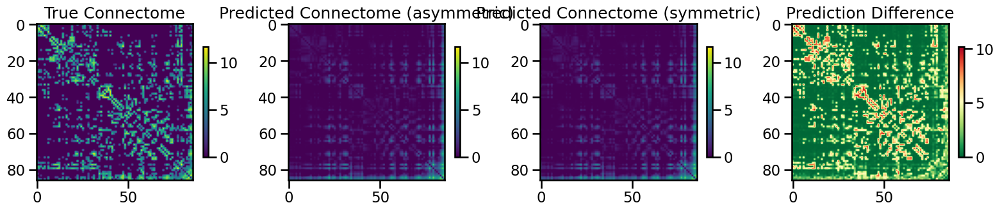

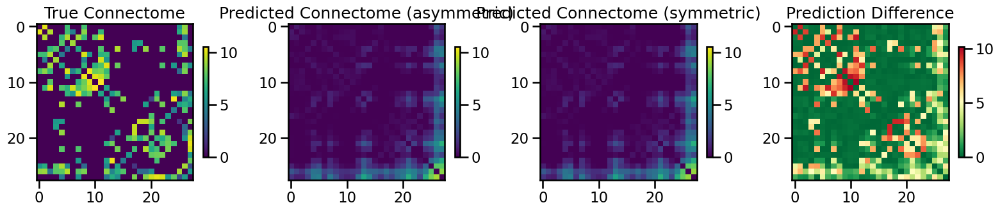

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 8.34600978253149, 'mae': 1.4896495121628668, 'r2': 0.13637726631850478, 'pearson_corr': 0.562745274028168, 'geodesic_distance': 23.861155031364653}
TEST METRICS: {'mse': 12.934474655613927, 'mae': 2.112058726876619, 'r2': -0.06263207288085537, 'pearson_corr': 0.3490746611475108, 'geodesic_distance': 13.689404082610876}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 21526, 'hidden_dims': [256, 128], 'dropout_rate': 0.10523226419487064, 'learning_rate': 7.118686568192863e-05, 'weight_decay': 0.00047005870845259615, 'batch_size': 299, 'epochs': 149, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▂▅▅▃▃▃▄▃▄▃▂▃▅▅▂▂▂▅▁▂▂▁▁▂▂▂▃▂▃▃▂▃▁▁▂▂▁▂
test_pearson,▁▅▆▅▆▅▇▅▆▅▄▇▆▅▆▇▇▇▆▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇
train_mse_loss,██▇▅▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▃▃▃▄▅▄▄▅▅▅▅▆▅▆▆▆▆▆▆▇▇▇▇▇██████████████
best_val_loss,0
test_mse_loss,0.20942
test_pearson,0.3618
train_mse_loss,0.15064
train_pearson,0.54395


Final evaluation metrics logged successfully.
CPU Usage: 4.4%
RAM Usage: 7.5%
Available RAM: 931.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 23% |


  gc.collect()



Running simulation with: dynamic_mlp, random, S400, FC, seed=2
Number of components for 95% variance PCA: 105
X shape: (214, 7380)
X_pca shape: (214, 105)
Y_sc shape: (214, 214)
Y_sc_spectralL shape: (214, 222)
Y_sc_spectralA shape: (214, 223)
Y_fc shape: (214, 214)
Coordinates shape: (214, 3)
Y shape (214, 214)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
X shape (214, 7383)

 Test fold num: 1 X_train shape: (25440, 14766) Y_train shape: (25440,) X_test shape: (2862, 14766) Y_test shape: (2862,)
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: q5do0zw1
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/q5do0zw1


wandb: Agent Starting Run: 3m3yd1x6 with config:
wandb: 	batch_size: 458
wandb: 	dropout_rate: 0.18141774347677625
wandb: 	epochs: 142
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.0378249129741126e-05
wandb: 	weight_decay: 9.703567693637992e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145
Epoch 5/142, Train Loss: 0.0213, Val Loss: 0.0122
Epoch 10/142, Train Loss: 0.0182, Val Loss: 0.0162
Epoch 15/142, Train Loss: 0.0163, Val Loss: 0.0105
Epoch 20/142, Train Loss: 0.0147, Val Loss: 0.0102
Epoch 25/142, Train Loss: 0.0132, Val Loss: 0.0097
Epoch 30/142, Train Loss: 0.0122, Val Loss: 0.0096
Epoch 35/142, Train Loss: 0.0107, Val Loss: 0.0098
Epoch 40/142, Train Loss: 0.0096, Val Loss: 0.0096
Epoch 45/142, Train Loss: 0.0085, Val Loss: 0.0103
Epoch 50/142, Train Loss: 0.0079, Val Loss: 0.0100
Epoch 55/142, Train Loss: 0.0070, Val Loss: 0.0103
Epoch 60/142, Train Loss: 0.0063, Val Loss: 0.0094
Epoch 65/142, Train Loss: 0.0062, Val Loss: 0.0094


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 70/142, Train Loss: 0.0061, Val Loss: 0.0095
Epoch 75/142, Train Loss: 0.0060, Val Loss: 0.0094
Epoch 80/142, Train Loss: 0.0058, Val Loss: 0.0097
Epoch 85/142, Train Loss: 0.0059, Val Loss: 0.0093
Epoch 90/142, Train Loss: 0.0057, Val Loss: 0.0097
Epoch 95/142, Train Loss: 0.0058, Val Loss: 0.0094
Epoch 100/142, Train Loss: 0.0059, Val Loss: 0.0095
Epoch 105/142, Train Loss: 0.0058, Val Loss: 0.0097
Epoch 110/142, Train Loss: 0.0059, Val Loss: 0.0094
Epoch 115/142, Train Loss: 0.0059, Val Loss: 0.0094
Epoch 120/142, Train Loss: 0.0057, Val Loss: 0.0095
Epoch 125/142, Train Loss: 0.0057, Val Loss: 0.0094
Epoch 130/142, Train Loss: 0.0058, Val Loss: 0.0095
Epoch 135/142, Train Loss: 0.0058, Val Loss: 0.0095
Epoch 140/142, Train Loss: 0.0058, Val Loss: 0.0094
Processing inner fold 1
Number of learnable parameters in MLP: 3814145
Epoch 5/142, Train Loss: 0.0221, Val Loss: 0.0124
Epoch 10/142, Train Loss: 0.0188, Val Loss: 0.0102
Epoch 15/142, Train Loss: 0.0167, Val Loss: 0.0109
Epo

  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 50/142, Train Loss: 0.0080, Val Loss: 0.0073
Epoch 55/142, Train Loss: 0.0080, Val Loss: 0.0077
Epoch 60/142, Train Loss: 0.0077, Val Loss: 0.0077
Epoch 65/142, Train Loss: 0.0075, Val Loss: 0.0083
Epoch 70/142, Train Loss: 0.0076, Val Loss: 0.0082
Epoch 75/142, Train Loss: 0.0074, Val Loss: 0.0074
Epoch 80/142, Train Loss: 0.0076, Val Loss: 0.0078
Epoch 85/142, Train Loss: 0.0075, Val Loss: 0.0079
Epoch 90/142, Train Loss: 0.0073, Val Loss: 0.0075
Epoch 95/142, Train Loss: 0.0074, Val Loss: 0.0071
Epoch 100/142, Train Loss: 0.0073, Val Loss: 0.0085
Epoch 105/142, Train Loss: 0.0073, Val Loss: 0.0079
Epoch 110/142, Train Loss: 0.0073, Val Loss: 0.0086
Epoch 115/142, Train Loss: 0.0073, Val Loss: 0.0074
Epoch 120/142, Train Loss: 0.0075, Val Loss: 0.0075
Epoch 125/142, Train Loss: 0.0074, Val Loss: 0.0078
Epoch 130/142, Train Loss: 0.0074, Val Loss: 0.0074
Epoch 135/142, Train Loss: 0.0074, Val Loss: 0.0085
Epoch 140/142, Train Loss: 0.0073, Val Loss: 0.0082


fold0_epoch,▁▁▁▁▁▁▂▂▂▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇███
fold0_train_loss,█▇▇▆▅▄▄▄▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▂▃▄▄▄▅▅▆▆▇███████████████████████████
fold0_val_loss,█▅▆▄▅▄▃▄▄▂▂▂▂▁▃▂▁▃▁▁▂▁▁▁▂▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▁▃▂▄▁▅▆▇▇▆▆▇▆▆▇▅▇▄▇██▇▇██▇██▇█▇█▇████▇▇
fold1_epoch,▁▁▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇█
fold1_train_loss,█▅▅▅▅▄▄▄▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▂▂▂▃▃▄▄▄▅▅▆▆▆▇▇▇▇▇▇███████████████████
fold1_val_loss,█▃▄▂▂▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
fold1_val_pearson,▃▁▃▂▄▄▅▅▆▅▆▆▇▅▆▄▆▇▇▇▇▇█▇▆▇█▆▇▇▇█▅▇█▅▆▆▇█
fold2_epoch,▁▁▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▆▆▇▇▇▇██


wandb: Agent Starting Run: b2oh53d7 with config:
wandb: 	batch_size: 312
wandb: 	dropout_rate: 0.2522246718050637
wandb: 	epochs: 167
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.74113324423412e-05
wandb: 	weight_decay: 0.00033413179733151157
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/167, Train Loss: 0.0262, Val Loss: 0.0118
Epoch 10/167, Train Loss: 0.0212, Val Loss: 0.0104
Epoch 15/167, Train Loss: 0.0180, Val Loss: 0.0098
Epoch 20/167, Train Loss: 0.0156, Val Loss: 0.0094


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 25/167, Train Loss: 0.0135, Val Loss: 0.0101
Epoch 30/167, Train Loss: 0.0116, Val Loss: 0.0095
Epoch 35/167, Train Loss: 0.0099, Val Loss: 0.0094
Epoch 40/167, Train Loss: 0.0087, Val Loss: 0.0089
Epoch 45/167, Train Loss: 0.0078, Val Loss: 0.0093
Epoch 50/167, Train Loss: 0.0068, Val Loss: 0.0091
Epoch 55/167, Train Loss: 0.0059, Val Loss: 0.0092
Epoch 60/167, Train Loss: 0.0053, Val Loss: 0.0090
Epoch 65/167, Train Loss: 0.0047, Val Loss: 0.0090
Epoch 70/167, Train Loss: 0.0046, Val Loss: 0.0090
Epoch 75/167, Train Loss: 0.0045, Val Loss: 0.0091
Epoch 80/167, Train Loss: 0.0044, Val Loss: 0.0091
Epoch 85/167, Train Loss: 0.0044, Val Loss: 0.0090
Epoch 90/167, Train Loss: 0.0043, Val Loss: 0.0088
Epoch 95/167, Train Loss: 0.0041, Val Loss: 0.0092
Epoch 100/167, Train Loss: 0.0042, Val Loss: 0.0090
Epoch 105/167, Train Loss: 0.0042, Val Loss: 0.0092
Epoch 110/167, Train Loss: 0.0040, Val Loss: 0.0088
Epoch 115/167, Train Loss: 0.0040, Val Loss: 0.0087
Epoch 120/167, Train Loss: 

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
fold0_train_loss,█▇▆▅▅▄▄▃▃▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▂▂▂▂▃▃▃▃▅▆▆▇██████████████████████████
fold0_val_loss,█▅▄▄▃▃▂▂▂▂▂▂▁▁▂▁▁▂▁▁▁▁▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▂
fold0_val_pearson,▁▂▂▅▃▆▅▆▅▄▅▇▂▅▆▃▆▇█▆▇██▇█▇████▇▇▇▇▇▇▇▇▇▇
fold1_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇████
fold1_train_loss,█▆▆▆▅▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▁▂▂▂▄▄▅▅▇▇▇▇▇█▇███████████████████████
fold1_val_loss,█▄▃▃▂▂▃▄▃▆▂▂▂▂▁▂▂▁▂▂▁▁▁▁▁▂▂▂▁▂▁▂▂▂▁▁▁▁▁▁
fold1_val_pearson,▁▄▄▅▅▇▆▇▆▆▇▇██▇█▇███████████████████████
fold2_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▄▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇███


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: ktpebt0q with config:
wandb: 	batch_size: 415
wandb: 	dropout_rate: 0.2863984705519436
wandb: 	epochs: 110
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 8.485475422271091e-05
wandb: 	weight_decay: 0.0004334754976705973
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/110, Train Loss: 0.0271, Val Loss: 0.0113
Epoch 10/110, Train Loss: 0.0214, Val Loss: 0.0110
Epoch 15/110, Train Loss: 0.0178, Val Loss: 0.0099
Epoch 20/110, Train Loss: 0.0154, Val Loss: 0.0097
Epoch 25/110, Train Loss: 0.0130, Val Loss: 0.0098
Epoch 30/110, Train Loss: 0.0113, Val Loss: 0.0097
Epoch 35/110, Train Loss: 0.0096, Val Loss: 0.0094
Epoch 40/110, Train Loss: 0.0084, Val Loss: 0.0094
Epoch 45/110, Train Loss: 0.0071, Val Loss: 0.0091
Epoch 50/110, Train Loss: 0.0063, Val Loss: 0.0093
Epoch 55/110, Train Loss: 0.0055, Val Loss: 0.0097


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 60/110, Train Loss: 0.0050, Val Loss: 0.0101
Epoch 65/110, Train Loss: 0.0046, Val Loss: 0.0096
Epoch 70/110, Train Loss: 0.0043, Val Loss: 0.0092
Epoch 75/110, Train Loss: 0.0039, Val Loss: 0.0090
Epoch 80/110, Train Loss: 0.0037, Val Loss: 0.0099
Epoch 85/110, Train Loss: 0.0036, Val Loss: 0.0098
Epoch 90/110, Train Loss: 0.0034, Val Loss: 0.0102
Epoch 95/110, Train Loss: 0.0032, Val Loss: 0.0100
Epoch 100/110, Train Loss: 0.0027, Val Loss: 0.0091
Epoch 105/110, Train Loss: 0.0025, Val Loss: 0.0094
Epoch 110/110, Train Loss: 0.0024, Val Loss: 0.0093
Processing inner fold 1
Number of learnable parameters in MLP: 7726849
Epoch 5/110, Train Loss: 0.0269, Val Loss: 0.0121
Epoch 10/110, Train Loss: 0.0216, Val Loss: 0.0111
Epoch 15/110, Train Loss: 0.0179, Val Loss: 0.0091
Epoch 20/110, Train Loss: 0.0153, Val Loss: 0.0088
Epoch 25/110, Train Loss: 0.0133, Val Loss: 0.0089
Epoch 30/110, Train Loss: 0.0112, Val Loss: 0.0089
Epoch 35/110, Train Loss: 0.0095, Val Loss: 0.0081
Epoch 40/

fold0_epoch,▁▁▁▁▂▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇████
fold0_train_loss,██▇▇▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▁▁▂▂▂▃▃▃▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇▇▇▇█████████
fold0_val_loss,▄▂▃▂▂▂█▁▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▂▂▁▂▁▁▁▂▂▂▂▁▂▂▁▁▁
fold0_val_pearson,▂▃▅▄▆▆▁▆▇▇▇▇▇█▇▇▅██▇▇▆▆▇▇█▅▆▆▇▇▆▅▆▆███▇█
fold1_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇█████
fold1_train_loss,█▆▅▅▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▁▁▁▂▂▂▂▂▃▃▃▄▄▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇██████████
fold1_val_loss,█▅▅▅▄▃▃▃▃▂▂▂▂▂▂▂█▄▃▂▂▄▂▂▂▃▃▃▃▃▃▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▂▂▂▃▂▄▅▅▅▆▆▅▆▆▅▁▄▅▆▄▆▃▇▅▆▅▅▄▅▆█████████
fold2_epoch,▁▁▁▁▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇████


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 167, 'input_dim': 14766, 'batch_size': 312, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.2522246718050637, 'weight_decay': 0.00033413179733151157, 'learning_rate': 5.74113324423412e-05}
Number of learnable parameters in MLP: 7726849
Epoch 5/167, Train Loss: 0.0203, Val Loss: 0.0093
Epoch 10/167, Train Loss: 0.0148, Val Loss: 0.0083
Epoch 15/167, Train Loss: 0.0112, Val Loss: 0.0080
Epoch 20/167, Train Loss: 0.0085, Val Loss: 0.0079
Epoch 25/167, Train Loss: 0.0063, Val Loss: 0.0081
Epoch 30/167, Train Loss: 0.0050, Val Loss: 0.0087
Epoch 35/167, Train Loss: 0.0043, Val Loss: 0.0084
Epoch 40/167, Train Loss: 0.0035, Val Loss: 0.0075
Epoch 45/167, Train Loss: 0.0033, Val Loss: 0.0073
Epoch 50/167, Train Loss: 0.0032, Val Loss: 0.0073
Epoch 55/167, Train Loss: 0.0030, Val Loss: 0.0072
Epoch 60/167, Train Loss: 0.0030, Val Loss: 0.0072
Epoch 65/167, Train Loss: 0.0029, Val Loss: 0.0073
Epoch 70/167, Train Loss: 0.0028, Val Loss: 0.0074
Epoch 75/167, Train Loss: 

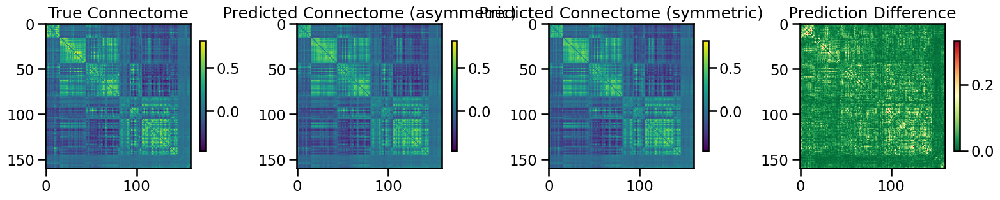

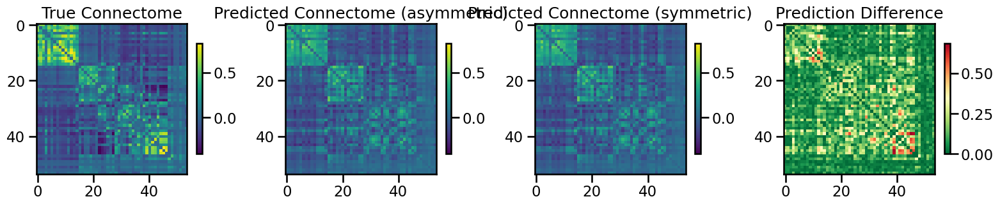

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.0019484589478821718, 'mae': 0.031409661586531384, 'r2': 0.9452279598055031, 'pearson_corr': 0.9724940658304208, 'geodesic_distance': 10.165390235448042}
TEST METRICS: {'mse': 0.023424705743818424, 'mae': 0.11051457064041206, 'r2': 0.42169082899113663, 'pearson_corr': 0.6565811180875467, 'geodesic_distance': 9.292153454842827}
BEST VAL SCORE 0.0
BEST MODEL PARAMS {'input_dim': 14766, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.2522246718050637, 'learning_rate': 5.74113324423412e-05, 'weight_decay': 0.00033413179733151157, 'batch_size': 312, 'epochs': 167, 'device': 'cuda'}


  self.comm = Comm(**args)

  from IPython.core.display import display



  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▃▄▃▃█▃▆▃▂▄▁▂▁▂▂▂▁▂▂▂▁▃▁▂▂▁▁▂▁▁▁▁▁▁▁▁▁▁▁
test_pearson,▁▅▆▆▅▄▆▆▇███████████████████████████████
train_mse_loss,█▅▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_pearson,▁▂▃▄▆▆▇▇▇▇██████████████████████████████
best_val_loss,0
test_mse_loss,0.00719
test_pearson,0.66502
train_mse_loss,0.00232
train_pearson,0.92405


Final evaluation metrics logged successfully.
CPU Usage: 4.1%
RAM Usage: 8.3%
Available RAM: 923.8G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% | 25% |

 Test fold num: 2 X_train shape: (25440, 14766) Y_train shape: (25440,) X_test shape: (2862, 14766) Y_test shape: (2862,)
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: qn87p5zu
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/qn87p5zu


wandb: Agent Starting Run: 6xfcv06q with config:
wandb: 	batch_size: 368
wandb: 	dropout_rate: 0.21576210745679453
wandb: 	epochs: 152
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 8.388372269630696e-05
wandb: 	weight_decay: 0.00014315451900756473
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849
Epoch 5/152, Train Loss: 0.0219, Val Loss: 0.0250


  return tuple(tensor[index] for tensor in self.tensors)

  return tuple(tensor[index] for tensor in self.tensors)



Epoch 10/152, Train Loss: 0.0176, Val Loss: 0.0090
Epoch 15/152, Train Loss: 0.0145, Val Loss: 0.0084
Epoch 20/152, Train Loss: 0.0121, Val Loss: 0.0083
Epoch 25/152, Train Loss: 0.0103, Val Loss: 0.0081
Epoch 30/152, Train Loss: 0.0089, Val Loss: 0.0078
Epoch 35/152, Train Loss: 0.0071, Val Loss: 0.0078
Epoch 40/152, Train Loss: 0.0063, Val Loss: 0.0078
Epoch 45/152, Train Loss: 0.0053, Val Loss: 0.0086
Epoch 50/152, Train Loss: 0.0048, Val Loss: 0.0086
Epoch 55/152, Train Loss: 0.0042, Val Loss: 0.0086
Epoch 60/152, Train Loss: 0.0037, Val Loss: 0.0092
Epoch 65/152, Train Loss: 0.0032, Val Loss: 0.0078
Epoch 70/152, Train Loss: 0.0030, Val Loss: 0.0079
Epoch 75/152, Train Loss: 0.0028, Val Loss: 0.0078
Epoch 80/152, Train Loss: 0.0028, Val Loss: 0.0079
Epoch 85/152, Train Loss: 0.0029, Val Loss: 0.0079
Epoch 90/152, Train Loss: 0.0028, Val Loss: 0.0078
Epoch 95/152, Train Loss: 0.0026, Val Loss: 0.0079
Epoch 100/152, Train Loss: 0.0027, Val Loss: 0.0078
Epoch 105/152, Train Loss: 0.0

fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▇▇▇▇▇████
fold0_train_loss,█▆▅▅▄▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_train_pearson,▁▁▂▂▃▄▄▅▅▅▆▆▆▆▇▇▇███████████████████████
fold0_val_loss,▂█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_pearson,▁▄▂▇▇▇████▇▇█▇▇▇████████████████████████
fold1_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold1_train_loss,█▇▆▆▅▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▂▂▃▃▅▅▆▆▆▇▇▇▇██████████████████████████
fold1_val_loss,█▅▄▃▂▂▂▂▂▁▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▃▃▅▅▇▇▇▇▆▅▆▆▇▆▆▆▇▇██▇███████████▇█▇████
fold2_epoch,▁▂▂▃▃▃▃▃▄▄▄▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇██


wandb: Agent Starting Run: 3i6e237z with config:
wandb: 	batch_size: 428
wandb: 	dropout_rate: 0.2236336001847201
wandb: 	epochs: 165
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 5.710955111184335e-05
wandb: 	weight_decay: 0.0003568188573868682
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 7726849


  warnings.warn(*args, **kwargs)  # noqa: B028



Epoch 5/165, Train Loss: 0.0233, Val Loss: 0.0108
Epoch 10/165, Train Loss: 0.0212, Val Loss: 0.0092


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 15/165, Train Loss: 0.0191, Val Loss: 0.0103
Epoch 20/165, Train Loss: 0.0181, Val Loss: 0.0091
Epoch 25/165, Train Loss: 0.0179, Val Loss: 0.0097
Epoch 30/165, Train Loss: 0.0164, Val Loss: 0.0094
Epoch 35/165, Train Loss: 0.0158, Val Loss: 0.0086
Epoch 40/165, Train Loss: 0.0137, Val Loss: 0.0096
Epoch 45/165, Train Loss: 0.0134, Val Loss: 0.0087
Epoch 50/165, Train Loss: 0.0125, Val Loss: 0.0091
Epoch 55/165, Train Loss: 0.0123, Val Loss: 0.0087
Epoch 60/165, Train Loss: 0.0143, Val Loss: 0.0090
Epoch 65/165, Train Loss: 0.0124, Val Loss: 0.0088
Epoch 70/165, Train Loss: 0.0119, Val Loss: 0.0088
Epoch 75/165, Train Loss: 0.0122, Val Loss: 0.0087
Epoch 80/165, Train Loss: 0.0120, Val Loss: 0.0086
Epoch 85/165, Train Loss: 0.0117, Val Loss: 0.0085
Epoch 90/165, Train Loss: 0.0117, Val Loss: 0.0083
Epoch 95/165, Train Loss: 0.0122, Val Loss: 0.0087
Epoch 100/165, Train Loss: 0.0129, Val Loss: 0.0089
Epoch 105/165, Train Loss: 0.0117, Val Loss: 0.0088
Epoch 110/165, Train Loss: 0.

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇██
fold0_train_loss,█▇▅▅▄▄▄▄▃▃▂▂▁▂▂▁▂▁▁▁▁▂▂▁▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁
fold0_train_pearson,▂▂▁▁▃▅▆▆▅▄▆▅▅▆█▆█▆▆█▆▆▆██▆█▆█████▆▆██▆██
fold0_val_loss,▆█▃▂▂▃▂▂▃▂▂▁▁▁▁▁▂▁▁▁▂▁▁▁▂▂▁▁▁▁▁▂▁▁▁▂▂▂▂▁
fold0_val_pearson,▂▁▄▅▄▆▆▅▆▇▇▇▆▇▇█████▇██▇█▇█▇███▇██▇███▇█
fold1_epoch,▁▁▂▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
fold1_train_loss,█▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_train_pearson,▁▁▂▂▂▂▂▂▃▄▅▅▆▆▆▆▇▇▇▇███▇████████████████
fold1_val_loss,█▄▃▂▂▁▂▁▂▁▁▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold1_val_pearson,▁▃▃▃▅▅▆▆▆▆▇▇▇▆█▇▄███████████████████████
fold2_epoch,▁▁▁▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇▇█


wandb: Agent Starting Run: v0nqlmv1 with config:
wandb: 	batch_size: 487
wandb: 	dropout_rate: 0.11876509145688048
wandb: 	epochs: 143
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 14766
wandb: 	learning_rate: 6.820390674243003e-05
wandb: 	weight_decay: 0.0002445314180891491
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 3814145


  return tuple(tensor[index] for tensor in self.tensors)



Epoch 5/143, Train Loss: 0.0172, Val Loss: 0.0118
Epoch 10/143, Train Loss: 0.0153, Val Loss: 0.0098
Epoch 15/143, Train Loss: 0.0132, Val Loss: 0.0098
Epoch 20/143, Train Loss: 0.0118, Val Loss: 0.0093
Epoch 25/143, Train Loss: 0.0108, Val Loss: 0.0089
Epoch 30/143, Train Loss: 0.0099, Val Loss: 0.0090
Epoch 35/143, Train Loss: 0.0089, Val Loss: 0.0088
Epoch 40/143, Train Loss: 0.0081, Val Loss: 0.0112
Epoch 45/143, Train Loss: 0.0074, Val Loss: 0.0090
Epoch 50/143, Train Loss: 0.0067, Val Loss: 0.0103
Epoch 55/143, Train Loss: 0.0060, Val Loss: 0.0092
Epoch 60/143, Train Loss: 0.0054, Val Loss: 0.0087
Epoch 65/143, Train Loss: 0.0050, Val Loss: 0.0085
Epoch 70/143, Train Loss: 0.0047, Val Loss: 0.0092
Epoch 75/143, Train Loss: 0.0041, Val Loss: 0.0088
Epoch 80/143, Train Loss: 0.0039, Val Loss: 0.0096
Epoch 85/143, Train Loss: 0.0035, Val Loss: 0.0099
Epoch 90/143, Train Loss: 0.0031, Val Loss: 0.0085
Epoch 95/143, Train Loss: 0.0030, Val Loss: 0.0085
Epoch 100/143, Train Loss: 0.002

In [ ]:
# TRANSCRIPTOME EUCLIDEAN COMBINED
def run_simulation_set(model_types=['dynamic_mlp'],
                      cv_types=['spatial', 'random'],
                      parcellations=['S100', 'S400'],
                      connectome_targets=['FC', 'SC'],
                      feature_types=['transcriptome', 'euclidean'],
                      hemisphere='left',
                      random_seeds=[42, 123, 456]):
    """
    Run a set of simulations with different combinations of parameters.
    
    Args:
        model_types (list): List of model types to test
        cv_types (list): List of cross-validation types
        parcellations (list): List of parcellation schemes
        connectome_targets (list): List of connectome targets
        feature_types (list): List of feature types
        hemisphere (str): Brain hemisphere to use ('left', 'right', 'both')
        random_seeds (list): List of random seeds for multiple runs
    """
    
    for seed in random_seeds:
        for model in model_types:
            for cv in cv_types:
                for parc in parcellations:
                    # Set hemisphere based on parcellation
                    current_hemisphere = 'both' if parc == 'S100' else 'left'
                    
                    for target in connectome_targets:
                    
                        print(f"Running simulation with: {model}, {cv}, {parc}, {target}, seed={seed}")
                        
                        # Run single simulation
                        single_sim_run(
                            cv_type=cv,
                            random_seed=seed,
                            model_type=model,
                            feature_type=[{'transcriptome':None}, 
                                          {'euclidean':None}
                                         ],
                            connectome_target=target,
                            use_gpu=True,
                            use_shared_regions=False,
                            test_shared_regions=False,
                            omit_subcortical=False,
                            parcellation=parc,
                            gene_list='0.2',
                            hemisphere=current_hemisphere,
                            search_method=('wandb', 'mse', 3),
                            save_sim=False,
                            track_wandb=True,
                            skip_cv=False
                        )
                        
                        # Clear GPU memory
                        if torch.cuda.is_available():
                            torch.cuda.empty_cache()
                        # Clear CPU memory
                        gc.collect()

# Example usage:
run_simulation_set(
    model_types=['dynamic_mlp'],
    cv_types=['random', 'spatial'],
    parcellations=['S100', 'S400'],
    connectome_targets=['FC', 'SC'],
    #feature_types=['transcriptome', 'euclidean'],
    hemisphere='both',
    random_seeds=[1, 2]
)